In [2]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
#########################
#        UTILS          #
#########################

In [4]:
#pd.DataFrame(info_dict['ret_full']).to_csv('results/test_3act_3108_ped', index=True)

In [5]:
def getRes (eps, data, stat):

    dct = {}
    #modifica sto obrobrio
    if len(data)==7:
        mappa = {"wt_ped":0, "wt_veh":1, "wt_veh_ind":2, "queue":3, "delay":4, "actions":5, "ret":6}
    elif len(data)==8:
        mappa = {"wt_ped":0, "wt_veh":1, "wt_veh_ind":2, "queue":3, "delay":4, "actions":5, "ret":6, "wt_ped_tot":7}
    else:
        mappa = {"wt_ped":0, "wt_veh":1, "queue":2, "delay":3, "actions":4, "ret":5}

    for ep in range(eps):
        for index, lst in enumerate(data[str(ep)][mappa[stat]].split(',')):
            if index not in dct.keys():
                dct[index] = [float((lst.replace('[','').replace(']','')))]
            else:
                dct[index] += [float((lst.replace('[','').replace(']','')))]

    d_mean = []
    d_std = []

    for key in dct.keys():
        d_mean.append(np.mean(dct[key]))
        d_std.append(np.std(dct[key]))

    return dct, d_mean, d_std

In [6]:
def defPlot(base_mean, base_std, mod_mean, mod_std, title):

    plt.figure(figsize=(10, 6))
    sns.set(style="whitegrid")

    # Plot the average
    plt.plot(base_mean, color='blue', linewidth=2.5, label='Baseline')
    plt.plot(mod_mean, color='red', linewidth=2.5, label='With DQN Agent')

    # Plot the standard deviation as a shaded area
    plt.fill_between(range(len(base_mean)), np.array(base_mean) - np.array(base_std),
                    np.array(base_mean) + np.array(base_std),
                    color='blue', alpha=0.2)

    plt.fill_between(range(len(mod_mean)), np.array(mod_mean) - np.array(mod_std),
                    np.array(mod_mean) + np.array(mod_std),
                    color='red', alpha=0.2)



    # Customize the plot
    plt.title(title, fontsize=16)
    plt.xlabel("Steps", fontsize=14)
    plt.ylabel("Value", fontsize=14)
    plt.legend(loc='upper left', fontsize=12)
    plt.tight_layout()

    # Show the plot
    plt.show()

In [7]:
def enl(dct, mean, std, green):
    mean_enl, std_enl = [], []

    mean_enl += [mean[0]]*green
    std_enl += [std[0]]*green

    prev_act = dct[0][0]

    for id, val in enumerate(mean[1:]):
        act = dct[id+1][0]
        
        if act==prev_act:
            mean_enl += [val]*green
            std_enl += [std[id+1]]*green
        else:
            mean_enl += [val]*(green+5)
            std_enl += [std[id+1]]*(green+5)
    
        prev_act = act

    return mean_enl, std_enl

In [8]:
def enlbase(mean, std, sec):
    mean_full = []
    for i in mean:
        mean_full += [i]*sec

    s_full = []
    for i in std:
        s_full += [i]*sec

    return mean_full, s_full

In [9]:
def histComp(dfbase, dfstat, lgnd, title):

    df = pd.DataFrame([dfstat, dfbase])

    df_melted = df.melt(var_name='Key', value_name='Value')
    df_melted['Legend'] = lgnd*len(dfstat) #[]'DQN', 'Baseline']

    sns.set(style="darkgrid")
    sns.set_palette("viridis")

    plt.figure(figsize=(8, 6))
    ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


    for p in ax.patches:
        ax.annotate(format(p.get_height(), '.1f'),
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center',
                    xytext=(0, 9),  # offset text by 9 points above bar
                    textcoords='offset points')

    plt.title(title)
    plt.xlabel('')
    plt.ylabel('Sec   ', rotation=0)
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()

In [10]:
def buildHist(dct, time):

    histg = {}
    if len(dct)>6:
        act_id = 5
    else:
        act_id = 4

    for ep in range(10):
        actions = []
        for i in dct[str(ep)][act_id]:
            if i=='0' or i=='1' or i=='2':
                actions.append(int(i))
        
        green_time = []
        green = time
        for id, val in enumerate(actions[1:]):
            if val==actions[id]:
                green+=time
            else:
                green_time.append(green)
                green=time
        
        
        for i in range(time, 65, time):
            if i not in histg.keys():
                histg[i] = [green_time.count(i)]
            else:
                histg[i] +=  [green_time.count(i)]

    return {k:np.mean(v) for k,v in histg.items()}
    

def plotAct(dct, time, title):
    
    histg = buildHist(dct, time)

    sns.set(style="whitegrid")

    temp = list(histg.values())
    ax = sns.barplot(x=list(histg.keys()), y=[i/sum(temp) for i in temp], color='darkgreen')
    #ax.set_yticks([])
    
    for p in ax.patches:
        ax.annotate(format(p.get_height()*100, '.1f'),
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center',
                    xytext=(0, 9),  # offset text by 9 points above bar
                    textcoords='offset points')


    plt.title(title)
    plt.xlabel('Green Time')
    plt.ylabel('%    ', rotation=0)
    plt.grid(True)
    
    plt.show()
            

#### BASELINE

In [11]:
baseline_low = pd.read_csv('results/stats_ped/baseline_lowveh') 
baseline_mid = pd.read_csv('results/stats_ped/baseline_midveh') 
baseline_high = pd.read_csv('results/stats_ped/baseline_highveh') 

###
baseline_low2 = pd.read_csv('results/stats_ped/baseline_low_4') 
baseline_mid2 = pd.read_csv('results/stats_ped/baseline_mid_4') 
baseline_high2 = pd.read_csv('results/stats_ped/baseline_high_4') 

###
baseline_low3 = pd.read_csv('results/stats_ped/base_low_OCL_last')  #baseline_low_OCL_last #baseline_OCL_low2
baseline_mid3 = pd.read_csv('results/stats_ped/base_mid_OCL_last') #baseline_OCL_mid4
baseline_high3 = pd.read_csv('results/stats_ped/base_high_OCL_last4') 

In [12]:
#baseline_low3=baseline_low3.drop(1)
#baseline_low3.reset_index(drop=True, inplace=True)

In [13]:
base_V, base_low_Vm, base_low_Vs  = getRes(10, baseline_low3, 'wt_veh')
base_low_Vm_full, base_low_Vs_full = enlbase(base_low_Vm, base_low_Vs, 10)

base_V, base_mid_Vm, base_mid_Vs  = getRes(10, baseline_mid3, 'wt_veh')
base_mid_Vm_full, base_mid_Vs_full = enlbase(base_mid_Vm, base_mid_Vs, 10)

base_V, base_high_Vm, base_high_Vs  = getRes(10, baseline_high3, 'wt_veh')
base_high_Vm_full, base_high_Vs_full = enlbase(base_high_Vm, base_high_Vs, 10)

In [14]:
base_IV, base_low_IVm, base_low_IVs  = getRes(10, baseline_low3, 'wt_veh_ind')
base_low_IVm_full, base_low_IVs_full = enlbase(base_low_IVm, base_low_IVs, 10)

base_IV, base_mid_IVm, base_mid_IVs  = getRes(10, baseline_mid3, 'wt_veh_ind')
base_mid_IVm_full, base_mid_IVs_full = enlbase(base_mid_IVm, base_mid_IVs, 10)

base_IV, base_high_IVm, base_high_IVs  = getRes(10, baseline_high3, 'wt_veh_ind')
base_high_IVm_full, base_high_IVs_full = enlbase(base_high_IVm, base_high_IVs, 10)

In [15]:
base_P, base_low_Pm, base_low_Ps  = getRes(10, baseline_low3, 'wt_ped')
base_low_Pm_full, base_low_Ps_full = enlbase(base_low_Pm, base_low_Ps, 10)

base_P, base_mid_Pm, base_mid_Ps  = getRes(10, baseline_mid3, 'wt_ped')
base_mid_Pm_full, base_mid_Ps_full = enlbase(base_mid_Pm, base_mid_Ps, 10)

base_P, base_high_Pm, base_high_Ps  = getRes(10, baseline_high3, 'wt_ped')
base_high_Pm_full, base_high_Ps_full = enlbase(base_high_Pm, base_high_Ps, 10)

In [16]:
base_D, base_low_Dm, base_low_Ds  = getRes(10, baseline_low3, 'delay')
base_low_Dm_full, base_low_Ds_full = enlbase(base_low_Dm, base_low_Ds, 10)

base_D, base_mid_Dm, base_mid_Ds  = getRes(10, baseline_mid3, 'delay')
base_mid_Dm_full, base_mid_Ds_full = enlbase(base_mid_Dm, base_mid_Ds, 10)

base_D, base_high_Dm, base_high_Ds  = getRes(10, baseline_high3, 'delay')
base_high_Dm_full, base_high_Ds_full = enlbase(base_high_Dm, base_high_Ds, 10)

In [17]:
base_Q, base_low_Qm, base_low_Qs  = getRes(10, baseline_low3, 'queue')
base_low_Qm_full, base_low_Qs_full = enlbase(base_low_Qm, base_low_Qs, 10)

base_Q, base_mid_Qm, base_mid_Qs  = getRes(10, baseline_mid3, 'queue')
base_mid_Qm_full, base_mid_Qs_full = enlbase(base_mid_Qm, base_mid_Qs, 10)

base_Q, base_high_Qm, base_high_Qs  = getRes(10, baseline_high3, 'queue')
base_high_Qm_full, base_high_Qs_full = enlbase(base_high_Qm, base_high_Qs, 10)

In [18]:
###
#base_V2, base_low_Vm2, base_low_Vs2  = getRes(10, baseline_low2, 'wt_veh')
#base_low_Vm2_full, base_low_Vs2_full = enlbase(base_low_Vm2, base_low_Vs2, 10)

#base_V2, base_mid_Vm2, base_mid_Vs2  = getRes(10, baseline_mid2, 'wt_veh')
#base_mid_Vm2_full, base_mid_Vs2_full = enlbase(base_mid_Vm2, base_mid_Vs2, 10)

#base_V2, base_high_Vm2, base_high_Vs2  = getRes(10, baseline_high2, 'wt_veh')
#base_high_Vm2_full, base_high_Vs2_full = enlbase(base_high_Vm2, base_high_Vs2, 10)

###
#base_P2, base_low_Pm2, base_low_Ps2  = getRes(10, baseline_low2, 'wt_ped')
#base_low_Pm2_full, base_low_Ps2_full = enlbase(base_low_Pm2, base_low_Ps2, 10)

#base_P2, base_mid_Pm2, base_mid_Ps2  = getRes(10, baseline_mid2, 'wt_ped')
#base_mid_Pm2_full, base_mid_Ps2_full = enlbase(base_mid_Pm2, base_mid_Ps2, 10)

#base_P2, base_high_Pm2, base_high_Ps2  = getRes(10, baseline_high2, 'wt_ped')
#base_high_Pm2_full, base_high_Ps2_full = enlbase(base_high_Pm2, base_high_Ps2, 10)

###
#base_D2, base_low_Dm2, base_low_Ds2  = getRes(10, baseline_low2, 'delay')
#base_low_Dm2_full, base_low_Ds2_full = enlbase(base_low_Dm2, base_low_Ds2, 10)

#base_D2, base_mid_Dm2, base_mid_Ds2  = getRes(10, baseline_mid2, 'delay')
#base_mid_Dm2_full, base_mid_Ds2_full = enlbase(base_mid_Dm2, base_mid_Ds2, 10)

#base_P2, base_high_Dm2, base_high_Ds2  = getRes(10, baseline_high2, 'delay')
#base_high_Dm2_full, base_high_Ds2_full = enlbase(base_high_Dm2, base_high_Ds2, 10)

###
#base_Q2, base_low_Qm2, base_low_Qs2  = getRes(10, baseline_low2, 'queue')
#base_low_Qm2_full, base_low_Qs2_full = enlbase(base_low_Qm2, base_low_Qs2, 10)

#base_Q2, base_mid_Qm2, base_mid_Qs2  = getRes(10, baseline_mid2, 'queue')
#base_mid_Qm2_full, base_mid_Qs2_full = enlbase(base_mid_Qm2, base_mid_Qs2, 10)

#base_Q2, base_high_Qm2, base_high_Qs2  = getRes(10, baseline_high2, 'queue')
#base_high_Qm2_full, base_high_Qs2_full = enlbase(base_high_Qm2, base_high_Qs2, 10)

### RW: WAITING TIME 

#### TRAFFIC VARIATION

##### light traffic (400-750 x2)

In [19]:
np.mean(base_low_Pm)

24.001631812631814

In [347]:
wt_low_10_P, wt_low_10_Pm, wt_low_10_Ps = getRes(10, wt_low_10_3, 'wt_ped')
wt_low_10_Pm_full, wt_low_10_Ps_full = enl(wt_low_10_P, wt_low_10_Pm, wt_low_10_Ps, 10)
np.mean(wt_low_10_Pm_full)

18.752823134927258

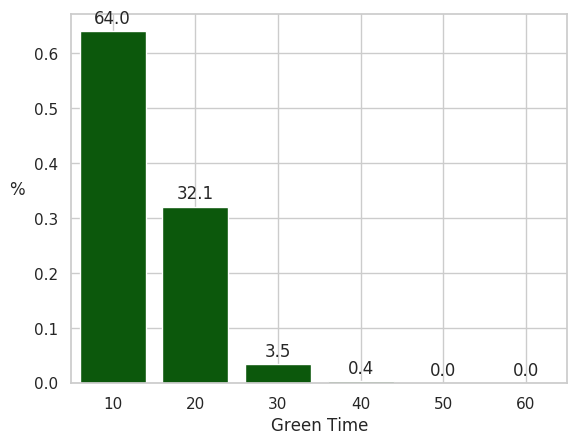

In [163]:
plotAct(wt_low_10, 10,'')

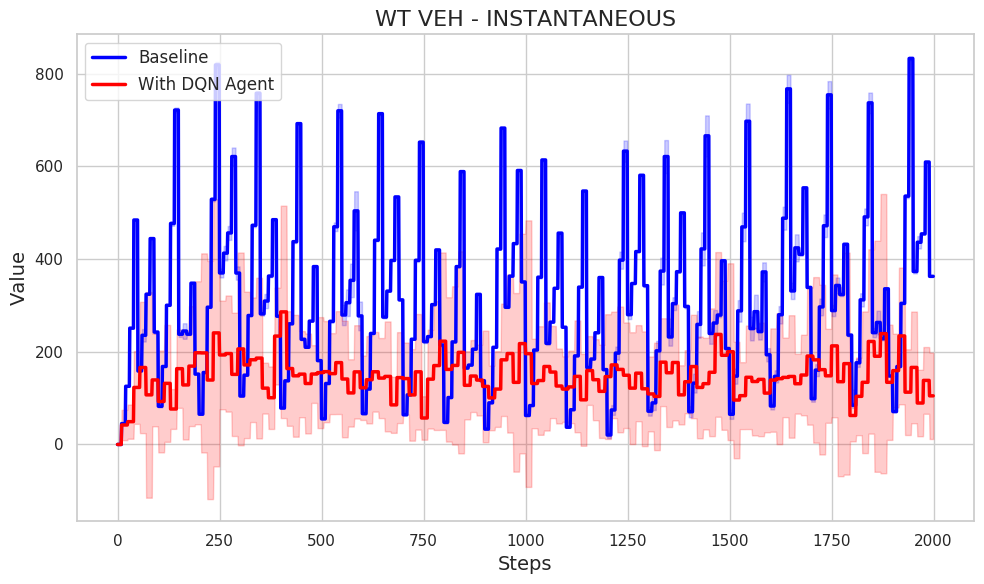

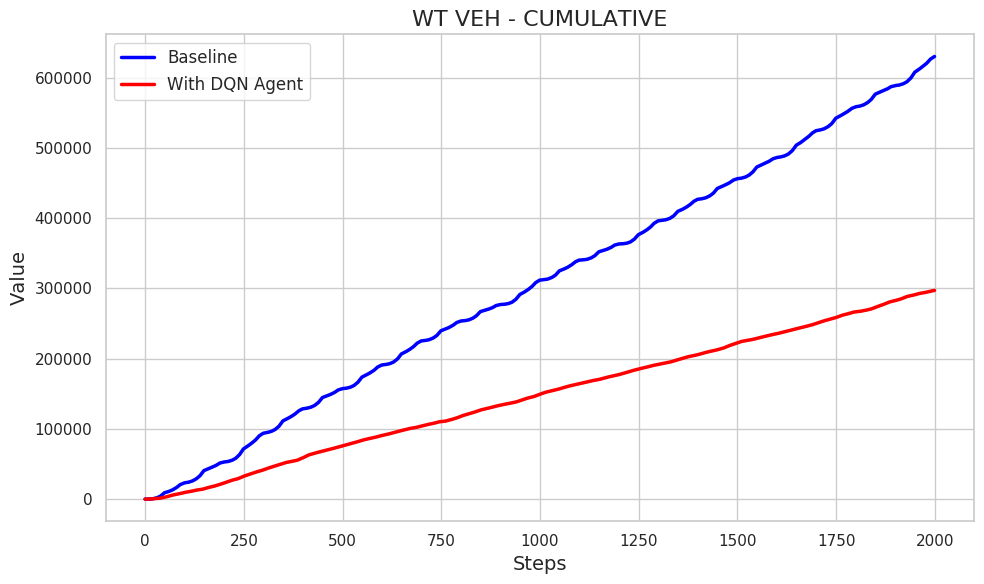

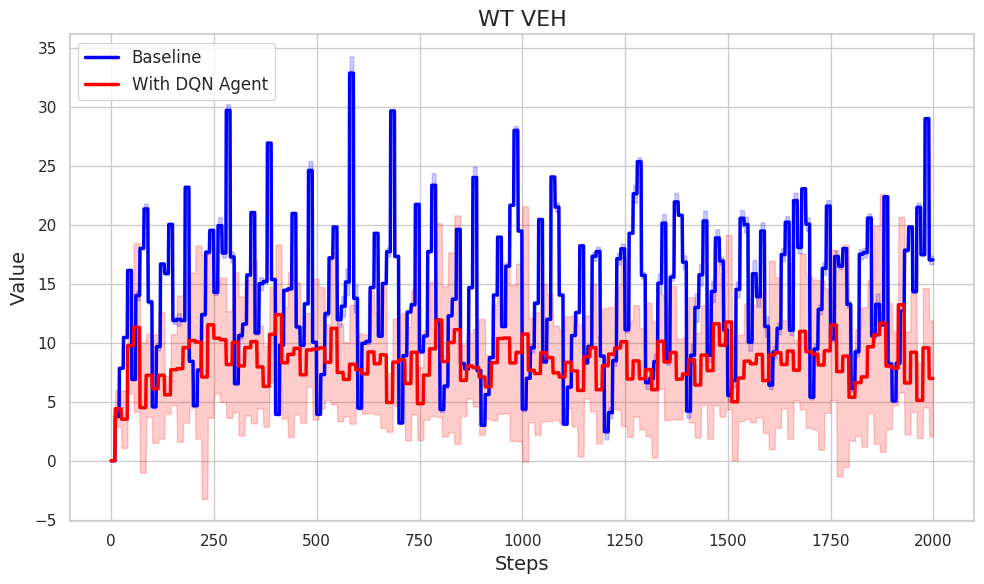

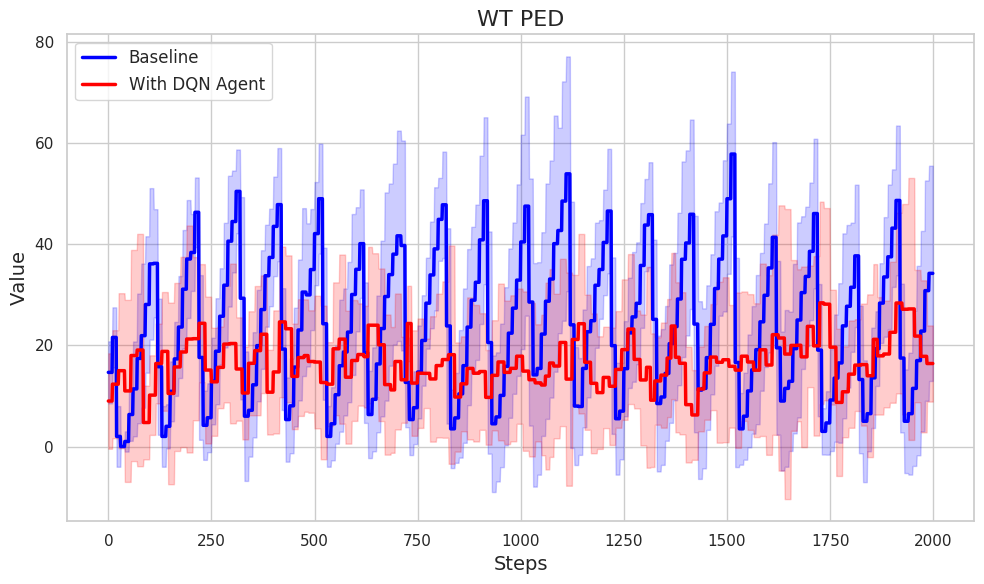

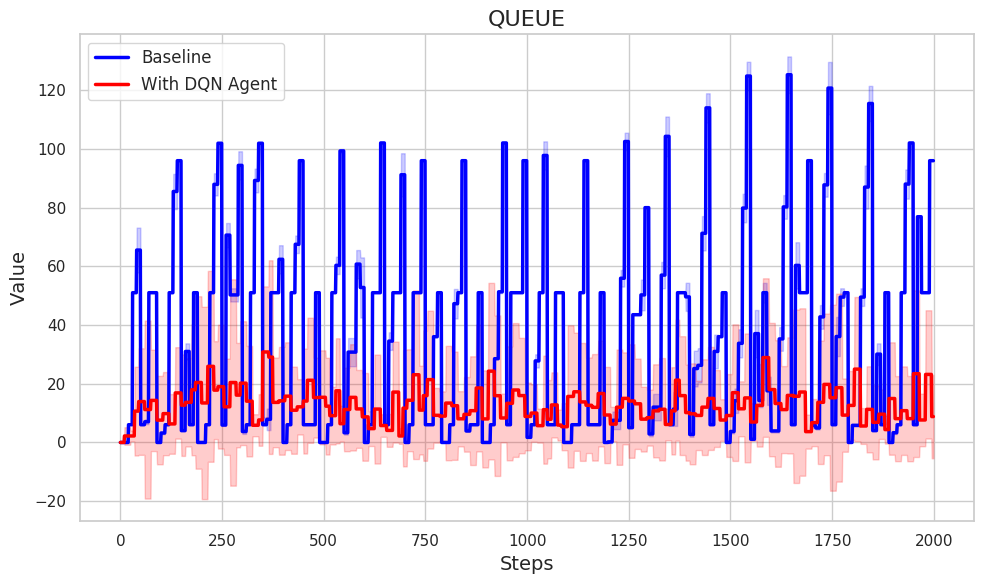

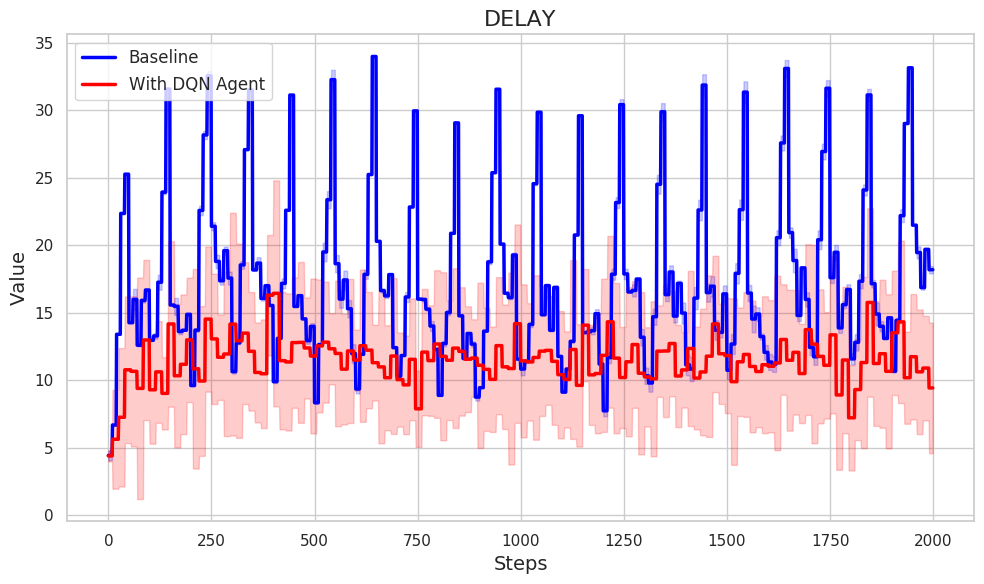

In [71]:
wt_low_10 = pd.read_csv('results/stats_ped/wt_low') #wt_low_10 #mix_low [better] #wt_low_10_pen20_1ott #wt_beta03_low_mixlarge

wt_low_10_V, wt_low_10_Vm, wt_low_10_Vs  = getRes(10, wt_low_10, 'wt_veh')
wt_low_10_Vm_full, wt_low_10_Vs_full = enl(wt_low_10_V, wt_low_10_Vm,wt_low_10_Vs, 10)
defPlot(base_low_Vm_full, base_low_Vs_full, wt_low_10_Vm_full[:2000], wt_low_10_Vs_full[:2000], 'WT VEH - INSTANTANEOUS')
defPlot(np.cumsum(base_low_Vm_full), (base_low_Vs_full), np.cumsum(wt_low_10_Vm_full[:2000]), (wt_low_10_Vs_full[:2000]), 'WT VEH - CUMULATIVE')

wt_low_10_IV, wt_low_10_IVm, wt_low_10_IVs  = getRes(10, wt_low_10, 'wt_veh_ind')
wt_low_10_IVm_full, wt_low_10_IVs_full = enl(wt_low_10_IV, wt_low_10_IVm, wt_low_10_IVs, 10)
defPlot(base_low_IVm_full, base_low_IVs_full, wt_low_10_IVm_full[:2000], wt_low_10_IVs_full[:2000], 'WT VEH')

wt_low_10_P, wt_low_10_Pm, wt_low_10_Ps = getRes(10, wt_low_10, 'wt_ped')
wt_low_10_Pm_full, wt_low_10_Ps_full = enl(wt_low_10_P, wt_low_10_Pm, wt_low_10_Ps, 10)
defPlot(base_low_Pm_full, base_low_Ps_full, wt_low_10_Pm_full[:2000], wt_low_10_Ps_full[:2000], 'WT PED')

wt_low_10_Q, wt_low_10_Qm, wt_low_10_Qs = getRes(10, wt_low_10, 'queue')
wt_low_10_Qm_full, wt_low_10_Qs_full = enl(wt_low_10_Q, wt_low_10_Qm, wt_low_10_Qs, 10)
defPlot(base_low_Qm_full, base_low_Qs_full, wt_low_10_Qm_full[:2000], wt_low_10_Qs_full[:2000], 'QUEUE')

wt_low_10_D, wt_low_10_Dm, wt_low_10_Ds = getRes(10, wt_low_10, 'delay')
wt_low_10_Dm_full, wt_low_10_Ds_full = enl(wt_low_10_D, wt_low_10_Dm, wt_low_10_Ds, 10)
defPlot(base_low_Dm_full, base_low_Ds_full, wt_low_10_Dm_full[:2000], wt_low_10_Ds_full[:2000], 'DELAY')

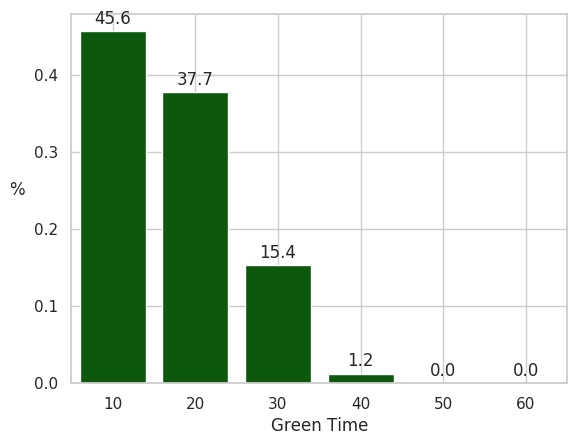

In [164]:
plotAct(wt_mid_10, 10, '')

##### moderate traffic (500-850 x2)

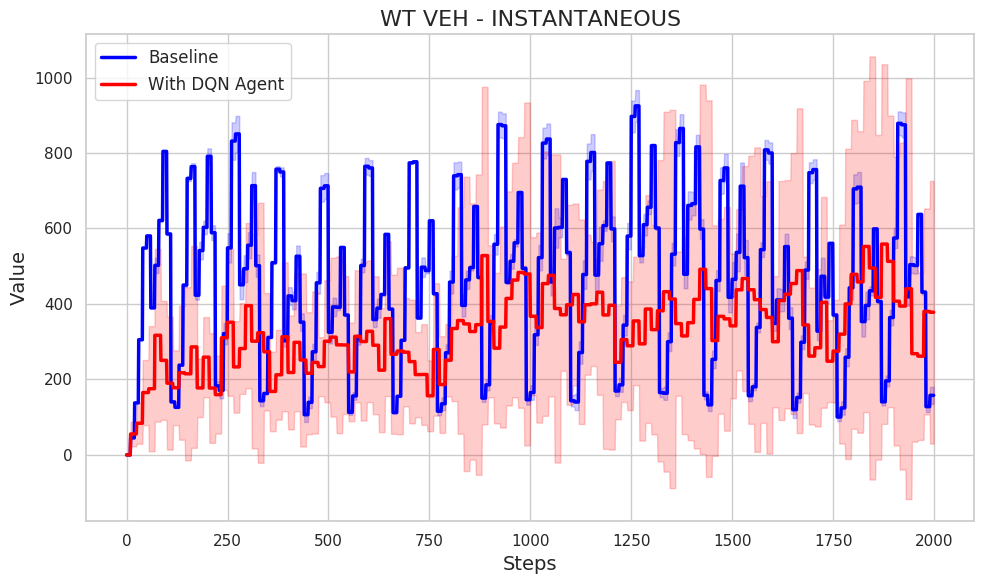

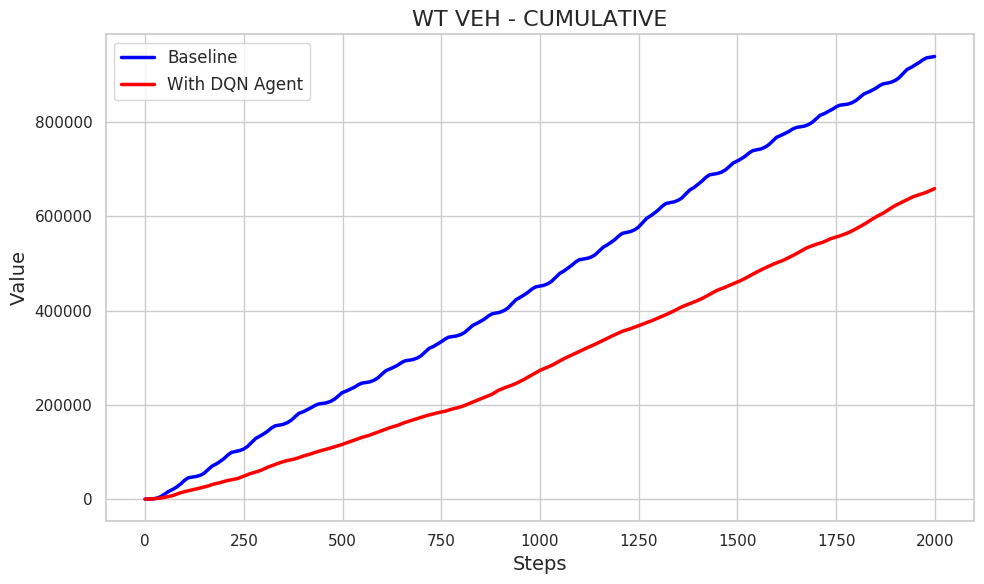

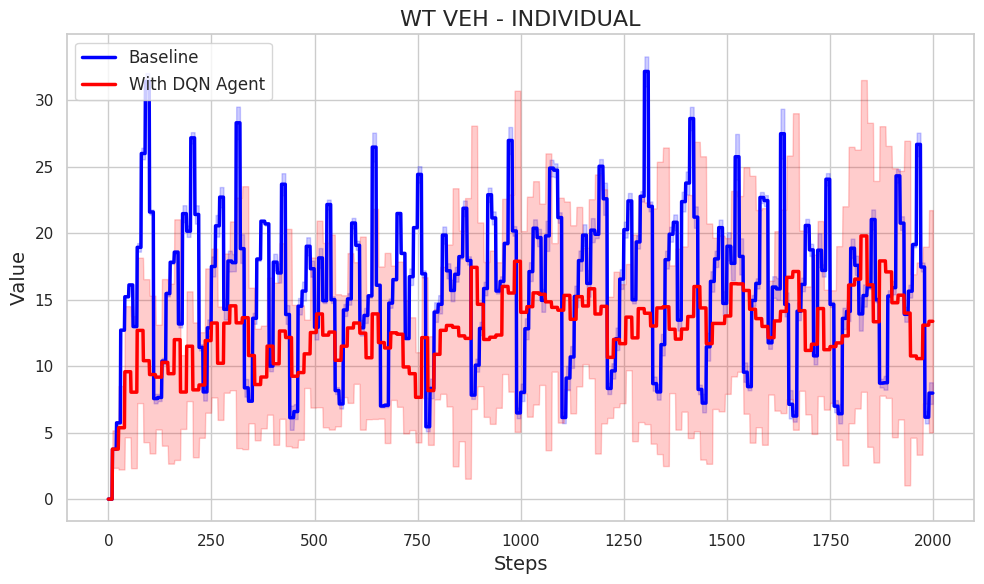

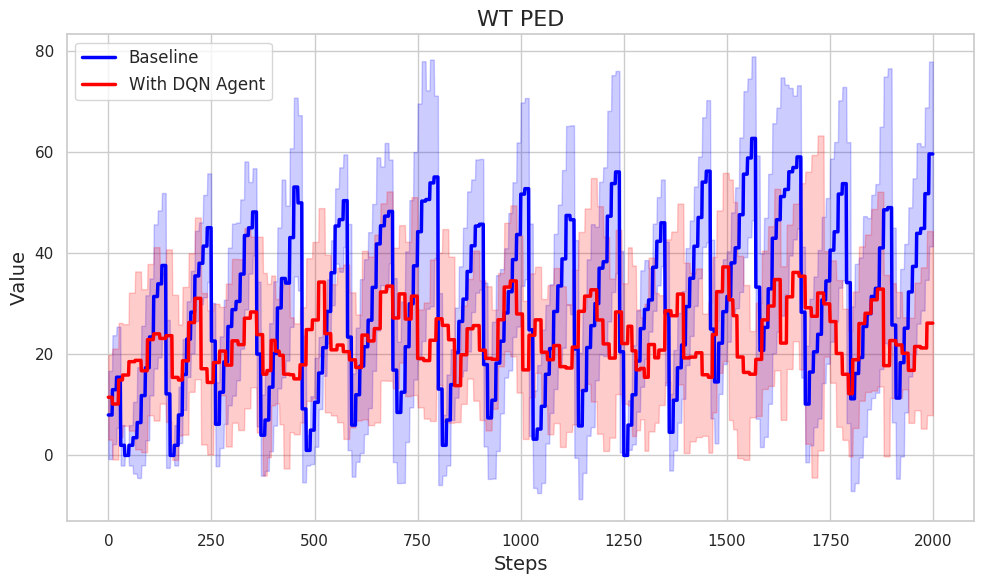

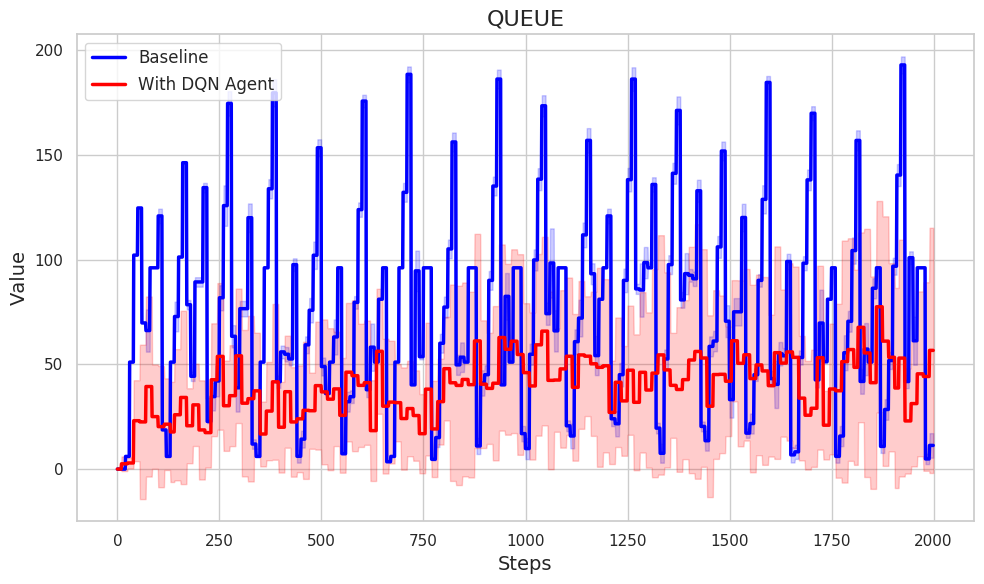

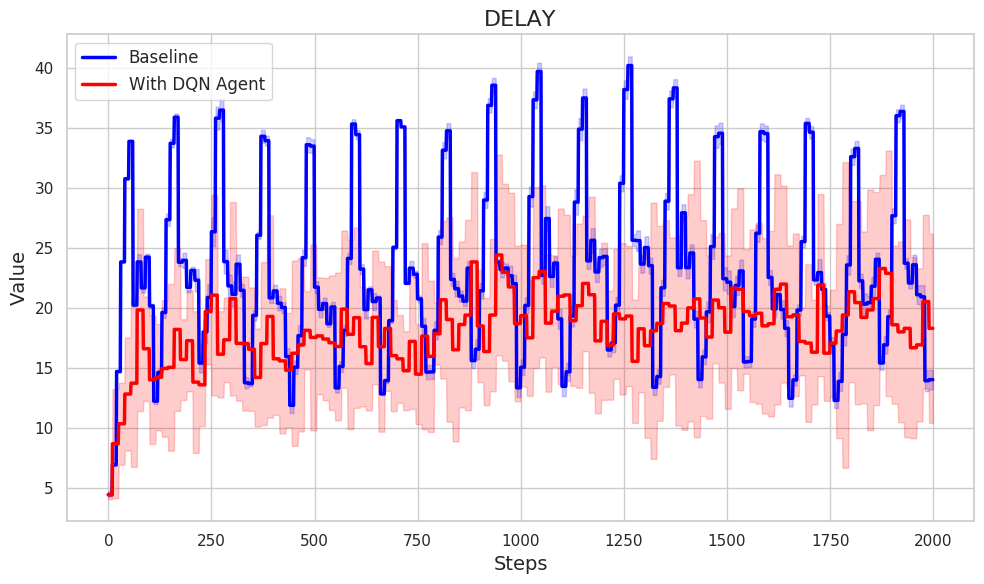

In [72]:
wt_mid_10 = pd.read_csv('results/stats_ped/wt_mid') #mix_mid #test_graal_10_mid #wt_mid_10_pen20_1ott    #wt_beta03_mid_mixlarge_2 #wt_mixfin_mid #wt_beta2

wt_mid_10_V, wt_mid_10_Vm, wt_mid_10_Vs  = getRes(10, wt_mid_10, 'wt_veh')
wt_mid_10_Vm_full, wt_mid_10_Vs_full = enl(wt_mid_10_V, wt_mid_10_Vm,wt_mid_10_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wt_mid_10_Vm_full[:2000], wt_mid_10_Vs_full[:2000], 'WT VEH - INSTANTANEOUS')

#cumulative_variance_base = np.cumsum(np.array(base_mid_Vs2_full)**2) / np.arange(1, len(base_mid_Vs2_full) + 1)**2
#cumulative_std_base = np.sqrt(cumulative_variance_base)
#cumulative_variance = np.cumsum(np.array(wt_mid_10_Vs_full)**2) / np.arange(1, len(wt_mid_10_Vs_full) + 1)**2
#cumulative_std = np.sqrt(cumulative_variance)
defPlot(np.cumsum(base_mid_Vm_full), (base_mid_Vs_full), np.cumsum(wt_mid_10_Vm_full[:2000]), (wt_mid_10_Vs_full[:2000]), 'WT VEH - CUMULATIVE')

wt_mid_10_IV, wt_mid_10_IVm, wt_mid_10_IVs  = getRes(10, wt_mid_10, 'wt_veh_ind')
wt_mid_10_IVm_full, wt_mid_10_IVs_full = enl(wt_mid_10_IV, wt_mid_10_IVm, wt_mid_10_IVs, 10)
defPlot(base_mid_IVm_full, base_mid_IVs_full, wt_mid_10_IVm_full[:2000], wt_mid_10_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wt_mid_10_P, wt_mid_10_Pm, wt_mid_10_Ps = getRes(10, wt_mid_10, 'wt_ped')
wt_mid_10_Pm_full, wt_mid_10_Ps_full = enl(wt_mid_10_P, wt_mid_10_Pm, wt_mid_10_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wt_mid_10_Pm_full[:2000], wt_mid_10_Ps_full[:2000], 'WT PED')

wt_mid_10_Q, wt_mid_10_Qm, wt_mid_10_Qs = getRes(10, wt_mid_10, 'queue')
wt_mid_10_Qm_full, wt_mid_10_Qs_full = enl(wt_mid_10_Q, wt_mid_10_Qm, wt_mid_10_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wt_mid_10_Qm_full[:2000], wt_mid_10_Qs_full[:2000], 'QUEUE')

wt_mid_10_D, wt_mid_10_Dm, wt_mid_10_Ds = getRes(10, wt_mid_10, 'delay')
wt_mid_10_Dm_full, wt_mid_10_Ds_full = enl(wt_mid_10_D, wt_mid_10_Dm, wt_mid_10_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wt_mid_10_Dm_full[:2000], wt_mid_10_Ds_full[:2000], 'DELAY')

In [ ]:
wt_mid_10 = pd.read_csv('results/stats_ped/wt_mixfin_mid') #mix_mid #test_graal_10_mid #wt_mid_10_pen20_1ott    #wt_beta03_mid_mixlarge_2

wt_mid_10_V, wt_mid_10_Vm, wt_mid_10_Vs  = getRes(10, wt_mid_10, 'wt_veh')
wt_mid_10_Vm_full, wt_mid_10_Vs_full = enl(wt_mid_10_V, wt_mid_10_Vm,wt_mid_10_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wt_mid_10_Vm_full[:2000], wt_mid_10_Vs_full[:2000], 'WT VEH - INSTANTANEOUS')

#cumulative_variance_base = np.cumsum(np.array(base_mid_Vs2_full)**2) / np.arange(1, len(base_mid_Vs2_full) + 1)**2
#cumulative_std_base = np.sqrt(cumulative_variance_base)
#cumulative_variance = np.cumsum(np.array(wt_mid_10_Vs_full)**2) / np.arange(1, len(wt_mid_10_Vs_full) + 1)**2
#cumulative_std = np.sqrt(cumulative_variance)
defPlot(np.cumsum(base_mid_Vm_full), (base_mid_Vs_full), np.cumsum(wt_mid_10_Vm_full[:2000]), (wt_mid_10_Vs_full[:2000]), 'WT VEH - CUMULATIVE')

wt_mid_10_IV, wt_mid_10_IVm, wt_mid_10_IVs  = getRes(10, wt_mid_10, 'wt_veh_ind')
wt_mid_10_IVm_full, wt_mid_10_IVs_full = enl(wt_mid_10_IV, wt_mid_10_IVm, wt_mid_10_IVs, 10)
defPlot(base_mid_IVm_full, base_mid_IVs_full, wt_mid_10_IVm_full[:2000], wt_mid_10_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wt_mid_10_P, wt_mid_10_Pm, wt_mid_10_Ps = getRes(10, wt_mid_10, 'wt_ped')
wt_mid_10_Pm_full, wt_mid_10_Ps_full = enl(wt_mid_10_P, wt_mid_10_Pm, wt_mid_10_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wt_mid_10_Pm_full[:2000], wt_mid_10_Ps_full[:2000], 'WT PED')

wt_mid_10_Q, wt_mid_10_Qm, wt_mid_10_Qs = getRes(10, wt_mid_10, 'queue')
wt_mid_10_Qm_full, wt_mid_10_Qs_full = enl(wt_mid_10_Q, wt_mid_10_Qm, wt_mid_10_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wt_mid_10_Qm_full[:2000], wt_mid_10_Qs_full[:2000], 'QUEUE')

wt_mid_10_D, wt_mid_10_Dm, wt_mid_10_Ds = getRes(10, wt_mid_10, 'delay')
wt_mid_10_Dm_full, wt_mid_10_Ds_full = enl(wt_mid_10_D, wt_mid_10_Dm, wt_mid_10_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wt_mid_10_Dm_full[:2000], wt_mid_10_Ds_full[:2000], 'DELAY')

##### heavy traffic (600-1000 x2)

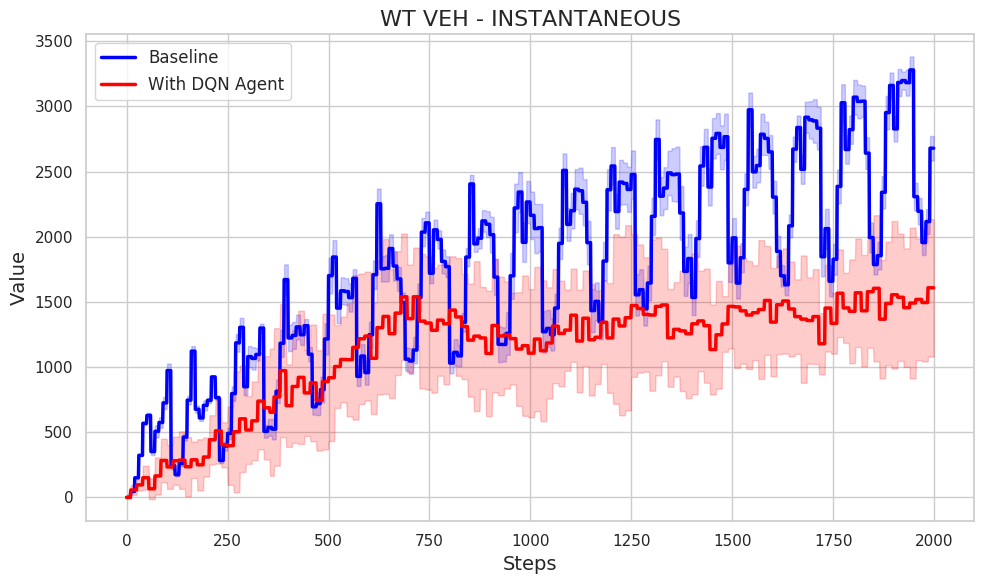

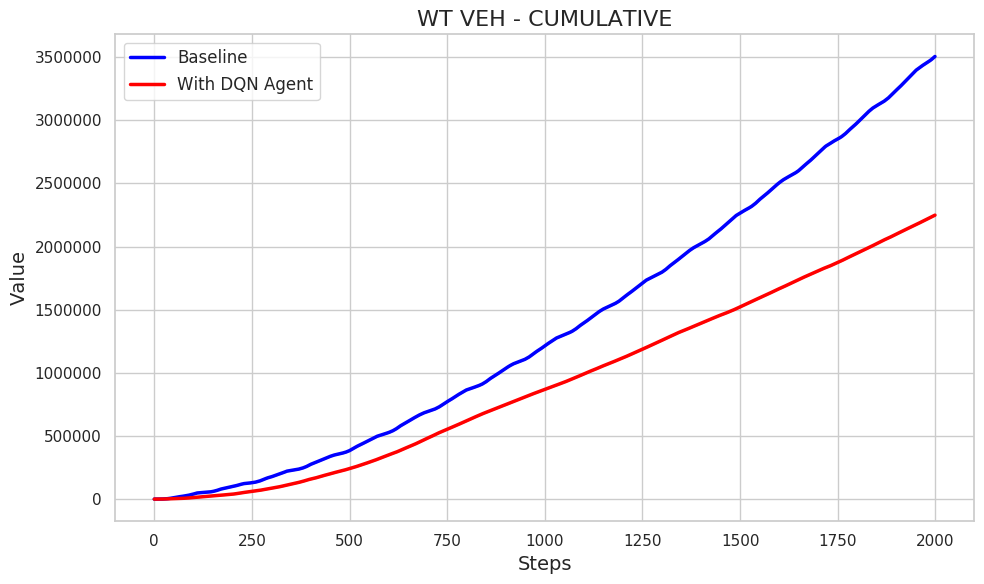

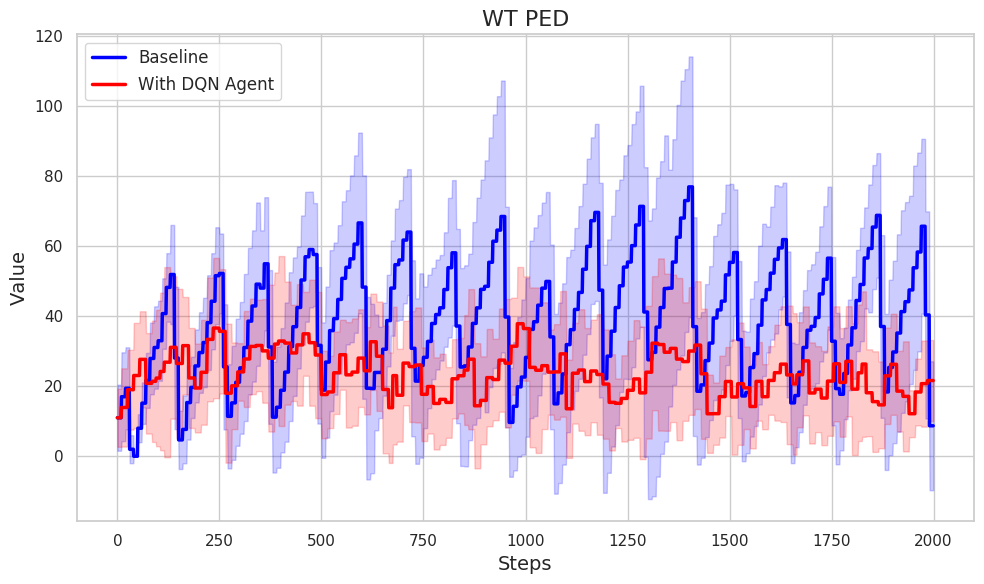

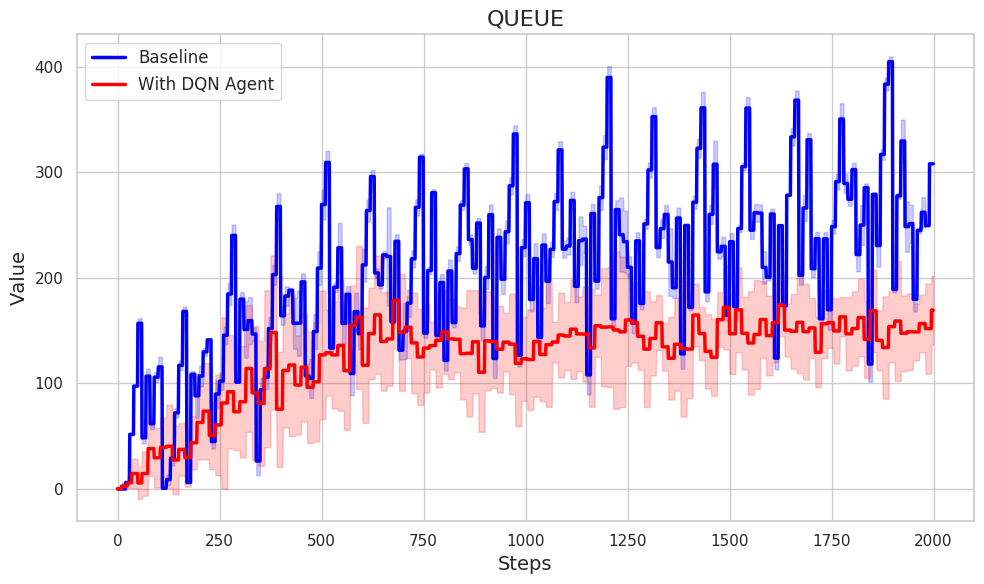

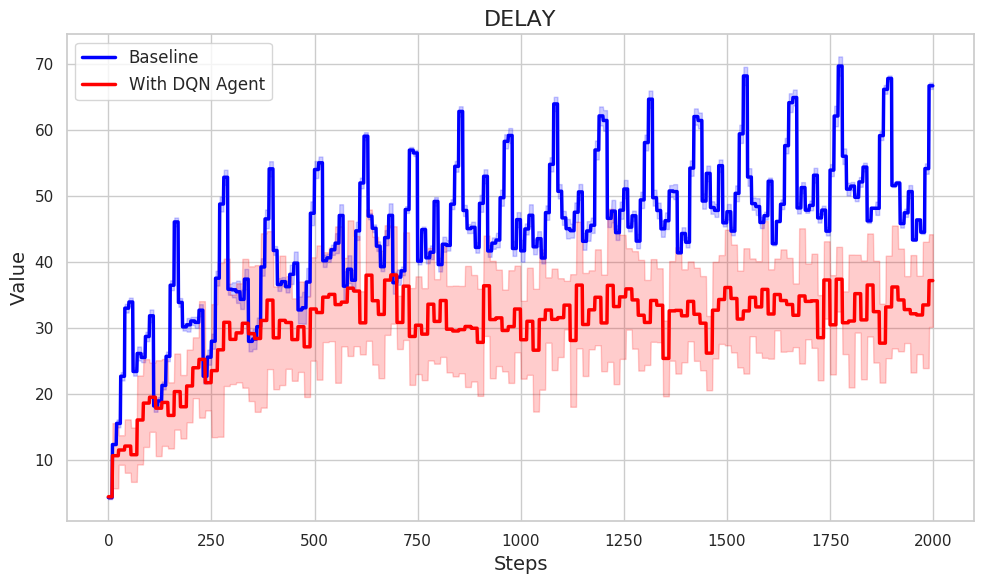

In [73]:
wt_high_10 = pd.read_csv('results/stats_ped/wt_high') #wt_mixfin_high_2
#wt_high_10 = pd.read_csv('results/stats_ped/wt_beta03_high_mixlarge') #wt_high_10_4 #mix_high wt_high_10_pen20_1ott_2
#wt_high_10_3 = pd.read_csv('results/stats_ped/wt_high_10_pen20_1ott_3')


wt_high_10_V, wt_high_10_Vm, wt_high_10_Vs  = getRes(10, wt_high_10, 'wt_veh')
wt_high_10_Vm_full, wt_high_10_Vs_full = enl(wt_high_10_V, wt_high_10_Vm,wt_high_10_Vs, 10)
defPlot(base_high_Vm_full, base_high_Vs_full, wt_high_10_Vm_full[:2000], wt_high_10_Vs_full[:2000], 'WT VEH - INSTANTANEOUS')
defPlot(np.cumsum(base_high_Vm_full), (base_high_Vs_full), np.cumsum(wt_high_10_Vm_full[:2000]), (wt_high_10_Vs_full[:2000]), 'WT VEH - CUMULATIVE')

wt_high_10_P, wt_high_10_Pm, wt_high_10_Ps = getRes(10, wt_high_10, 'wt_ped')
wt_high_10_Pm_full, wt_high_10_Ps_full = enl(wt_high_10_P, wt_high_10_Pm, wt_high_10_Ps, 10)
defPlot(base_high_Pm_full, base_high_Ps_full, wt_high_10_Pm_full[:2000], wt_high_10_Ps_full[:2000], 'WT PED')

wt_high_10_Q, wt_high_10_Qm, wt_high_10_Qs = getRes(10, wt_high_10, 'queue')
wt_high_10_Qm_full, wt_high_10_Qs_full = enl(wt_high_10_Q, wt_high_10_Qm, wt_high_10_Qs, 10)
defPlot(base_high_Qm_full, base_high_Qs_full, wt_high_10_Qm_full[:2000], wt_high_10_Qs_full[:2000], 'QUEUE')

wt_high_10_D, wt_high_10_Dm, wt_high_10_Ds = getRes(10, wt_high_10, 'delay')
wt_high_10_Dm_full, wt_high_10_Ds_full = enl(wt_high_10_D, wt_high_10_Dm, wt_high_10_Ds, 10)
defPlot(base_high_Dm_full, base_high_Ds_full, wt_high_10_Dm_full[:2000], wt_high_10_Ds_full[:2000], 'DELAY')

##### Comparison

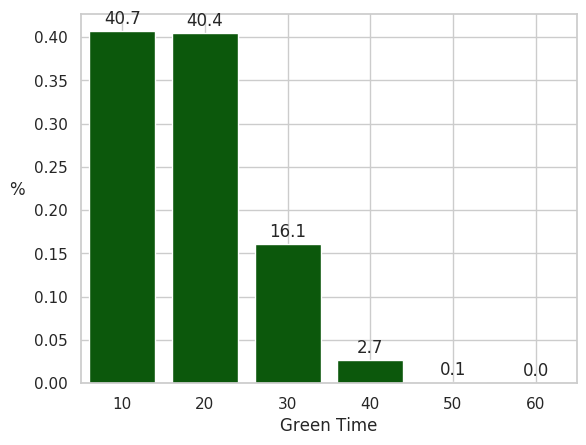

In [79]:
plotAct(wt_mid_10, 10, '')

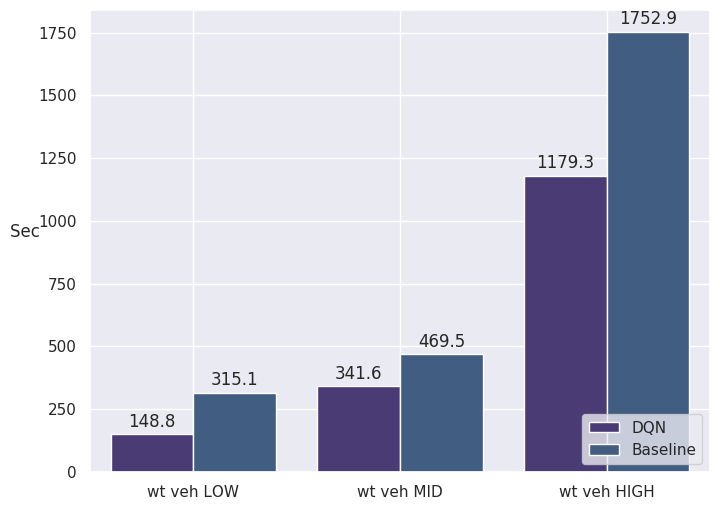

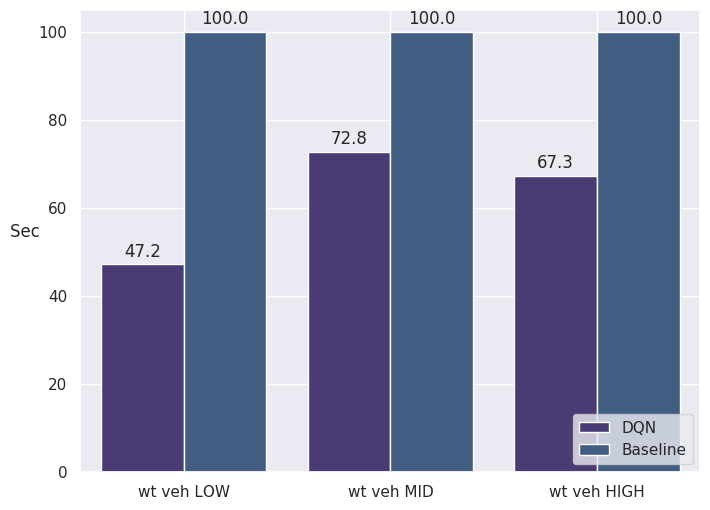

In [74]:
wtbase = {'wt veh LOW':np.mean(base_low_Vm), 'wt veh MID':np.mean(base_mid_Vm), 'wt veh HIGH':np.mean(base_high_Vm)}
wtdct = {'wt veh LOW':np.mean(wt_low_10_Vm), 'wt veh MID':np.mean(wt_mid_10_Vm), 'wt veh HIGH':np.mean(wt_high_10_Vm)} 

histComp(wtbase, wtdct, ['DQN', 'Baseline'], '') #'Comparison Total WT Veh')

wtbase = {'wt veh LOW':np.mean(base_low_Vm)*100/np.mean(base_low_Vm), 'wt veh MID':np.mean(base_mid_Vm)*100/np.mean(base_mid_Vm), 'wt veh HIGH':np.mean(base_high_Vm_full)*100/np.mean(base_high_Vm)}
wtdct = {'wt veh LOW':np.mean(wt_low_10_Vm)*100/np.mean(base_low_Vm), 'wt veh MID':np.mean(wt_mid_10_Vm)*100/np.mean(base_mid_Vm), 'wt veh HIGH':(np.mean(wt_high_10_Vm))*100/np.mean(base_high_Vm)} 

histComp(wtbase, wtdct, ['DQN', 'Baseline'], '') #'Comparison Total WT Veh')

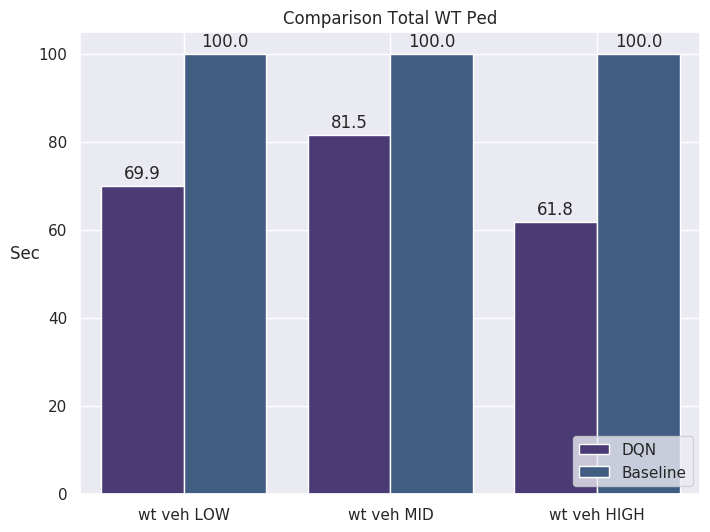

In [75]:
wtbase = {'wt veh LOW':np.mean(base_low_Pm)*100/np.mean(base_low_Pm), 'wt veh MID':np.mean(base_mid_Pm)*100/np.mean(base_mid_Pm), 'wt veh HIGH':np.mean(base_high_Pm_full)*100/np.mean(base_high_Pm)}
wtdct = {'wt veh LOW':np.mean(wt_low_10_Pm)*100/np.mean(base_low_Pm), 'wt veh MID':np.mean(wt_mid_10_Pm)*100/np.mean(base_mid_Pm), 'wt veh HIGH':(np.mean(wt_high_10_Pm))*100/np.mean(base_high_Pm)} 

histComp(wtbase, wtdct, ['DQN', 'Baseline'], 'Comparison Total WT Ped')

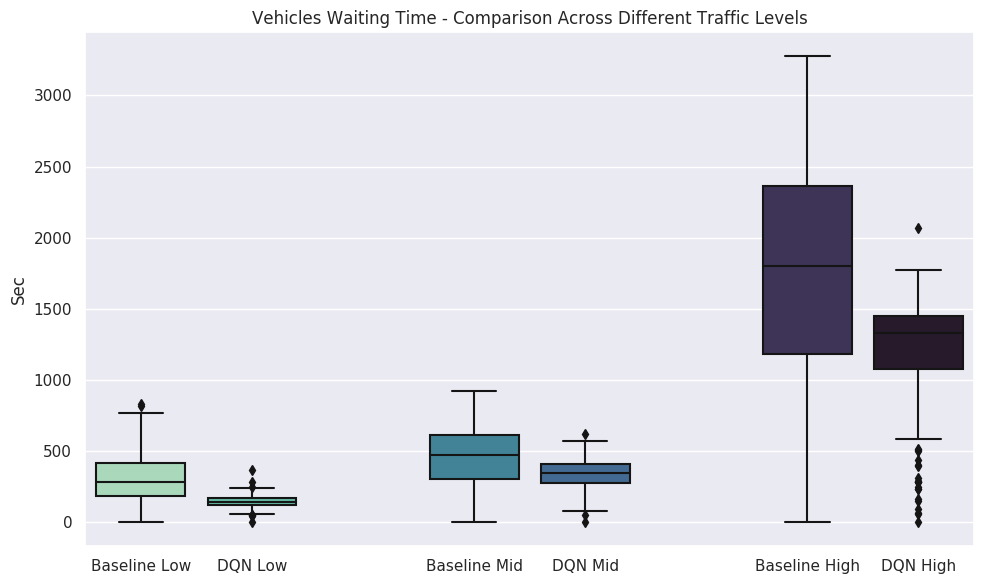

In [76]:
sns.set(style="darkgrid")

data = [base_low_Vm, wt_low_10_Vm, [], base_mid_Vm, wt_mid_10_Vm, [], base_high_Vm, wt_high_10_Vm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(10, 6))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Vehicles Waiting Time - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

In [ ]:
sns.set(style="darkgrid")

data = [base_low_IVm, wt_low_10_IVm, [], base_mid_IVm, wt_mid_10_IVm, [], base_high_IVm, wt_high_10_IVm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(10, 6))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Vehicles Waiting Time - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

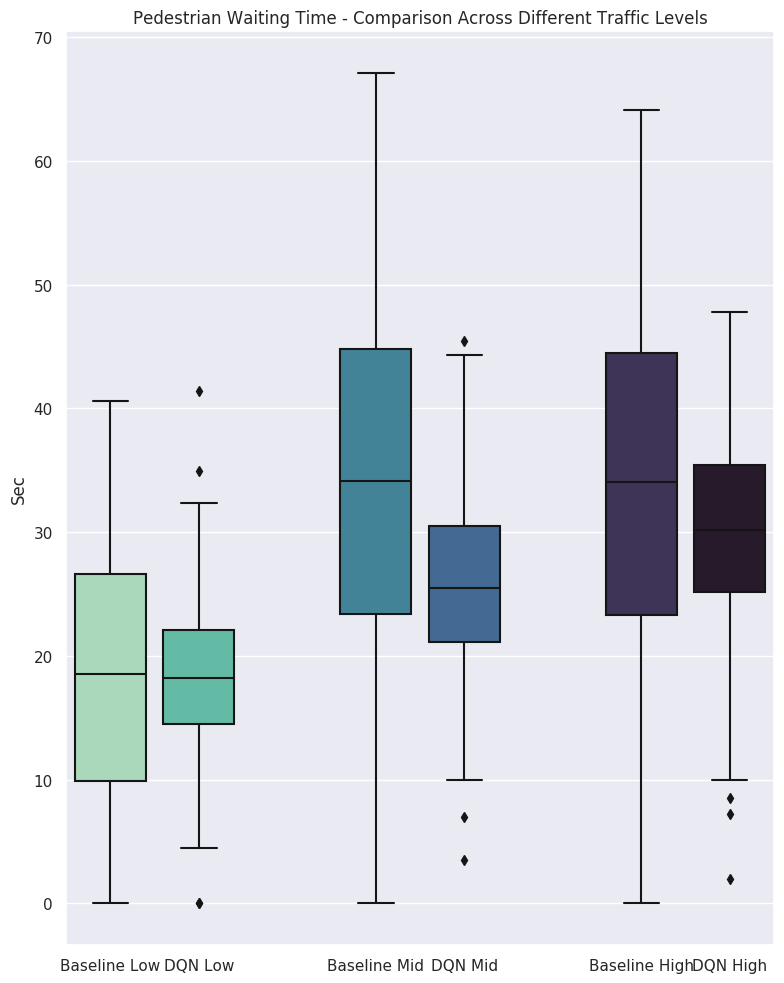

In [206]:
sns.set(style="darkgrid")

data = [base_low_Pm, wt_low_10_Pm, [], base_mid_Pm, wt_mid_10_Pm, [], base_high_Pm, wt_high_10_Pm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(8, 10))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Pedestrian Waiting Time - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

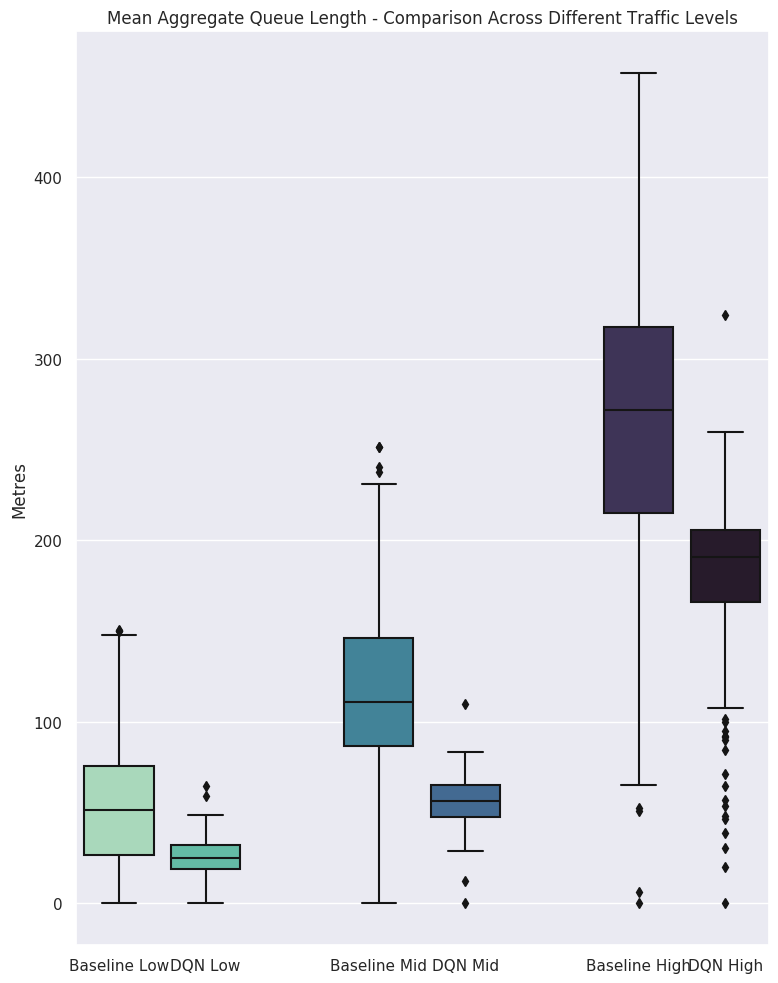

In [89]:
sns.set(style="darkgrid")

data = [base_low_Qm, wt_low_10_Qm, [], base_mid_Qm, wt_mid_10_Qm, [], base_high_Qm, wt_high_10_Qm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(8, 10))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Mean Aggregate Queue Length - Comparison Across Different Traffic Levels')
plt.ylabel('Metres')

plt.tight_layout()
plt.show()

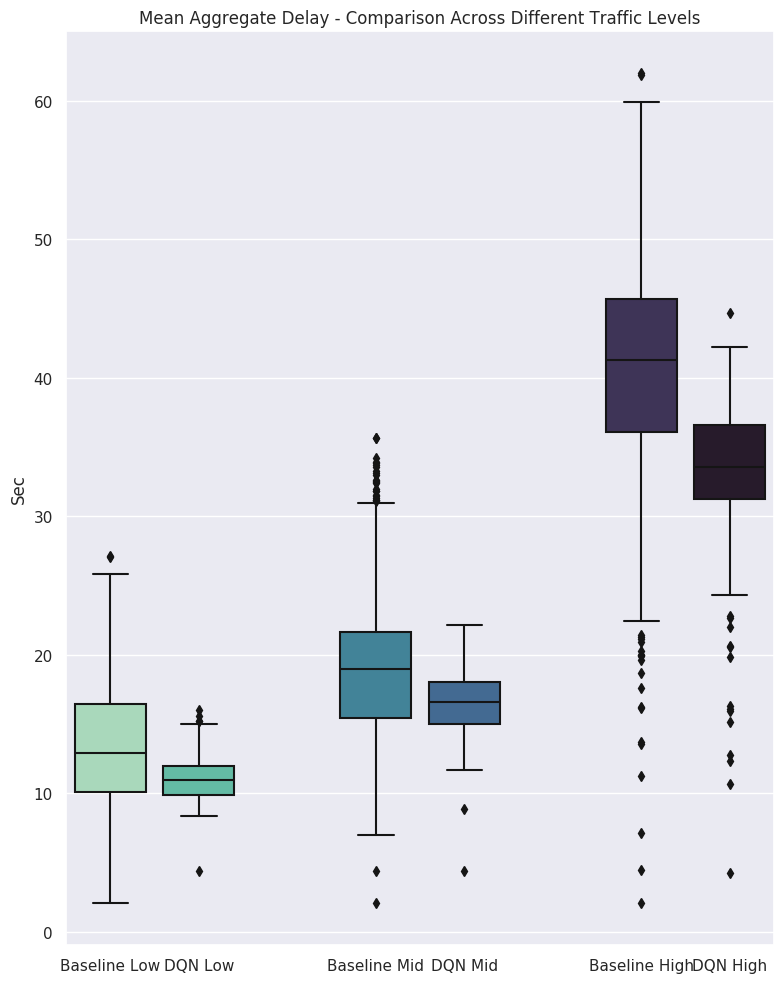

In [208]:
sns.set(style="darkgrid")

data = [base_low_Dm, wt_low_10_Dm, [], base_mid_Dm, wt_mid_10_Dm, [], base_high_Dm, wt_high_10_Dm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(8, 10))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Mean Aggregate Delay - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

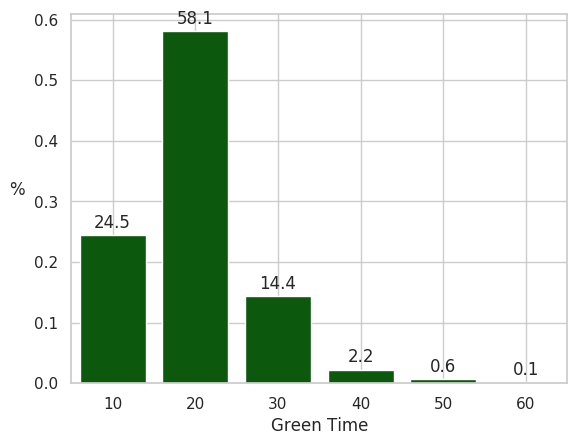

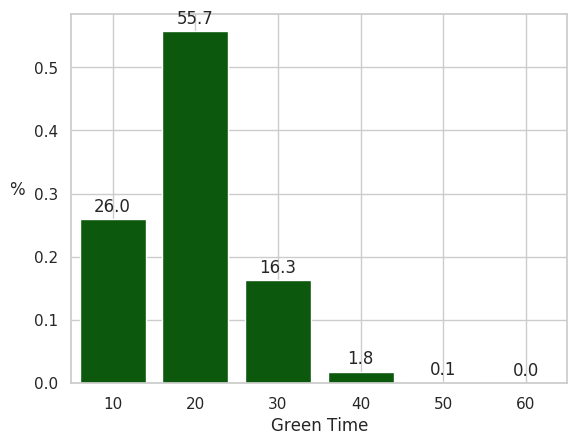

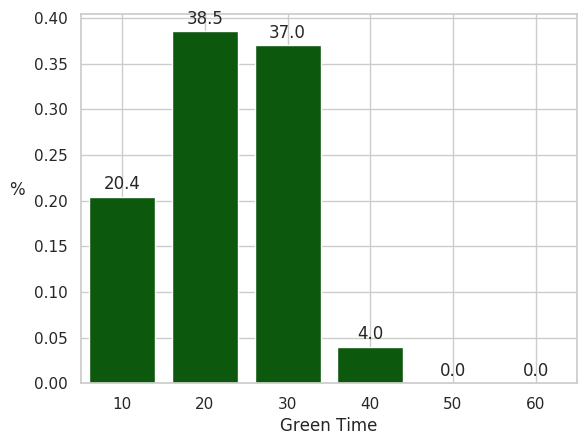

In [28]:
plotAct(wt_low_10_2, 10, '')
plotAct(wt_mid_10, 10, '')
plotAct(wt_high_10, 10, '')

#### WEIGHTS VARIATION

##### Beta = 0.05

In [ ]:
wtb05_df = pd.read_csv('results/stats_ped/wt_beta05')

wtb05_V, wtb05_Vm, wtb05_Vs  = getRes(10, wtb05_df, 'wt_veh')
wtb05_Vm_full, wtb05_Vs_full = enl(wtb05_V, wtb05_Vm,wtb05_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wtb05_Vm_full[:2000], wtb05_Vs_full[:2000], 'WT VEH')

wtb05_IV, wtb05_IVm, wtb05_IVs  = getRes(10, wtb05_df, 'wt_veh_ind')
wtb05_IVm_full, wtb05_IVs_full = enl(wtb05_IV, wtb05_IVm,wtb05_IVs, 10)
#defPlot(base_mid_IVm_full, base_mid_IVs_full, wtb05_IVm_full[:2000], wtb05_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wtb05_P, wtb05_Pm, wtb05_Ps = getRes(10, wtb05_df, 'wt_ped')
wtb05_Pm_full, wtb05_Ps_full = enl(wtb05_P, wtb05_Pm, wtb05_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wtb05_Pm_full[:2000], wtb05_Ps_full[:2000], 'WT PED')

wtb05_Q, wtb05_Qm, wtb05_Qs = getRes(10, wtb05_df, 'queue')
wtb05_Qm_full, wtb05_Qs_full = enl(wtb05_Q, wtb05_Qm, wtb05_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wtb05_Qm_full[:2000], wtb05_Qs_full[:2000], 'QUEUE')

wtb05_D, wtb05_Dm, wtb05_Ds = getRes(10, wtb05_df, 'delay')
wtb05_Dm_full, wtb05_Ds_full = enl(wtb05_D, wtb05_Dm, wtb05_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wtb05_Dm_full[:2000], wtb05_Ds_full[:2000], 'DELAY')

##### Beta = 0.1

In [ ]:
wtb1_df = pd.read_csv('results/stats_ped/wt_beta1')

wtb1_V, wtb1_Vm, wtb1_Vs  = getRes(10, wtb1_df, 'wt_veh')
wtb1_Vm_full, wtb1_Vs_full = enl(wtb1_V, wtb1_Vm,wtb1_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wtb1_Vm_full[:2000], wtb1_Vs_full[:2000], 'WT VEH')

wtb1_IV, wtb1_IVm, wtb1_IVs  = getRes(10, wtb1_df, 'wt_veh_ind')
wtb1_IVm_full, wtb1_IVs_full = enl(wtb1_IV, wtb1_IVm, wtb1_IVs, 10)
#defPlot(base_mid_IVm_full, base_mid_IVs_full, wtb1_IVm_full[:2000], wtb1_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wtb1_P, wtb1_Pm, wtb1_Ps = getRes(10, wtb1_df, 'wt_ped')
wtb1_Pm_full, wtb1_Ps_full = enl(wtb1_P, wtb1_Pm, wtb1_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wtb1_Pm_full[:2000], wtb1_Ps_full[:2000], 'WT PED')

wtb1_Q, wtb1_Qm, wtb1_Qs = getRes(10, wtb1_df, 'queue')
wtb1_Qm_full, wtb1_Qs_full = enl(wtb1_Q, wtb1_Qm, wtb1_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wtb1_Qm_full[:2000], wtb1_Qs_full[:2000], 'QUEUE')

wtb1_D, wtb1_Dm, wtb1_Ds = getRes(10, wtb1_df, 'delay')
wtb1_Dm_full, wtb1_Ds_full = enl(wtb1_D, wtb1_Dm, wtb1_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wtb1_Dm_full[:2000], wtb1_Ds_full[:2000], 'DELAY')

##### Beta = 0.2

In [ ]:
wtb2_df = pd.read_csv('results/stats_ped/wt_beta2')

wtb2_V, wtb2_Vm, wtb2_Vs  = getRes(10, wtb2_df, 'wt_veh')
wtb2_Vm_full, wtb2_Vs_full = enl(wtb2_V, wtb2_Vm,wtb2_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wtb2_Vm_full[:2000], wtb2_Vs_full[:2000], 'WT VEH')

wtb2_IV, wtb2_IVm, wtb2_IVs  = getRes(10, wtb2_df, 'wt_veh_ind')
wtb2_IVm_full, wtb2_IVs_full = enl(wtb2_IV, wtb2_IVm, wtb2_IVs, 10)
#defPlot(base_mid_IVm_full, base_mid_IVs_full, wtb1_IVm_full[:2000], wtb1_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wtb2_P, wtb2_Pm, wtb2_Ps = getRes(10, wtb2_df, 'wt_ped')
wtb2_Pm_full, wtb2_Ps_full = enl(wtb2_P, wtb2_Pm, wtb2_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wtb2_Pm_full[:2000], wtb2_Ps_full[:2000], 'WT PED')

wtb2_Q, wtb2_Qm, wtb2_Qs = getRes(10, wtb2_df, 'queue')
wtb2_Qm_full, wtb2_Qs_full = enl(wtb2_Q, wtb2_Qm, wtb2_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wtb2_Qm_full[:2000], wtb2_Qs_full[:2000], 'QUEUE')

wtb2_D, wtb2_Dm, wtb2_Ds = getRes(10, wtb2_df, 'delay')
wtb2_Dm_full, wtb2_Ds_full = enl(wtb2_D, wtb2_Dm, wtb2_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wtb2_Dm_full[:2000], wtb2_Ds_full[:2000], 'DELAY')

In [ ]:
wtb3_df = pd.read_csv('results/stats_ped/wt_beta3')

wtb3_V, wtb3_Vm, wtb3_Vs  = getRes(10, wtb3_df, 'wt_veh')
wtb3_Vm_full, wtb3_Vs_full = enl(wtb3_V, wtb3_Vm,wtb3_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wtb3_Vm_full[:2000], wtb3_Vs_full[:2000], 'WT VEH')

wtb3_IV, wtb3_IVm, wtb3_IVs  = getRes(10, wtb3_df, 'wt_veh_ind')
wtb3_IVm_full, wtb3_IVs_full = enl(wtb3_IV, wtb3_IVm, wtb3_IVs, 10)
#defPlot(base_mid_IVm_full, base_mid_IVs_full, wtb1_IVm_full[:2000], wtb1_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wtb3_P, wtb3_Pm, wtb3_Ps = getRes(10, wtb3_df, 'wt_ped')
wtb3_Pm_full, wtb3_Ps_full = enl(wtb3_P, wtb3_Pm, wtb3_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wtb3_Pm_full[:2000], wtb3_Ps_full[:2000], 'WT PED')

wtb3_Q, wtb3_Qm, wtb3_Qs = getRes(10, wtb3_df, 'queue')
wtb3_Qm_full, wtb3_Qs_full = enl(wtb3_Q, wtb3_Qm, wtb3_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wtb3_Qm_full[:2000], wtb3_Qs_full[:2000], 'QUEUE')

wtb3_D, wtb3_Dm, wtb3_Ds = getRes(10, wtb3_df, 'delay')
wtb3_Dm_full, wtb3_Ds_full = enl(wtb3_D, wtb3_Dm, wtb3_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wtb3_Dm_full[:2000], wtb3_Ds_full[:2000], 'DELAY')

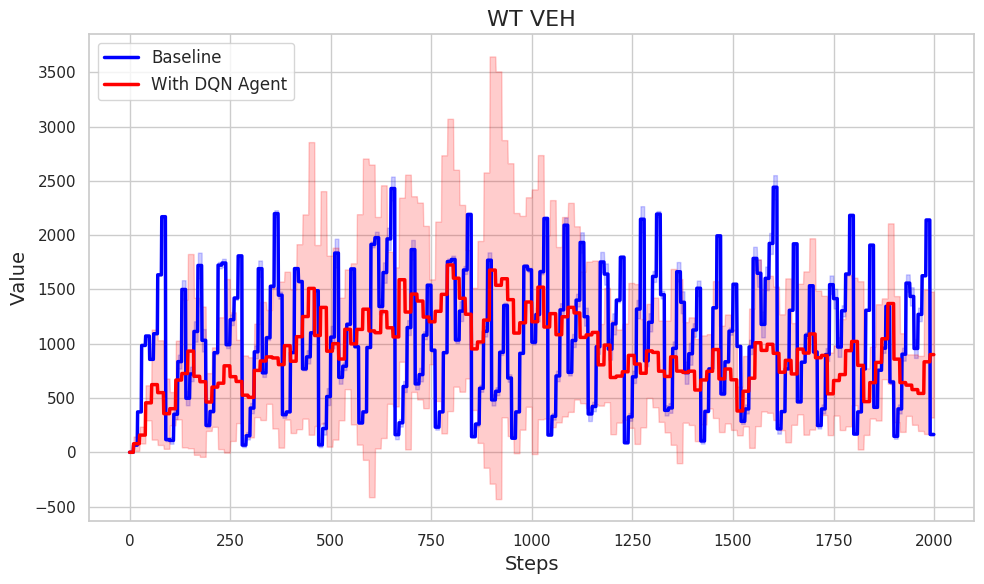

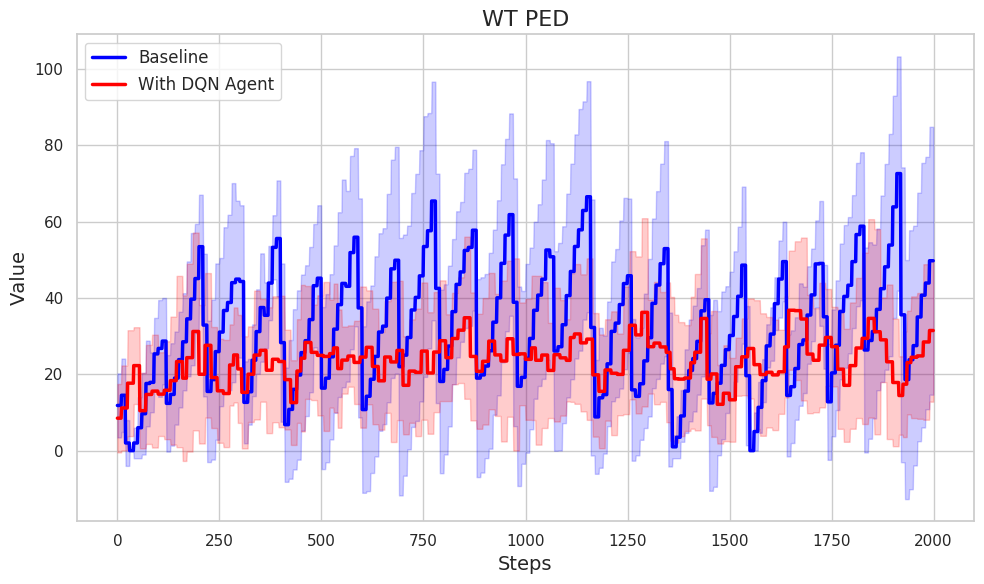

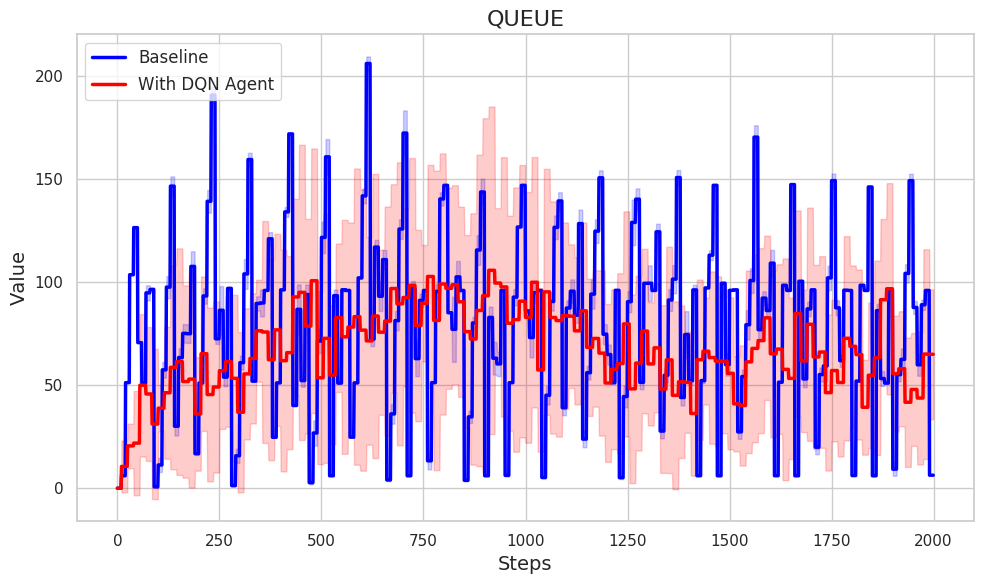

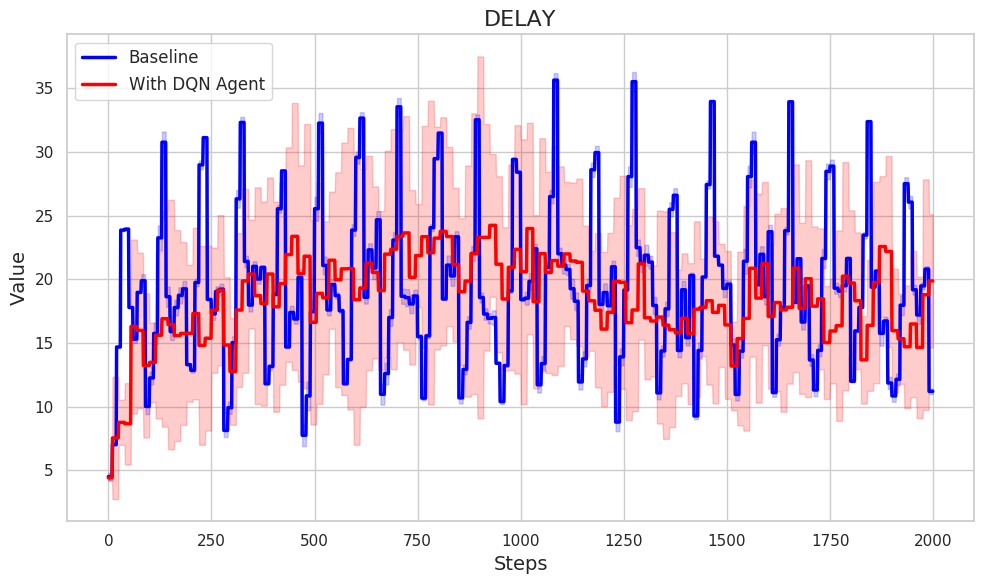

In [317]:
wtb4_df = pd.read_csv('results/stats_ped/wt_beta4_8ott')

wtb4_V, wtb4_Vm, wtb4_Vs  = getRes(10, wtb4_df, 'wt_veh')
wtb4_Vm_full, wtb4_Vs_full = enl(wtb4_V, wtb4_Vm,wtb4_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wtb4_Vm_full[:2000], wtb4_Vs_full[:2000], 'WT VEH')

wtb4_IV, wtb4_IVm, wtb4_IVs  = getRes(10, wtb4_df, 'wt_veh_ind')
wtb4_IVm_full, wtb4_IVs_full = enl(wtb4_IV, wtb4_IVm, wtb4_IVs, 10)
#defPlot(base_mid_IVm_full, base_mid_IVs_full, wtb1_IVm_full[:2000], wtb1_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wtb4_P, wtb4_Pm, wtb4_Ps = getRes(10, wtb4_df, 'wt_ped')
wtb4_Pm_full, wtb4_Ps_full = enl(wtb4_P, wtb4_Pm, wtb4_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wtb4_Pm_full[:2000], wtb4_Ps_full[:2000], 'WT PED')

wtb4_Q, wtb4_Qm, wtb4_Qs = getRes(10, wtb4_df, 'queue')
wtb4_Qm_full, wtb4_Qs_full = enl(wtb4_Q, wtb4_Qm, wtb4_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wtb4_Qm_full[:2000], wtb4_Qs_full[:2000], 'QUEUE')

wtb4_D, wtb4_Dm, wtb4_Ds = getRes(10, wtb4_df, 'delay')
wtb4_Dm_full, wtb4_Ds_full = enl(wtb4_D, wtb4_Dm, wtb4_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wtb4_Dm_full[:2000], wtb4_Ds_full[:2000], 'DELAY')

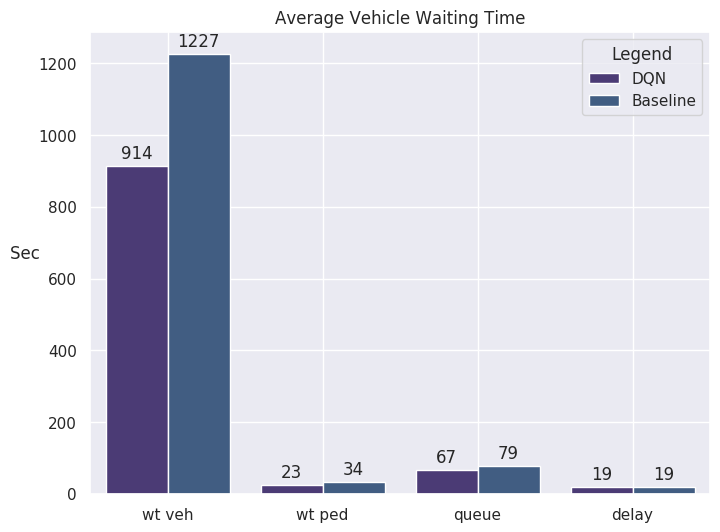

In [211]:
wtb4_df = pd.read_csv('results/stats_ped/wt_beta4_8ott')

wtb4_V, wtb4_Vm, wtb4_Vs  = getRes(10, wtb4_df, 'wt_veh')
wtb4_Vm_full, wtb4_Vs_full = enl(wtb4_V, wtb4_Vm,wtb4_Vs, 10)
#defPlot(base_mid_Vm_full, base_mid_Vs_full, wtb4_Vm_full[:2000], wtb4_Vs_full[:2000], 'WT VEH')

wtb4_IV, wtb4_IVm, wtb4_IVs  = getRes(10, wtb4_df, 'wt_veh_ind')
wtb4_IVm_full, wtb4_IVs_full = enl(wtb4_IV, wtb4_IVm, wtb4_IVs, 10)
#defPlot(base_mid_IVm_full, base_mid_IVs_full, wtb1_IVm_full[:2000], wtb1_IVs_full[:2000], 'WT VEH - INDIVIDUAL')

wtb4_P, wtb4_Pm, wtb4_Ps = getRes(10, wtb4_df, 'wt_ped')
wtb4_Pm_full, wtb4_Ps_full = enl(wtb4_P, wtb4_Pm, wtb4_Ps, 10)
#defPlot(base_mid_Pm_full, base_mid_Ps_full, wtb4_Pm_full[:2000], wtb4_Ps_full[:2000], 'WT PED')

wtb4_Q, wtb4_Qm, wtb4_Qs = getRes(10, wtb4_df, 'queue')
wtb4_Qm_full, wtb4_Qs_full = enl(wtb4_Q, wtb4_Qm, wtb4_Qs, 10)
#defPlot(base_mid_Qm_full, base_mid_Qs_full, wtb4_Qm_full[:2000], wtb4_Qs_full[:2000], 'QUEUE')

wtb4_D, wtb4_Dm, wtb4_Ds = getRes(10, wtb4_df, 'delay')
wtb4_Dm_full, wtb4_Ds_full = enl(wtb4_D, wtb4_Dm, wtb4_Ds, 10)
#defPlot(base_mid_Dm_full, base_mid_Ds_full, wtb4_Dm_full[:2000], wtb4_Ds_full[:2000], 'DELAY')

instaRes_all(wtb4_Vm_full, wtb4_Pm_full, wtb4_Qm_full, wtb4_Dm_full)

##### Comparison

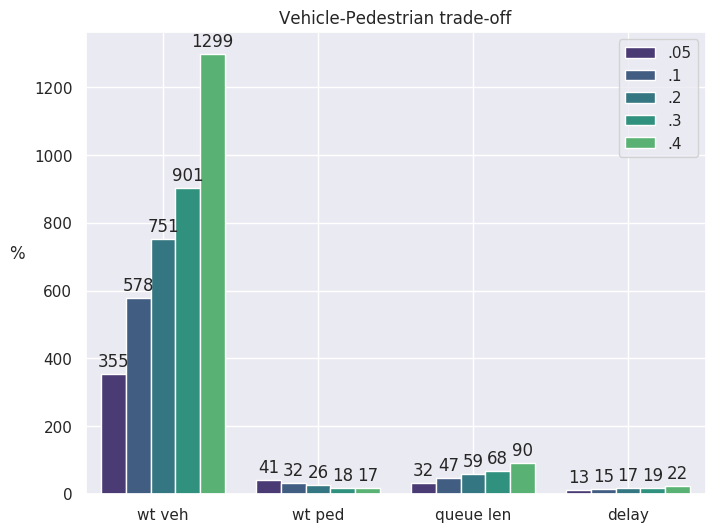

In [77]:
wtb05 = {'wt veh':np.mean(wtb05_Vm), 'wt ped':np.mean(wtb05_Pm), 'queue len':np.mean(wtb05_Qm), 'delay':np.mean(wtb05_Dm)}
wtb1 = {'wt veh':np.mean(wtb1_Vm), 'wt ped':np.mean(wtb1_Pm), 'queue len':np.mean(wtb1_Qm), 'delay':np.mean(wtb1_Dm)}
wtb2 = {'wt veh':np.mean(wtb2_Vm), 'wt ped':np.mean(wtb2_Pm), 'queue len':np.mean(wtb2_Qm), 'delay':np.mean(wtb2_Dm)}
wtb3 = {'wt veh':np.mean(wtb3_Vm), 'wt ped':np.mean(wtb3_Pm), 'queue len':np.mean(wtb3_Qm), 'delay':np.mean(wtb3_Dm)}
wtb4 = {'wt veh':np.mean(wtb4_Vm), 'wt ped':np.mean(wtb4_Pm), 'queue len':np.mean(wtb4_Qm), 'delay':np.mean(wtb4_Dm)}

df = pd.DataFrame([wtb05, wtb1, wtb2, wtb3, wtb4])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['.05', '.1', '.2', '.3', '.4']*4
sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Vehicle-Pedestrian trade-off')
plt.xlabel('')
plt.ylabel('%    ', rotation=0)
plt.grid(True)
plt.legend(loc='upper right')
plt.show()

In [23]:
wtb5

,Unnamed: 0,0,1,2,3,4,5,6,7,8,9
0,wt_ped,"[20.0, 30.0, 30.0, 10.0, 25.0, 35.0, 27.5, 0, ...","[10.0, 0, 10.0, 0, 15.0, 0, 15.0, 25.0, 20.0, ...","[20.0, 30.0, 25.0, 0, 0, 10.0, 0, 11.0, 0, 11....","[10.0, 0, 10.0, 12.5, 25.0, 40.0, 50.0, 33.0, ...","[0, 0, 15.0, 13.0, 10.0, 12.5, 10.0, 0, 15.0, ...","[20.0, 30.0, 40.0, 32.5, 0, 12.5, 0, 15.0, 15....","[0, 0, 0, 10.0, 10.0, 0, 0, 0, 11.666666666666...","[20.0, 30.0, 30.0, 10.0, 25.0, 35.0, 27.5, 10....","[0, 10.0, 0, 15.0, 25.0, 18.333333333333332, 0...","[0, 0, 15.0, 15.0, 0, 0, 0, 15.0, 25.0, 35.0, ..."
1,wt_veh,"[0, 45, 138, 281, 50, 102, 156, 374, 184, 331,...","[0, 92, 69, 228, 367, 670, 251, 387, 85, 102, ...","[0, 45, 137, 272, 29, 69, 262, 348, 679, 319, ...","[0, 92, 68, 136, 324, 159, 297, 60, 262, 515, ...","[0, 45, 6, 66, 235, 217, 554, 849, 436, 517, 8...","[0, 45, 136, 51, 221, 288, 625, 253, 306, 299,...","[0, 45, 6, 66, 234, 456, 546, 717, 128, 162, 4...","[0, 45, 137, 274, 29, 70, 114, 318, 184, 330, ...","[0, 45, 204, 112, 186, 306, 589, 248, 387, 85,...","[0, 44, 6, 66, 239, 218, 395, 62, 78, 131, 251..."
2,wt_veh_ind,"[0.0, 3.75, 5.75, 14.789473684210526, 2.941176...","[0.0, 4.842105263157895, 7.666666666666667, 8....","[0.0, 3.75, 5.708333333333333, 15.111111111111...","[0.0, 4.842105263157895, 7.555555555555555, 9....","[0.0, 3.75, 0.5454545454545454, 5.5, 9.7916666...","[0.0, 3.75, 5.666666666666667, 4.25, 9.2083333...","[0.0, 3.75, 0.5454545454545454, 5.5, 9.75, 12....","[0.0, 3.75, 5.708333333333333, 15.222222222222...","[0.0, 3.75, 8.5, 6.588235294117647, 10.9411764...","[0.0, 3.6666666666666665, 0.5, 5.5, 9.95833333..."
3,queue,"[0, 0, 6.047289048928064, 51.048175199700395, ...","[0, 7.05892829741056, 1.0087339364457648, 15.5...","[0, 0, 6.04745503736433, 51.048114543133664, 3...","[0, 7.059481257470381, 1.0079953658058969, 13....","[0, 0, 0, 6.045840110462905, 6.045840110462905...","[0, 0, 6.044299969925248, 4.029685982758082, 6...","[0, 0, 0, 6.049070646474291, 6.049070646474291...","[0, 0, 6.048827394578382, 51.049565741793174, ...","[0, 0, 28.553477089572283, 6.048642597920946, ...","[0, 0, 0, 6.0475179562427, 6.0475179562427, 51..."
4,delay,"[4.1979354235197075, 6.939399460610908, 13.974...","[3.880273617246927, 14.559952888392678, 8.9080...","[4.605646362159692, 7.064194018753905, 14.4469...","[4.263799417723253, 14.496639583055485, 8.8758...","[4.318431320874981, 7.059690452705219, 6.67592...","[4.515487570493997, 6.975198175317382, 14.1671...","[4.312053299897075, 6.946987336421188, 7.05617...","[4.779273889712805, 7.047292307793125, 14.2168...","[4.266369821291295, 6.947759625864115, 21.2998...","[4.475310622700125, 6.956317493693849, 6.98665..."
5,actions,"[2, 2, 2, 2, 0, 0, 0, 2, 1, 1, 0, 0, 2, 1, 1, ...","[1, 2, 0, 2, 0, 2, 1, 1, 0, 0, 2, 1, 0, 0, 0, ...","[2, 2, 2, 2, 0, 0, 2, 0, 2, 1, 1, 0, 2, 0, 0, ...","[1, 2, 0, 0, 2, 1, 1, 0, 2, 2, 0, 0, 2, 1, 1, ...","[1, 1, 0, 0, 2, 1, 2, 2, 0, 0, 2, 1, 1, 0, 0, ...","[2, 2, 2, 0, 2, 1, 2, 0, 0, 0, 2, 1, 1, 0, 0, ...","[1, 1, 0, 0, 2, 2, 0, 0, 1, 1, 2, 0, 0, 2, 1, ...","[2, 2, 2, 2, 0, 0, 0, 2, 1, 1, 0, 2, 0, 0, 1, ...","[1, 1, 2, 0, 0, 0, 2, 1, 1, 0, 0, 0, 0, 2, 1, ...","[1, 1, 0, 0, 2, 1, 1, 0, 0, 0, 0, 1, 1, 2, 0, ..."
6,ret,[-13592.849999999995],[-11270.549999999996],[-13547.199999999995],[-11397.899999999998],[-9887.649999999996],[-12255.79999999999],[-12584.149999999994],[-8888.249999999998],[-11736.300000000005],[-6574.400000000002]
7,wt_ped_tot,"[400, 600, 900, 100, 250, 350, 550, 0, 75, 125...","[100, 0, 200, 0, 150, 0, 75, 125, 300, 550, 0,...","[200, 300, 500, 0, 0, 200, 0, 275, 0, 175, 325...","[200, 0, 100, 500, 250, 400, 500, 825, 100, 0,...","[0, 0, 75, 325, 50, 250, 100, 0, 75, 325, 0, 7...","[200, 300, 400, 650, 0, 250, 0, 75, 225, 475, ...","[0, 0, 0, 200, 200, 0, 0, 0, 175, 325, 0, 75, ...","[400, 600, 900, 100, 250, 350, 550, 50, 225, 3...","[0, 100, 0, 75, 125, 275, 0, 0, 0, 75, 125, 17...","[0, 0, 75, 225, 0, 0, 0, 75, 125, 175, 225, 40..."


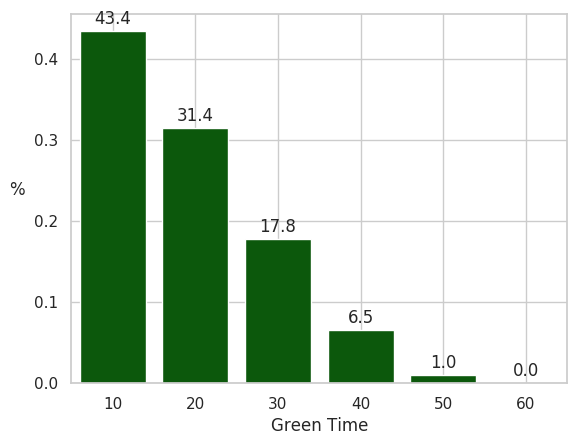

In [22]:
plotAct(wtb5, 10, '')

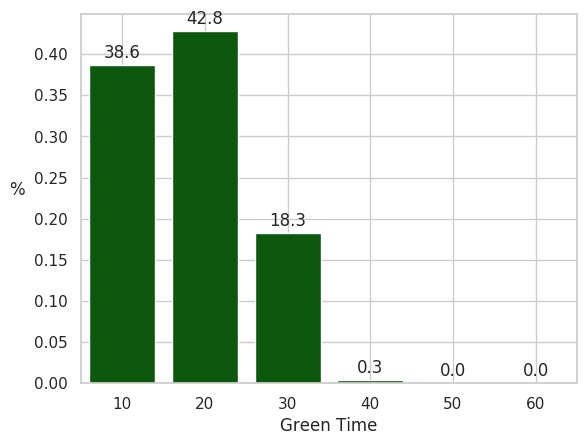

In [20]:
plotAct(wtb6, 10, '')

In [82]:
np.mean(base_mid_Qm_full)

75.13695226408

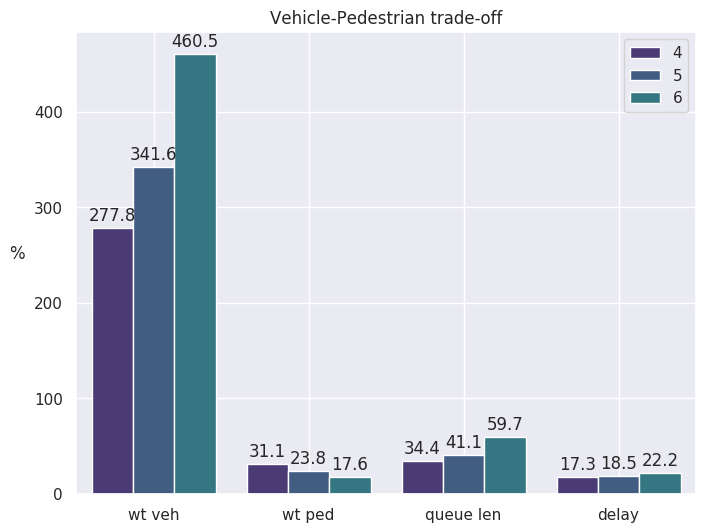

In [93]:
wtb4 = pd.read_csv('results/stats_ped/wt_beta4') #wt_beta4_8ott_3
wtb5 = pd.read_csv('results/stats_ped/wt_mid') #wt_beta5_8ott
wtb6 = pd.read_csv('results/stats_ped/wt_beta4_ma6') #wt_beta6_8ott

_, wtb4vm, wtb4vs = getRes(10, wtb4, 'wt_veh')
_, wtb5vm, wtb5vs = getRes(10, wtb5, 'wt_veh')
_, wtb6vm, wtb6vs = getRes(10, wtb6, 'wt_veh')

_, wtb4pm, wtb4ps = getRes(10, wtb4, 'wt_ped')
_, wtb5pm, wtb5ps = getRes(10, wtb5, 'wt_ped')
_, wtb6pm, wtb6ps = getRes(10, wtb6, 'wt_ped')

_, wtb4qm, wtb4vs = getRes(10, wtb4, 'queue')
_, wtb5qm, wtb5vs = getRes(10, wtb5, 'queue')
_, wtb6qm, wtb6vs = getRes(10, wtb6, 'queue')

_, wtb4dm, wtb4vs = getRes(10, wtb4, 'delay')
_, wtb5dm, wtb5vs = getRes(10, wtb5, 'delay')
_, wtb6dm, wtb6vs = getRes(10, wtb6, 'delay')

#wtbase = {'wt veh LOW':np.mean(base_low_Vm), 'wt veh MID':np.mean(base_mid_Vm), 'wt veh HIGH':np.mean(base_high_Vm)}
#wtdct = {'wt veh LOW':np.mean(wtb4vm), 'wt veh MID':np.mean(wtb5vm), 'wt veh HIGH':np.mean(wtb6vm)} 

#histComp(wtbase, wtdct, ['DQN', 'Baseline'], 'Comparison Total WT Veh')


wtb4d = {'wt veh':np.mean(wtb4vm), 'wt ped':np.mean(wtb4pm), 'queue len':np.mean(wtb4qm), 'delay':np.mean(wtb4dm)}
wtb5d = {'wt veh':np.mean(wtb5vm), 'wt ped':np.mean(wtb5pm), 'queue len':np.mean(wtb5qm), 'delay':np.mean(wtb5dm)}
wtb6d = {'wt veh':np.mean(wtb6vm), 'wt ped':np.mean(wtb6pm), 'queue len':np.mean(wtb6qm), 'delay':np.mean(wtb6dm)}

df = pd.DataFrame([wtb4d, wtb5d, wtb6d])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['4', '5', '6']*4
sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.1f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Vehicle-Pedestrian trade-off')
plt.xlabel('')
plt.ylabel('%    ', rotation=0)
plt.grid(True)
plt.legend(loc='upper right')
plt.show()


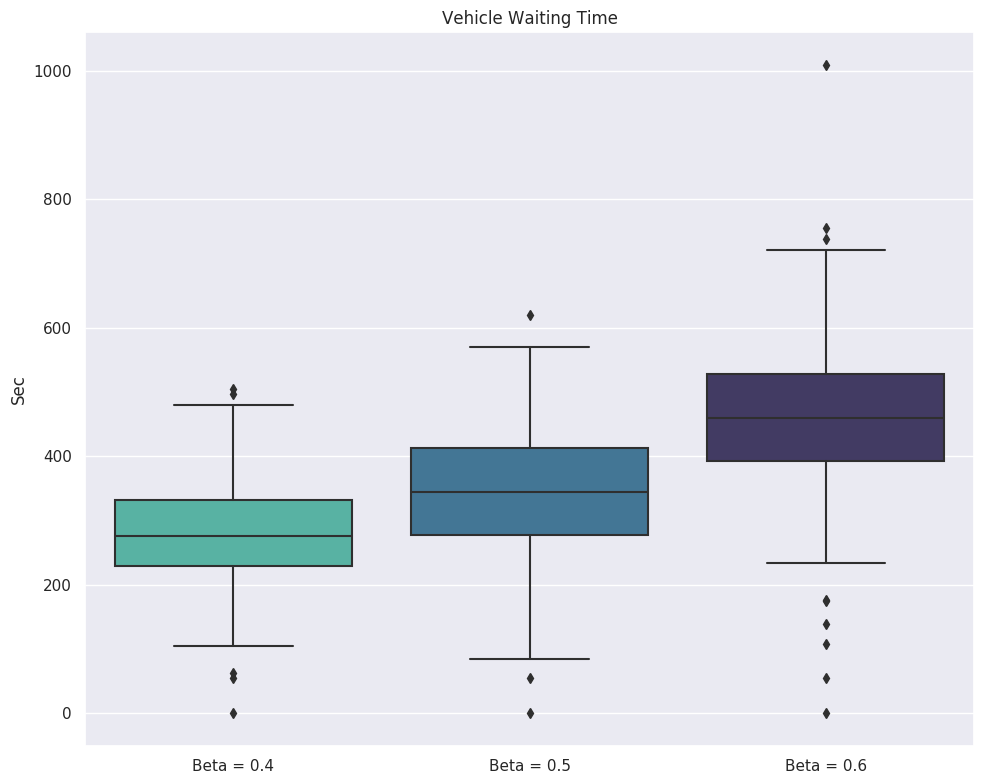

In [94]:
data = [wtb4vm, wtb5vm, wtb6vm]
labels = ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6']

# Set figure size
plt.figure(figsize=(10, 8))

sns.boxplot(data=data, showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Vehicle Waiting Time')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

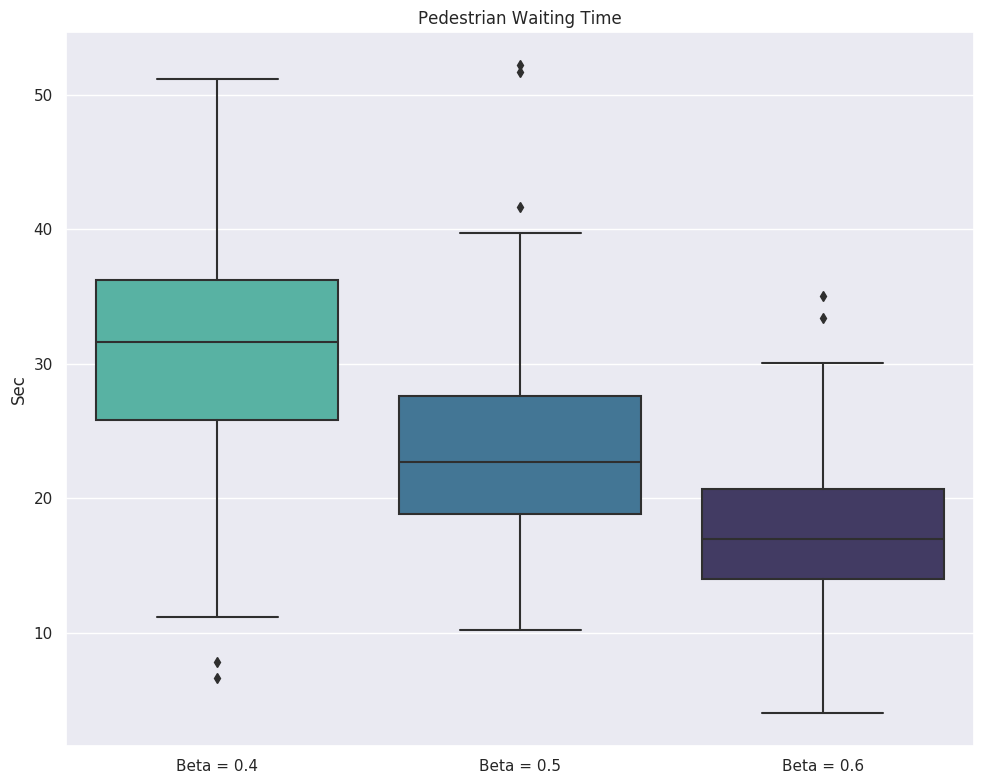

In [95]:
data = [wtb4pm, wtb5pm, wtb6pm]
labels = ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6']

# Set figure size
plt.figure(figsize=(10, 8))

sns.boxplot(data=data, showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Pedestrian Waiting Time')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

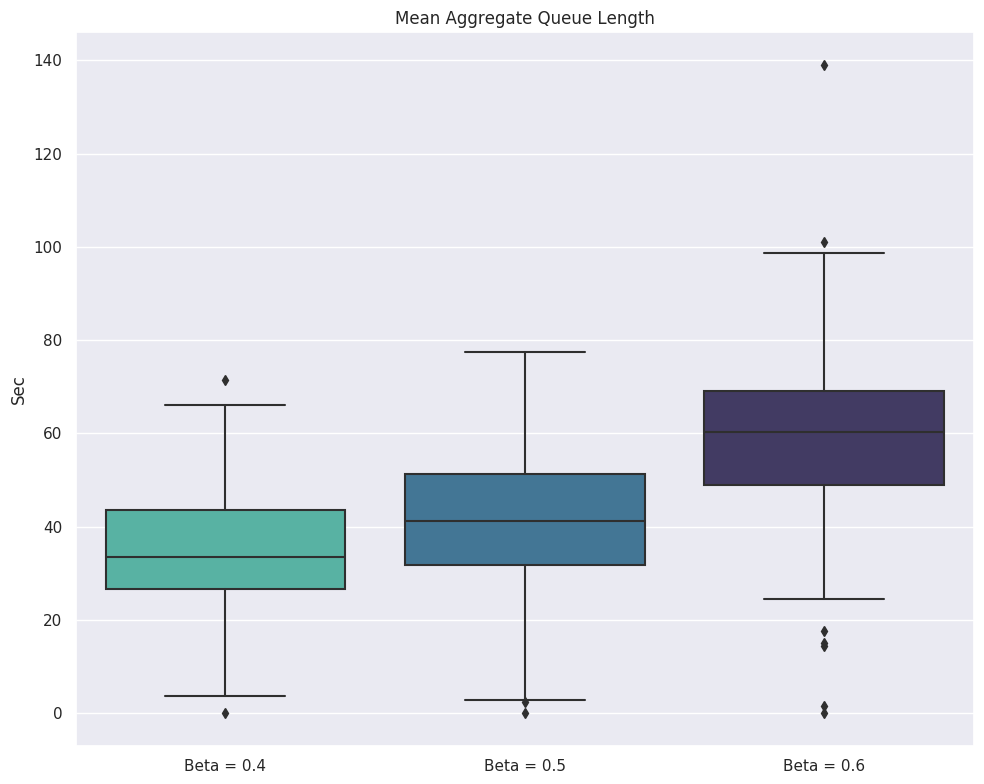

In [96]:
data = [wtb4qm, wtb5qm, wtb6qm]
labels = ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6']

# Set figure size
plt.figure(figsize=(10, 8))

sns.boxplot(data=data, showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Mean Aggregate Queue Length')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

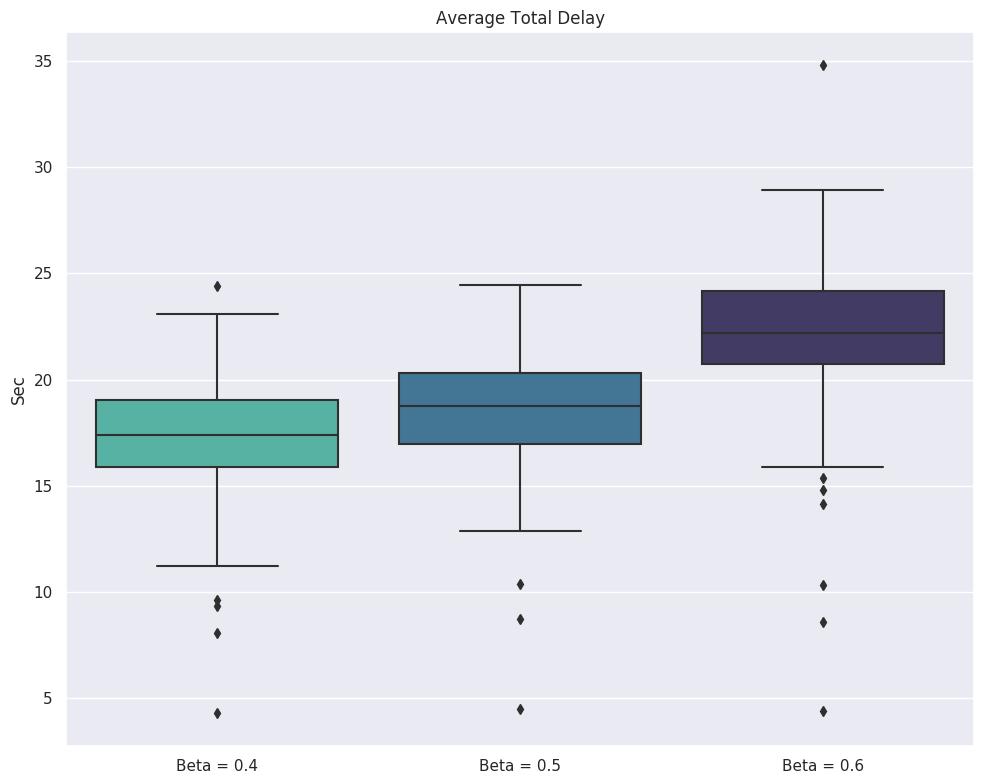

In [97]:
data = [wtb4dm, wtb5dm, wtb6dm]
labels = ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6']

# Set figure size
plt.figure(figsize=(10, 8))

sns.boxplot(data=data, showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Average Total Delay')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

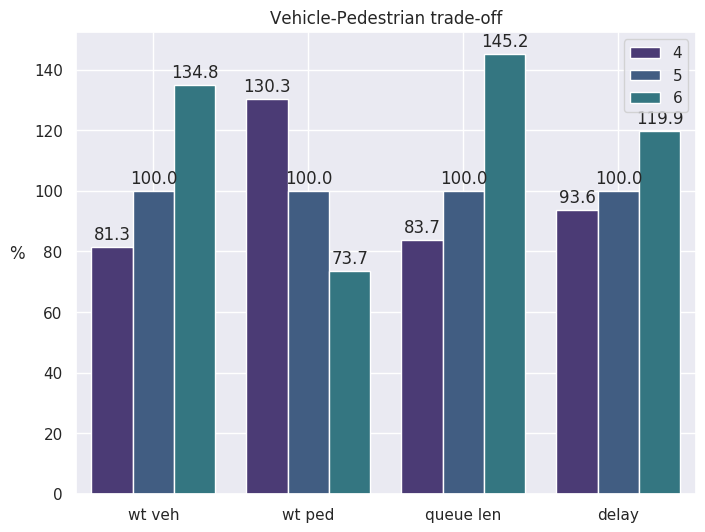

In [98]:
wtb4d = {'wt veh':np.mean(wtb4vm)*100/np.mean(wtb5vm), 'wt ped':np.mean(wtb4pm)*100/np.mean(wtb5pm), 'queue len':np.mean(wtb4qm)*100/np.mean(wtb5qm), 'delay':np.mean(wtb4dm)*100/np.mean(wtb5dm)}
wtb5d = {'wt veh':np.mean(wtb5vm)*100/np.mean(wtb5vm), 'wt ped':np.mean(wtb5pm)*100/np.mean(wtb5pm), 'queue len':np.mean(wtb5qm)*100/np.mean(wtb5qm), 'delay':np.mean(wtb5dm)*100/np.mean(wtb5dm)}
wtb6d = {'wt veh':np.mean(wtb6vm)*100/np.mean(wtb5vm), 'wt ped':np.mean(wtb6pm)*100/np.mean(wtb5pm), 'queue len':np.mean(wtb6qm)*100/np.mean(wtb5qm), 'delay':np.mean(wtb6dm)*100/np.mean(wtb5dm)}

df = pd.DataFrame([wtb4d, wtb5d, wtb6d])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['4', '5', '6']*4
sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.1f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Vehicle-Pedestrian trade-off')
plt.xlabel('')
plt.ylabel('%    ', rotation=0)
plt.grid(True)
plt.legend(loc='upper right')
plt.show()

#### TIME VARIATION

##### increased time - 15sec

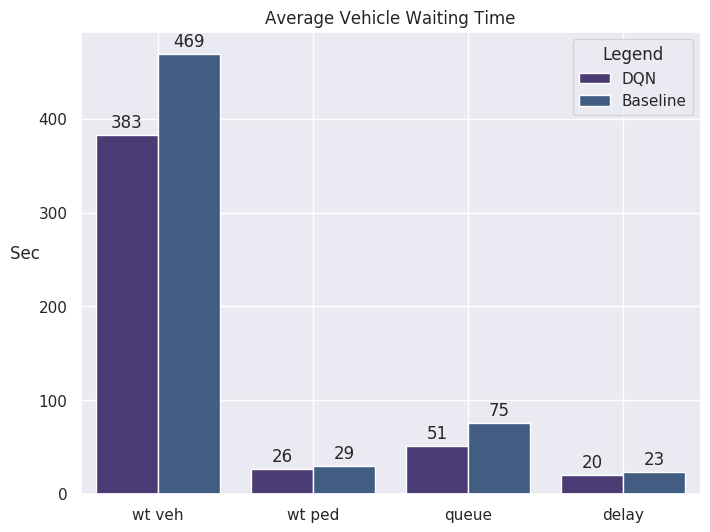

In [174]:
instaRes_all(wt_mid15_Vm, wt_mid15_Pm, wt_mid15_Qm, wt_mid15_Dm)

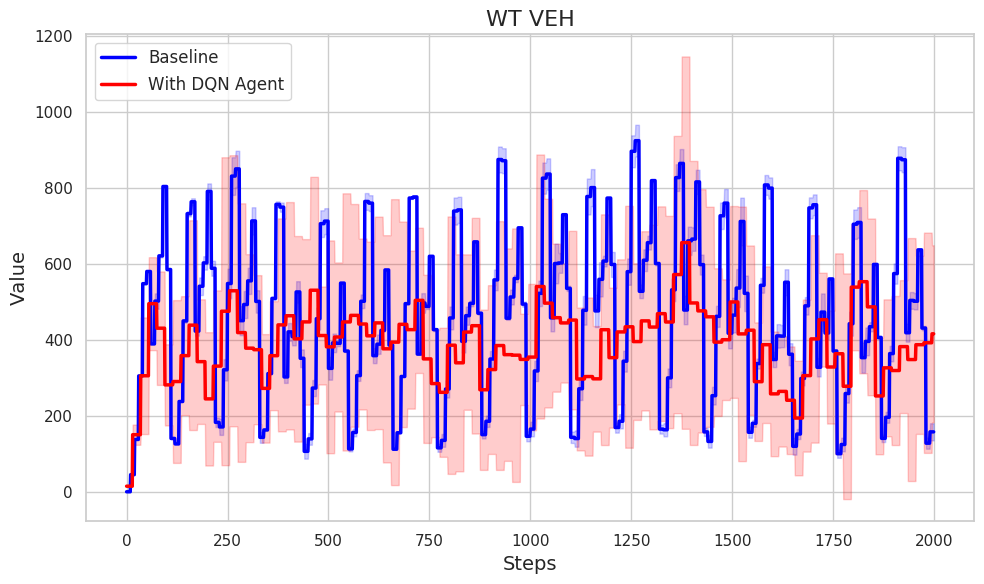

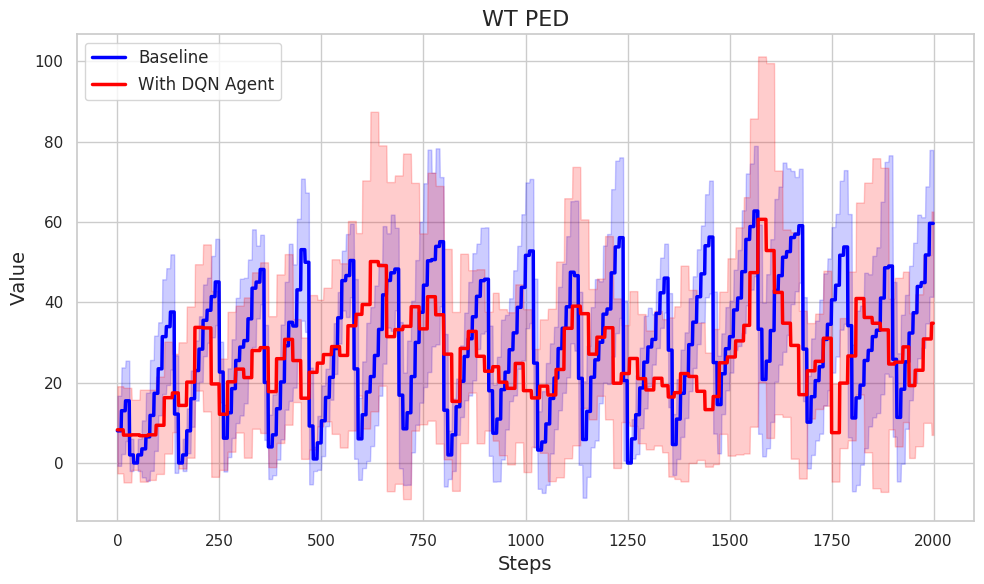

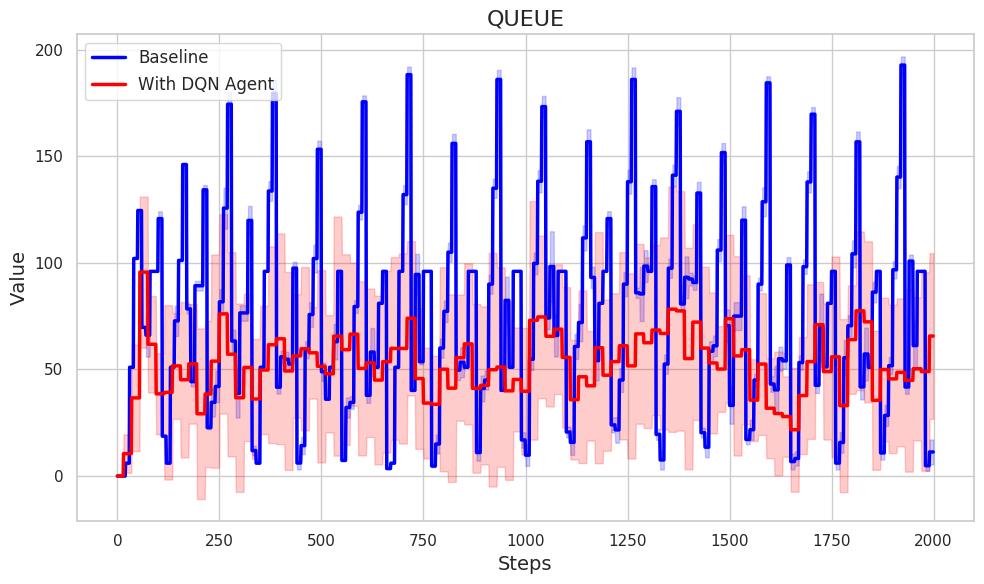

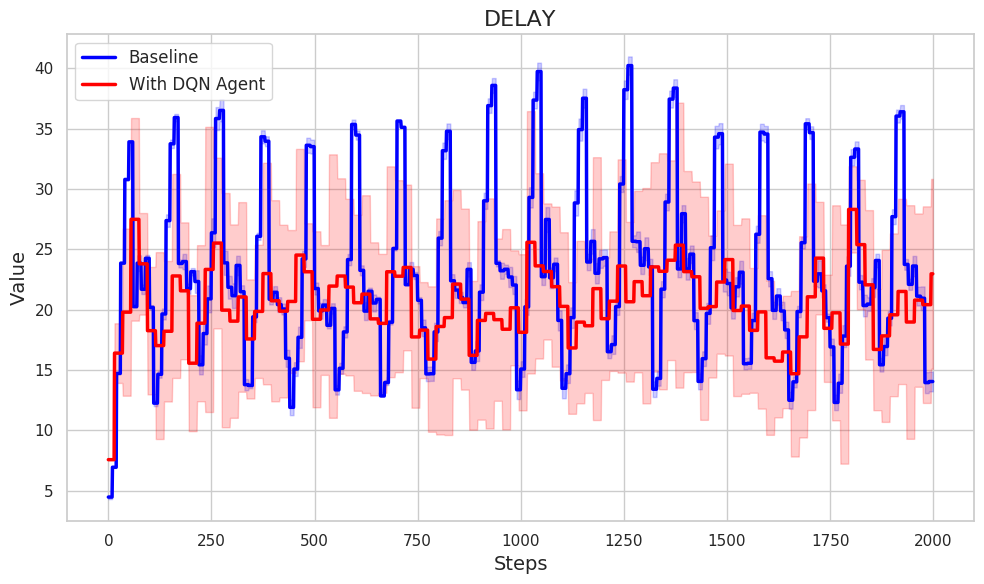

In [99]:
#wt_mid15_a = pd.read_csv('results/stats_ped/test_graal_15_mid')
wt_mid15 = pd.read_csv('results/stats_ped/wt_mid_15_b2')  #elimina_mid15g #test_graal_15_mid #wt_mid_15sec

wt_mid15_V, wt_mid15_Vm, wt_mid15_Vs  = getRes(10, wt_mid15, 'wt_veh')
wt_mid15_Vm_full, wt_mid15_Vs_full = enl(wt_mid15_V, wt_mid15_Vm, wt_mid15_Vs, 15)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wt_mid15_Vm_full[:2000], wt_mid15_Vs_full[:2000], 'WT VEH')

wt_mid15_P, wt_mid15_Pm, wt_mid15_Ps = getRes(10, wt_mid15, 'wt_ped')
wt_mid15_Pm_full, wt_mid15_Ps_full = enl(wt_mid15_P, wt_mid15_Pm, wt_mid15_Ps, 15)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wt_mid15_Pm_full[:2000], wt_mid15_Ps_full[:2000], 'WT PED')

wt_mid15_Q, wt_mid15_Qm, wt_mid15_Qs = getRes(10, wt_mid15, 'queue')
wt_mid15_Qm_full, wt_mid15_Qs_full = enl(wt_mid15_Q, wt_mid15_Qm, wt_mid15_Qs, 15)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wt_mid15_Qm_full[:2000], wt_mid15_Qs_full[:2000], 'QUEUE')

wt_mid15_D, wt_mid15_Dm, wt_mid15_Ds = getRes(10, wt_mid15, 'delay')
wt_mid15_Dm_full, wt_mid15_Ds_full = enl(wt_mid15_D, wt_mid15_Dm, wt_mid15_Ds, 15)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wt_mid15_Dm_full[:2000], wt_mid15_Ds_full[:2000], 'DELAY')

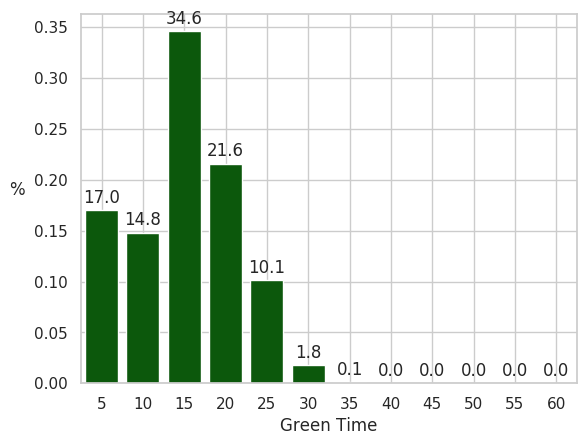

In [105]:
plotAct(wt_mid5, 5, '')

##### reduced time - 5sec

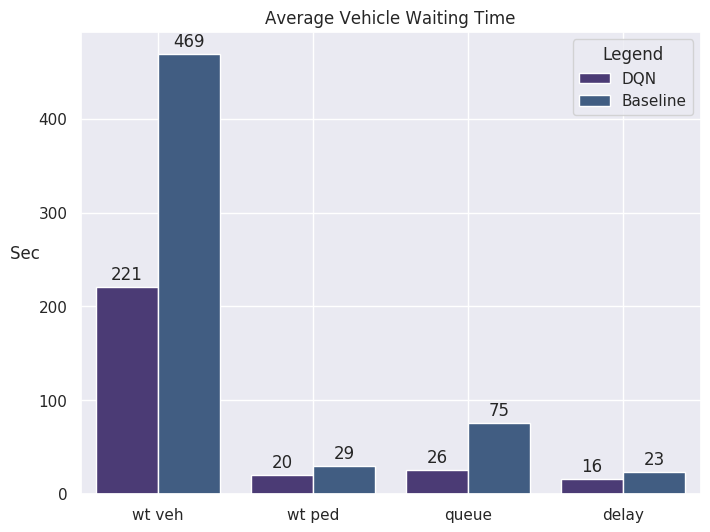

In [175]:
instaRes_all(wt_mid5_Vm, wt_mid5_Pm, wt_mid5_Qm, wt_mid5_Dm)

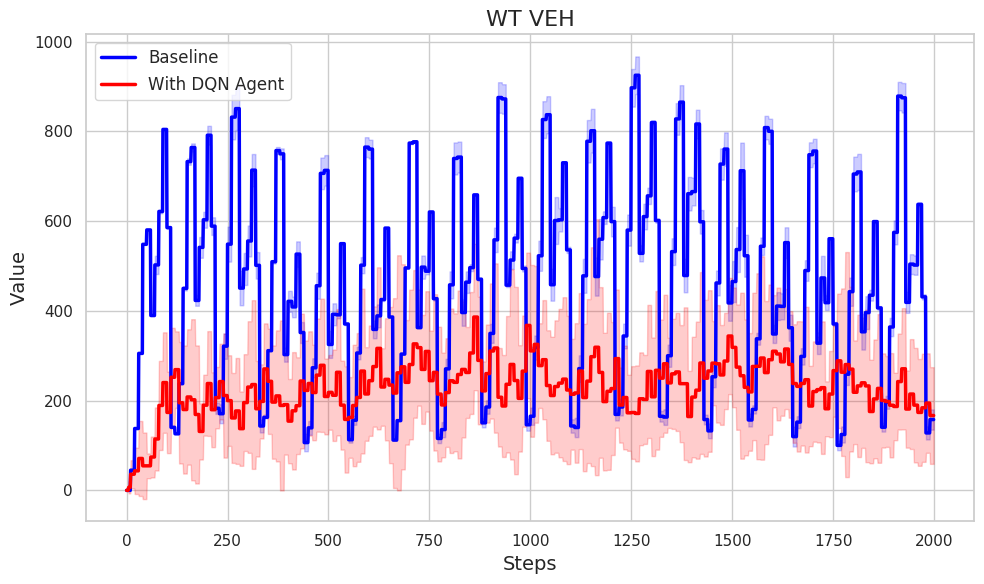

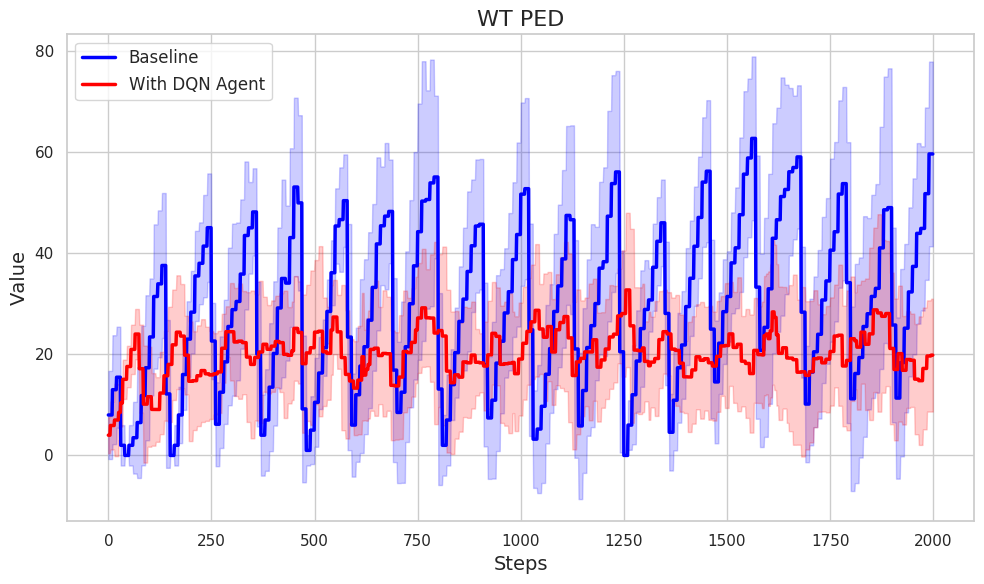

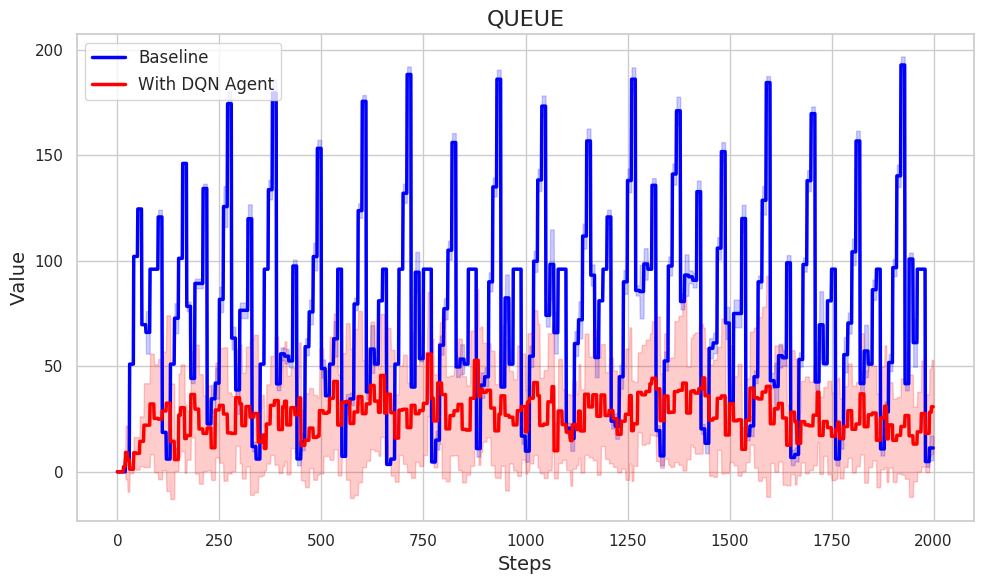

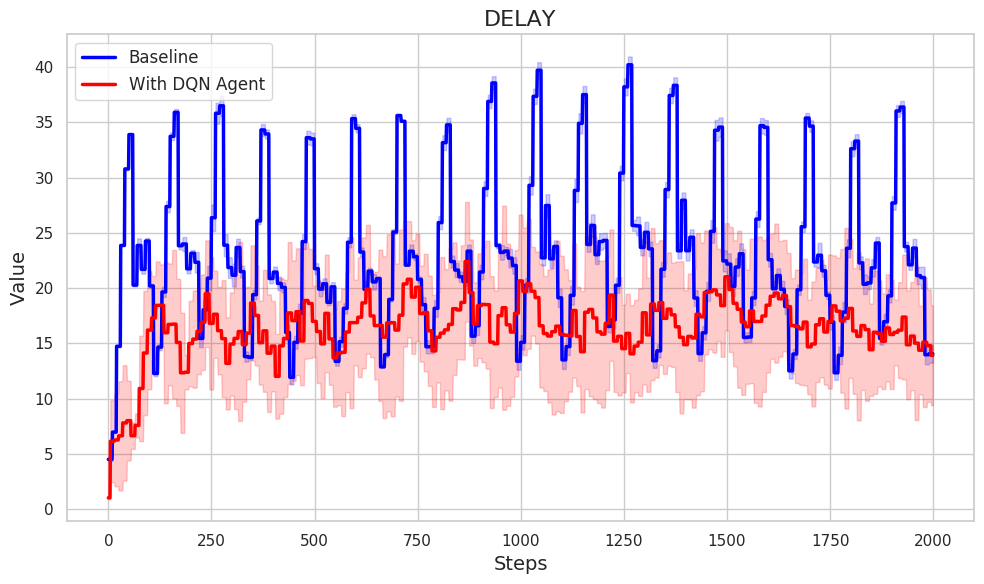

In [117]:
wt_mid5_nopen = pd.read_csv('results/stats_ped/test_graal_5_mid') #elimina_mid5g
wt_mid5 = pd.read_csv('results/stats_ped/wt_5sec')  #wt_mid_5sec

wt_mid5_V, wt_mid5_Vm, wt_mid5_Vs  = getRes(10, wt_mid5, 'wt_veh')
wt_mid5_Vm_full, wt_mid5_Vs_full = enl(wt_mid5_V, wt_mid5_Vm, wt_mid5_Vs, 5)
defPlot(base_mid_Vm_full, base_mid_Vs_full, wt_mid5_Vm_full[:2000], wt_mid5_Vs_full[:2000], 'WT VEH')

wt_mid5_P, wt_mid5_Pm, wt_mid5_Ps = getRes(10, wt_mid5, 'wt_ped')
wt_mid5_Pm_full, wt_mid5_Ps_full = enl(wt_mid5_P, wt_mid5_Pm, wt_mid5_Ps, 5)
defPlot(base_mid_Pm_full, base_mid_Ps_full, wt_mid5_Pm_full[:2000], wt_mid5_Ps_full[:2000], 'WT PED')

wt_mid5_Q, wt_mid5_Qm, wt_mid5_Qs = getRes(10, wt_mid5, 'queue')
wt_mid5_Qm_full, wt_mid5_Qs_full = enl(wt_mid5_Q, wt_mid5_Qm, wt_mid5_Qs, 5)
defPlot(base_mid_Qm_full, base_mid_Qs_full, wt_mid5_Qm_full[:2000], wt_mid5_Qs_full[:2000], 'QUEUE')

wt_mid5_D, wt_mid5_Dm, wt_mid5_Ds = getRes(10, wt_mid5, 'delay')
wt_mid5_Dm_full, wt_mid5_Ds_full = enl(wt_mid5_D, wt_mid5_Dm, wt_mid5_Ds, 5)
defPlot(base_mid_Dm_full, base_mid_Ds_full, wt_mid5_Dm_full[:2000], wt_mid5_Ds_full[:2000], 'DELAY')


##### Comparison

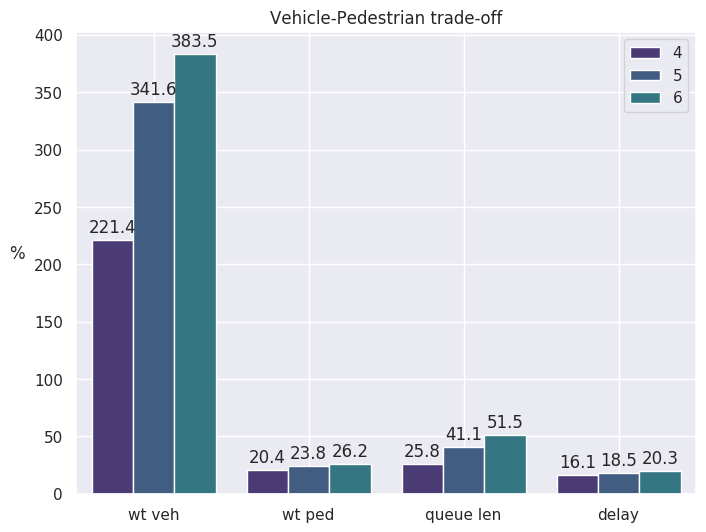

In [121]:
wtb4d = {'wt veh':np.mean(wt_mid5_Vm_full), 'wt ped':np.mean(wt_mid5_Pm_full), 'queue len':np.mean(wt_mid5_Qm_full), 'delay':np.mean(wt_mid5_Dm_full)}
wtb5d = {'wt veh':np.mean(wt_mid_10_Vm), 'wt ped':np.mean(wt_mid_10_Pm), 'queue len':np.mean(wt_mid_10_Qm), 'delay':np.mean(wt_mid_10_Dm)}
wtb6d = {'wt veh':np.mean(wt_mid15_Vm_full), 'wt ped':np.mean(wt_mid15_Pm_full), 'queue len':np.mean(wt_mid15_Qm_full), 'delay':np.mean(wt_mid15_Dm_full)}

df = pd.DataFrame([wtb4d, wtb5d, wtb6d])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['4', '5', '6']*4
sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.1f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Vehicle-Pedestrian trade-off')
plt.xlabel('')
plt.ylabel('%    ', rotation=0)
plt.grid(True)
plt.legend(loc='upper right')
plt.show()


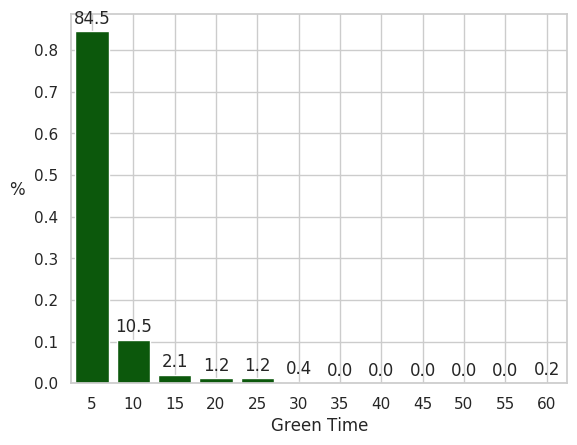

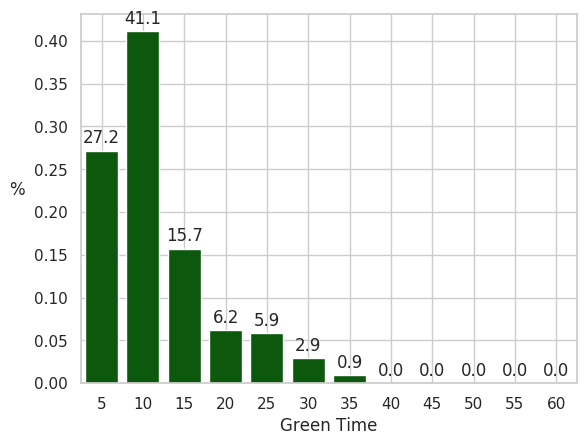

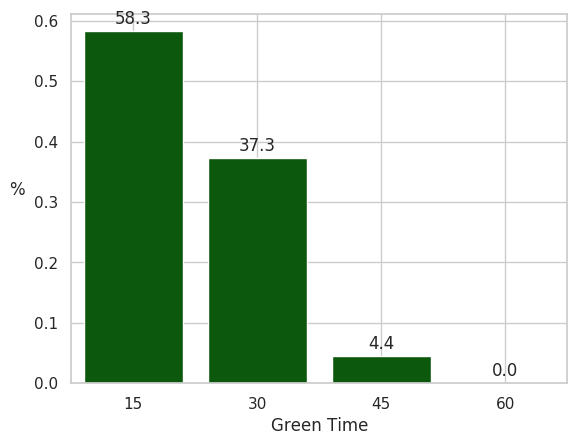

In [108]:
plotAct(wt_mid5_nopen, 5, '')
plotAct(wt_mid5, 5, '')
#plotAct(wtb1_df, 10, '')
plotAct(wt_mid15, 15, '')

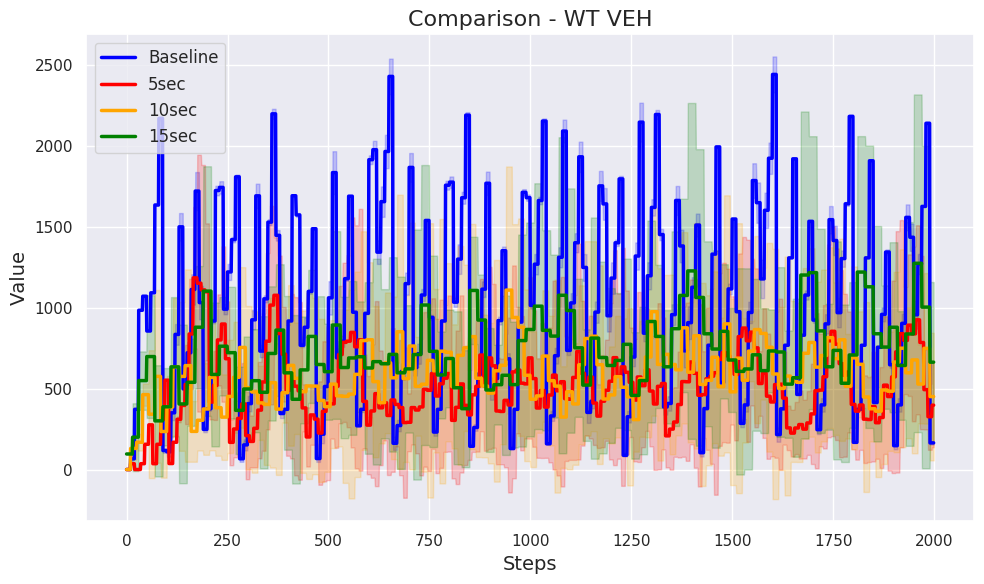

In [313]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

# Plot the average
plt.plot(base_mid_Vm_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(wt_mid5_Vm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(wtb1_Vm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(wt_mid15_Vm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Vm_full)), np.array(base_mid_Vm_full) - np.array(base_mid_Vs_full),
                np.array(base_mid_Vm_full) + np.array(base_mid_Vs_full),
                color='blue', alpha=0.2)

plt.fill_between(range(len(wt_mid5_Vm_full[:2000])), np.array(wt_mid5_Vm_full[:2000]) - np.array(wt_mid5_Vs_full[:2000]),
                np.array(wt_mid5_Vm_full[:2000]) + np.array(wt_mid5_Vs_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(wtb1_Vm_full[:2000])), np.array(wtb1_Vm_full[:2000]) - np.array(wtb1_Vs_full[:2000]),
                np.array(wtb1_Vm_full[:2000]) + np.array(wtb1_Vs_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(wt_mid15_Vm_full[:2000])), np.array(wt_mid15_Vm_full[:2000]) - np.array(wt_mid15_Vs_full[:2000]),
                np.array(wt_mid15_Vm_full[:2000]) + np.array(wt_mid15_Vs_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - WT VEH', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

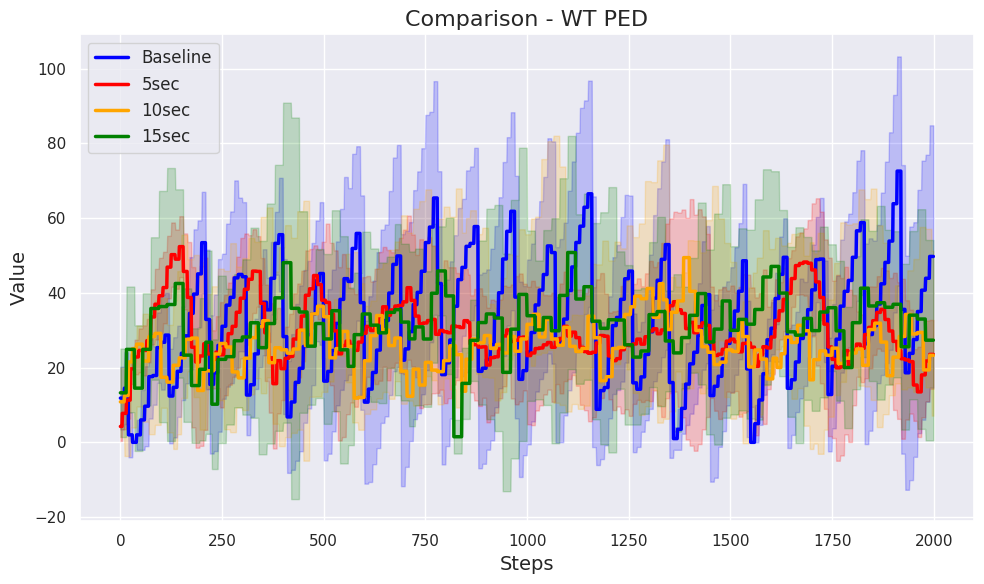

In [314]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

# Plot the average
plt.plot(base_mid_Pm_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(wt_mid5_Pm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(wtb2_Pm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(wt_mid15_Pm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Pm_full[:2000])), np.array(base_mid_Pm_full[:2000]) - np.array(base_mid_Ps_full[:2000]),
                np.array(base_mid_Pm_full[:2000]) + np.array(base_mid_Ps_full[:2000]),
                color='blue', alpha=0.2)

plt.fill_between(range(len(wt_mid5_Pm_full[:2000])), np.array(wt_mid5_Pm_full[:2000]) - np.array(wt_mid5_Ps_full[:2000]),
                np.array(wt_mid5_Pm_full[:2000]) + np.array(wt_mid5_Ps_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(wtb1_Pm_full[:2000])), np.array(wtb1_Pm_full[:2000]) - np.array(wtb1_Ps_full[:2000]),
                np.array(wtb1_Pm_full[:2000]) + np.array(wtb1_Ps_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(wt_mid15_Pm_full[:2000])), np.array(wt_mid15_Pm_full[:2000]) - np.array(wt_mid15_Ps_full[:2000]),
                np.array(wt_mid15_Pm_full[:2000]) + np.array(wt_mid15_Ps_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - WT PED', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
#plt.xlim(right=2500)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

In [223]:
print(np.mean(wt_mid15_Pm_full))
print(np.mean(wt_mid5_Pm_full))
print(np.mean(wtb1_Pm_full))
print(np.mean(base_mid_Pm_full))

30.939721304605758
30.053441177436355
31.964426585445697
34.0953546584296


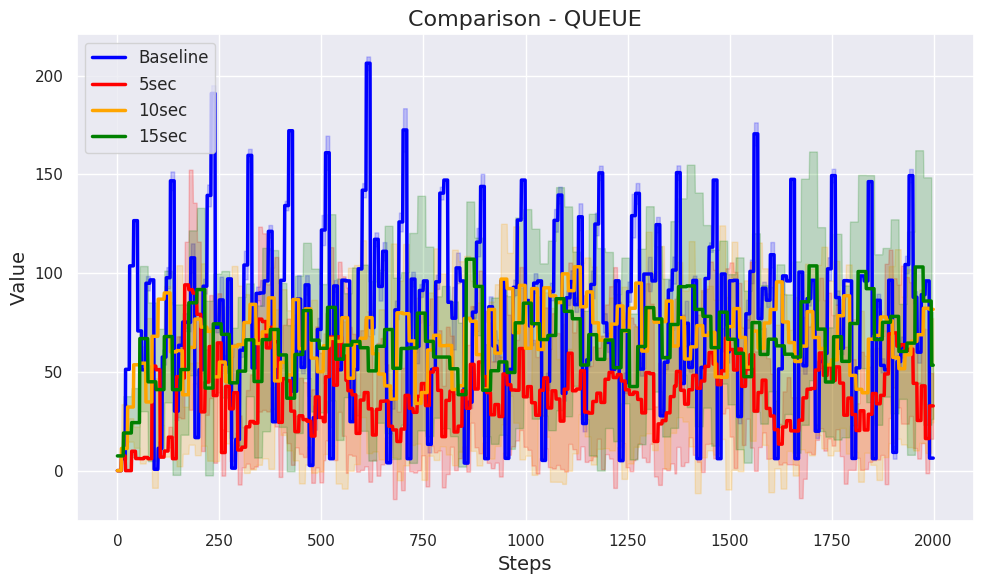

In [315]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

# Plot the averag
plt.plot(base_mid_Qm_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(wt_mid5_Qm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(wtb3_Qm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(wt_mid15_Qm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Qm_full[:2000])), np.array(base_mid_Qm_full[:2000]) - np.array(base_mid_Qs_full[:2000]),
                np.array(base_mid_Qm_full[:2000]) + np.array(base_mid_Qs_full[:2000]),
                color='blue', alpha=0.2)

plt.fill_between(range(len(wt_mid5_Qm_full[:2000])), np.array(wt_mid5_Qm_full[:2000]) - np.array(wt_mid5_Qs_full[:2000]),
                np.array(wt_mid5_Qm_full[:2000]) + np.array(wt_mid5_Qs_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(wtb1_Qm_full[:2000])), np.array(wtb1_Qm_full[:2000]) - np.array(wtb1_Qs_full[:2000]),
                np.array(wtb1_Qm_full[:2000]) + np.array(wtb1_Qs_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(wt_mid15_Qm_full[:2000])), np.array(wt_mid15_Qm_full[:2000]) - np.array(wt_mid15_Qs_full[:2000]),
                np.array(wt_mid15_Qm_full[:2000]) + np.array(wt_mid15_Qs_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - QUEUE', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

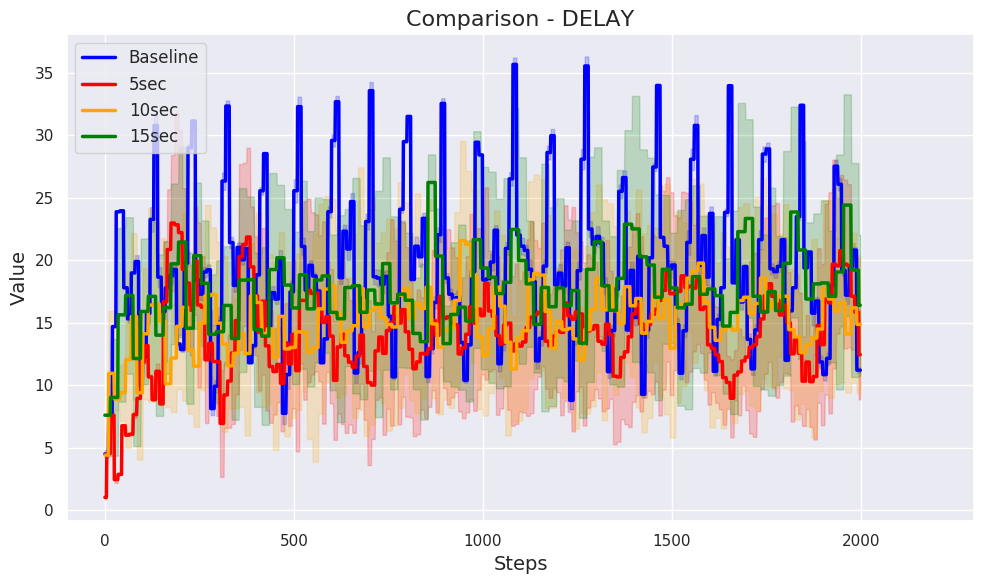

In [316]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

# Plot the average
plt.plot(base_mid_Dm_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(wt_mid5_Dm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(wtb1_Dm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(wt_mid15_Dm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Dm_full)), np.array(base_mid_Dm_full) - np.array(base_mid_Ds_full),
                np.array(base_mid_Dm_full) + np.array(base_mid_Ds_full),
                color='blue', alpha=0.2)

plt.fill_between(range(len(wt_mid5_Dm_full[:2000])), np.array(wt_mid5_Dm_full[:2000]) - np.array(wt_mid5_Ds_full[:2000]),
                np.array(wt_mid5_Dm_full[:2000]) + np.array(wt_mid5_Ds_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(wtb1_Dm_full[:2000])), np.array(wtb1_Dm_full[:2000]) - np.array(wtb1_Ds_full[:2000]),
                np.array(wtb1_Dm_full[:2000]) + np.array(wtb1_Ds_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(wt_mid15_Dm_full[:2000])), np.array(wt_mid15_Dm_full[:2000]) - np.array(wt_mid15_Ds_full[:2000]),
                np.array(wt_mid15_Dm_full[:2000]) + np.array(wt_mid15_Ds_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - DELAY', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.xlim(right=2300)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

###########################################################################################################################

### RW: QUEUE LENGTH

#### TRAFFIC VARIATION

##### light traffic

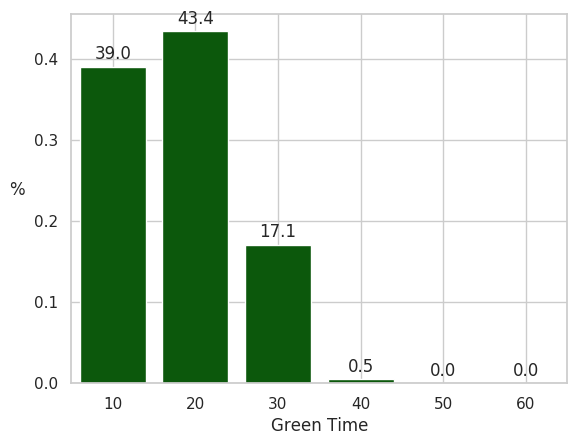

In [64]:
qllow =  pd.read_csv('results/stats_ped/ql_mixlarge_high') 
plotAct(qllow, 10, '')

In [65]:
ql_mid_10_V, ql_mid_10_Vm, ql_mid_10_Vs  = getRes(10, qllow, 'wt_veh')
np.mean(ql_mid_10_Vm)

3643.571121822962

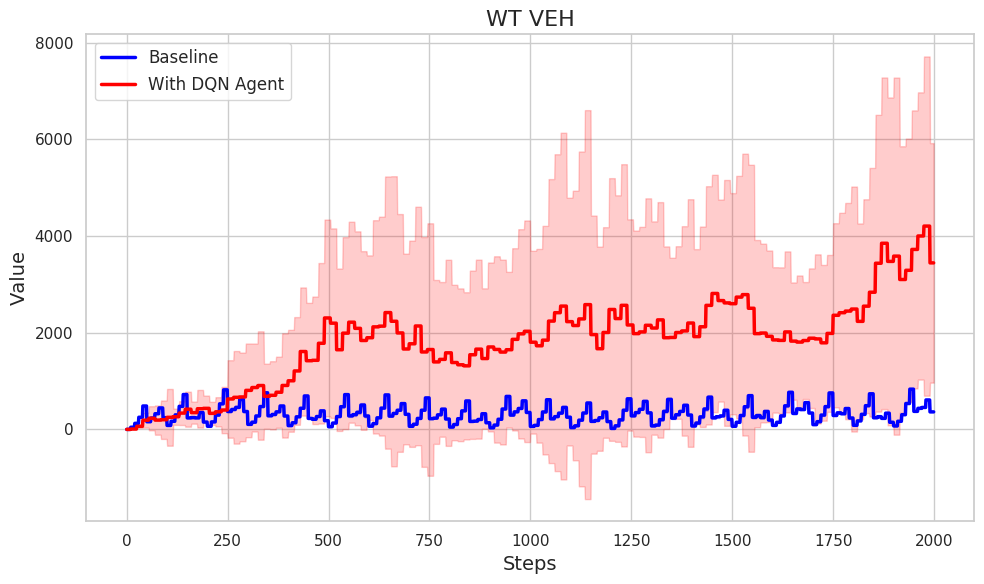

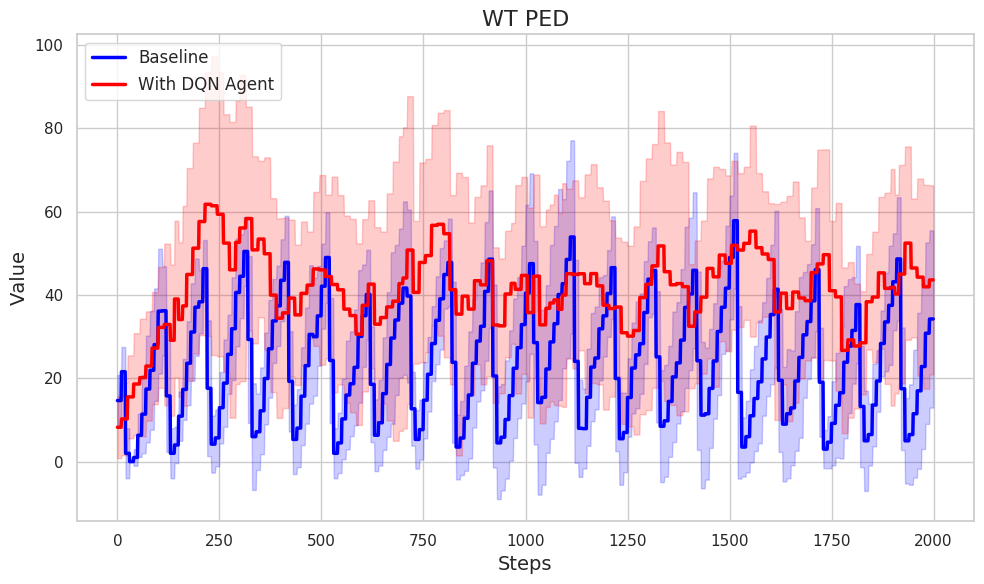

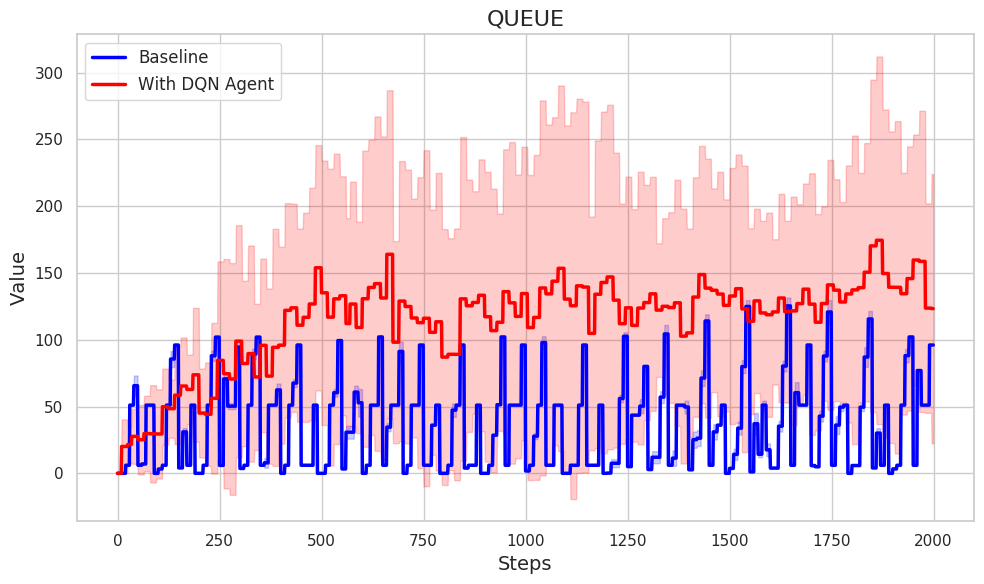

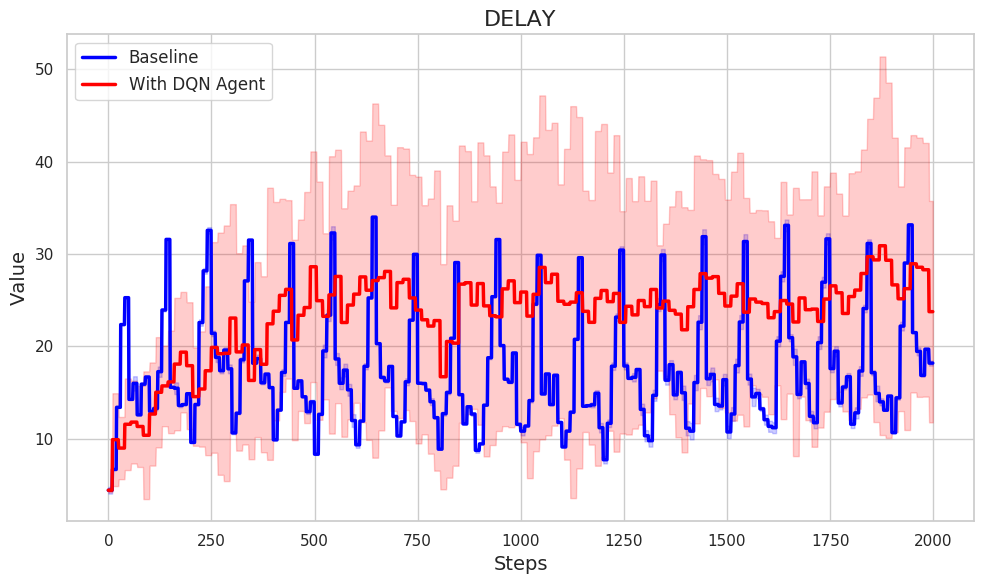

In [176]:

ql_low_10 = pd.read_csv('results/stats_ped/dl_VAR')  #ql_low_410

ql_low_10_V, ql_low_10_Vm, ql_low_10_Vs  = getRes(10, ql_low_10, 'wt_veh')
ql_low_10_Vm_full, ql_low_10_Vs_full = enl(ql_low_10_V, ql_low_10_Vm,ql_low_10_Vs, 10)
defPlot(base_low_Vm_full, base_low_Vs_full, ql_low_10_Vm_full[:2000], ql_low_10_Vs_full[:2000], 'WT VEH')

ql_low_10_P, ql_low_10_Pm, ql_low_10_Ps = getRes(10, ql_low_10, 'wt_ped')
ql_low_10_Pm_full, ql_low_10_Ps_full = enl(ql_low_10_P, ql_low_10_Pm, ql_low_10_Ps, 10)
defPlot(base_low_Pm_full, base_low_Ps_full, ql_low_10_Pm_full[:2000], ql_low_10_Ps_full[:2000], 'WT PED')

ql_low_10_Q, ql_low_10_Qm, ql_low_10_Qs = getRes(10, ql_low_10, 'queue')
ql_low_10_Qm_full, ql_low_10_Qs_full = enl(ql_low_10_Q, ql_low_10_Qm, ql_low_10_Qs, 10)
defPlot(base_low_Qm_full, base_low_Qs_full, ql_low_10_Qm_full[:2000], ql_low_10_Qs_full[:2000], 'QUEUE')

ql_low_10_D, ql_low_10_Dm, ql_low_10_Ds = getRes(10, ql_low_10, 'delay')
ql_low_10_Dm_full, ql_low_10_Ds_full = enl(ql_low_10_D, ql_low_10_Dm, ql_low_10_Ds, 10)
defPlot(base_low_Dm_full, base_low_Ds_full, ql_low_10_Dm_full[:2000], ql_low_10_Ds_full[:2000], 'DELAY')

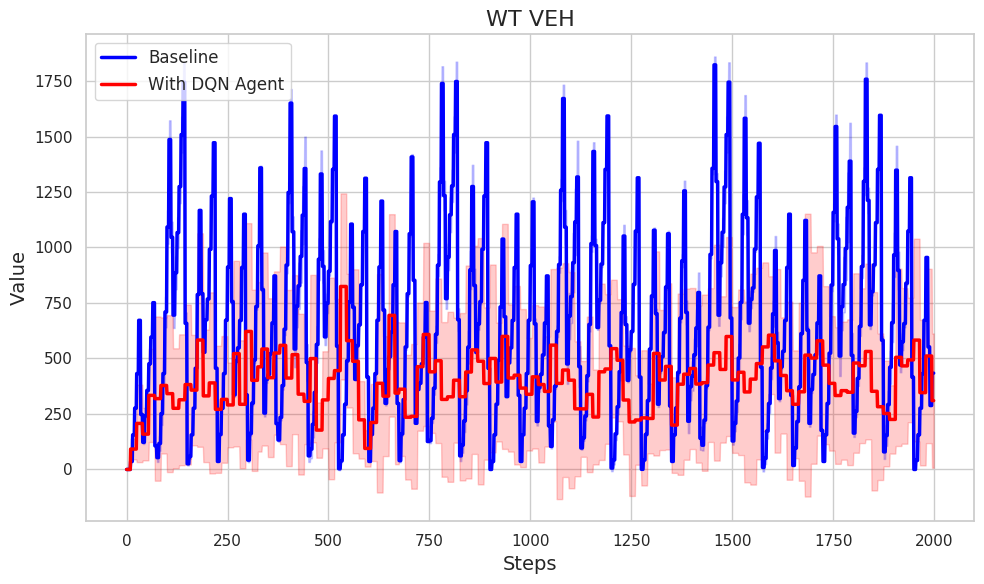

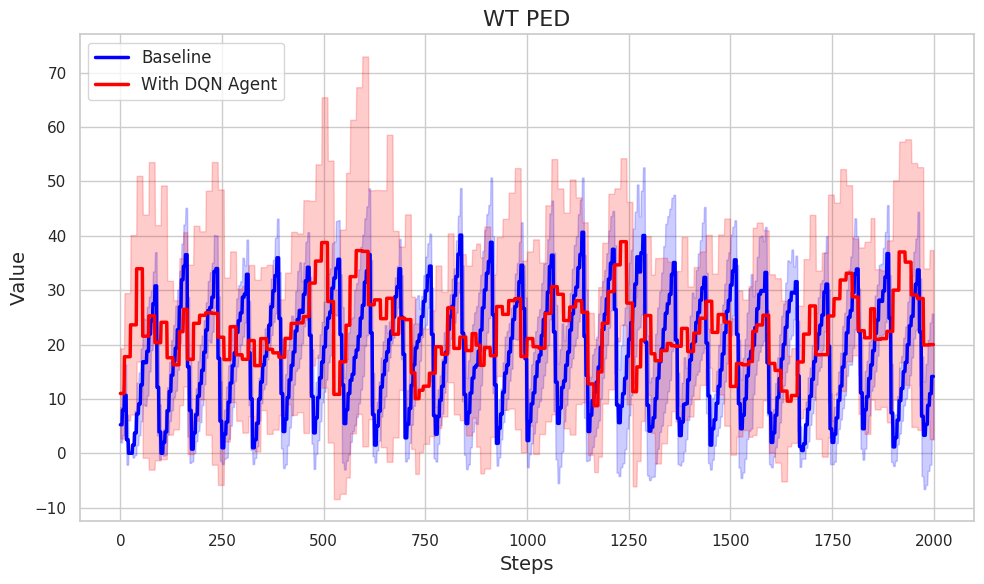

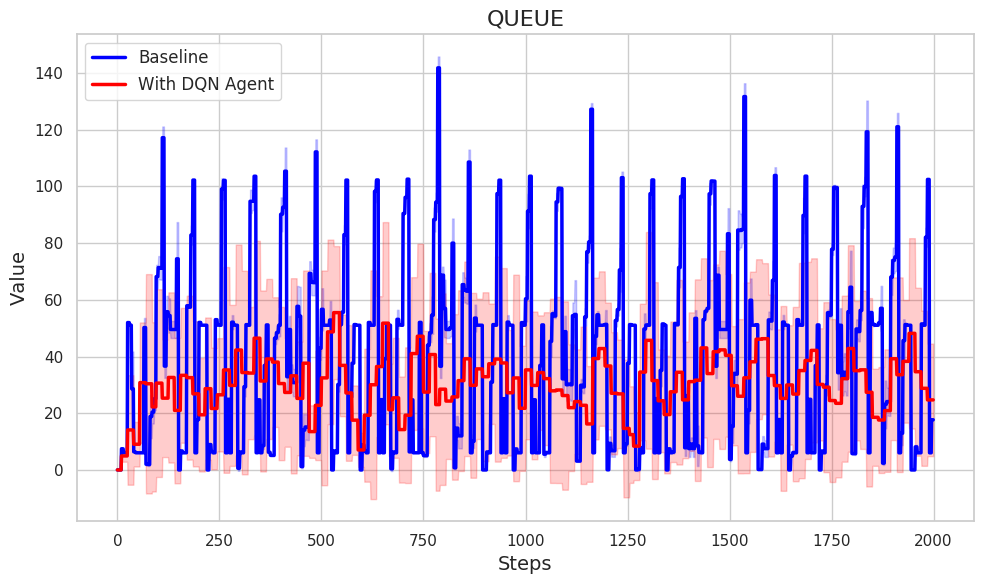

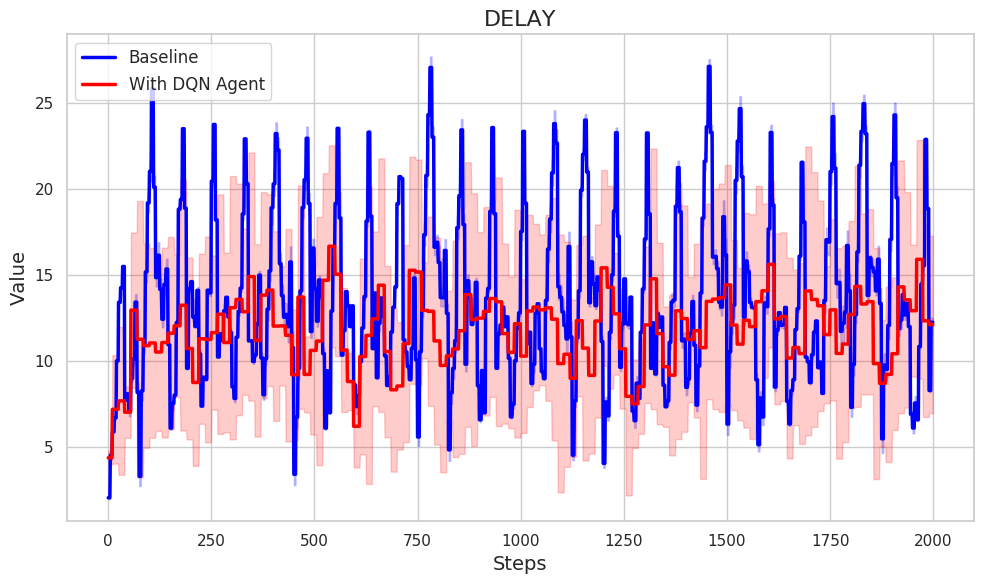

In [233]:
#ql_low_10 = pd.read_csv('results/stats_ped/ql_STD_pen20') 
ql_low_10 = pd.read_csv('results/stats_ped/mix_low_ql_2') 
ql_low_10_P2, ql_low_10_Pm2, ql_low_10_Ps2 = getRes(10, ql_low_10, 'wt_ped')

ql_low_10 = pd.read_csv('results/stats_ped/ql_mixlarge_low')  #ql_low_410

ql_low_10_V, ql_low_10_Vm, ql_low_10_Vs  = getRes(10, ql_low_10, 'wt_veh')
ql_low_10_Vm_full, ql_low_10_Vs_full = enl(ql_low_10_V, ql_low_10_Vm,ql_low_10_Vs, 10)
defPlot(base_low_Vm_full, base_low_Vs_full, ql_low_10_Vm_full[:2000], ql_low_10_Vs_full[:2000], 'WT VEH')

ql_low_10_P, ql_low_10_Pm, ql_low_10_Ps = getRes(10, ql_low_10, 'wt_ped')
ql_low_10_Pm_full, ql_low_10_Ps_full = enl(ql_low_10_P, ql_low_10_Pm, ql_low_10_Ps, 10)
defPlot(base_low_Pm_full, base_low_Ps_full, ql_low_10_Pm_full[:2000], ql_low_10_Ps_full[:2000], 'WT PED')

ql_low_10_Q, ql_low_10_Qm, ql_low_10_Qs = getRes(10, ql_low_10, 'queue')
ql_low_10_Qm_full, ql_low_10_Qs_full = enl(ql_low_10_Q, ql_low_10_Qm, ql_low_10_Qs, 10)
defPlot(base_low_Qm_full, base_low_Qs_full, ql_low_10_Qm_full[:2000], ql_low_10_Qs_full[:2000], 'QUEUE')

ql_low_10_D, ql_low_10_Dm, ql_low_10_Ds = getRes(10, ql_low_10, 'delay')
ql_low_10_Dm_full, ql_low_10_Ds_full = enl(ql_low_10_D, ql_low_10_Dm, ql_low_10_Ds, 10)
defPlot(base_low_Dm_full, base_low_Ds_full, ql_low_10_Dm_full[:2000], ql_low_10_Ds_full[:2000], 'DELAY')

##### moderate traffic

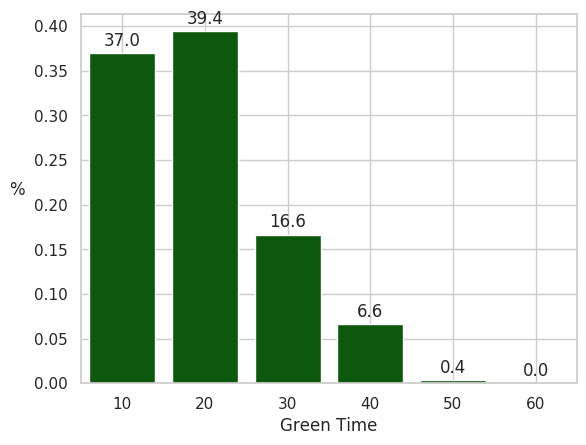

In [152]:
plotAct(ql_mid_10, 10, '')

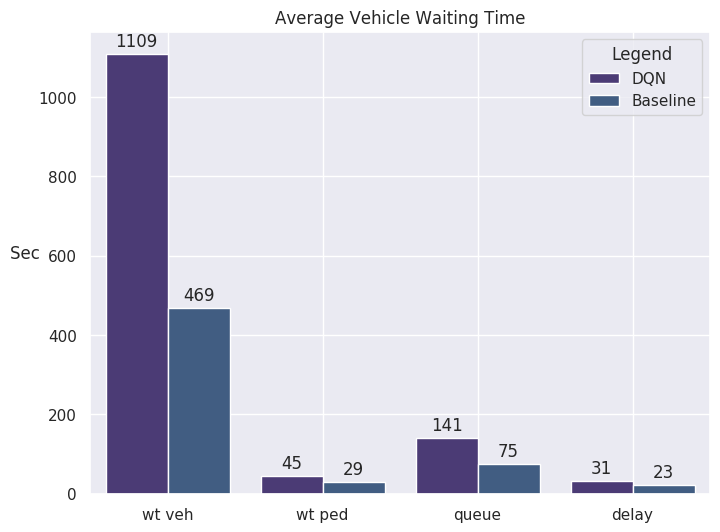

In [182]:
instaRes_all(ql_mid_10_Vm, ql_mid_10_Pm, ql_mid_10_Qm, ql_mid_10_Dm)

In [114]:
#ql_mid_10_base = pd.read_csv('results/stats_ped/ql_lowveh_10g_ped35_base')
#ql_mid_10 = pd.read_csv('results/stats_ped/mix_mid_ql_7') #mix_mid_ql_6 con mod_mix_10_ql_high  o prev mix_mid_ql_2 (con mod_mixlow_10_ql (forse senza low))
#ql_mid_10 = pd.read_csv('results/stats_ped/mix_mid_ql_10sec_pen200') #modello op, penalità NO in realtà
#ql_mid_10_pen = pd.read_csv('results/stats_ped/mix_mid_ql_10sec_pen2') #beta = 0.05, semafori più corti (plotAct) e wt pedoni più basso
#ql_mid_10_pen_b3 = pd.read_csv('results/stats_ped/mix_mid_ql_10sec_pen')  #beta = 0.03, semafori più lunghi (plotAct) ma wt pedoni più alto


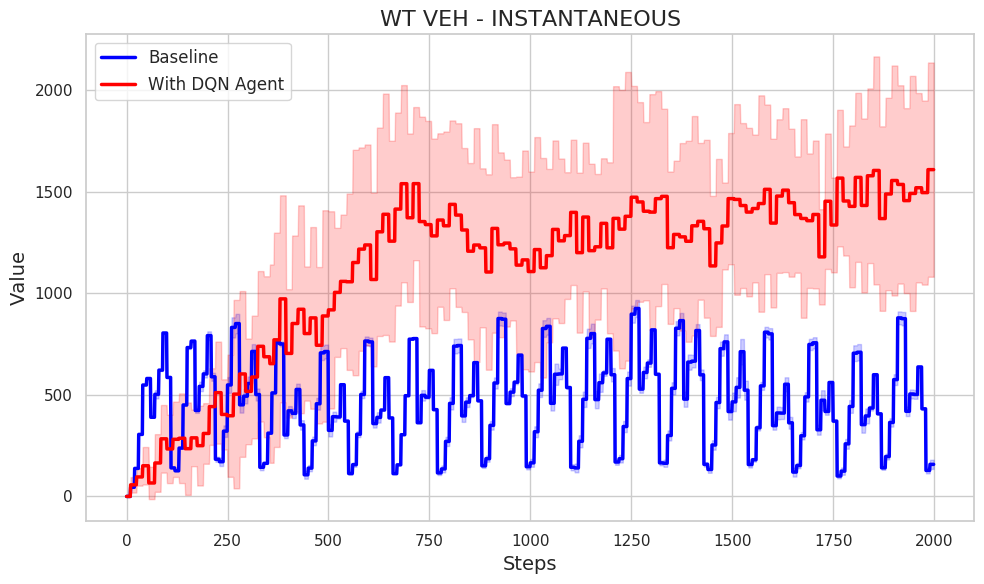

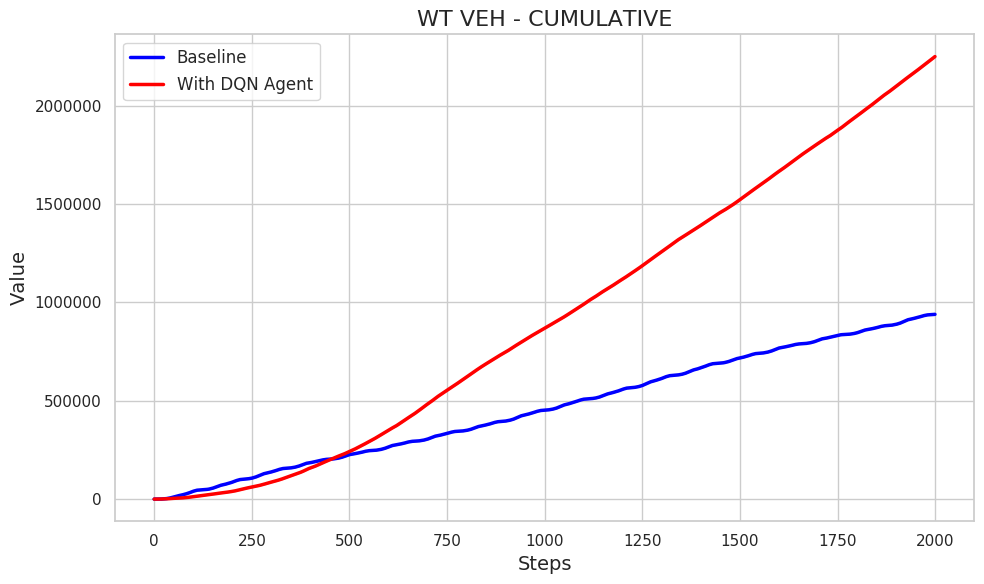

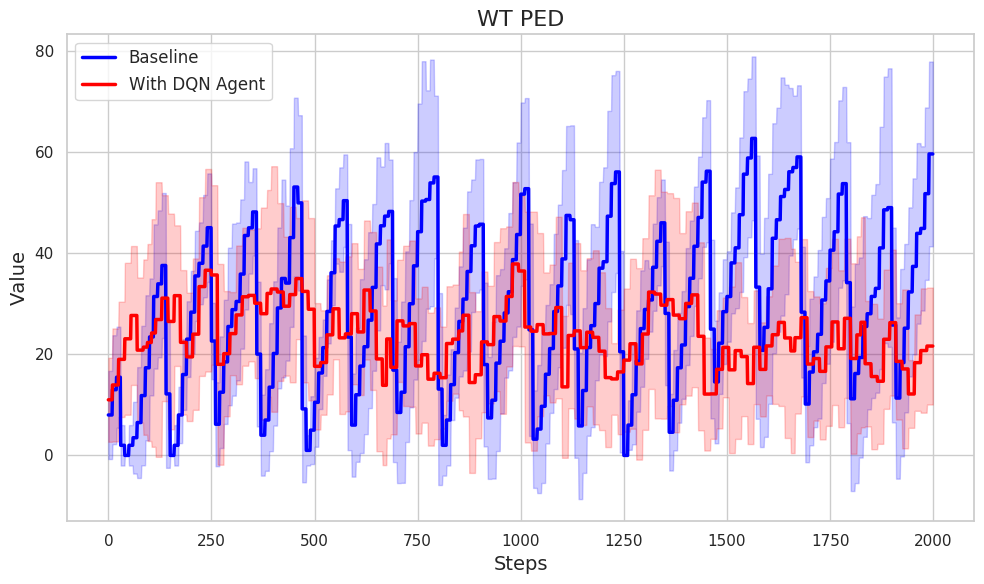

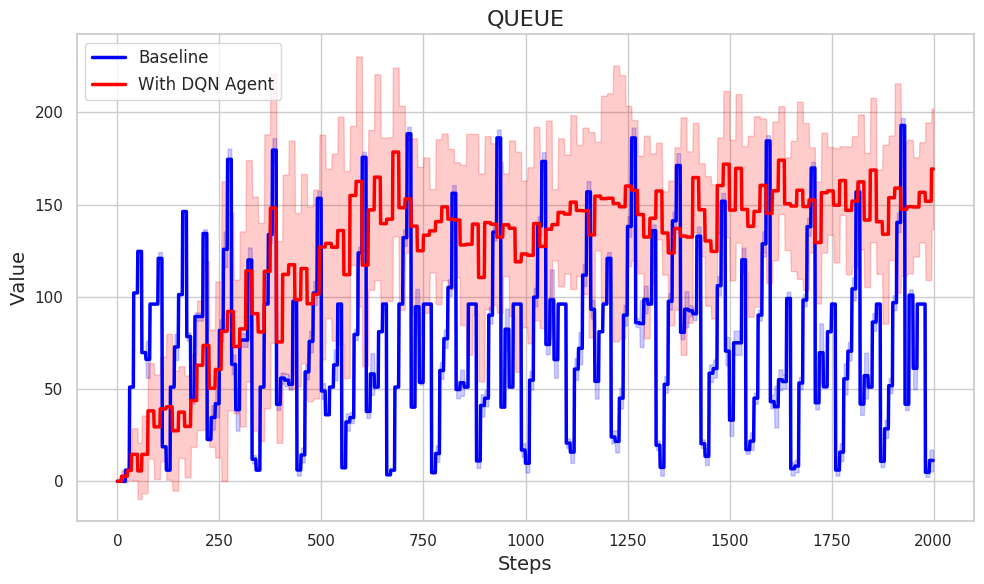

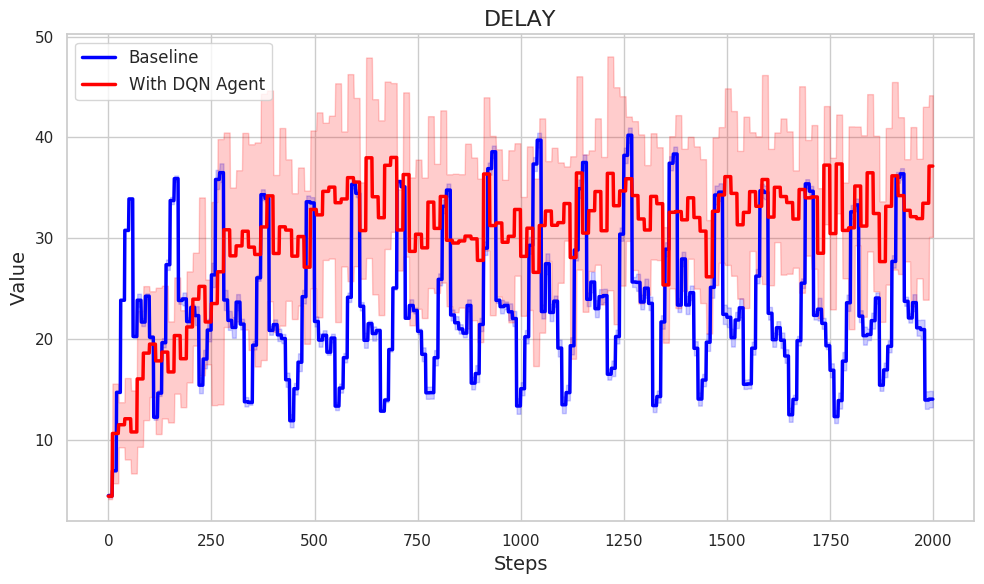

In [21]:
ql_mid_10 = pd.read_csv('results/stats_ped/wt_high')  #mix_mid_ql_10sec_pen2 #mix_mid_ql_10sec_pen2 #ql_mid_beta5ma2

ql_mid_10_V, ql_mid_10_Vm, ql_mid_10_Vs  = getRes(10, ql_mid_10, 'wt_veh')
ql_mid_10_Vm_full, ql_mid_10_Vs_full = enl(ql_mid_10_V, ql_mid_10_Vm, ql_mid_10_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, ql_mid_10_Vm_full[:2000], ql_mid_10_Vs_full[:2000], 'WT VEH - INSTANTANEOUS')
defPlot(np.cumsum(base_mid_Vm_full), base_mid_Vs_full, np.cumsum(ql_mid_10_Vm_full[:2000]), ql_mid_10_Vs_full[:2000], 'WT VEH - CUMULATIVE')

ql_mid_10_P, ql_mid_10_Pm, ql_mid_10_Ps = getRes(10, ql_mid_10, 'wt_ped')
ql_mid_10_Pm_full, ql_mid_10_Ps_full = enl(ql_mid_10_P, ql_mid_10_Pm, ql_mid_10_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, ql_mid_10_Pm_full[:2000], ql_mid_10_Ps_full[:2000], 'WT PED')

ql_mid_10_Q, ql_mid_10_Qm, ql_mid_10_Qs = getRes(10, ql_mid_10, 'queue')
ql_mid_10_Qm_full, ql_mid_10_Qs_full = enl(ql_mid_10_Q, ql_mid_10_Qm, ql_mid_10_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, ql_mid_10_Qm_full[:2000], ql_mid_10_Qs_full[:2000], 'QUEUE')

ql_mid_10_D, ql_mid_10_Dm, ql_mid_10_Ds = getRes(10, ql_mid_10, 'delay')
ql_mid_10_Dm_full, ql_mid_10_Ds_full = enl(ql_mid_10_D, ql_mid_10_Dm, ql_mid_10_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, ql_mid_10_Dm_full[:2000], ql_mid_10_Ds_full[:2000], 'DELAY')

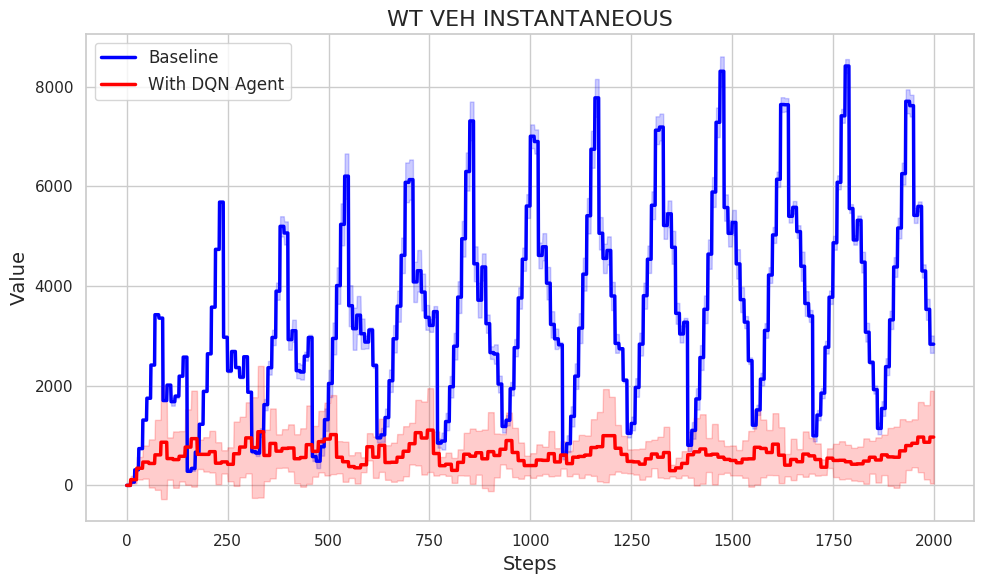

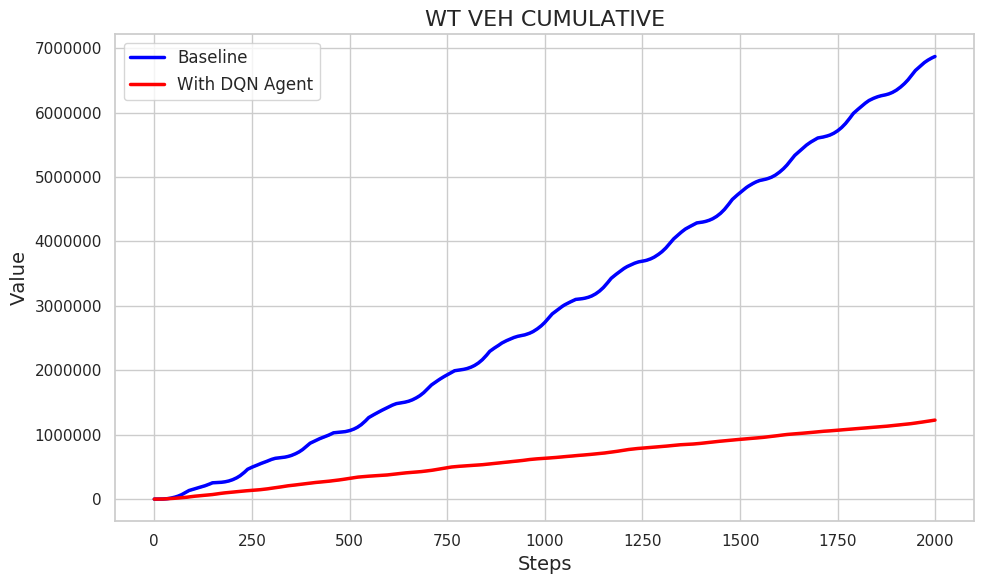

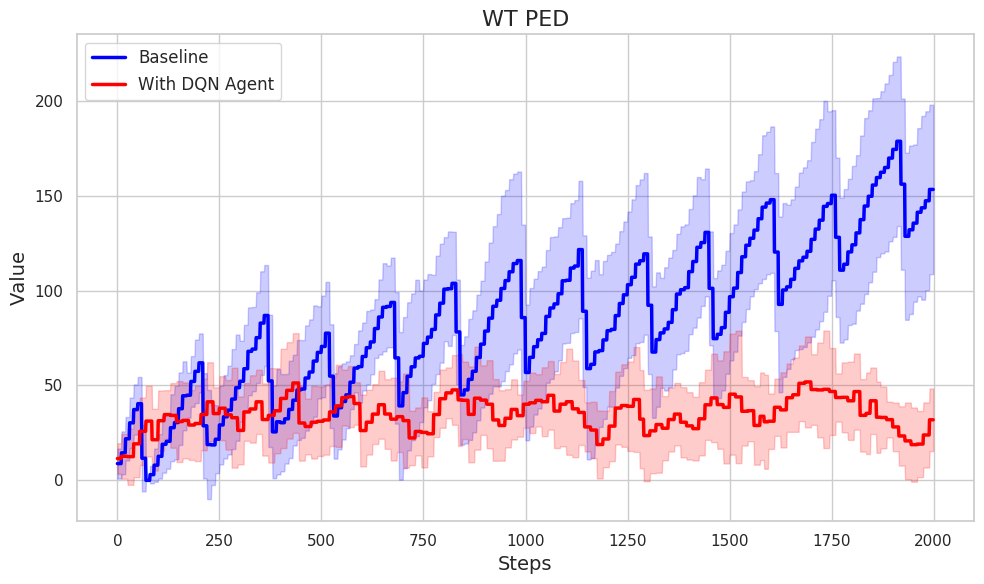

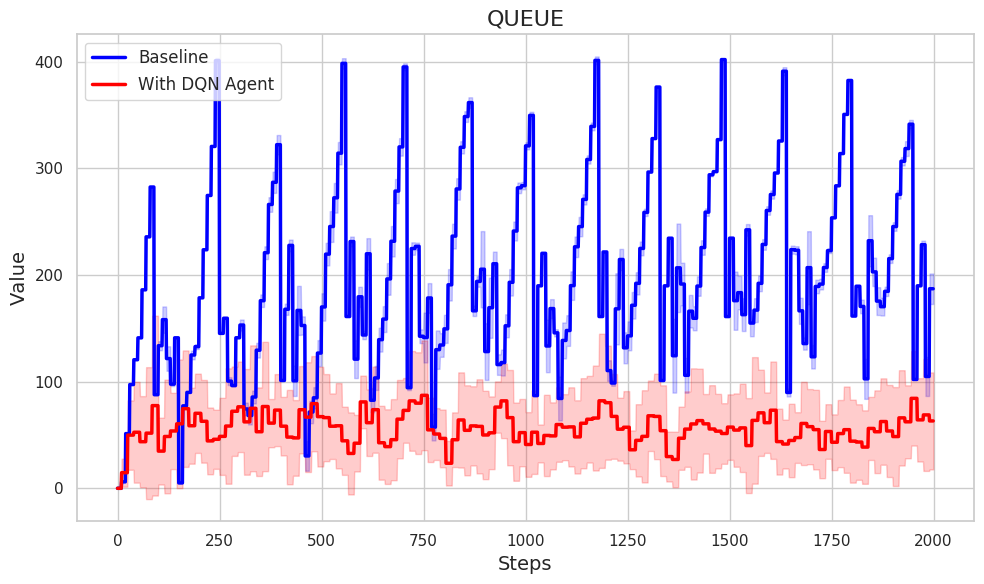

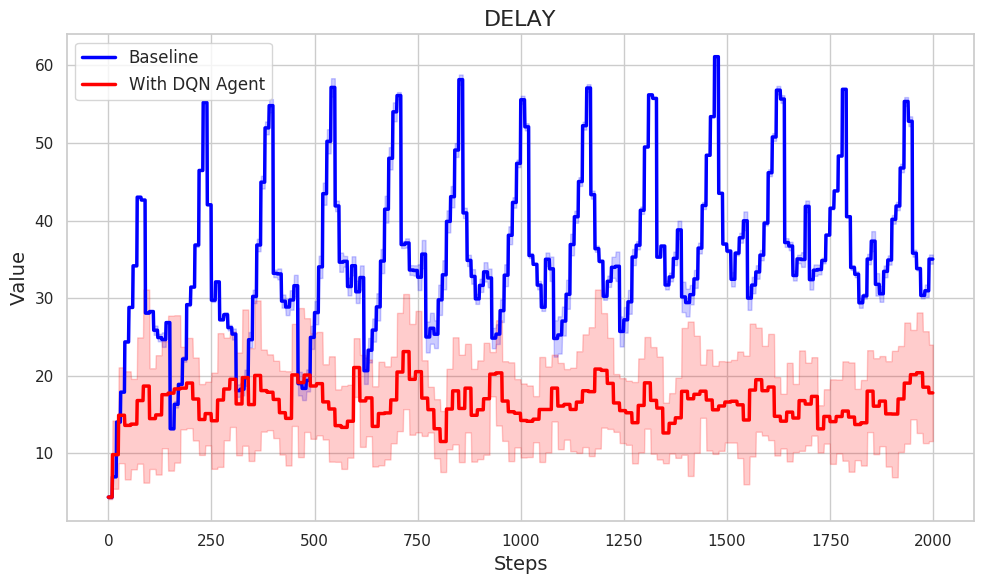

In [86]:
ql_STD = pd.read_csv('results/stats_ped/ql_STD_pen60') 

ql_STD_V, ql_STD_Vm, ql_STD_Vs  = getRes(10, ql_STD, 'wt_veh')
ql_STD_Vm_full, ql_STD_Vs_full = enl(ql_STD_V, ql_STD_Vm, ql_STD_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, ql_STD_Vm_full[:2000], ql_STD_Vs_full[:2000], 'WT VEH INSTANTANEOUS')
defPlot(np.cumsum(base_mid_Vm_full), (base_mid_Vs_full), np.cumsum(ql_STD_Vm_full[:2000]), (ql_STD_Vs_full[:2000]), 'WT VEH CUMULATIVE')

ql_STD_P, ql_STD_Pm, ql_STD_Ps = getRes(10, ql_STD, 'wt_ped')
ql_STD_Pm_full, ql_STD_Ps_full = enl(ql_STD_P, ql_STD_Pm, ql_STD_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, ql_STD_Pm_full[:2000], ql_STD_Ps_full[:2000], 'WT PED')

ql_STD_Q, ql_STD_Qm, ql_STD_Qs = getRes(10, ql_STD, 'queue')
ql_STD_Qm_full, ql_STD_Qs_full = enl(ql_STD_Q, ql_STD_Qm, ql_STD_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, ql_STD_Qm_full[:2000], ql_STD_Qs_full[:2000], 'QUEUE')

ql_STD_D, ql_STD_Dm, ql_STD_Ds = getRes(10, ql_STD, 'delay')
ql_STD_Dm_full, ql_STD_Ds_full = enl(ql_STD_D, ql_STD_Dm, ql_STD_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, ql_STD_Dm_full[:2000], ql_STD_Ds_full[:2000], 'DELAY')

##### heavy traffic

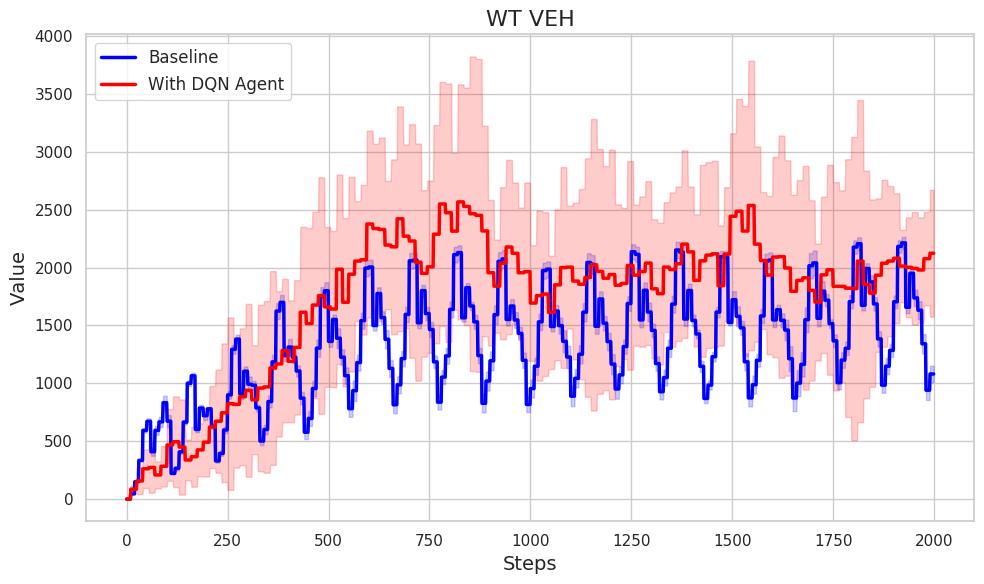

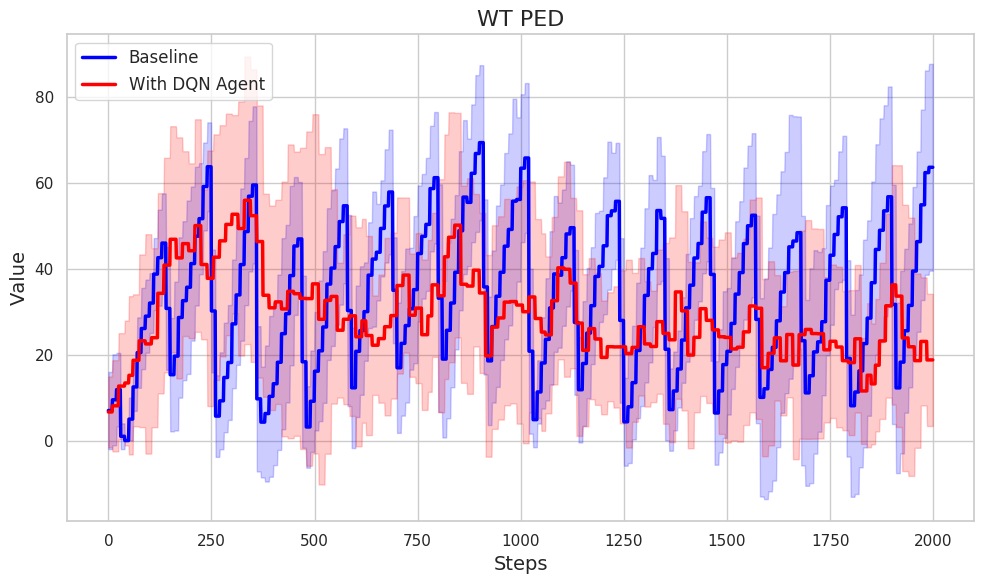

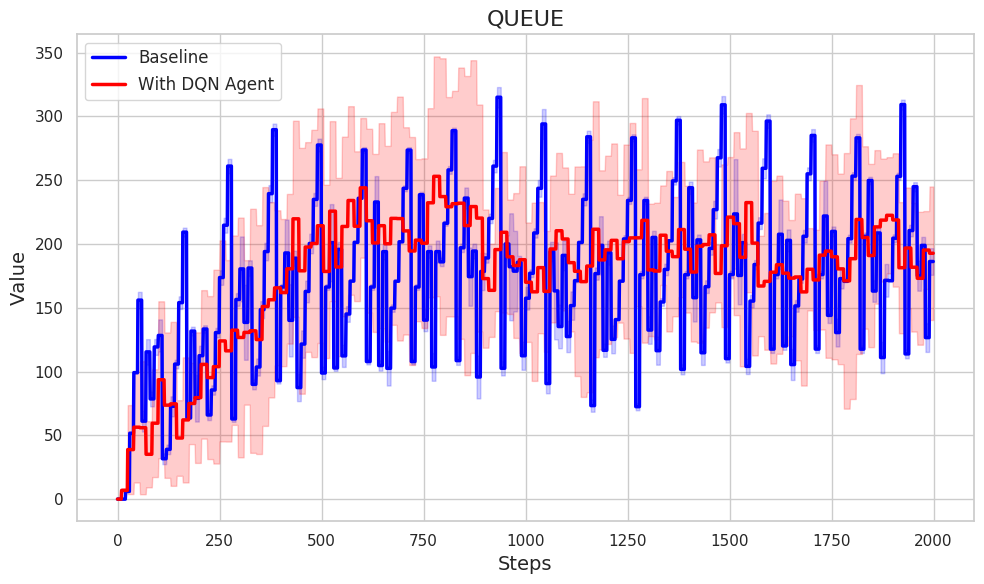

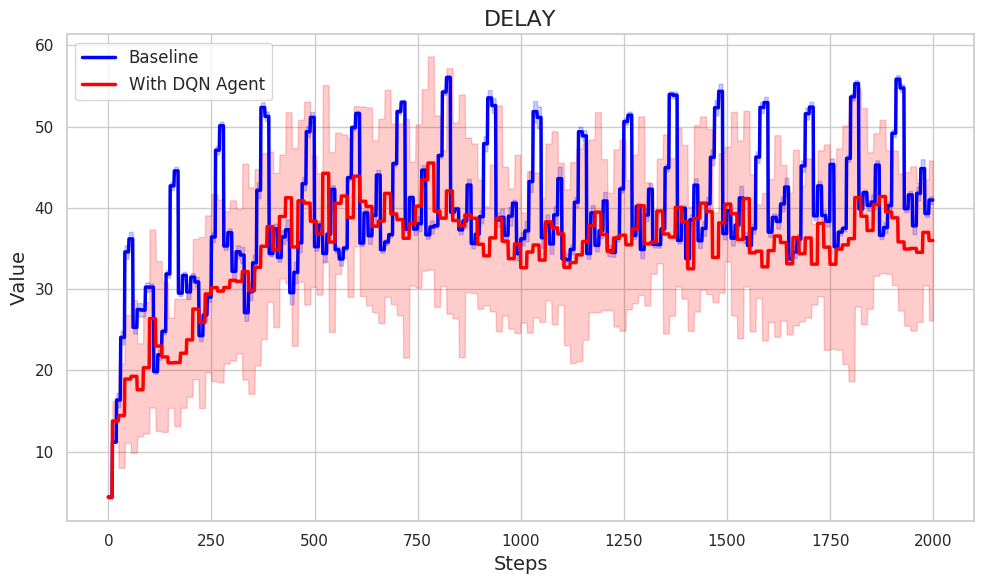

In [28]:
ql_high_10 = pd.read_csv('results/stats_ped/ql_high_mixlarge')  #mix_high_ql_9

ql_high_10_V, ql_high_10_Vm, ql_high_10_Vs  = getRes(10, ql_high_10, 'wt_veh')
ql_high_10_Vm_full, ql_high_10_Vs_full = enl(ql_high_10_V, ql_high_10_Vm, ql_high_10_Vs, 10)
defPlot(base_high_Vm_full, base_high_Vs_full, ql_high_10_Vm_full[:2000], ql_high_10_Vs_full[:2000], 'WT VEH')

ql_high_10_P, ql_high_10_Pm, ql_high_10_Ps = getRes(10, ql_high_10, 'wt_ped')
ql_high_10_Pm_full, ql_high_10_Ps_full = enl(ql_high_10_P, ql_high_10_Pm, ql_high_10_Ps, 10)
defPlot(base_high_Pm_full, base_high_Ps_full, ql_high_10_Pm_full[:2000], ql_high_10_Ps_full[:2000], 'WT PED')

ql_high_10_Q, ql_high_10_Qm, ql_high_10_Qs = getRes(10, ql_high_10, 'queue')
ql_high_10_Qm_full, ql_high_10_Qs_full = enl(ql_high_10_Q, ql_high_10_Qm, ql_high_10_Qs, 10)
defPlot(base_high_Qm_full, base_high_Qs_full, ql_high_10_Qm_full[:2000], ql_high_10_Qs_full[:2000], 'QUEUE')

ql_high_10_D, ql_high_10_Dm, ql_high_10_Ds = getRes(10, ql_high_10, 'delay')
ql_high_10_Dm_full, ql_high_10_Ds_full = enl(ql_high_10_D, ql_high_10_Dm, ql_high_10_Ds, 10)
defPlot(base_high_Dm_full, base_high_Ds_full, ql_high_10_Dm_full[:2000], ql_high_10_Ds_full[:2000], 'DELAY')

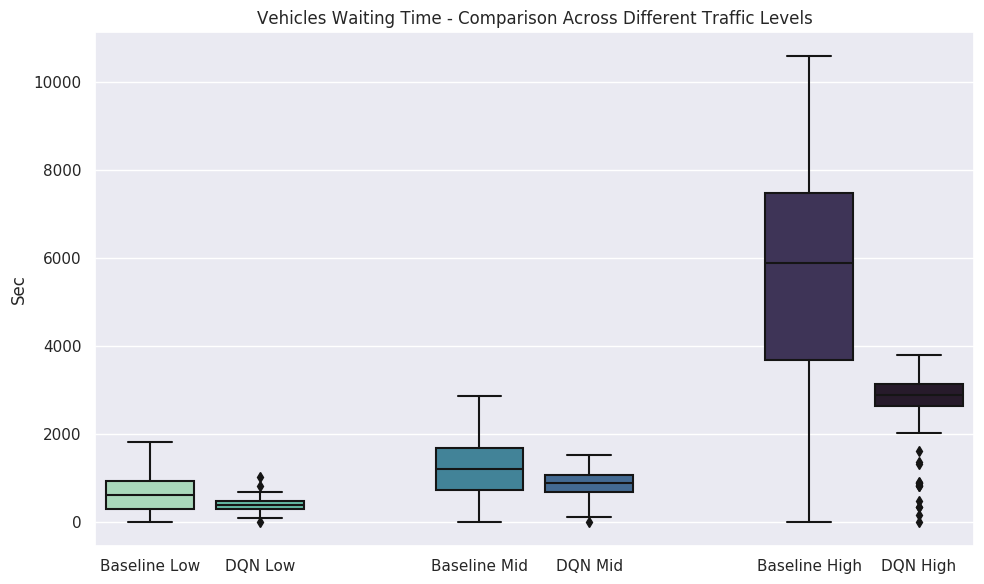

In [237]:
sns.set(style="darkgrid")

data = [base_low_Vm, ql_low_10_Vm, [], base_mid_Vm, ql_mid_10_Vm, [], base_high_Vm, ql_high_10_Vm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(10, 6))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Vehicles Waiting Time - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

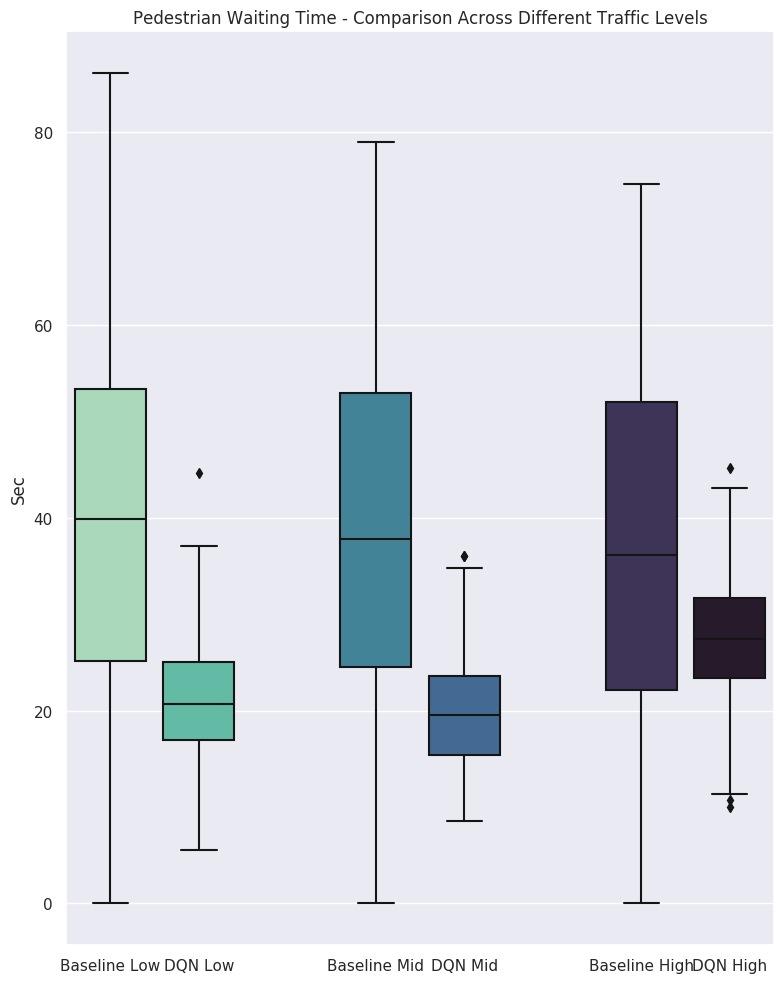

In [205]:
sns.set(style="darkgrid")

data = [base_low_Pm2, ql_low_10_Pm2, [], base_mid_Pm2, ql_mid_10_Pm, [], base_high_Pm2, ql_high_10_Pm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(8, 10))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Pedestrian Waiting Time - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

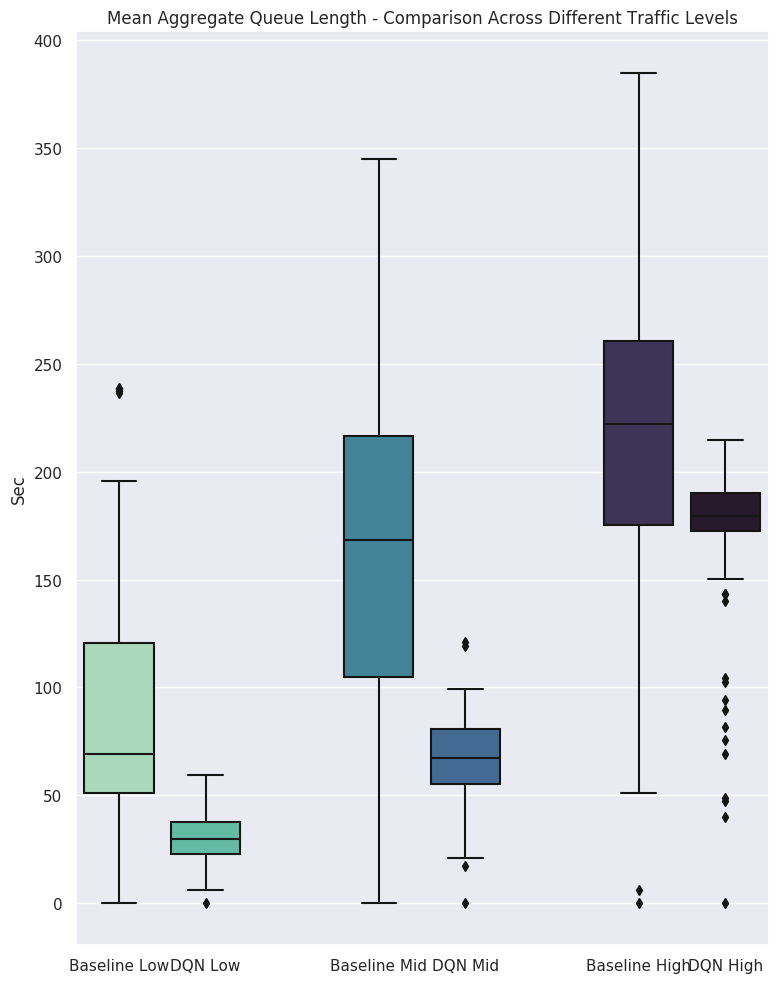

In [203]:
sns.set(style="darkgrid")

data = [base_low_Qm2, ql_low_10_Qm, [], base_mid_Qm2, ql_mid_10_Qm, [], base_high_Qm2, ql_high_10_Qm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(8, 10))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Mean Aggregate Queue Length - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

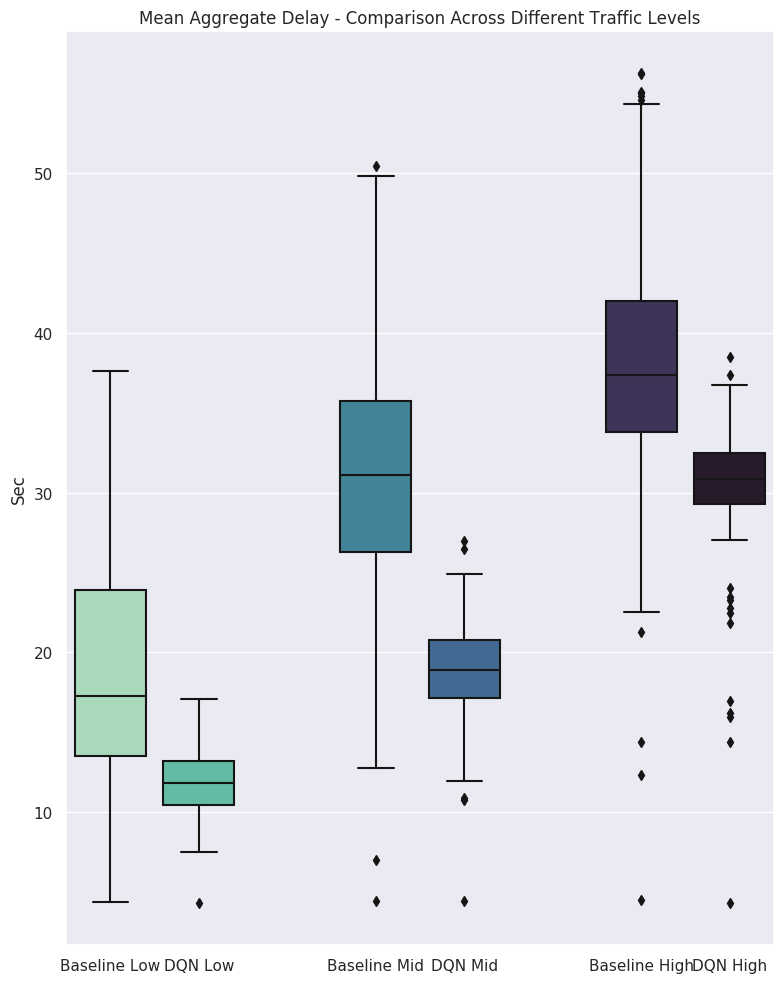

In [202]:
sns.set(style="darkgrid")

data = [base_low_Dm2, ql_low_10_Dm, [], base_mid_Dm2, ql_mid_10_Dm, [], base_high_Dm2, ql_high_10_Dm]
labels = ['Baseline Low', 'DQN Low', '', 'Baseline Mid', 'DQN Mid', '', 'Baseline High', 'DQN High']

# Set figure size
plt.figure(figsize=(8, 10))

sns.boxplot(data=[x if x != [] else [np.nan] for x in data], showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Mean Aggregate Delay - Comparison Across Different Traffic Levels')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

##### Comparison

In [142]:
def instaRes (low, mid, high, perc=False):

    if perc:
        dct_base = {'wt veh LOW':np.mean(base_low_Vm2)*100/np.mean(base_low_Vm2), 'wt veh MID':np.mean(base_mid_Vm2)*100/np.mean(base_mid_Vm2), 'wt veh HIGH':np.mean(base_high_Vm2)*100/np.mean(base_high_Vm2)}
        dct = {'wt veh LOW':np.mean(low)*100/np.mean(base_low_Vm2), 'wt veh MID':np.mean(mid)*100/np.mean(base_mid_Vm2), 'wt veh HIGH':np.mean(high)*100/np.mean(base_high_Vm2)}
    else:
        dct_base = {'wt veh LOW':np.mean(base_low_Vm2), 'wt veh MID':np.mean(base_mid_Vm2), 'wt veh HIGH':np.mean(base_high_Vm2)}
        dct = {'wt veh LOW':np.mean(low), 'wt veh MID':np.mean(mid), 'wt veh HIGH':np.mean(ql_high_10_Vm)}


    df = pd.DataFrame([dct, dct_base])

    df_melted = df.melt(var_name='Key', value_name='Value')
    df_melted['Legend'] = ['DQN', 'Baseline']*3

    sns.set(style="darkgrid")
    sns.set_palette("viridis")

    plt.figure(figsize=(8, 6))
    ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


    for p in ax.patches:
        ax.annotate(format(p.get_height(), '.0f'),
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center',
                    xytext=(0, 9),  # offset text by 9 points above bar
                    textcoords='offset points')

    plt.title('Average Vehicle Waiting Time')
    plt.xlabel('')
    plt.ylabel('Sec   ', rotation=0)
    plt.grid(True)
    plt.show()
    

In [125]:
def instaRes_all (veh, ped, queue, delay, perc=False):

    if perc:
        dct_base = {'wt veh':np.mean(base_mid_Vm)*100/np.mean(base_mid_Vm), 'wt ped':np.mean(base_mid_Pm)*100/np.mean(base_mid_Pm), 'queue':np.mean(base_mid_Qm)*100/np.mean(base_mid_Qm), 'delay':np.mean(base_mid_Dm)*100/np.mean(base_mid_Dm)}
        dct = {'wt veh':np.mean(veh)*100/np.mean(base_mid_Vm), 'wt ped':np.mean(ped)*100/np.mean(base_mid_Pm), 'queue':np.mean(queue)*100/np.mean(base_mid_Qm), 'delay':np.mean(delay)*100/np.mean(base_mid_Dm)}
    else:
        dct_base = {'wt veh':np.mean(base_mid_Vm), 'wt ped':np.mean(base_mid_Pm), 'queue':np.mean(base_mid_Qm), 'delay':np.mean(base_mid_Dm)}
        dct = {'wt veh':np.mean(veh), 'wt ped':np.mean(ped), 'queue':np.mean(queue), 'delay':np.mean(delay)}

    df = pd.DataFrame([dct, dct_base])

    df_melted = df.melt(var_name='Key', value_name='Value')
    df_melted['Legend'] = ['DQN', 'Baseline']*4

    sns.set(style="darkgrid")
    sns.set_palette("viridis")

    plt.figure(figsize=(8, 6))
    ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


    for p in ax.patches:
        ax.annotate(format(p.get_height(), '.0f'),
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center',
                    xytext=(0, 9),  # offset text by 9 points above bar
                    textcoords='offset points')

    plt.title('Average Vehicle Waiting Time')
    plt.xlabel('')
    plt.ylabel('Sec   ', rotation=0)
    plt.grid(True)
    plt.show()
    

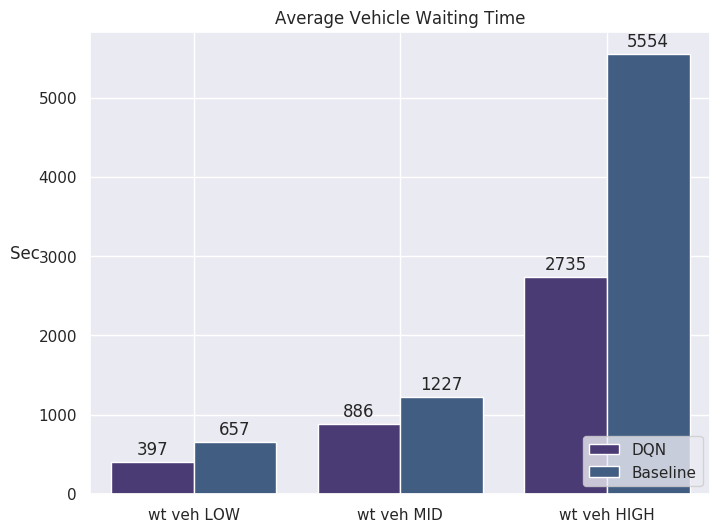

In [238]:
qlbase = {'wt veh LOW':np.mean(base_low_Vm), 'wt veh MID':np.mean(base_mid_Vm), 'wt veh HIGH':np.mean(base_high_Vm)}
qldct = {'wt veh LOW':np.mean(ql_low_10_Vm), 'wt veh MID':np.mean(ql_mid_10_Vm), 'wt veh HIGH':np.mean(ql_high_10_Vm)} #ql_STD_Vm

#dlmid = {'wt veh':np.mean(qlmid10_Vm_full), 'wt ped':np.mean(qlmid10_Pm_full), 'queue len':np.mean(qlmid10_Qm_full), 'delay':np.mean(qlmid10_Dm_full)}
#dlhigh = {'wt veh':np.mean(qlhigh10_Vm_full), 'wt ped':np.mean(qlhigh10_Pm_full), 'queue len':np.mean(qlhigh10_Qm_full), 'delay':np.mean(qlhigh10_Dm_full)}

df = pd.DataFrame([qldct, qlbase])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['DQN', 'Baseline']*3

sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Average Vehicle Waiting Time')
plt.xlabel('')
plt.ylabel('Sec   ', rotation=0)
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

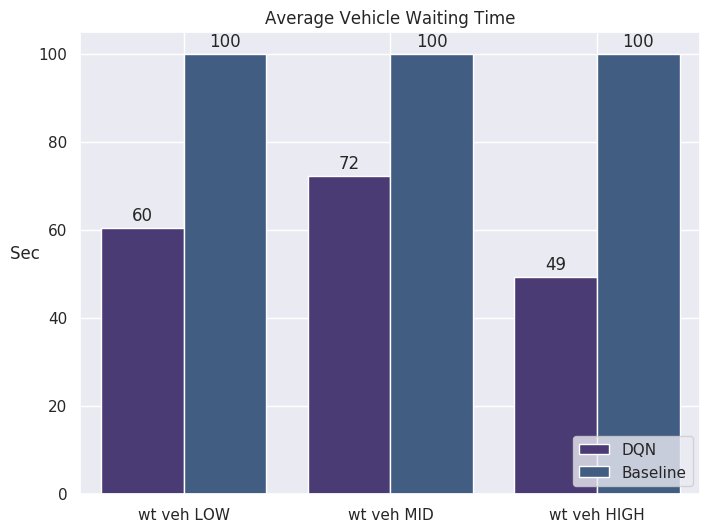

In [239]:
qlbase = {'wt veh LOW':np.mean(base_low_Vm)*100/np.mean(base_low_Vm), 'wt veh MID':np.mean(base_mid_Vm)*100/np.mean(base_mid_Vm), 'wt veh HIGH':np.mean(base_high_Vm)*100/np.mean(base_high_Vm)}
qldct = {'wt veh LOW':np.mean(ql_low_10_Vm)*100/np.mean(base_low_Vm), 'wt veh MID':np.mean(ql_mid_10_Vm)*100/np.mean(base_mid_Vm), 'wt veh HIGH':np.mean(ql_high_10_Vm)*100/np.mean(base_high_Vm)} #ql_STD_Vm

#dlmid = {'wt veh':np.mean(qlmid10_Vm_full), 'wt ped':np.mean(qlmid10_Pm_full), 'queue len':np.mean(qlmid10_Qm_full), 'delay':np.mean(qlmid10_Dm_full)}
#dlhigh = {'wt veh':np.mean(qlhigh10_Vm_full), 'wt ped':np.mean(qlhigh10_Pm_full), 'queue len':np.mean(qlhigh10_Qm_full), 'delay':np.mean(qlhigh10_Dm_full)}

df = pd.DataFrame([qldct, qlbase])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['DQN', 'Baseline']*3

sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Average Vehicle Waiting Time')
plt.xlabel('')
plt.ylabel('Sec   ', rotation=0)
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

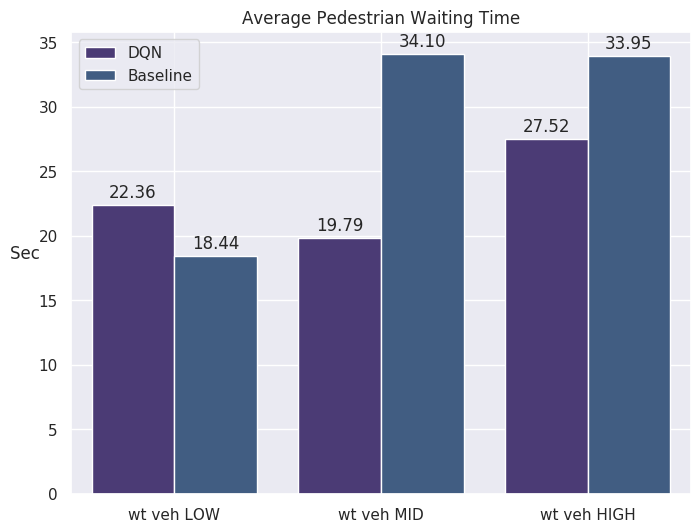

In [243]:
qlbase = {'wt veh LOW':np.mean(base_low_Pm), 'wt veh MID':np.mean(base_mid_Pm), 'wt veh HIGH':np.mean(base_high_Pm)}
qldct = {'wt veh LOW':np.mean(ql_low_10_Pm), 'wt veh MID':np.mean(ql_mid_10_Pm), 'wt veh HIGH':np.mean(ql_high_10_Pm)}

#dlmid = {'wt veh':np.mean(qlmid10_Vm_full), 'wt ped':np.mean(qlmid10_Pm_full), 'queue len':np.mean(qlmid10_Qm_full), 'delay':np.mean(qlmid10_Dm_full)}
#dlhigh = {'wt veh':np.mean(qlhigh10_Vm_full), 'wt ped':np.mean(qlhigh10_Pm_full), 'queue len':np.mean(qlhigh10_Qm_full), 'delay':np.mean(qlhigh10_Dm_full)}

df = pd.DataFrame([qldct, qlbase])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['DQN', 'Baseline']*3

sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.2f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Average Pedestrian Waiting Time')
plt.xlabel('')
plt.ylabel('Sec   ', rotation=0)
plt.grid(True)
plt.legend(loc='upper left')
plt.show()

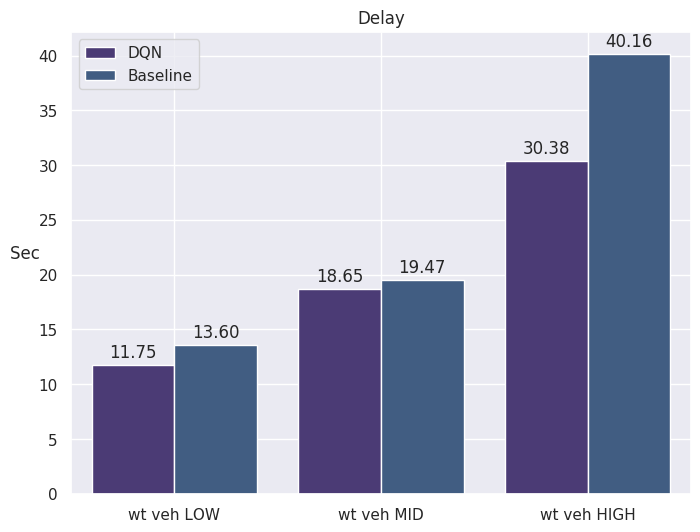

In [242]:
qlbase = {'wt veh LOW':np.mean(base_low_Dm), 'wt veh MID':np.mean(base_mid_Dm), 'wt veh HIGH':np.mean(base_high_Dm)}
qldct = {'wt veh LOW':np.mean(ql_low_10_Dm), 'wt veh MID':np.mean(ql_mid_10_Dm), 'wt veh HIGH':np.mean(ql_high_10_Dm)}

#dlmid = {'wt veh':np.mean(qlmid10_Vm_full), 'wt ped':np.mean(qlmid10_Pm_full), 'queue len':np.mean(qlmid10_Qm_full), 'delay':np.mean(qlmid10_Dm_full)}
#dlhigh = {'wt veh':np.mean(qlhigh10_Vm_full), 'wt ped':np.mean(qlhigh10_Pm_full), 'queue len':np.mean(qlhigh10_Qm_full), 'delay':np.mean(qlhigh10_Dm_full)}

df = pd.DataFrame([qldct, qlbase])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['DQN', 'Baseline']*3

sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted, width=0.8) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.2f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Delay')
plt.xlabel('')
plt.ylabel('Sec   ', rotation=0)
plt.grid(True)
plt.legend(loc='upper left')
plt.show()

#### TIME VARIATION

##### increased time

In [45]:
ql_mid_15 = pd.read_csv('results/stats_ped/mix_mid_ql_15sec') #ql_lowveh_10g_ped35
#ql_mid_15 = pd.read_csv('results/stats_ped/mix_mid_ql_15sec_nopen2') #ql_lowveh_10g_ped35
ql_mid_15_pen = pd.read_csv('results/stats_ped/mix_mid_ql_15sec_pen')
ql_mid_15_fin = pd.read_csv('results/stats_ped/ql_15s_pen30')

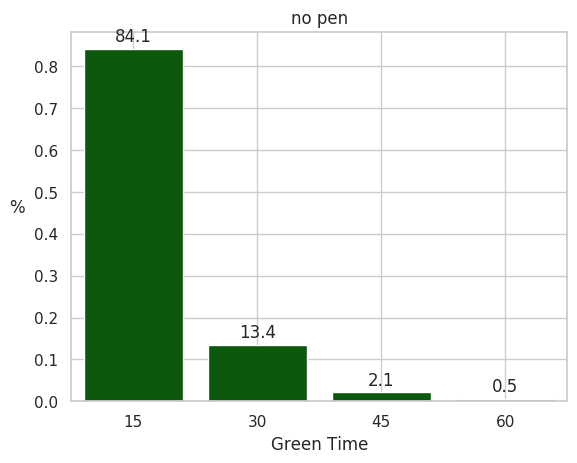

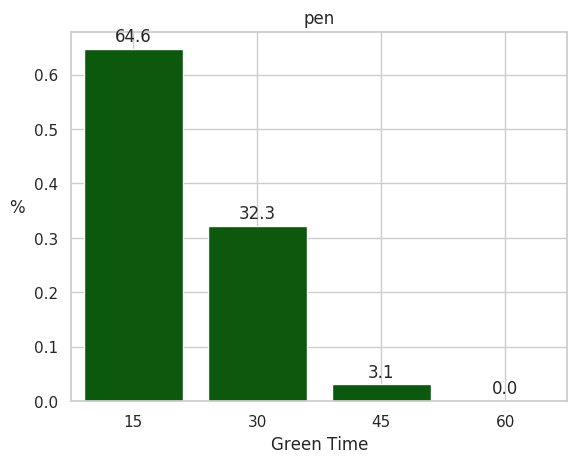

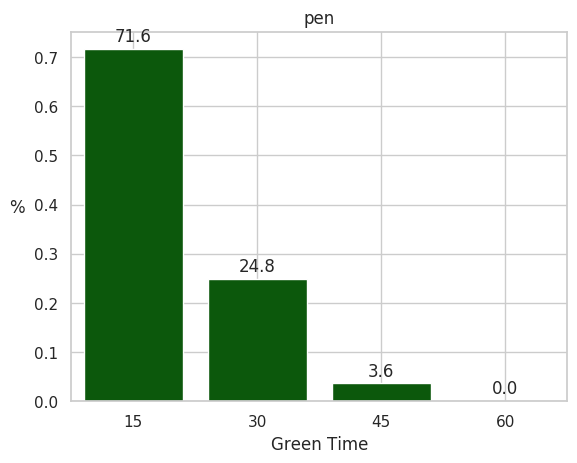

In [46]:
plotAct(ql_mid_15, 15, 'no pen')
plotAct(ql_mid_15_pen, 15, 'pen')
plotAct(ql_mid_15_fin, 15, 'pen')

In [47]:
ql_mid_15 = pd.read_csv('results/stats_ped/ql_15s_pen30')

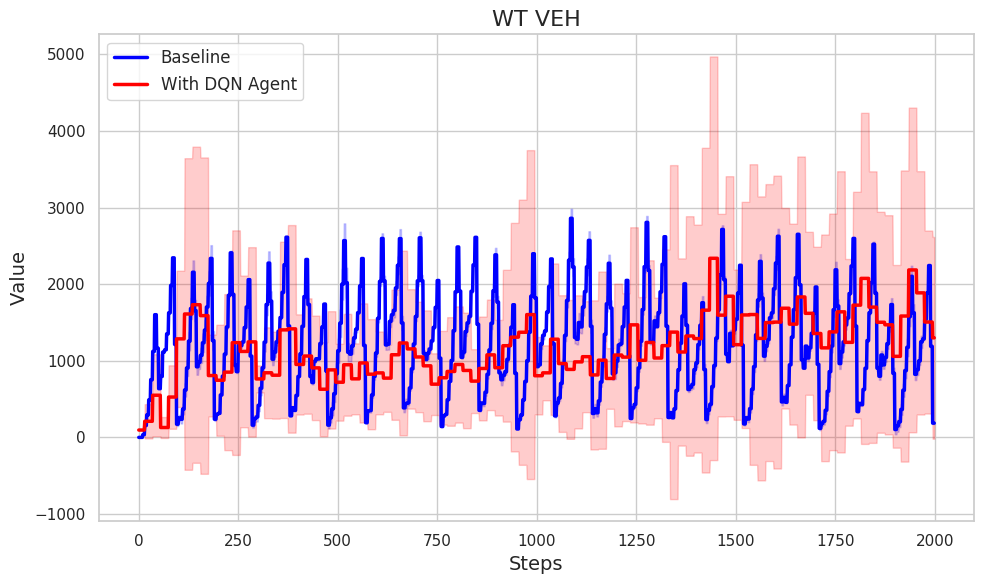

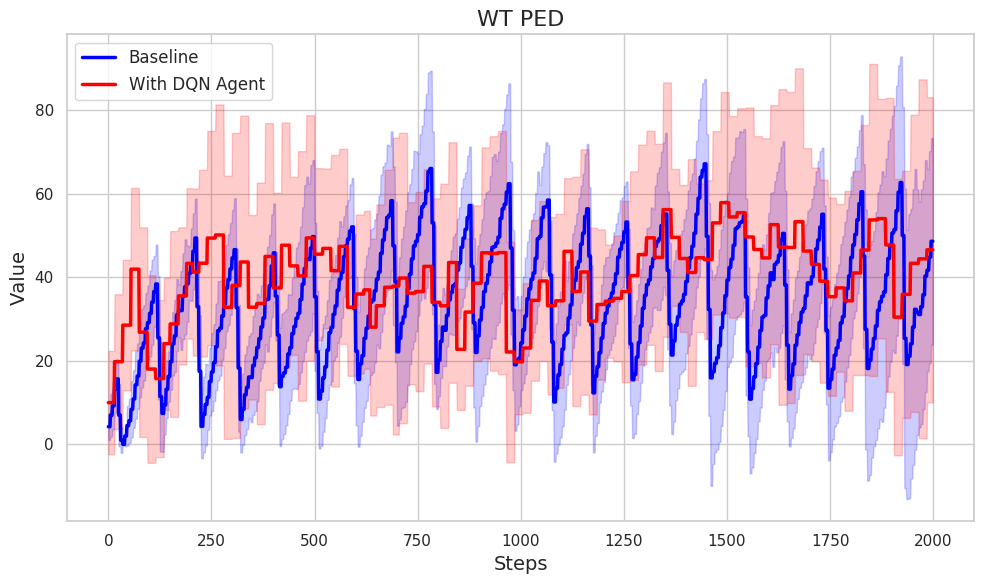

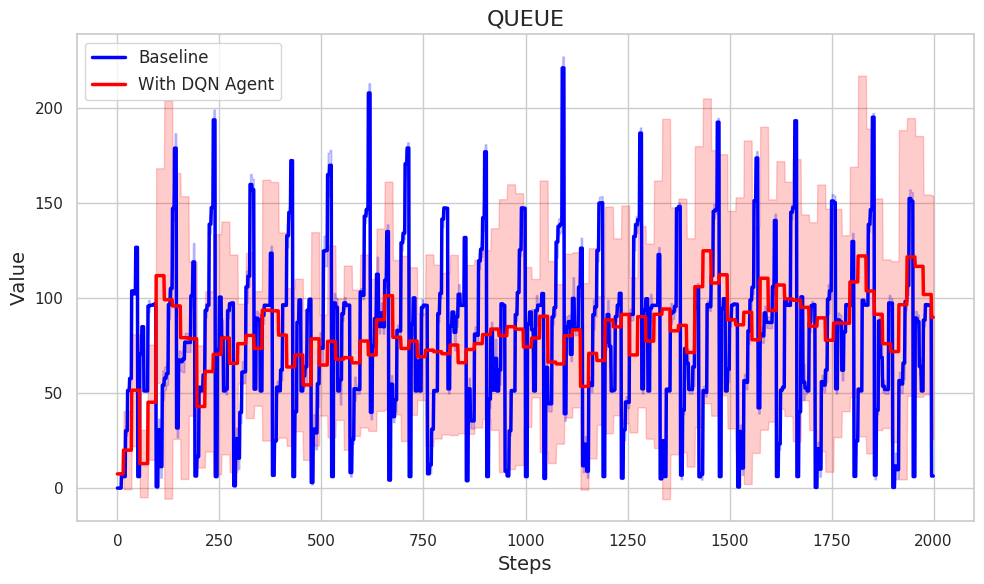

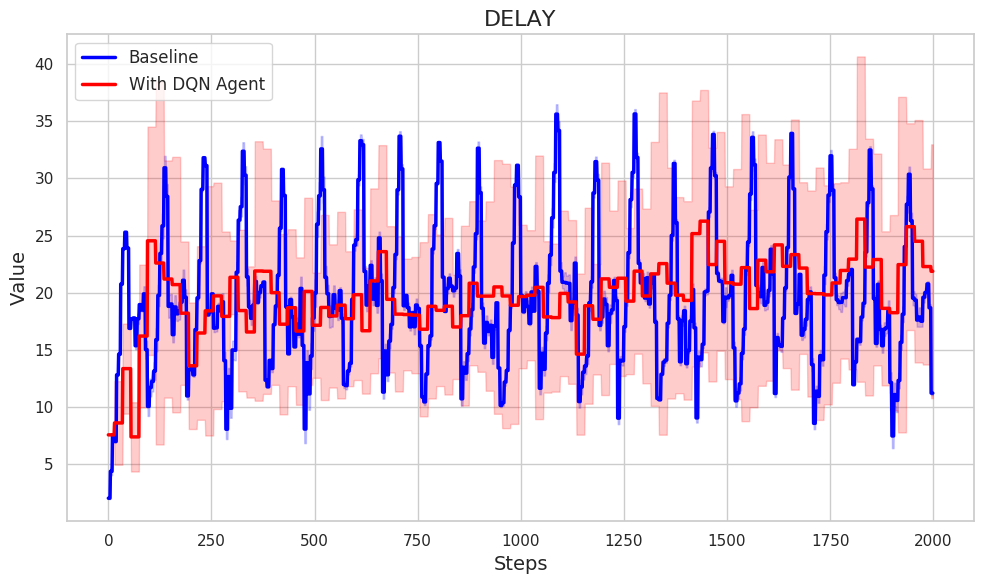

In [244]:
#ql_mid15 = pd.read_csv('results/stats_ped/ql_STD_pen20') 
ql_mid15 = pd.read_csv('results/stats_ped/ql_15s_pen30') 

ql_mid15_V, ql_mid15_Vm, ql_mid15_Vs  = getRes(10, ql_mid15, 'wt_veh')
ql_mid15_Vm_full, ql_mid15_Vs_full = enl(ql_mid15_V, ql_mid15_Vm, ql_mid15_Vs, 15)
defPlot(base_mid_Vm_full, base_mid_Vs_full, ql_mid15_Vm_full[:2000], ql_mid15_Vs_full[:2000], 'WT VEH')

ql_mid15_P, ql_mid15_Pm, ql_mid15_Ps = getRes(10, ql_mid15, 'wt_ped')
ql_mid15_Pm_full, ql_mid15_Ps_full = enl(ql_mid15_P, ql_mid15_Pm, ql_mid15_Ps, 15)
defPlot(base_mid_Pm_full, base_mid_Ps_full, ql_mid15_Pm_full[:2000], ql_mid15_Ps_full[:2000], 'WT PED')

ql_mid15_Q, ql_mid15_Qm, ql_mid15_Qs = getRes(10, ql_mid15, 'queue')
ql_mid15_Qm_full, ql_mid15_Qs_full = enl(ql_mid15_Q, ql_mid15_Qm, ql_mid15_Qs, 15)
defPlot(base_mid_Qm_full, base_mid_Qs_full, ql_mid15_Qm_full[:2000], ql_mid15_Qs_full[:2000], 'QUEUE')

ql_mid15_D, ql_mid15_Dm, ql_mid15_Ds = getRes(10, ql_mid15, 'delay')
ql_mid15_Dm_full, ql_mid15_Ds_full = enl(ql_mid15_D, ql_mid15_Dm, ql_mid15_Ds, 15)
defPlot(base_mid_Dm_full, base_mid_Ds_full, ql_mid15_Dm_full[:2000], ql_mid15_Ds_full[:2000], 'DELAY')

##### reduced time

In [245]:
ql_mid_5 = pd.read_csv('results/stats_ped/mix_mid_ql_5sec_5') #ql_lowveh_10g_ped35 mix_mid_ql_5sec_5
#ql_mid_5 = pd.read_csv('results/stats_ped/mix_mid_ql_5sec_pen400') #op
ql_mid_5_pen2 = pd.read_csv('results/stats_ped/mix_mid_ql_5sec_pen') # wt veh molto basso, ci sta. pen 400? beta .03?
ql_mid_5_pen3 = pd.read_csv('results/stats_ped/mix_mid_ql_5sec_pen2') #penalità 400 beta .05 DURATA GREEN MOLTO ALTA 
ql_mid_5_pen = pd.read_csv('results/stats_ped/mix_mid_ql_5sec_pen3') #penalità 200 beta .05 
ql_mid_5_penfin = pd.read_csv('results/stats_ped/ql_5s_pen250') 

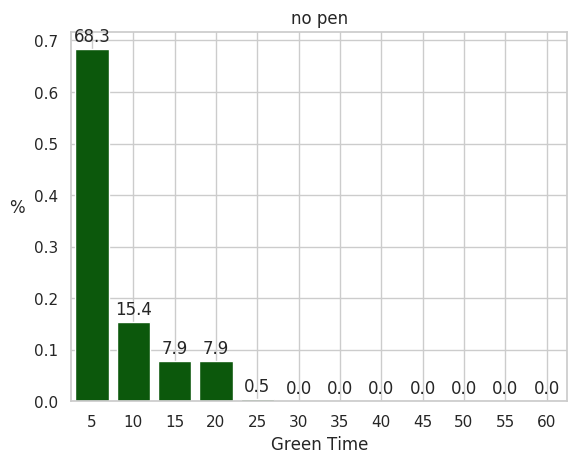

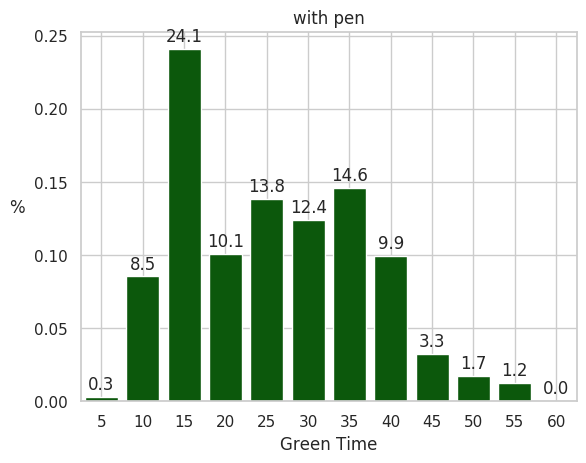

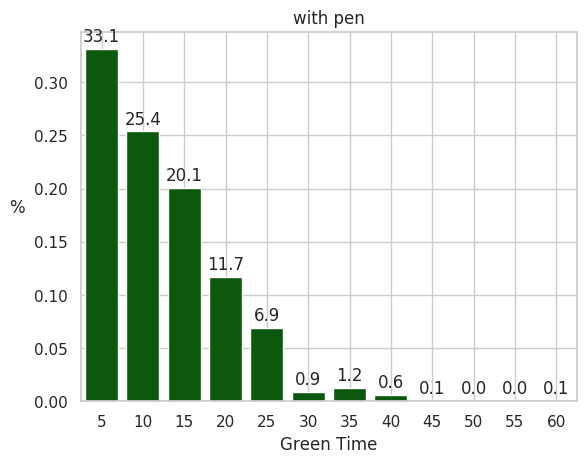

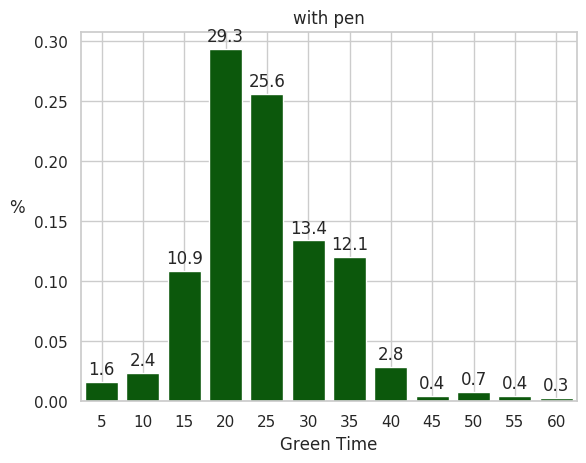

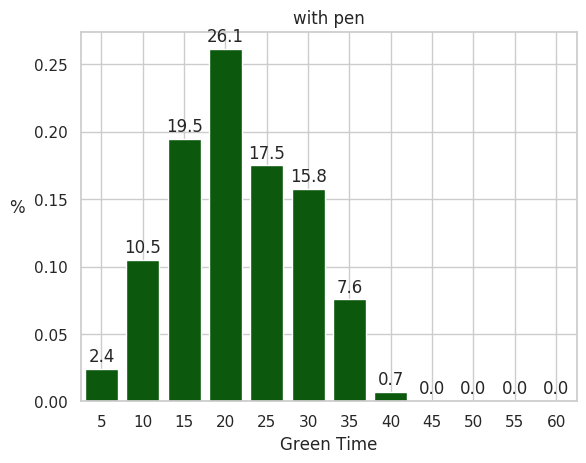

In [50]:
plotAct(ql_mid_5, 5, 'no pen')
plotAct(ql_mid_5_pen, 5, 'with pen')
plotAct(ql_mid_5_pen2, 5, 'with pen')
plotAct(ql_mid_5_pen3, 5, 'with pen')
plotAct(ql_mid_5_penfin, 5, 'with pen')

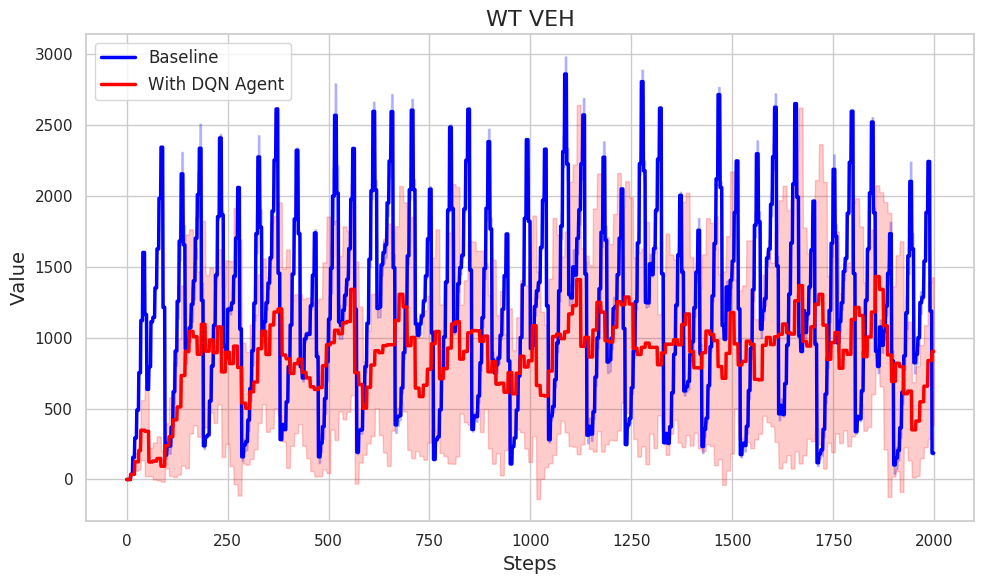

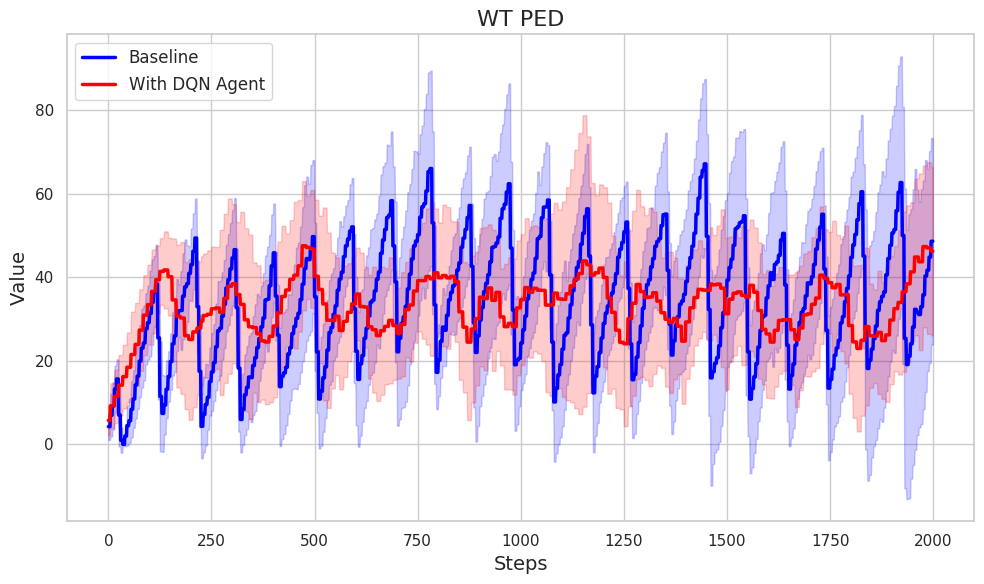

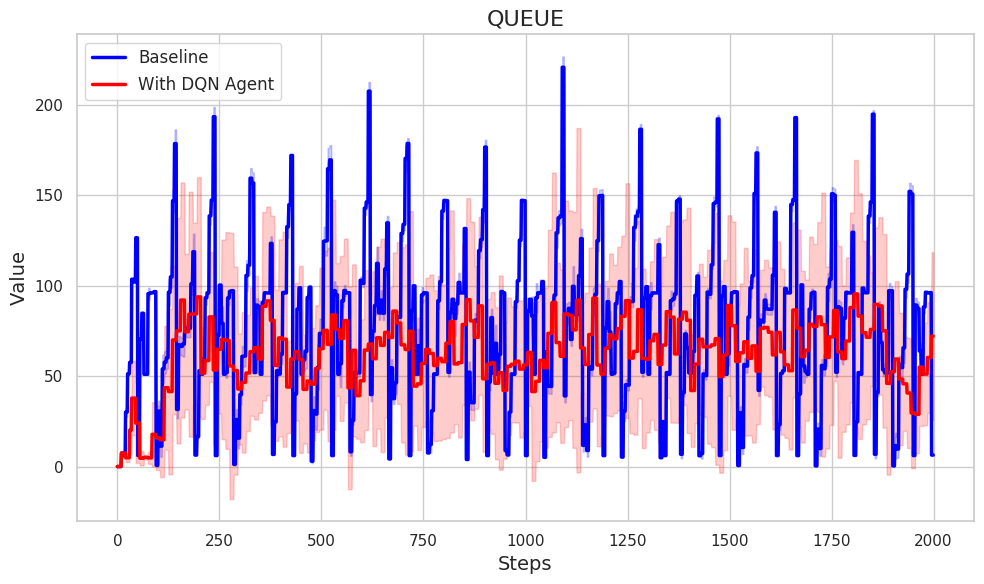

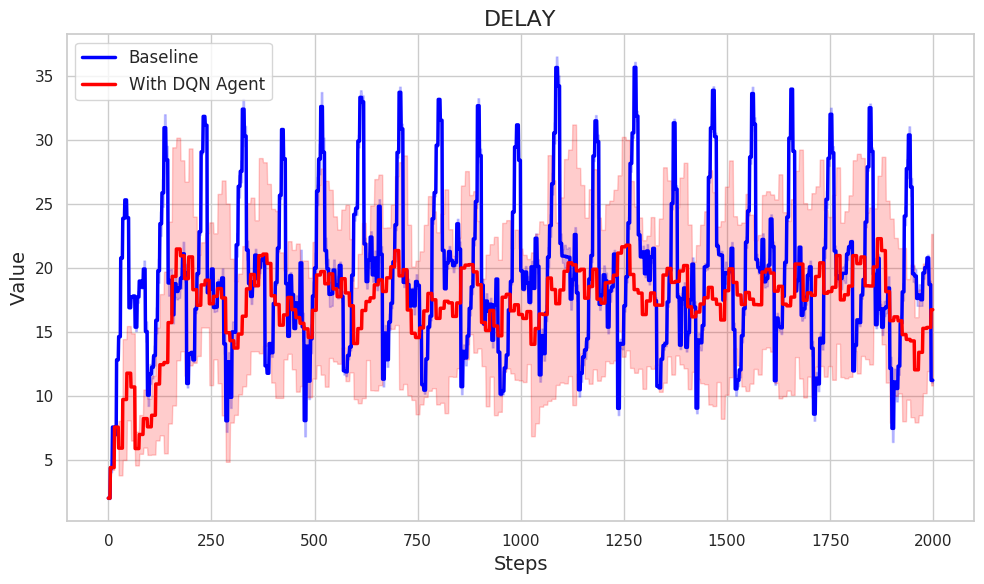

In [246]:
ql_mid5 = pd.read_csv('results/stats_ped/ql_5s_pen250') 

ql_mid5_V, ql_mid5_Vm, ql_mid5_Vs  = getRes(10, ql_mid5, 'wt_veh')
ql_mid5_Vm_full, ql_mid5_Vs_full = enl(ql_mid5_V, ql_mid5_Vm, ql_mid5_Vs, 5)
defPlot(base_mid_Vm_full, base_mid_Vs_full, ql_mid5_Vm_full[:2000], ql_mid5_Vs_full[:2000], 'WT VEH')

ql_mid5_P, ql_mid5_Pm, ql_mid5_Ps = getRes(10, ql_mid5, 'wt_ped')
ql_mid5_Pm_full, ql_mid5_Ps_full = enl(ql_mid5_P, ql_mid5_Pm, ql_mid5_Ps, 5)
defPlot(base_mid_Pm_full, base_mid_Ps_full, ql_mid5_Pm_full[:2000], ql_mid5_Ps_full[:2000], 'WT PED')

ql_mid5_Q, ql_mid5_Qm, ql_mid5_Qs = getRes(10, ql_mid5, 'queue')
ql_mid5_Qm_full, ql_mid5_Qs_full = enl(ql_mid5_Q, ql_mid5_Qm, ql_mid5_Qs, 5)
defPlot(base_mid_Qm_full, base_mid_Qs_full, ql_mid5_Qm_full[:2000], ql_mid5_Qs_full[:2000], 'QUEUE')

ql_mid5_D, ql_mid5_Dm, ql_mid5_Ds = getRes(10, ql_mid5, 'delay')
ql_mid5_Dm_full, ql_mid5_Ds_full = enl(ql_mid5_D, ql_mid5_Dm, ql_mid5_Ds, 5)
defPlot(base_mid_Dm_full, base_mid_Ds_full, ql_mid5_Dm_full[:2000], ql_mid5_Ds_full[:2000], 'DELAY')

##### Comparison

NameError: name 'ql_beta5_Vm_full' is not defined

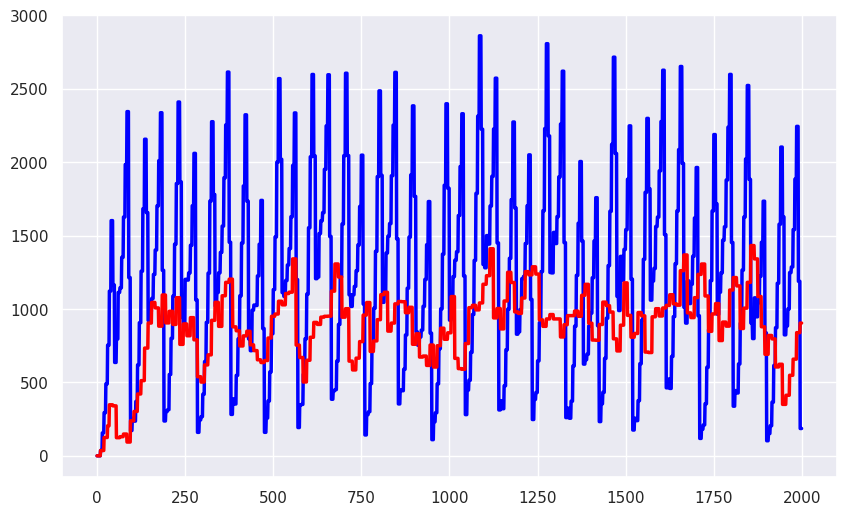

In [247]:
plt.figure(figsize=(10, 6))
sns.set(style="darkgrid")

# Plot the average
plt.plot(base_mid_Vm_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(ql_mid5_Vm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(ql_beta5_Vm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(ql_mid15_Vm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Vm_full)), np.array(base_mid_Vm_full) - np.array(base_mid_Vs_full),
                np.array(base_mid_Vm_full) + np.array(base_mid_Vs_full),
                color='blue', alpha=0.2)

plt.fill_between(range(len(ql_mid5_Vm_full[:2000])), np.array(ql_mid5_Vm_full[:2000]) - np.array(ql_mid5_Vs_full[:2000]),
                np.array(ql_mid5_Vm_full[:2000]) + np.array(ql_mid5_Vs_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(ql_beta5_Vm_full[:2000])), np.array(ql_beta5_Vm_full[:2000]) - np.array(ql_beta5_Vs_full[:2000]),
                np.array(ql_beta5_Vm_full[:2000]) + np.array(ql_beta5_Vs_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(ql_mid15_Vm_full[:2000])), np.array(ql_mid15_Vm_full[:2000]) - np.array(ql_mid15_Vs_full[:2000]),
                np.array(ql_mid15_Vm_full[:2000]) + np.array(ql_mid15_Vs_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - WT VEH', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

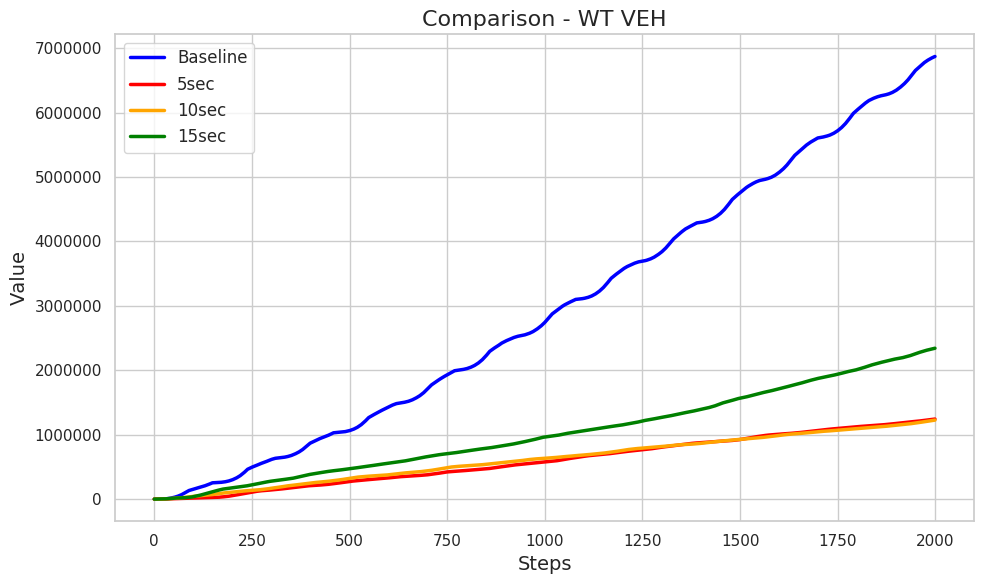

In [130]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

# Plot the average
plt.plot(np.cumsum(base_mid_Vm_full), color='blue', linewidth=2.5, label='Baseline')
plt.plot(np.cumsum(ql_mid5_Vm_full[:2000]), color='red', linewidth=2.5, label='5sec')
plt.plot(np.cumsum(ql_beta5_Vm_full[:2000]), color='orange', linewidth=2.5, label='10sec')
plt.plot(np.cumsum(ql_mid15_Vm_full[:2000]), color='green', linewidth=2.5, label='15sec')


# Customize the plot
plt.title('Comparison - WT VEH', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

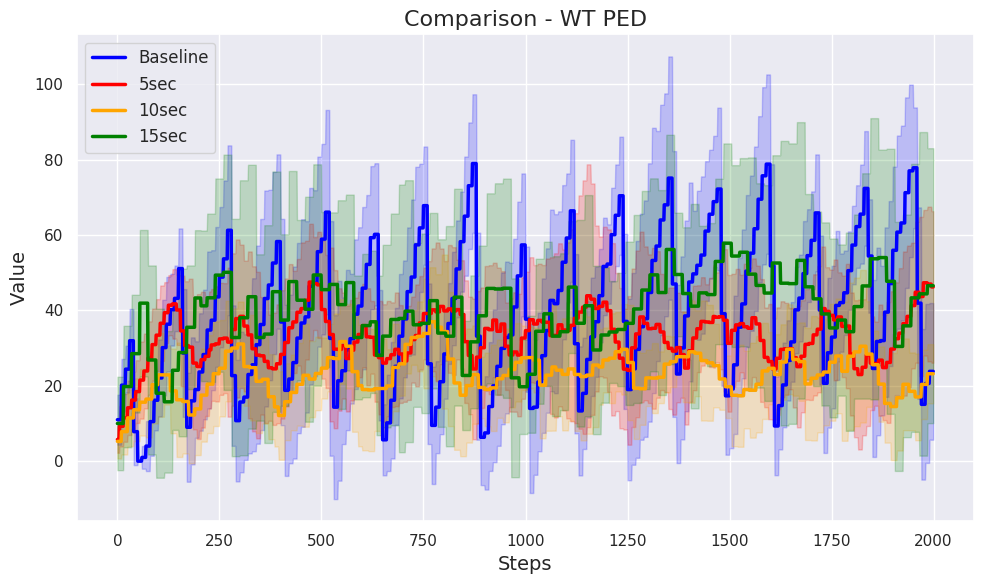

In [136]:
plt.figure(figsize=(10, 6))
sns.set(style="darkgrid")

# Plot the average
plt.plot(base_mid_Pm_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(ql_mid5_Pm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(ql_beta5_Pm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(ql_mid15_Pm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Pm2_full)), np.array(base_mid_Pm2_full) - np.array(base_mid_Ps2_full),
                np.array(base_mid_Pm2_full) + np.array(base_mid_Ps2_full),
                color='blue', alpha=0.2)

plt.fill_between(range(len(ql_mid5_Pm_full[:2000])), np.array(ql_mid5_Pm_full[:2000]) - np.array(ql_mid5_Ps_full[:2000]),
                np.array(ql_mid5_Pm_full[:2000]) + np.array(ql_mid5_Ps_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(ql_beta5_Pm_full[:2000])), np.array(ql_beta5_Pm_full[:2000]) - np.array(ql_beta5_Ps_full[:2000]),
                np.array(ql_beta5_Pm_full[:2000]) + np.array(ql_beta5_Ps_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(ql_mid15_Pm_full[:2000])), np.array(ql_mid15_Pm_full[:2000]) - np.array(ql_mid15_Ps_full[:2000]),
                np.array(ql_mid15_Pm_full[:2000]) + np.array(ql_mid15_Ps_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - WT PED', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

In [118]:
print(np.mean(ql_mid15_Pm_full))
print(np.mean(ql_mid5_Pm_full))
print(np.mean(ql_beta5_Pm_full))
print(np.mean(base_mid_Pm2_full))

39.73261465834156
34.05895875895235
35.71247983303247
39.08869227994227


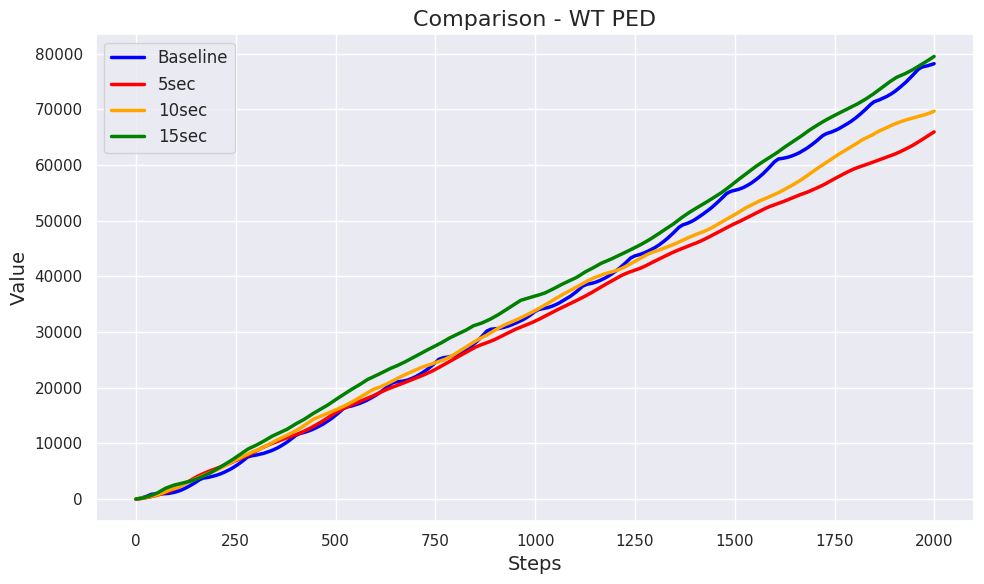

In [128]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

# Plot the average
plt.plot(np.cumsum(base_mid_Pm2_full), color='blue', linewidth=2.5, label='Baseline')
plt.plot(np.cumsum(ql_mid5_Pm_full[:2000]), color='red', linewidth=2.5, label='5sec')
plt.plot(np.cumsum(ql_beta5_Pm_full[:2000]), color='orange', linewidth=2.5, label='10sec')
plt.plot(np.cumsum(ql_mid15_Pm_full[:2000]), color='green', linewidth=2.5, label='15sec')

# Customize the plot
plt.title('Comparison - WT PED', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

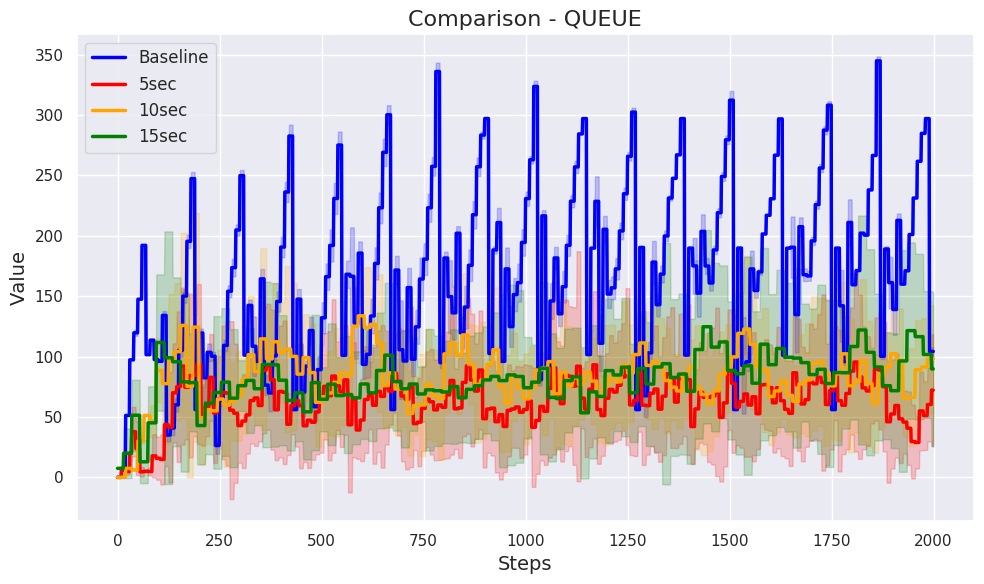

In [137]:
plt.figure(figsize=(10, 6))


# Plot the average
plt.plot(base_mid_Qm2_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(ql_mid5_Qm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(ql_beta5_Qm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(ql_mid15_Qm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Qm2_full)), np.array(base_mid_Qm2_full) - np.array(base_mid_Qs2_full),
                np.array(base_mid_Qm2_full) + np.array(base_mid_Qs2_full),
                color='blue', alpha=0.2)

plt.fill_between(range(len(ql_mid5_Qm_full[:2000])), np.array(ql_mid5_Qm_full[:2000]) - np.array(ql_mid5_Qs_full[:2000]),
                np.array(ql_mid5_Qm_full[:2000]) + np.array(ql_mid5_Qs_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(ql_beta5_Qm_full[:2000])), np.array(ql_beta5_Qm_full[:2000]) - np.array(ql_beta5_Qs_full[:2000]),
                np.array(ql_beta5_Qm_full[:2000]) + np.array(ql_beta5_Qs_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(ql_mid15_Qm_full[:2000])), np.array(ql_mid15_Qm_full[:2000]) - np.array(ql_mid15_Qs_full[:2000]),
                np.array(ql_mid15_Qm_full[:2000]) + np.array(ql_mid15_Qs_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - QUEUE', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

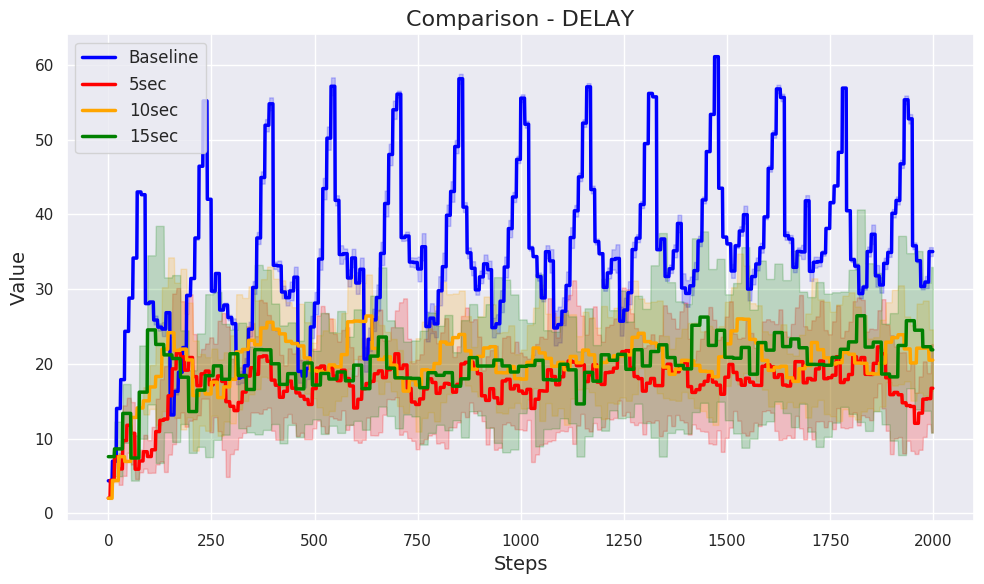

In [138]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

# Plot the average
plt.plot(base_mid_Dm_full, color='blue', linewidth=2.5, label='Baseline')
plt.plot(ql_mid5_Dm_full[:2000], color='red', linewidth=2.5, label='5sec')
plt.plot(ql_beta5_Dm_full[:2000], color='orange', linewidth=2.5, label='10sec')
plt.plot(ql_mid15_Dm_full[:2000], color='green', linewidth=2.5, label='15sec')

# Plot the standard deviation as a shaded area
plt.fill_between(range(len(base_mid_Dm_full)), np.array(base_mid_Dm_full) - np.array(base_mid_Ds_full),
                np.array(base_mid_Dm_full) + np.array(base_mid_Ds_full),
                color='blue', alpha=0.2)

plt.fill_between(range(len(ql_mid5_Dm_full[:2000])), np.array(ql_mid5_Dm_full[:2000]) - np.array(ql_mid5_Ds_full[:2000]),
                np.array(ql_mid5_Dm_full[:2000]) + np.array(ql_mid5_Ds_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(ql_beta5_Dm_full[:2000])), np.array(ql_beta5_Dm_full[:2000]) - np.array(ql_beta5_Ds_full[:2000]),
                np.array(ql_beta5_Dm_full[:2000]) + np.array(ql_beta5_Ds_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(ql_mid15_Dm_full[:2000])), np.array(ql_mid15_Dm_full[:2000]) - np.array(ql_mid15_Ds_full[:2000]),
                np.array(ql_mid15_Dm_full[:2000]) + np.array(ql_mid15_Ds_full[:2000]),
                color='green', alpha=0.2)


# Customize the plot
plt.title('Comparison - DELAY', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()

# Show the plot
plt.show()

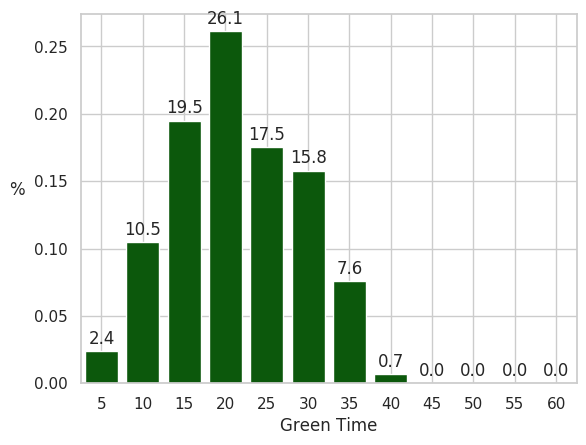

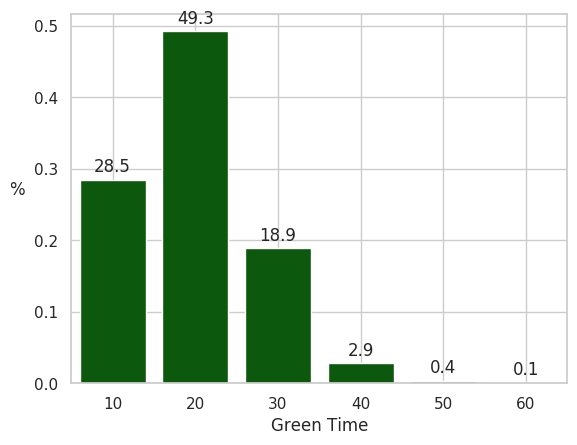

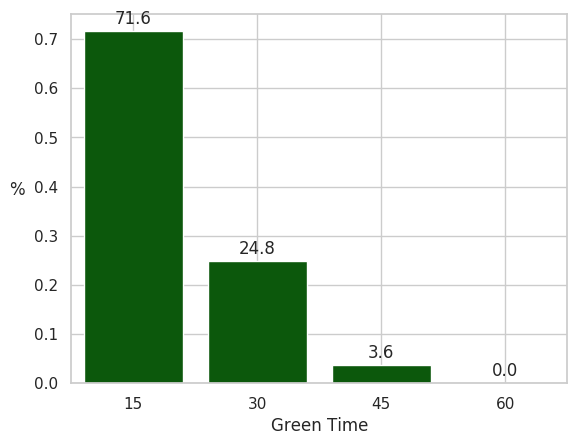

In [131]:
plotAct(ql_mid5, 5, '')
plotAct(ql_beta5, 10, '')
plotAct(ql_mid15, 15, '')

#### WEIGHTS VARIATION

##### beta = 0.5

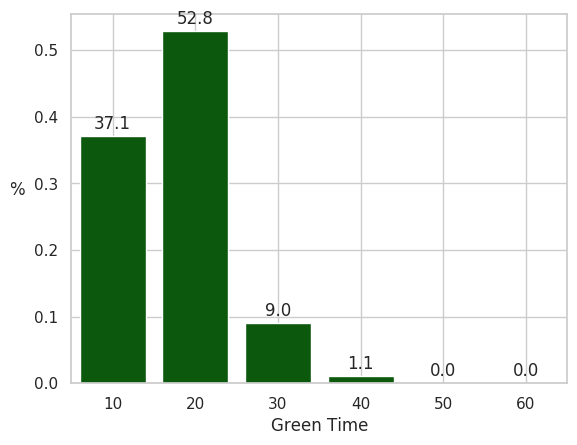

In [20]:
plotAct(ql_beta5, 0, 10, '')

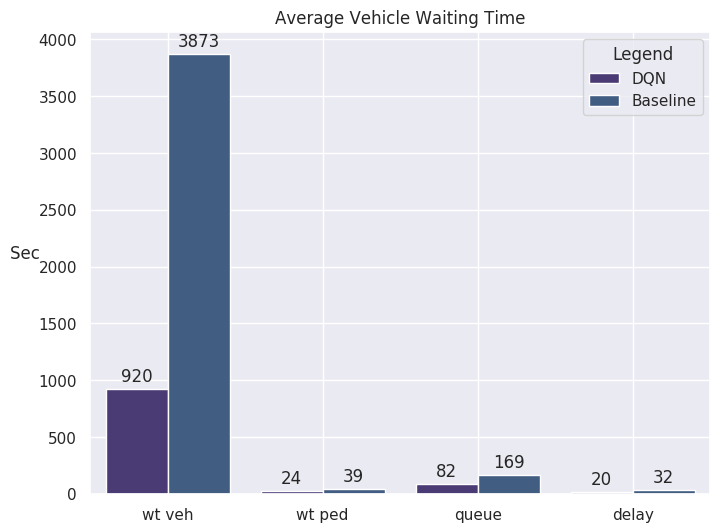

In [151]:
instaRes_all(ql_beta5_Vm, ql_beta5_Pm, ql_beta5_Qm, ql_beta5_Dm)

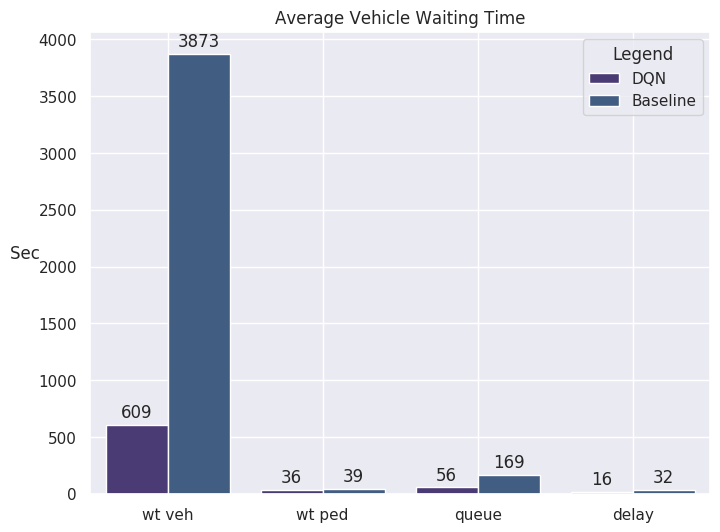

In [153]:
instaRes_all(ql_beta5_Vm, ql_beta5_Pm, ql_beta5_Qm, ql_beta5_Dm)

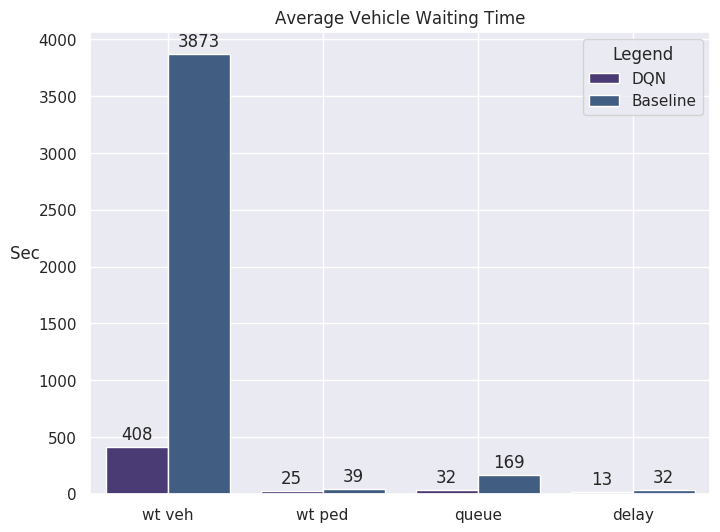

In [156]:
instaRes_all(ql_beta5_Vm, ql_beta5_Pm, ql_beta5_Qm, ql_beta5_Dm)

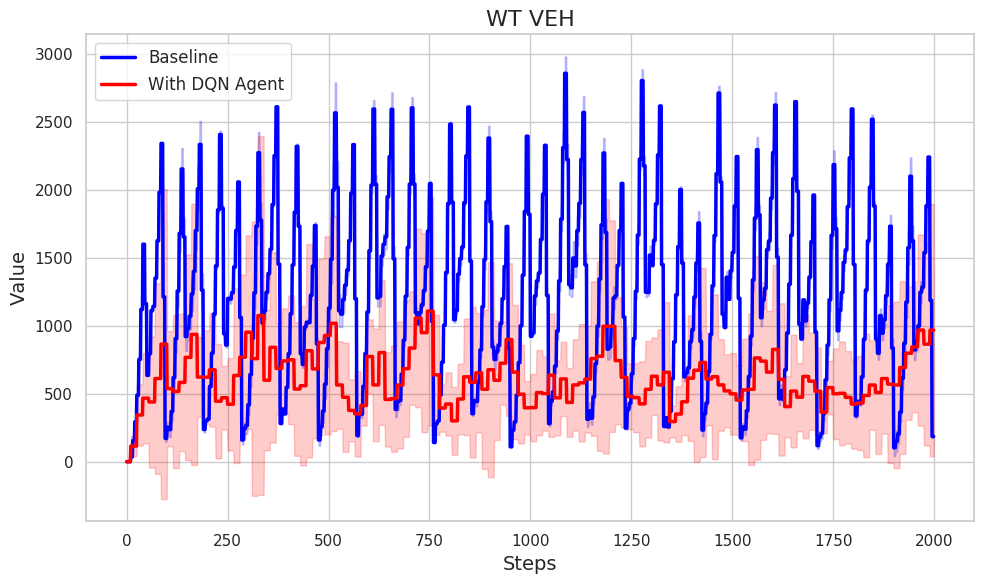

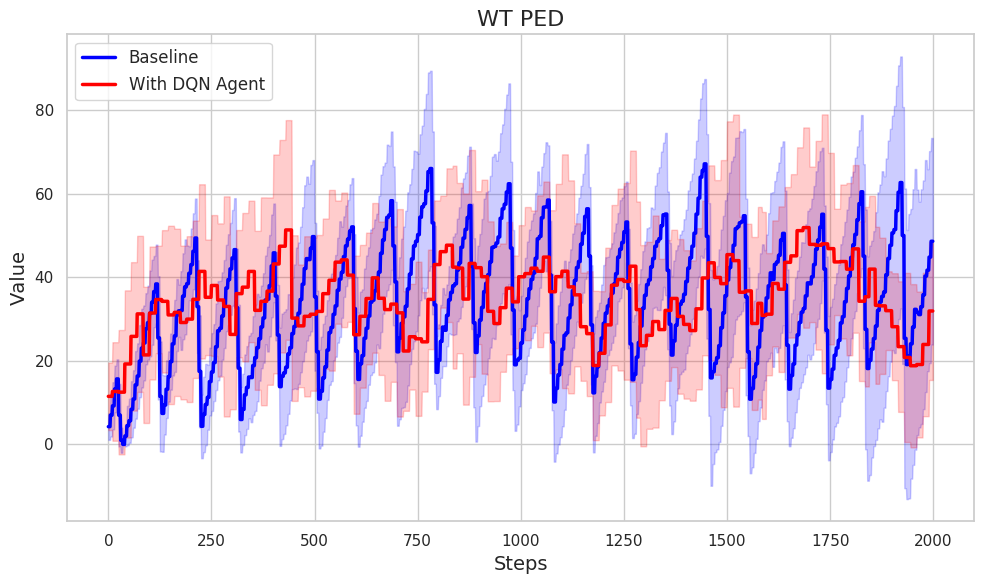

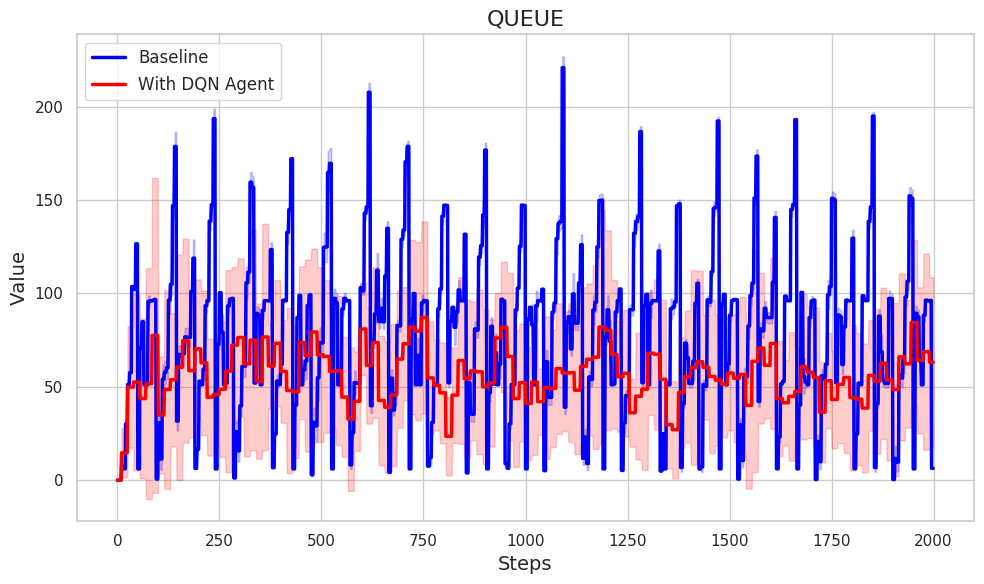

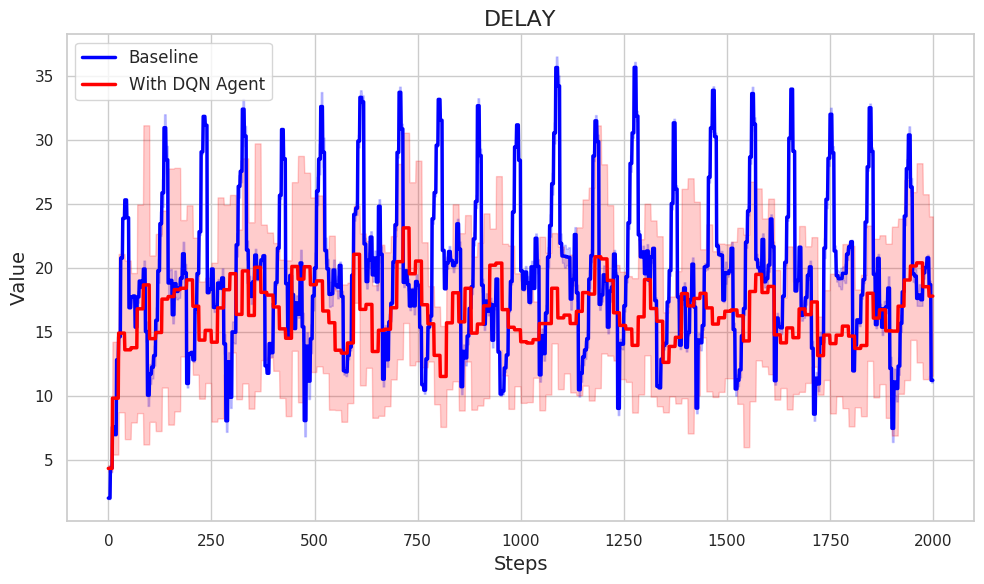

In [248]:
#ql_beta5 = pd.read_csv('results/stats_ped/ql_STD_pen20') 
ql_beta5 = pd.read_csv('results/stats_ped/ql_STD_pen60')  #ql_STD_pen60 mix_mid_ql_5sec_pen3 ql_mid_pen180

ql_beta5_V, ql_beta5_Vm, ql_beta5_Vs  = getRes(10, ql_beta5, 'wt_veh')
ql_beta5_Vm_full, ql_beta5_Vs_full = enl(ql_beta5_V, ql_beta5_Vm, ql_beta5_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, ql_beta5_Vm_full[:2000], ql_beta5_Vs_full[:2000], 'WT VEH')

ql_beta5_P, ql_beta5_Pm, ql_beta5_Ps = getRes(10, ql_beta5, 'wt_ped')
ql_beta5_Pm_full, ql_beta5_Ps_full = enl(ql_beta5_P, ql_beta5_Pm, ql_beta5_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, ql_beta5_Pm_full[:2000], ql_beta5_Ps_full[:2000], 'WT PED')

ql_beta5_Q, ql_beta5_Qm, ql_beta5_Qs = getRes(10, ql_beta5, 'queue')
ql_beta5_Qm_full, ql_beta5_Qs_full = enl(ql_beta5_Q, ql_beta5_Qm, ql_beta5_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, ql_beta5_Qm_full[:2000], ql_beta5_Qs_full[:2000], 'QUEUE')

ql_beta5_D, ql_beta5_Dm, ql_beta5_Ds = getRes(10, ql_beta5, 'delay')
ql_beta5_Dm_full, ql_beta5_Ds_full = enl(ql_beta5_D, ql_beta5_Dm, ql_beta5_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, ql_beta5_Dm_full[:2000], ql_beta5_Ds_full[:2000], 'DELAY')

##### beta = 0.6

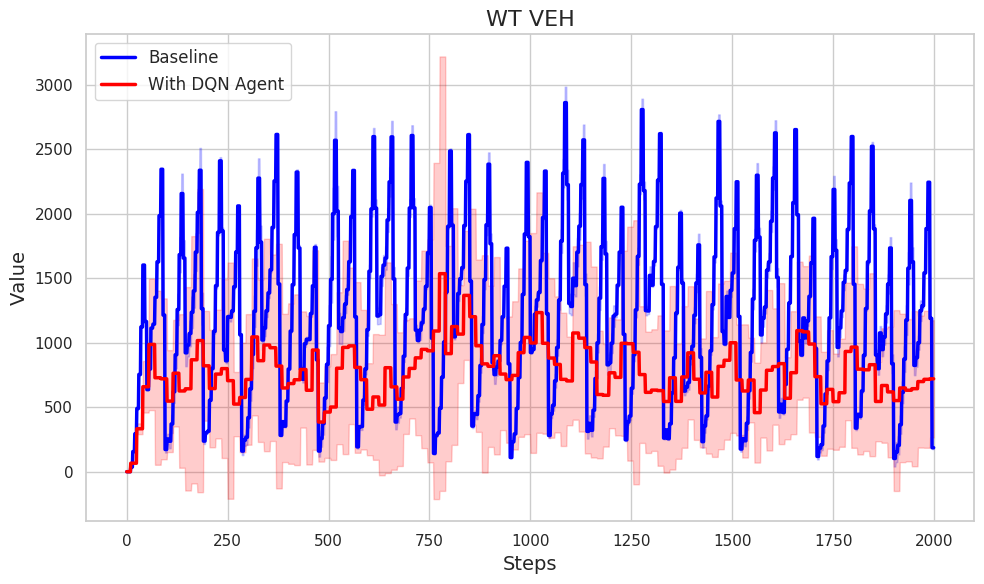

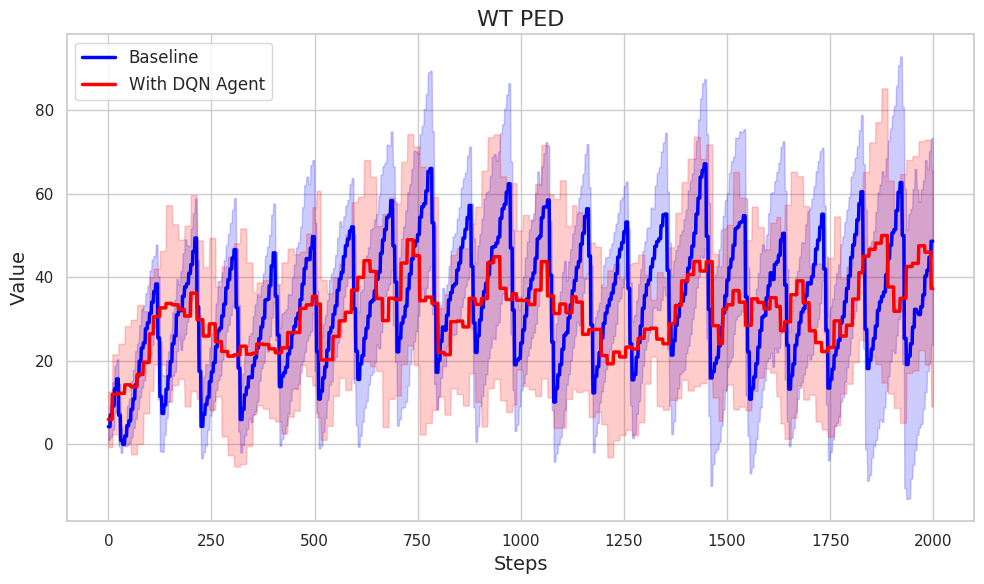

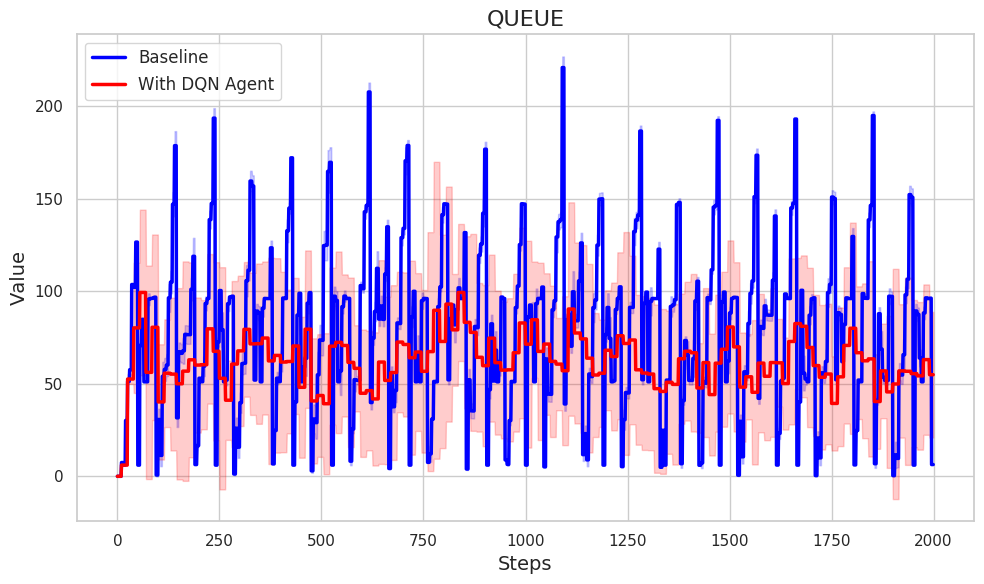

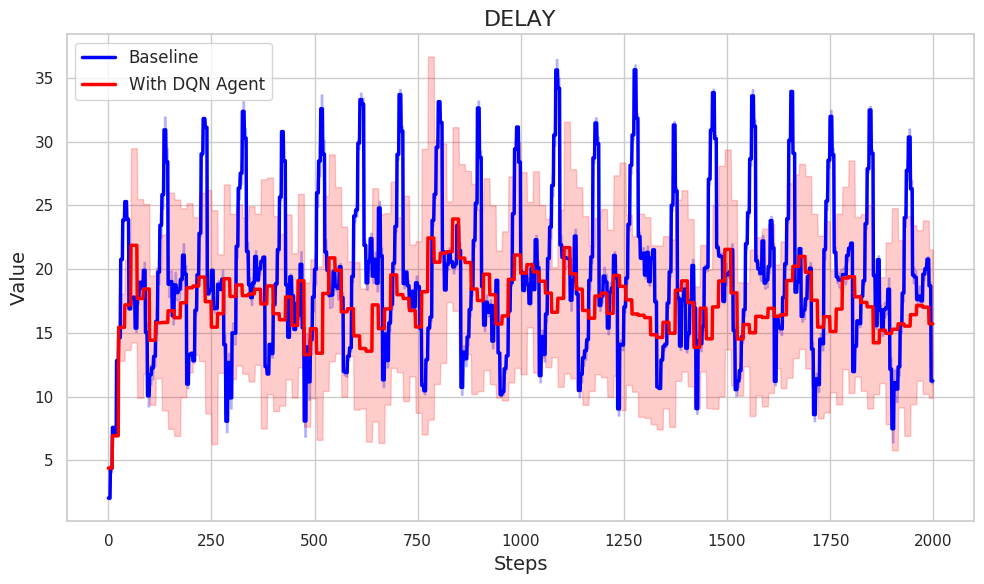

In [249]:
#ql_beta6 = pd.read_csv('results/stats_ped/ql_beta6_pen20') 
ql_beta6 = pd.read_csv('results/stats_ped/ql_beta6') 

ql_beta6_V, ql_beta6_Vm, ql_beta6_Vs  = getRes(10, ql_beta6, 'wt_veh')
ql_beta6_Vm_full, ql_beta6_Vs_full = enl(ql_beta6_V, ql_beta6_Vm, ql_beta6_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, ql_beta6_Vm_full[:2000], ql_beta6_Vs_full[:2000], 'WT VEH')

ql_beta6_P, ql_beta6_Pm, ql_beta6_Ps = getRes(10, ql_beta6, 'wt_ped')
ql_beta6_Pm_full, ql_beta6_Ps_full = enl(ql_beta6_P, ql_beta6_Pm, ql_beta6_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, ql_beta6_Pm_full[:2000], ql_beta6_Ps_full[:2000], 'WT PED')

ql_beta6_Q, ql_beta6_Qm, ql_beta6_Qs = getRes(10, ql_beta6, 'queue')
ql_beta6_Qm_full, ql_beta6_Qs_full = enl(ql_beta6_Q, ql_beta6_Qm, ql_beta6_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, ql_beta6_Qm_full[:2000], ql_beta6_Qs_full[:2000], 'QUEUE')

ql_beta6_D, ql_beta6_Dm, ql_beta6_Ds = getRes(10, ql_beta6, 'delay')
ql_beta6_Dm_full, ql_beta6_Ds_full = enl(ql_beta6_D, ql_beta6_Dm, ql_beta6_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, ql_beta6_Dm_full[:2000], ql_beta6_Ds_full[:2000], 'DELAY')

##### beta = 0.4

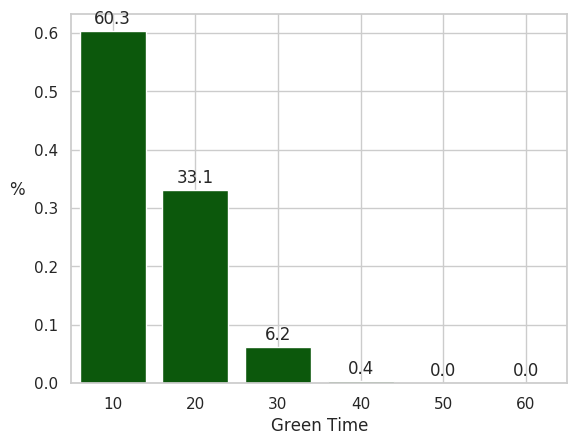

In [120]:
plotAct(ql_beta4, 10, '')

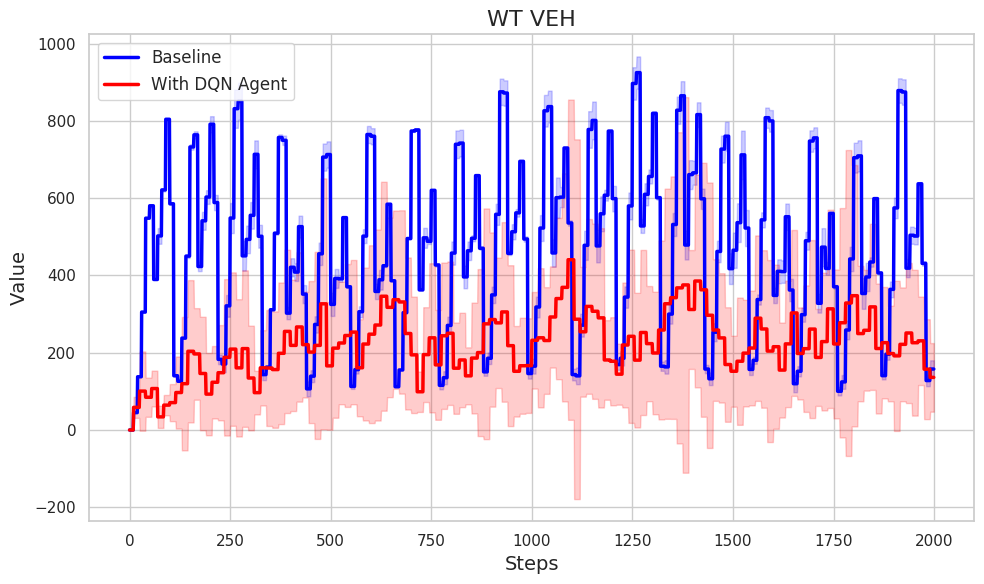

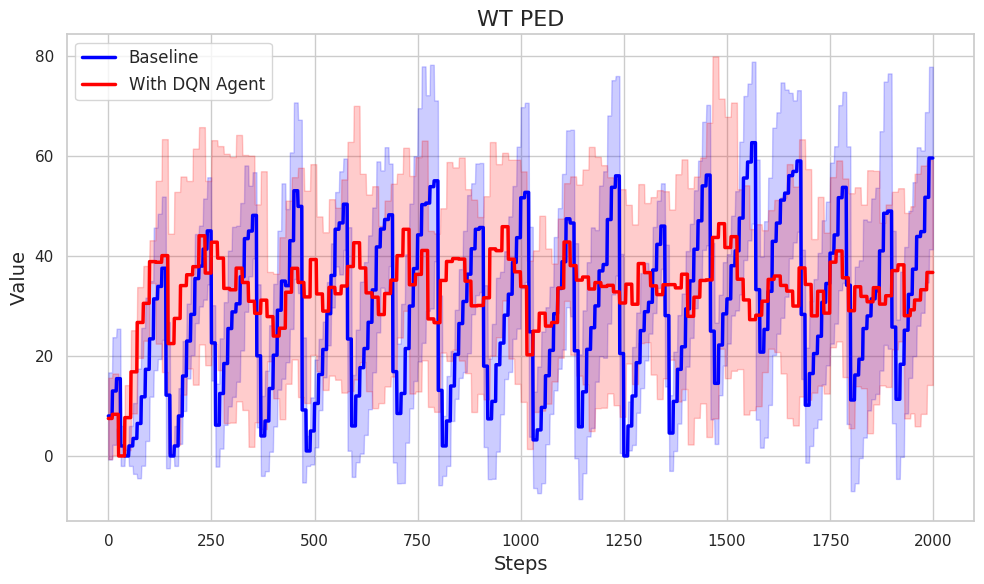

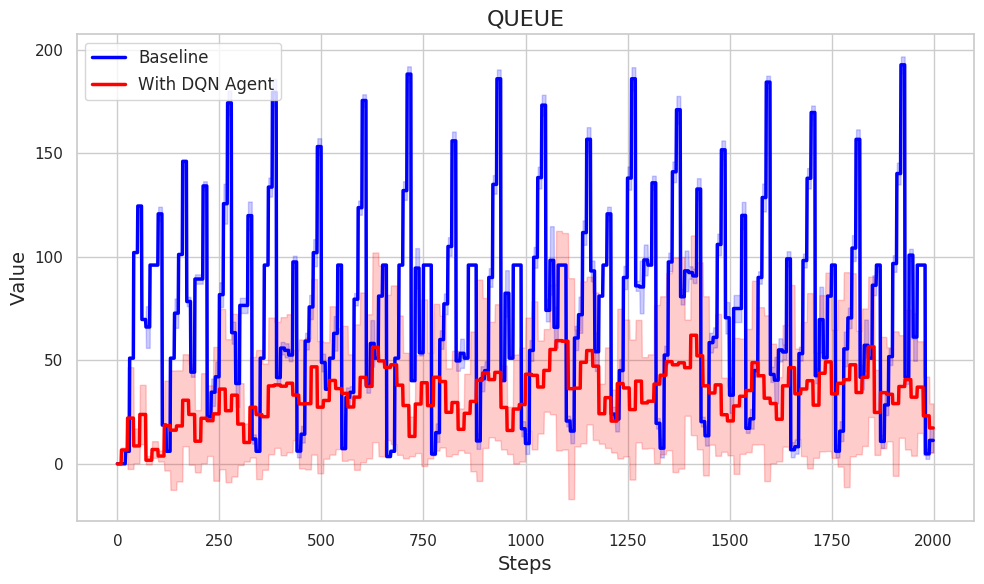

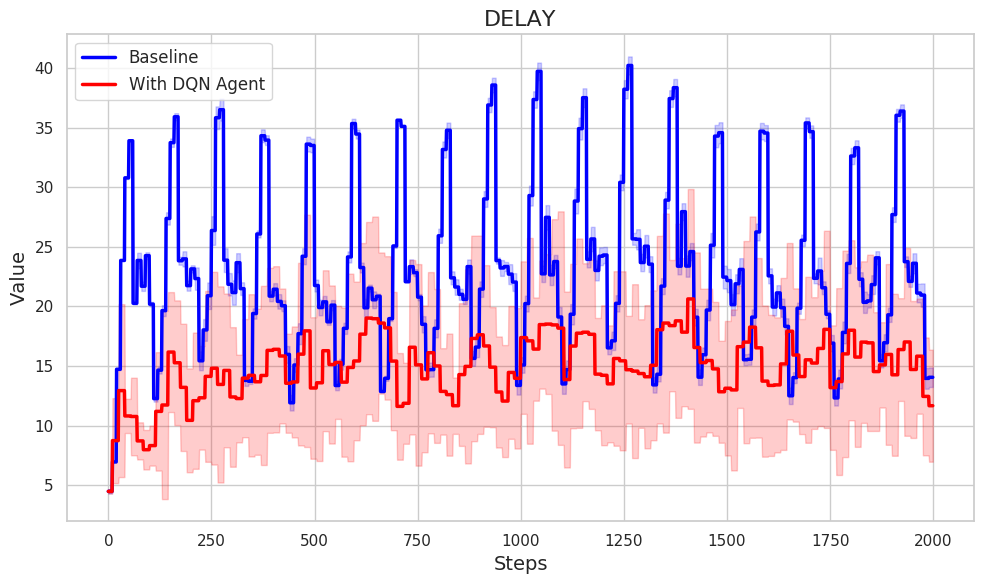

In [119]:
#ql_beta4 = pd.read_csv('results/stats_ped/ql_beta4_pen20') 
ql_beta4 = pd.read_csv('results/stats_ped/ql_mid_beta5ma2') #ql_beta4_pen60

ql_beta4_V, ql_beta4_Vm, ql_beta4_Vs  = getRes(10, ql_beta4, 'wt_veh')
ql_beta4_Vm_full, ql_beta4_Vs_full = enl(ql_beta4_V, ql_beta4_Vm, ql_beta4_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, ql_beta4_Vm_full[:2000], ql_beta4_Vs_full[:2000], 'WT VEH')

ql_beta4_P, ql_beta4_Pm, ql_beta4_Ps = getRes(10, ql_beta4, 'wt_ped')
ql_beta4_Pm_full, ql_beta4_Ps_full = enl(ql_beta4_P, ql_beta4_Pm, ql_beta4_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, ql_beta4_Pm_full[:2000], ql_beta4_Ps_full[:2000], 'WT PED')

ql_beta4_Q, ql_beta4_Qm, ql_beta4_Qs = getRes(10, ql_beta4, 'queue')
ql_beta4_Qm_full, ql_beta4_Qs_full = enl(ql_beta4_Q, ql_beta4_Qm, ql_beta4_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, ql_beta4_Qm_full[:2000], ql_beta4_Qs_full[:2000], 'QUEUE')

ql_beta4_D, ql_beta4_Dm, ql_beta4_Ds = getRes(10, ql_beta4, 'delay')
ql_beta4_Dm_full, ql_beta4_Ds_full = enl(ql_beta4_D, ql_beta4_Dm, ql_beta4_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, ql_beta4_Dm_full[:2000], ql_beta4_Ds_full[:2000], 'DELAY')

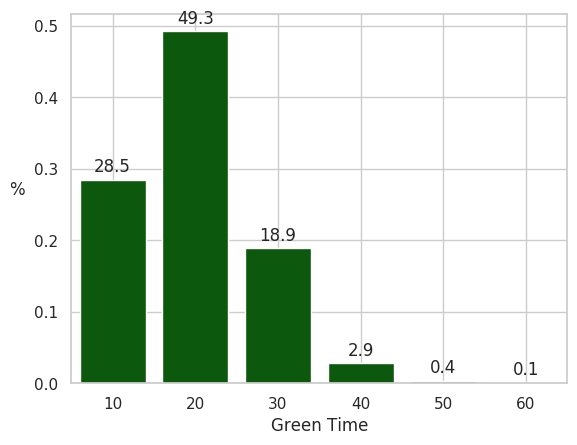

In [170]:
plotAct(ql_beta5, 10, '')

##### Comparison

In [77]:
np.mean(ql_beta4_Vm)

495.9529825093519

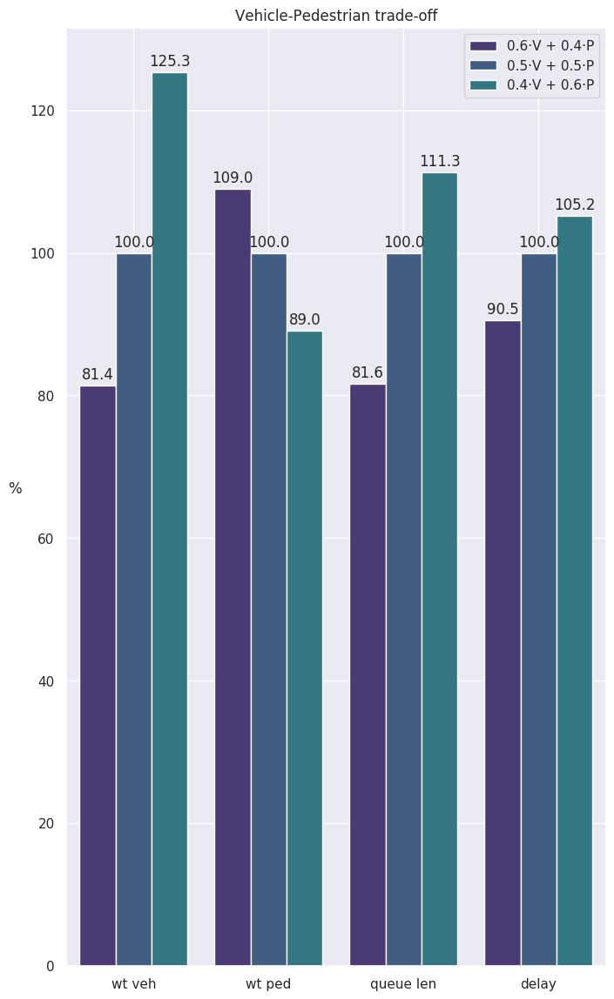

In [251]:
qlb4 = {'wt veh':np.mean(ql_beta4_Vm)*100/np.mean(ql_beta5_Vm), 'wt ped':np.mean(ql_beta4_Pm)*100/np.mean(ql_beta5_Pm), 'queue len':np.mean(ql_beta4_Qm)*100/np.mean(ql_beta5_Qm), 'delay':np.mean(ql_beta4_Dm)*100/np.mean(ql_beta5_Dm)}
qlb5 = {'wt veh':np.mean(ql_beta5_Vm)*100/np.mean(ql_beta5_Vm), 'wt ped':np.mean(ql_beta5_Pm)*100/np.mean(ql_beta5_Pm), 'queue len':np.mean(ql_beta5_Qm)*100/np.mean(ql_beta5_Qm), 'delay':np.mean(ql_beta5_Dm)*100/np.mean(ql_beta5_Dm)}
qlb6 = {'wt veh':np.mean(ql_beta6_Vm)*100/np.mean(ql_beta5_Vm), 'wt ped':np.mean(ql_beta6_Pm)*100/np.mean(ql_beta5_Pm), 'queue len':np.mean(ql_beta6_Qm)*100/np.mean(ql_beta5_Qm), 'delay':np.mean(ql_beta6_Dm)*100/np.mean(ql_beta5_Dm)}

df = pd.DataFrame([qlb4, qlb5, qlb6])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['0.6·V + 0.4·P', '0.5·V + 0.5·P', '0.4·V + 0.6·P']*4
sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 14))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.1f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Vehicle-Pedestrian trade-off')
plt.xlabel('')
plt.ylabel('%    ', rotation=0)
#plt.ylim(bottom=50)
plt.grid(True)
plt.legend(loc='upper right')
plt.show()

In [184]:
def boxBeta (data, lab, title):

    # Set figure size
    plt.figure(figsize=(10, 8))

    sns.boxplot(data=data, showfliers=True, palette="mako_r")

    plt.xticks(ticks=range(len(lab)), labels=lab)

    plt.title(title)
    plt.ylabel('Sec')

    plt.tight_layout()
    plt.show()


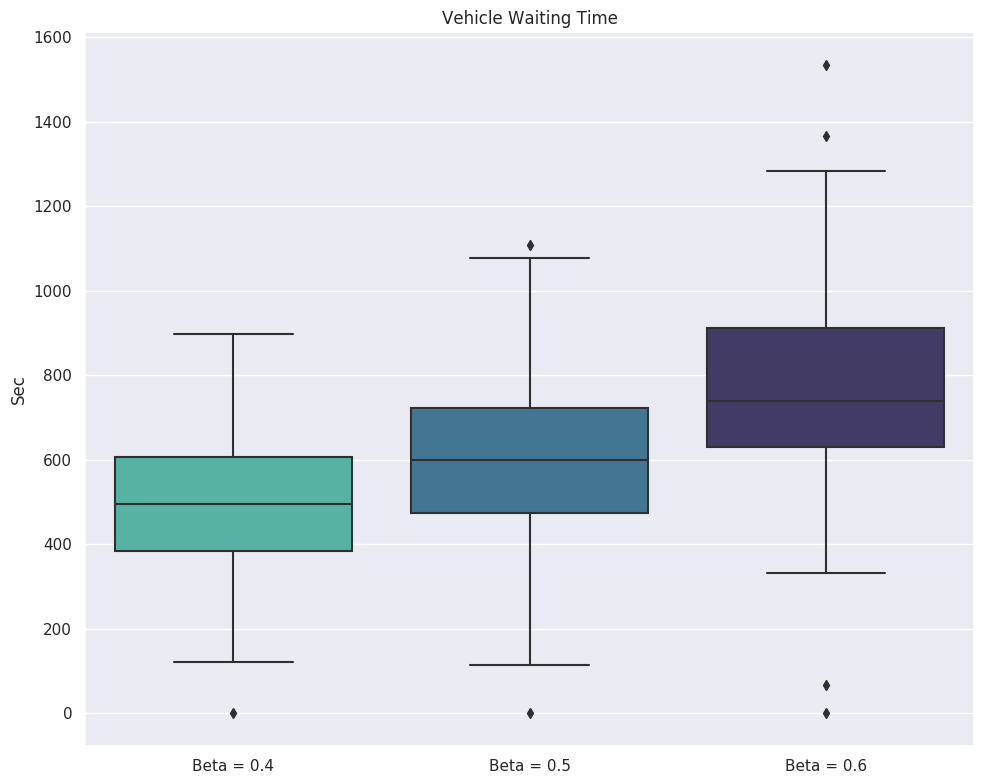

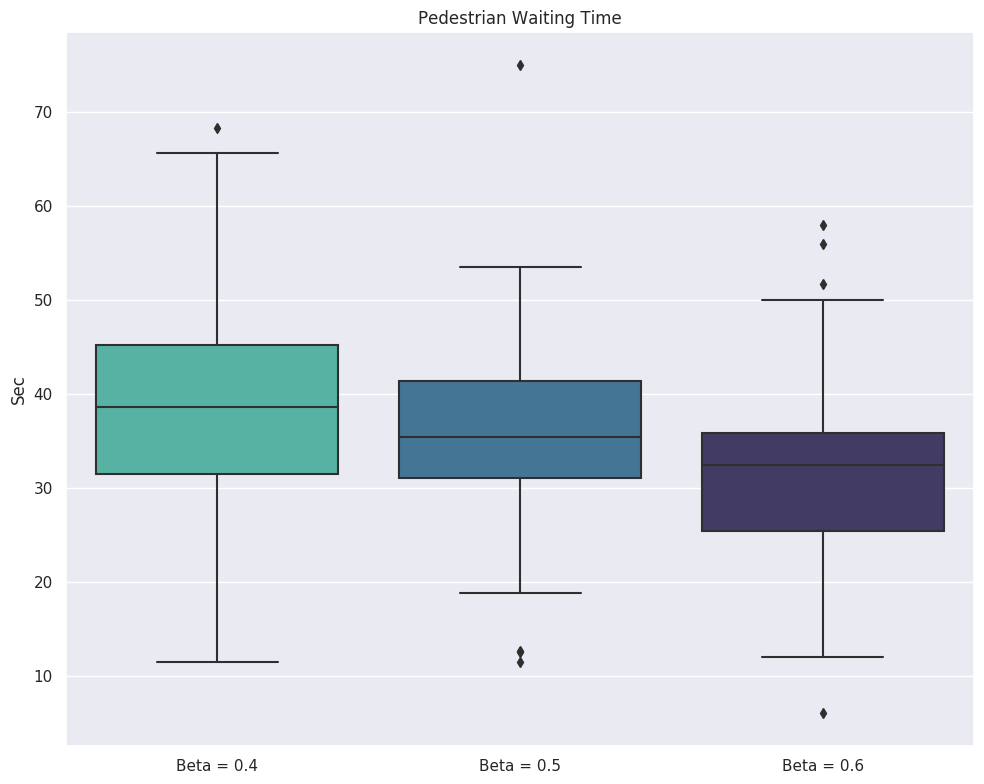

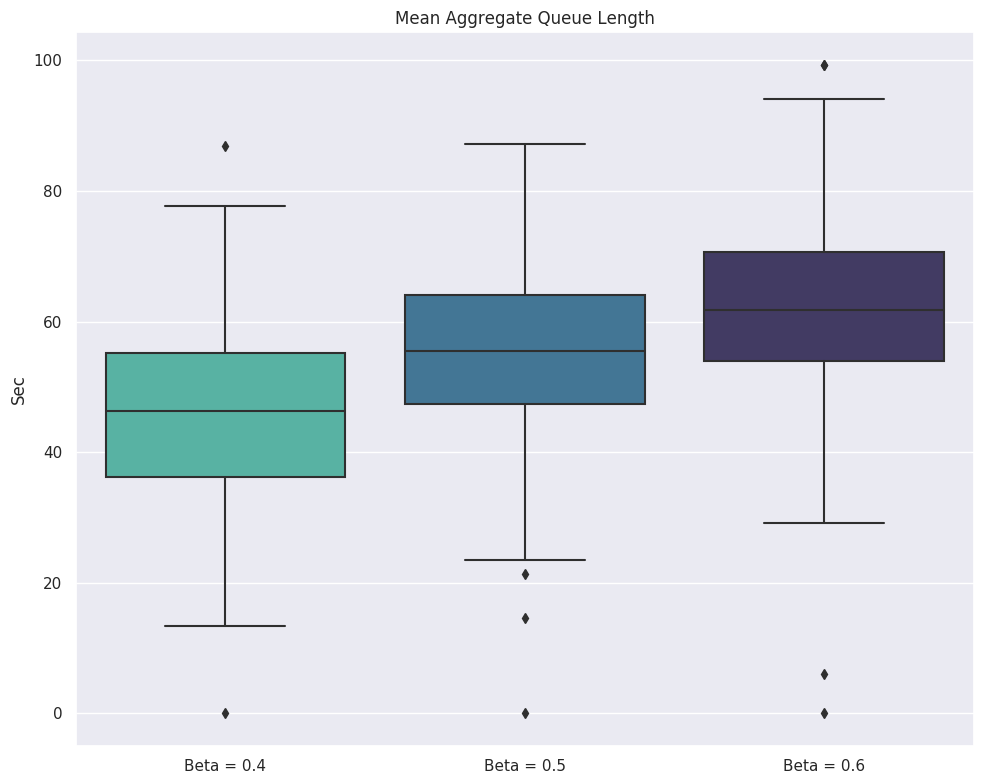

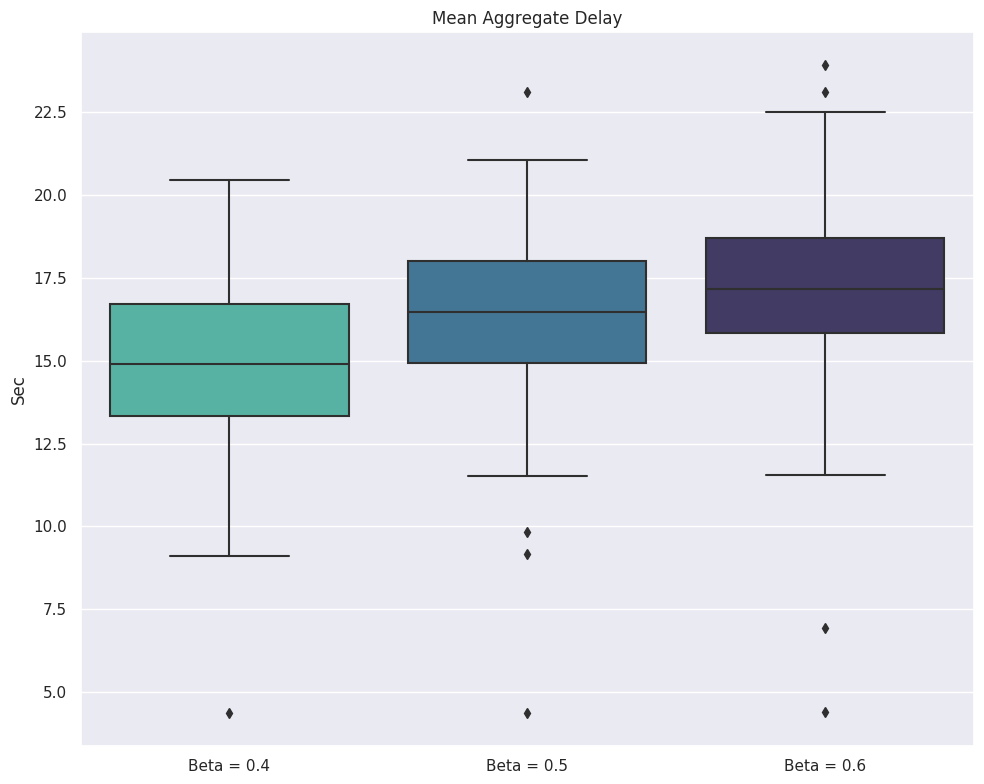

In [186]:
boxBeta( [ql_beta4_Vm, ql_beta5_Vm, ql_beta6_Vm], ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6'], 'Vehicle Waiting Time')
boxBeta( [ql_beta4_Pm, ql_beta5_Pm, ql_beta6_Pm], ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6'], 'Pedestrian Waiting Time')
boxBeta( [ql_beta4_Qm, ql_beta5_Qm, ql_beta6_Qm], ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6'], 'Mean Aggregate Queue Length')
boxBeta( [ql_beta4_Dm, ql_beta5_Dm, ql_beta6_Dm], ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6'], 'Mean Aggregate Delay')

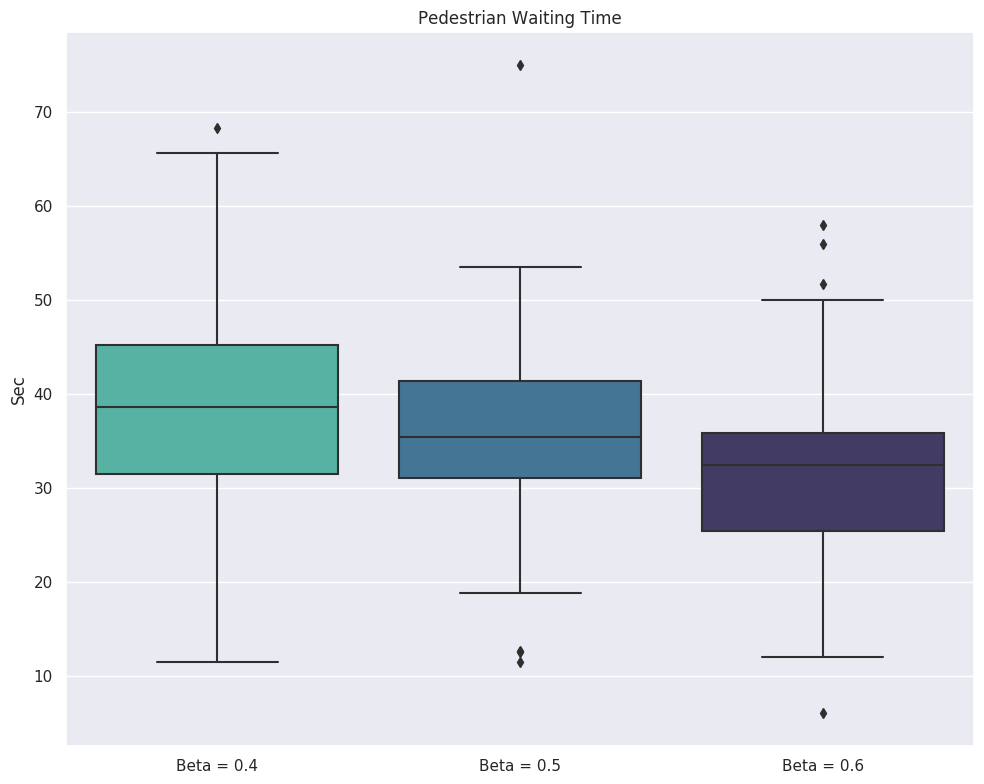

In [183]:
data = [ql_beta4_Pm, ql_beta5_Pm, ql_beta6_Pm]
labels = ['Beta = 0.4', 'Beta = 0.5', 'Beta = 0.6']

# Set figure size
plt.figure(figsize=(10, 8))

sns.boxplot(data=data, showfliers=True, palette="mako_r")

plt.xticks(ticks=range(len(labels)), labels=labels)

plt.title('Pedestrian Waiting Time')
plt.ylabel('Sec')

plt.tight_layout()
plt.show()

###########################################################################################################################

### RW: DELAY

#### TRAFFIC VARIATION

##### light traffic

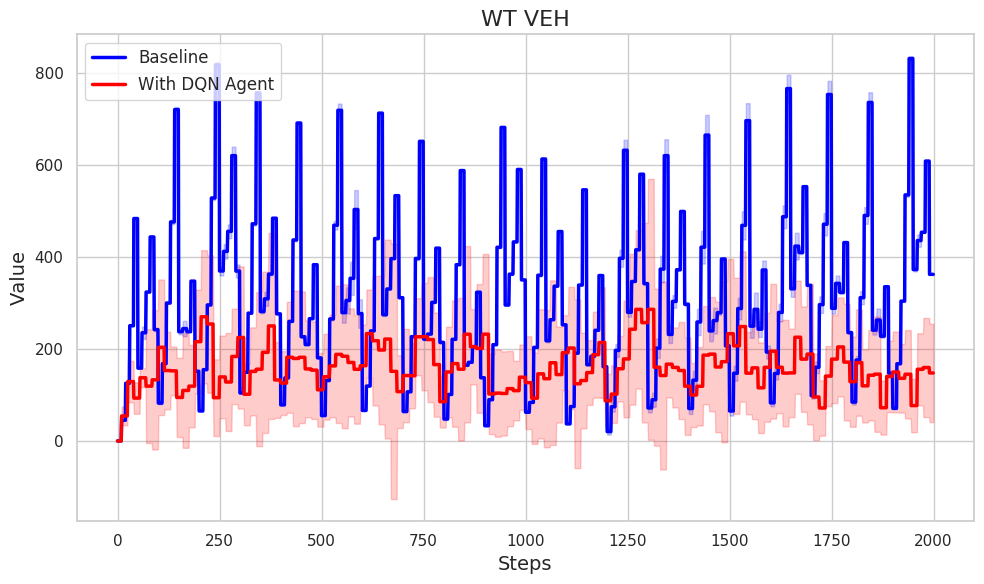

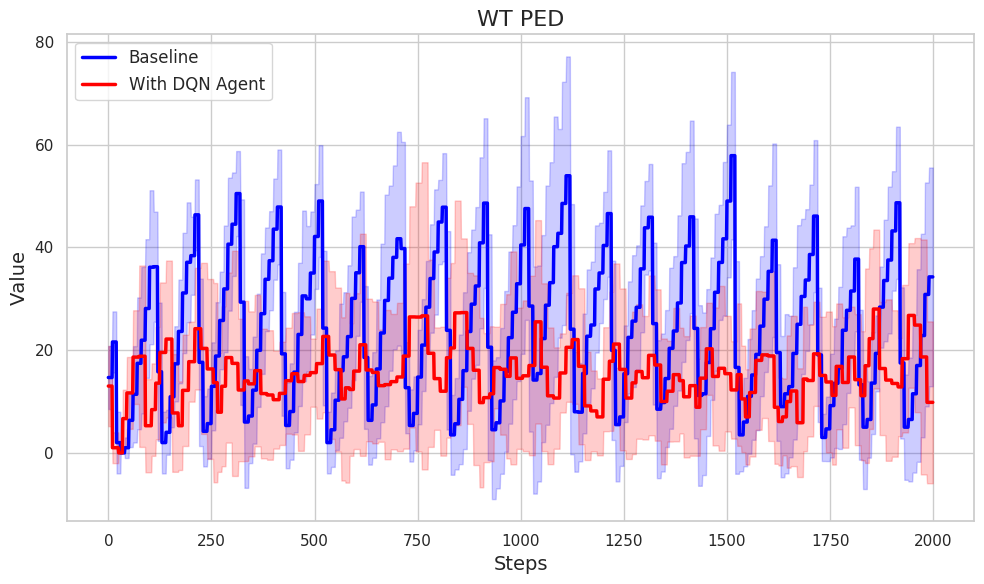

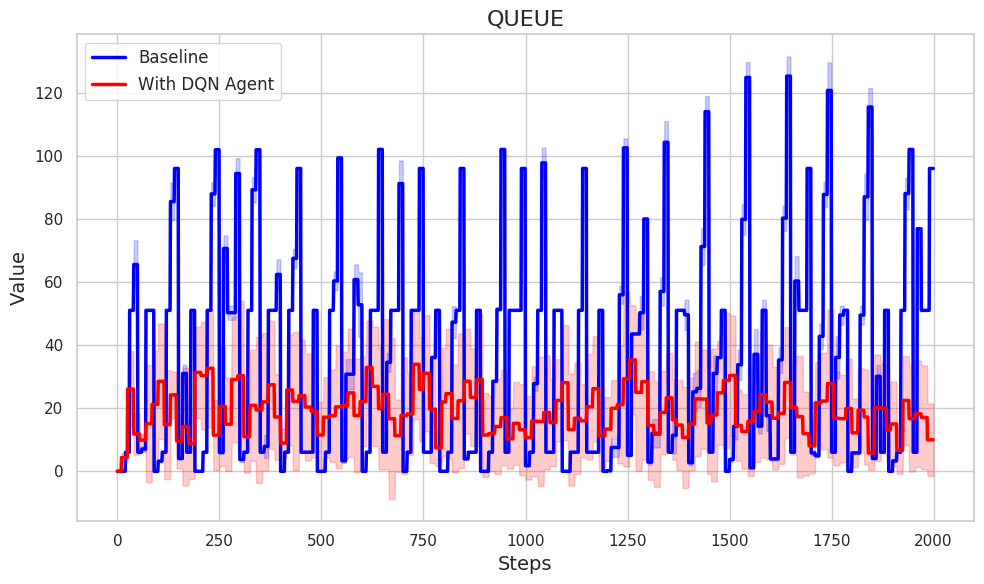

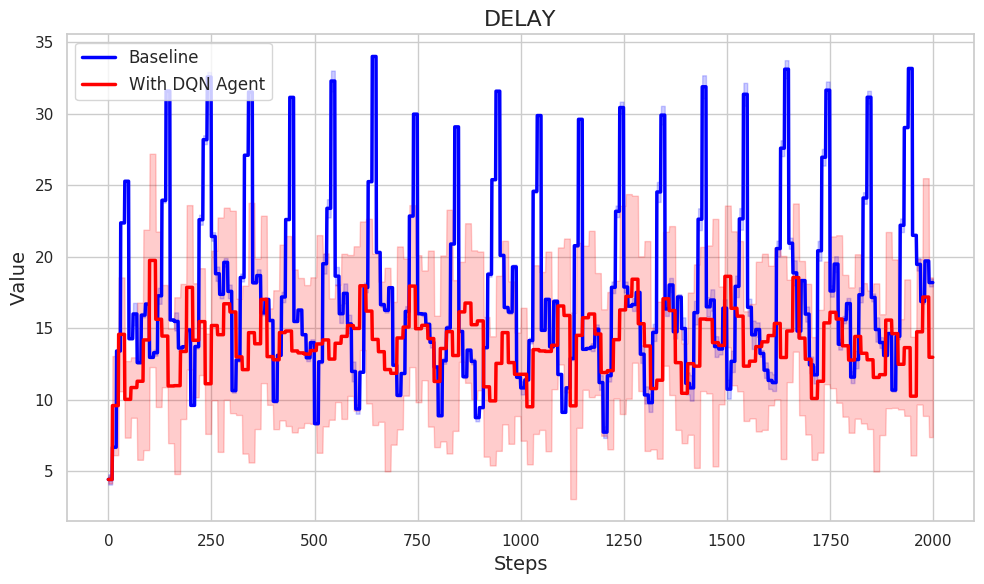

In [34]:
#dl_low_10_base = pd.read_csv('results/stats_ped/ql_lowveh_10g_ped35_base')
dl_low_10 = pd.read_csv('results/stats_ped/dl_low_2') #ql_lowveh_10g_ped35 #dl_mix_low_10sec3

dllow10_V, dllow10_Vm, dllow10_Vs  = getRes(10, dl_low_10, 'wt_veh')
dllow10_Vm_full, dllow10_Vs_full = enl(dllow10_V, dllow10_Vm, dllow10_Vs, 10)
defPlot(base_low_Vm_full, base_low_Vs_full, dllow10_Vm_full[:2000], dllow10_Vs_full[:2000], 'WT VEH')

dllow10_P, dllow10_Pm, dllow10_Ps  = getRes(10, dl_low_10, 'wt_ped')
dllow10_Pm_full, dllow10_Ps_full = enl(dllow10_P, dllow10_Pm, dllow10_Ps, 10)
defPlot(base_low_Pm_full, base_low_Ps_full, dllow10_Pm_full[:2000], dllow10_Ps_full[:2000], 'WT PED')

dllow10_Q, dllow10_Qm, dllow10_Qs  = getRes(10, dl_low_10, 'queue')
dllow10_Qm_full, dllow10_Qs_full = enl(dllow10_Q, dllow10_Qm, dllow10_Qs, 10)
defPlot(base_low_Qm_full, base_low_Qs_full, dllow10_Qm_full[:2000], dllow10_Qs_full[:2000], 'QUEUE')

dllow10_D, dllow10_Dm, dllow10_Ds  = getRes(10, dl_low_10, 'delay')
dllow10_Dm_full, dllow10_Ds_full = enl(dllow10_D, dllow10_Dm, dllow10_Ds, 10)
defPlot(base_low_Dm_full, base_low_Ds_full, dllow10_Dm_full[:2000], dllow10_Ds_full[:2000], 'DELAY')

##### moderate traffic

*waiting time vehicles*

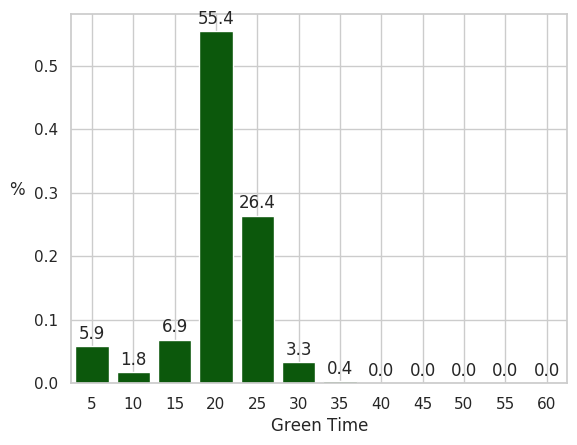

In [50]:
plotAct(dl_mid_10, 5, '')

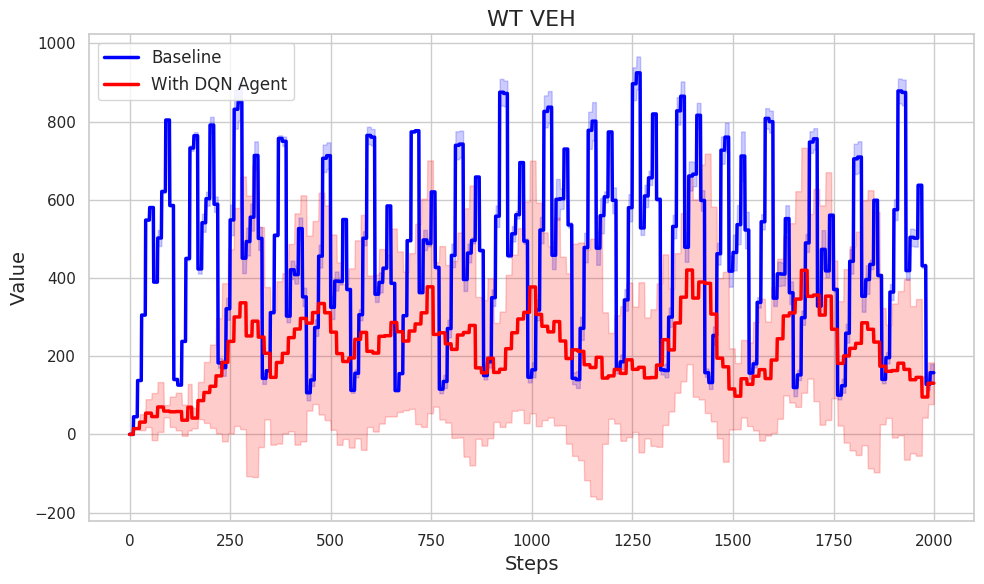

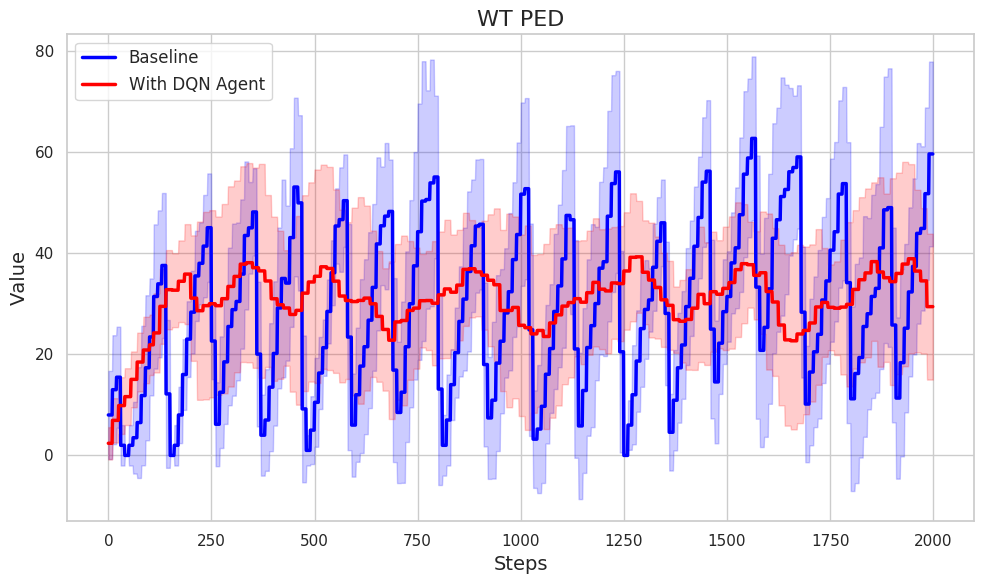

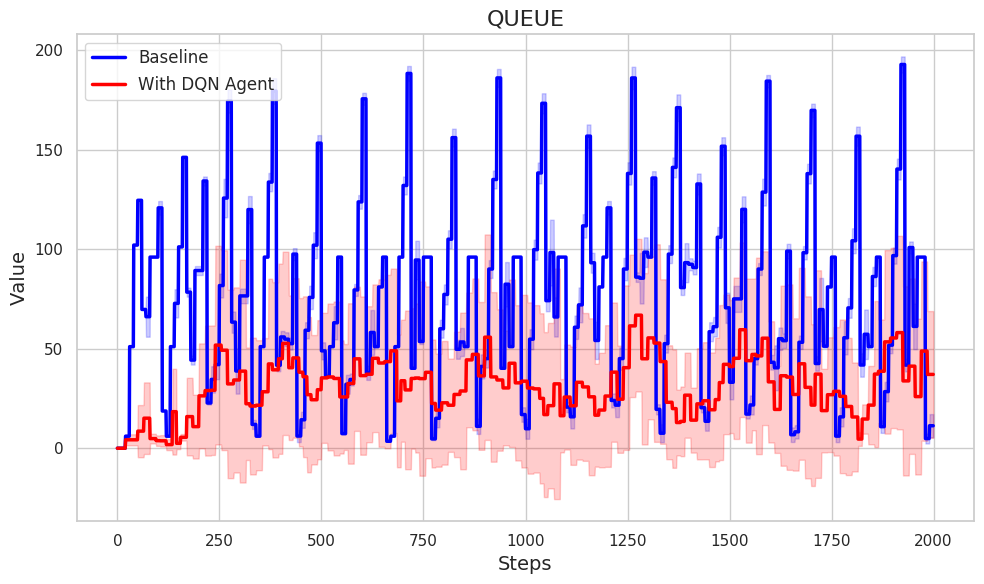

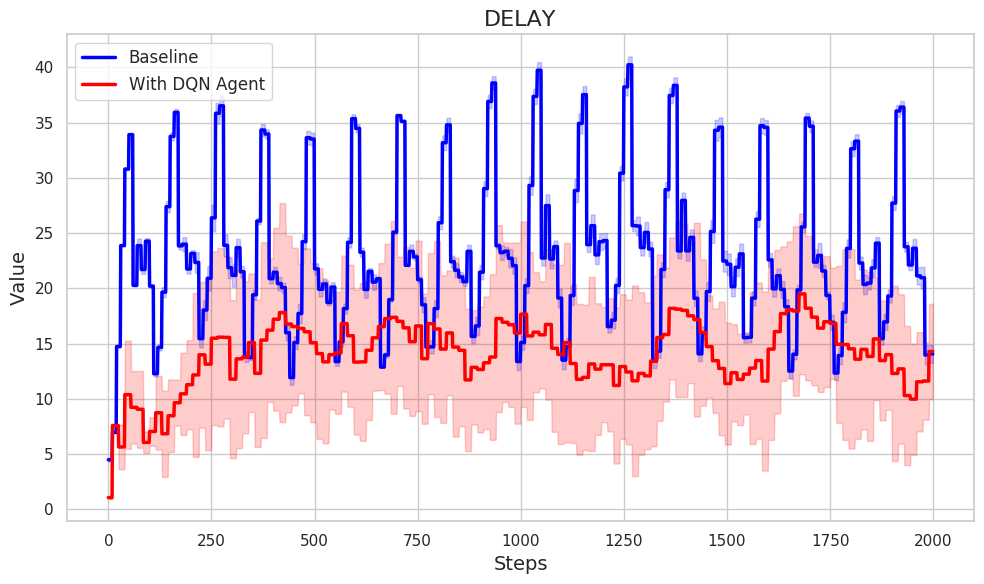

In [49]:
dl_mid_10 = pd.read_csv('results/stats_ped/dl_5sec_21novm')  #dl_mix_mid_10sec2 #dl_mid_mixlarge_pen #dl_mid10_b5_pen10_2 #dl_mid_mixlarge_pen_ped.35_OP #dl_mixlarge_mid_12nov #dl_mixlarge_mid_12nov

dlmid10_V, dlmid10_Vm, dlmid10_Vs  = getRes(10, dl_mid_10, 'wt_veh')
dlmid10_Vm_full, dlmid10_Vs_full = enl(dlmid10_V, dlmid10_Vm, dlmid10_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dlmid10_Vm_full[:2000], dlmid10_Vs_full[:2000], 'WT VEH')

dlmid10_P, dlmid10_Pm, dlmid10_Ps  = getRes(10, dl_mid_10, 'wt_ped')
dlmid10_Pm_full, dlmid10_Ps_full = enl(dlmid10_P, dlmid10_Pm, dlmid10_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, dlmid10_Pm_full[:2000], dlmid10_Ps_full[:2000], 'WT PED')

dlmid10_Q, dlmid10_Qm, dlmid10_Qs  = getRes(10, dl_mid_10, 'queue')
dlmid10_Qm_full, dlmid10_Qs_full = enl(dlmid10_Q, dlmid10_Qm, dlmid10_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, dlmid10_Qm_full[:2000], dlmid10_Qs_full[:2000], 'QUEUE')

dlmid10_D, dlmid10_Dm, dlmid10_Ds  = getRes(10, dl_mid_10, 'delay')
dlmid10_Dm_full, dlmid10_Ds_full = enl(dlmid10_D, dlmid10_Dm, dlmid10_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, dlmid10_Dm_full[:2000], dlmid10_Ds_full[:2000], 'DELAY')

##### heavy traffic

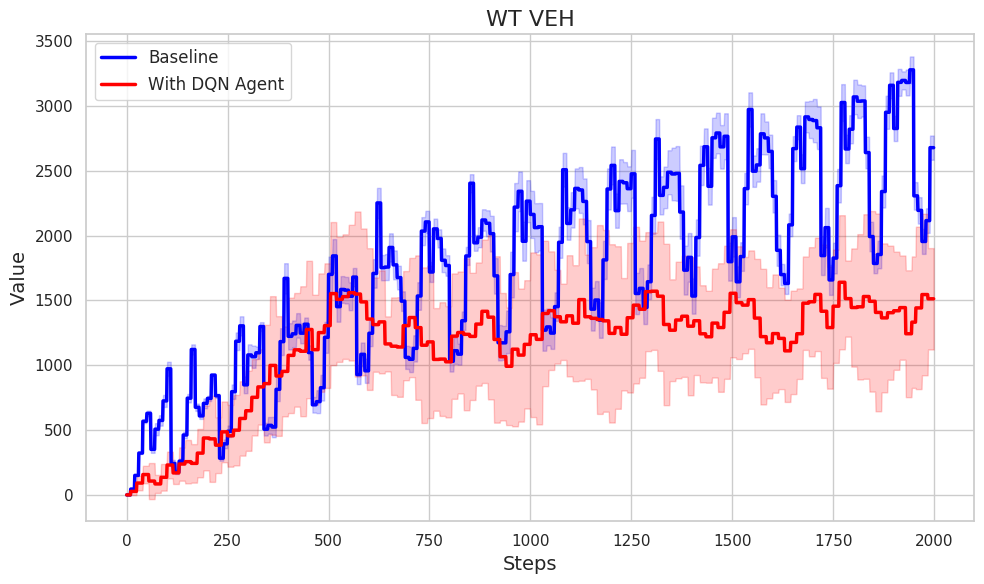

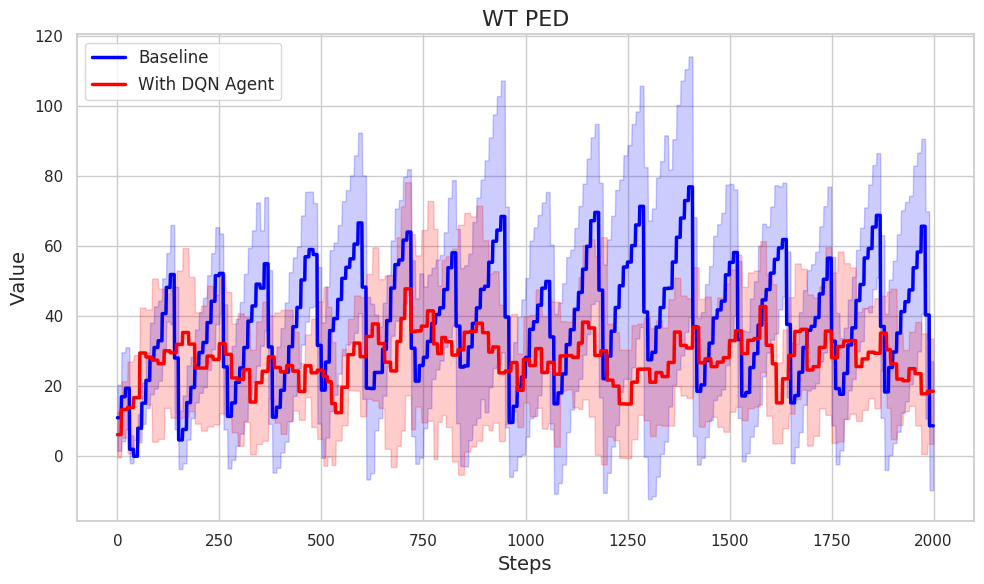

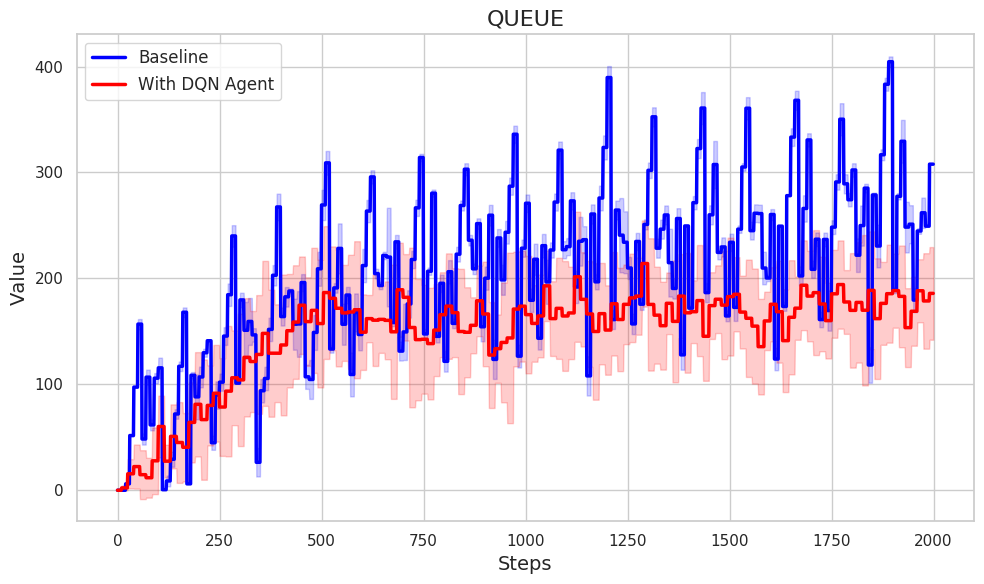

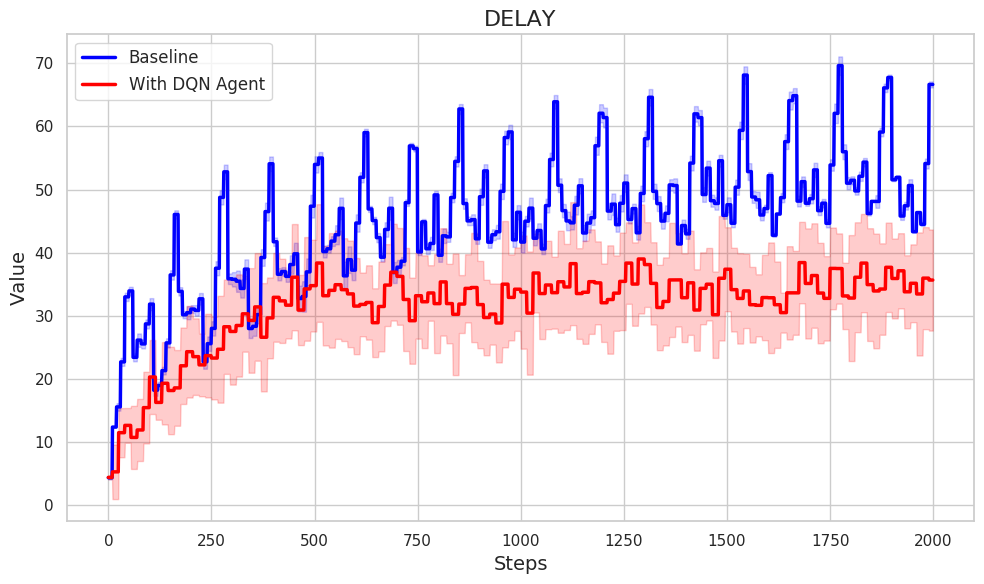

In [36]:
dl_high_10 = pd.read_csv('results/stats_ped/dl_high_17nov')  #dl_mix_high_10sec2

dlhigh10_V, dlhigh10_Vm, dlhigh10_Vs  = getRes(10, dl_high_10, 'wt_veh')
dlhigh10_Vm_full, dlhigh10_Vs_full = enl(dlhigh10_V, dlhigh10_Vm, dlhigh10_Vs, 10)
defPlot(base_high_Vm_full, base_high_Vs_full, dlhigh10_Vm_full[:2000], dlhigh10_Vs_full[:2000], 'WT VEH')

dlhigh10_P, dlhigh10_Pm, dlhigh10_Ps  = getRes(10, dl_high_10, 'wt_ped')
dlhigh10_Pm_full, dlhigh10_Ps_full = enl(dlhigh10_P, dlhigh10_Pm, dlhigh10_Ps, 10)
defPlot(base_high_Pm_full, base_high_Ps_full, dlhigh10_Pm_full[:2000], dlhigh10_Ps_full[:2000], 'WT PED')

dlhigh10_Q, dlhigh10_Qm, dlhigh10_Qs  = getRes(10, dl_high_10, 'queue')
dlhigh10_Qm_full, dlhigh10_Qs_full = enl(dlhigh10_Q, dlhigh10_Qm, dlhigh10_Qs, 10)
defPlot(base_high_Qm_full, base_high_Qs_full, dlhigh10_Qm_full[:2000], dlhigh10_Qs_full[:2000], 'QUEUE')

dlhigh10_D, dlhigh10_Dm, dlhigh10_Ds  = getRes(10, dl_high_10, 'delay')
dlhigh10_Dm_full, dlhigh10_Ds_full = enl(dlhigh10_D, dlhigh10_Dm, dlhigh10_Ds, 10)
defPlot(base_high_Dm_full, base_high_Ds_full, dlhigh10_Dm_full[:2000], dlhigh10_Ds_full[:2000], 'DELAY')


In [ ]:
##### Comparison

NameError: name 'wtmid5_Vm_full' is not defined

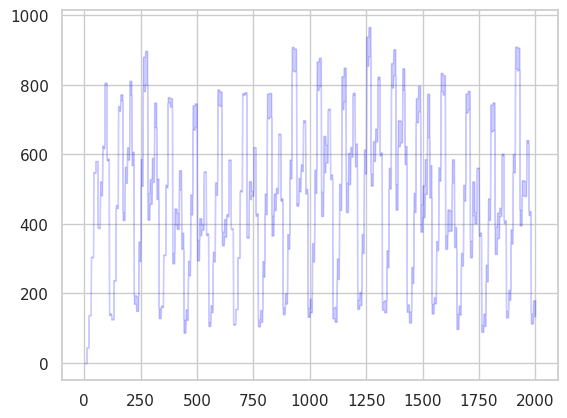

In [37]:
# Plot the standard deviation as a shaded area

plt.fill_between(range(len(base_mid_Vm_full)), np.array(base_mid_Vm_full) - np.array(base_mid_Vs_full),
                np.array(base_mid_Vm_full) + np.array(base_mid_Vs_full),
                color='blue', alpha=0.2)

plt.fill_between(range(len(wtmid5_Vm_full[:2000])), np.array(wtmid5_Vm_full[:2000]) - np.array(wtmid5_Vs_full[:2000]),
                np.array(wtmid5_Vm_full[:2000]) + np.array(wtmid5_Vs_full[:2000]),
                color='red', alpha=0.2)
plt.fill_between(range(len(wtmid10_Vm_full[:2000])), np.array(wtmid10_Vm_full[:2000]) - np.array(wtmid10_Vs_full[:2000]),
                np.array(wtmid10_Vm_full[:2000]) + np.array(wtmid10_Vs_full[:2000]),
                color='orange', alpha=0.2)
plt.fill_between(range(len(wtmid15_Vm_full[:2000])), np.array(wtmid15_Vm_full[:2000]) - np.array(wtmid15_Vs_full[:2000]),
                np.array(wtmid15_Vm_full[:2000]) + np.array(wtmid15_Vs_full[:2000]),
                color='green', alpha=0.2)


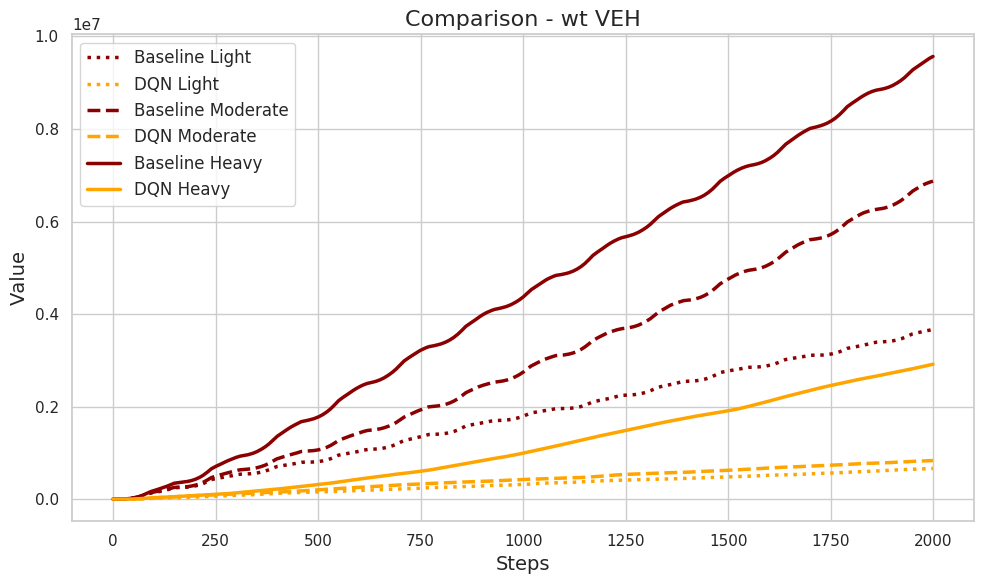

In [118]:
plt.figure(figsize=(10, 6))
#sns.set(style="whitegrid")

plt.plot(np.cumsum(base_low_Vm_full), color='darkred', linestyle = ':',  linewidth=2.5, label='Baseline Light')
plt.plot(np.cumsum(dllow10_Vm_full[:2000]), color='orange', linestyle = ':', linewidth=2.5, label='DQN Light')

plt.plot(np.cumsum(base_mid_Vm_full), color='darkred', linestyle = '--', linewidth=2.5, label='Baseline Moderate')
plt.plot(np.cumsum(dlmid10_Vm_full[:2000]), color='orange', linestyle = '--', linewidth=2.5, label='DQN Moderate')

plt.plot(np.cumsum(base_high_Vm_full), color='darkred', linewidth=2.5, label='Baseline Heavy')
plt.plot(np.cumsum(dlhigh10_Vm_full[:2000]), color='orange', linewidth=2.5, label='DQN Heavy')


plt.title('Comparison - wt VEH', fontsize=16)
plt.xlabel("Steps", fontsize=14)
plt.ylabel("Value", fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.tight_layout()


plt.show()

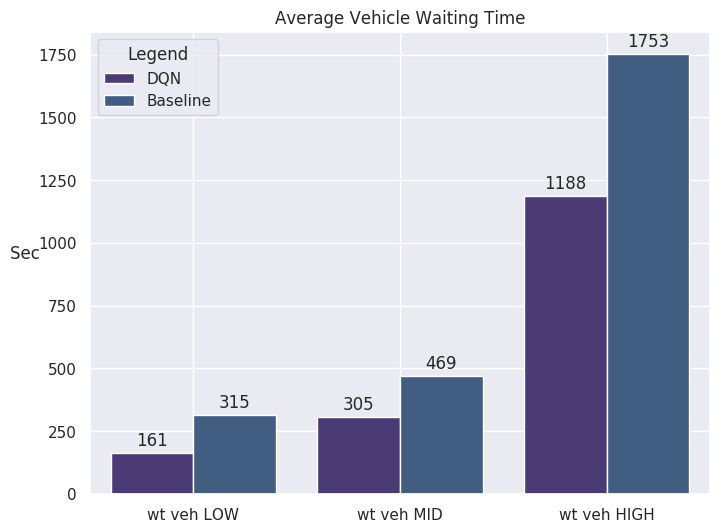

In [38]:
dllow = {'wt veh LOW':np.mean(dllow10_Vm), 'wt veh MID':np.mean(dlmid10_Vm), 'wt veh HIGH':np.mean(dlhigh10_Vm_full)}
dlbase = {'wt veh LOW':np.mean(base_low_Vm), 'wt veh MID':np.mean(base_mid_Vm_full), 'wt veh HIGH':np.mean(base_high_Vm_full)}

dlmid = {'wt veh':np.mean(dlmid10_Vm_full), 'wt ped':np.mean(dlmid10_Pm_full), 'queue len':np.mean(dlmid10_Qm_full), 'delay':np.mean(dlmid10_Dm_full)}
dlhigh = {'wt veh':np.mean(dlhigh10_Vm_full), 'wt ped':np.mean(dlhigh10_Pm_full), 'queue len':np.mean(dlhigh10_Qm_full), 'delay':np.mean(dlhigh10_Dm_full)}

df = pd.DataFrame([dllow, dlbase])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['DQN', 'Baseline']*3

sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Average Vehicle Waiting Time')
plt.xlabel('')
plt.ylabel('Sec   ', rotation=0)
plt.grid(True)
plt.show()

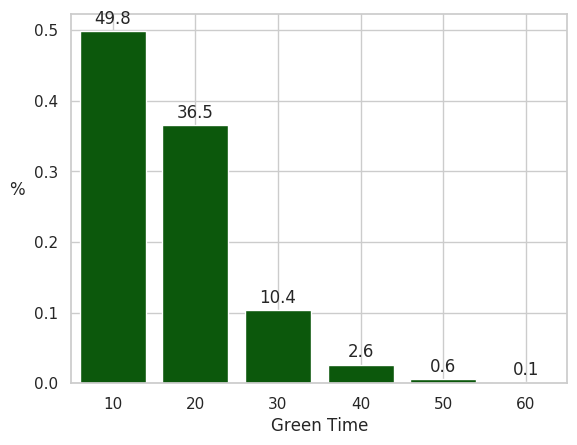

In [29]:
dltry = pd.read_csv('results/stats_ped/dl_low_mixlarge') 
plotAct(dl_mid_10, 10, '')

In [440]:
dl_mid_10_pen = pd.read_csv('results/stats_ped/dl_mix_mid_10sec_pen_beta2') 

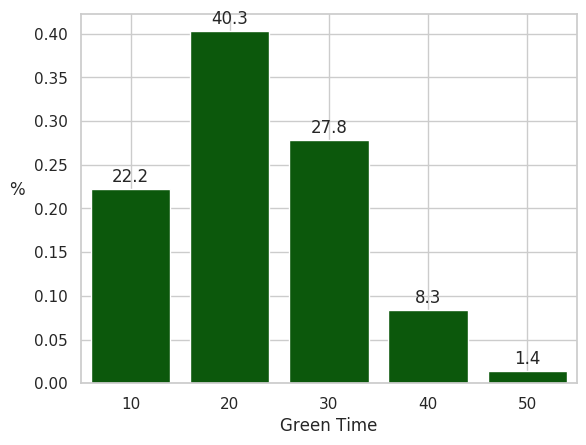

In [442]:
plotAct(dl_mid_10_pen, 0, 10, '')

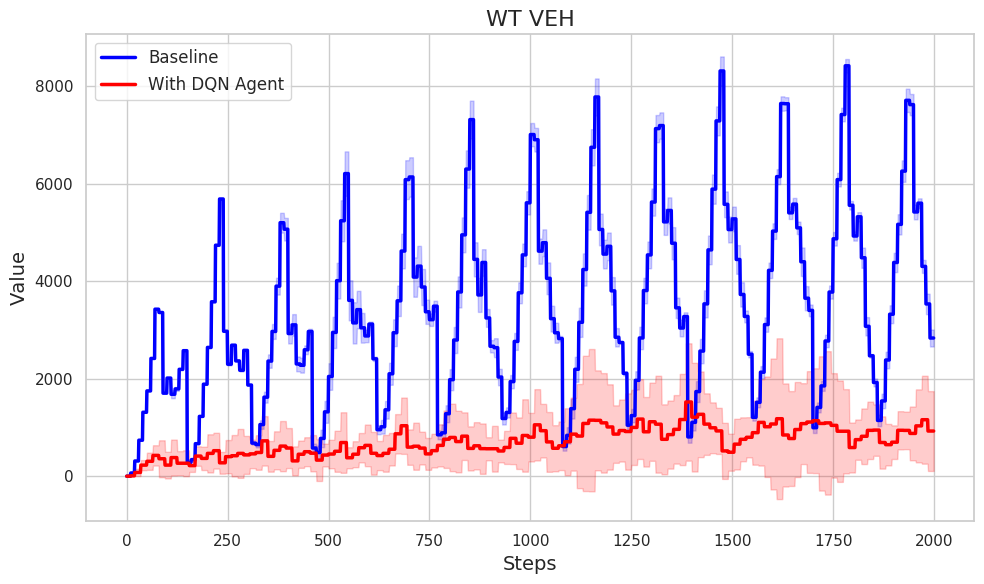

In [443]:
dlmid10_V, dlmid10_Vm, dlmid10_Vs  = getRes(10, dl_mid_10_pen, 'wt_veh')

dlmid10_Vm_full, dlmid10_Vs_full = enl(dlmid10_V, dlmid10_Vm, dlmid10_Vs, 10)

defPlot(base_mid_Vm_full, base_mid_Vs_full, dlmid10_Vm_full[:2000], dlmid10_Vs_full[:2000], 'WT VEH')

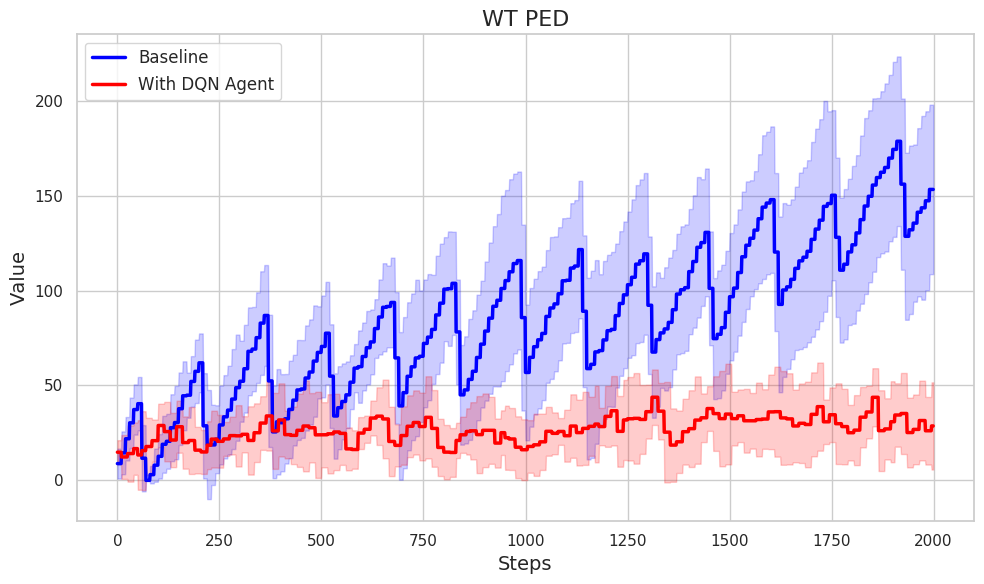

In [444]:
dlmid10_P, dlmid10_Pm, dlmid10_Ps  = getRes(10, dl_mid_10_pen, 'wt_ped')

dlmid10_Pm_full, dlmid10_Ps_full = enl(dlmid10_P, dlmid10_Pm, dlmid10_Ps, 10)

defPlot(base_mid_Pm_full, base_mid_Ps_full, dlmid10_Pm_full[:2000], dlmid10_Ps_full[:2000], 'WT PED')

In [488]:
dl_mid_10_penb4 = pd.read_csv('results/stats_ped/dl_mid_pen_a') #dl_mix_mid_10sec_pen_beta1

In [491]:
np.mean(dlmid10_Pm_full)

23.512609735445203

In [503]:
np.mean(base_mid_Vm_full)

3436.358

In [501]:
np.mean(dlmid10_Vm_full)

3674.9826793721973

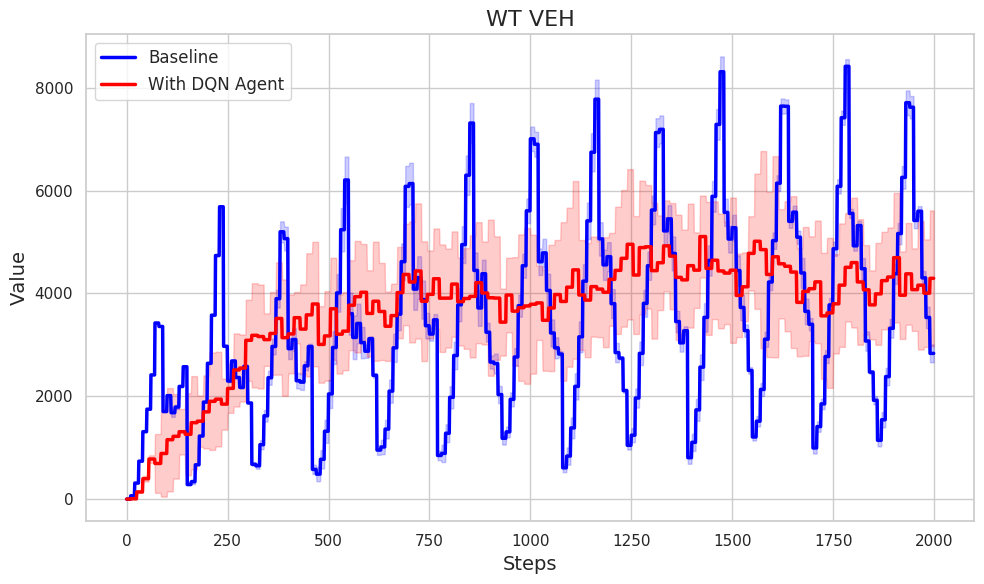

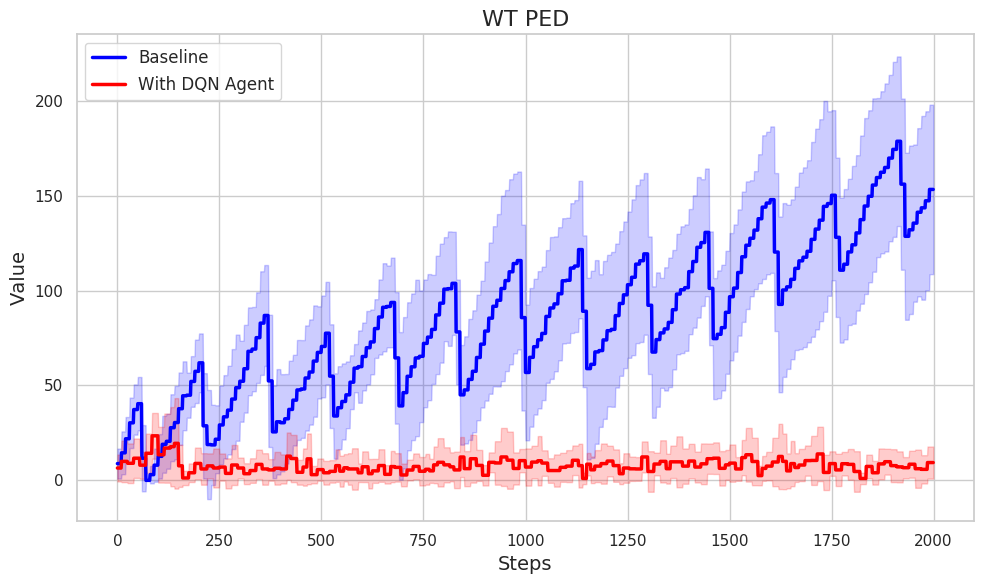

In [515]:
dl_mid_10_penb4 = pd.read_csv('results/stats_ped/dl_mid10_b6') #dl_mix_mid_10sec_pen_beta1

dlmid10_V, dlmid10_Vm, dlmid10_Vs  = getRes(10, dl_mid_10_penb4, 'wt_veh')

dlmid10_Vm_full, dlmid10_Vs_full = enl(dlmid10_V, dlmid10_Vm, dlmid10_Vs, 10)

defPlot(base_mid_Vm_full, base_mid_Vs_full, dlmid10_Vm_full[:2000], dlmid10_Vs_full[:2000], 'WT VEH')

dlmid10_P, dlmid10_Pm, dlmid10_Ps  = getRes(10, dl_mid_10_penb4, 'wt_ped')

dlmid10_Pm_full, dlmid10_Ps_full = enl(dlmid10_P, dlmid10_Pm, dlmid10_Ps, 10)

defPlot(base_mid_Pm_full, base_mid_Ps_full, dlmid10_Pm_full[:2000], dlmid10_Ps_full[:2000], 'WT PED')

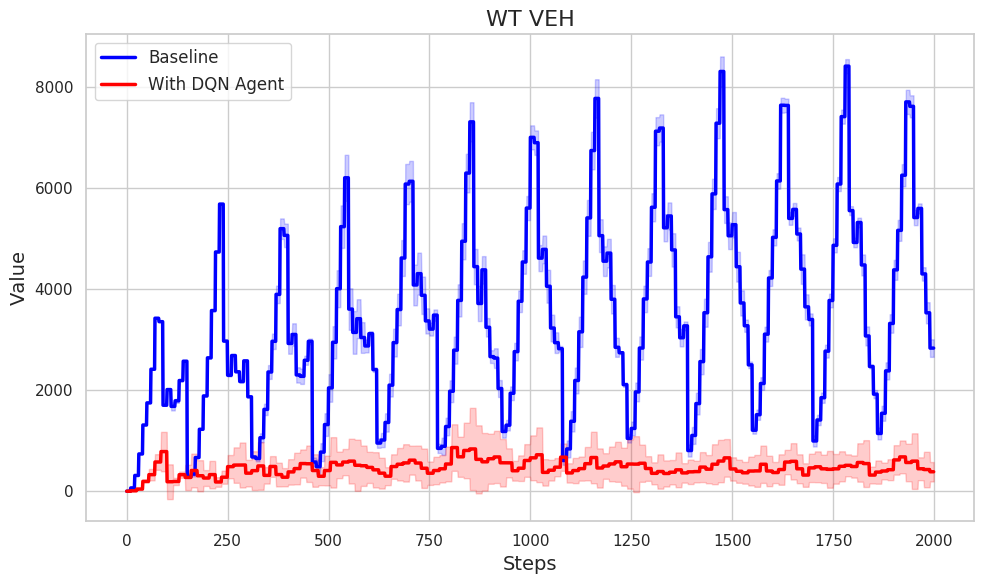

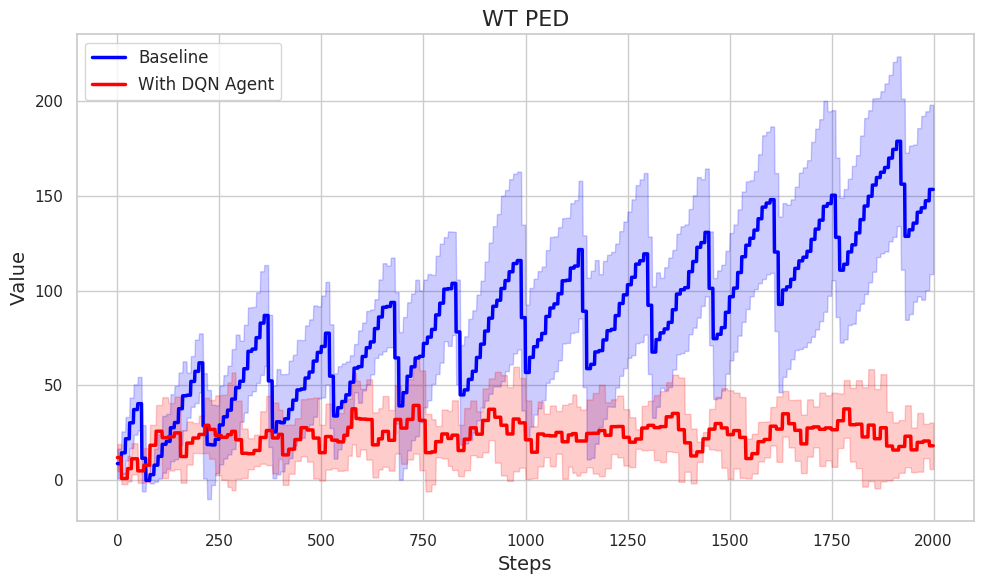

In [473]:
dlmid10_V, dlmid10_Vm, dlmid10_Vs  = getRes(10, dl_mid_10_penb4, 'wt_veh')

dlmid10_Vm_full, dlmid10_Vs_full = enl(dlmid10_V, dlmid10_Vm, dlmid10_Vs, 10)

defPlot(base_mid_Vm_full, base_mid_Vs_full, dlmid10_Vm_full[:2000], dlmid10_Vs_full[:2000], 'WT VEH')

dlmid10_P, dlmid10_Pm, dlmid10_Ps  = getRes(10, dl_mid_10_penb4, 'wt_ped')

dlmid10_Pm_full, dlmid10_Ps_full = enl(dlmid10_P, dlmid10_Pm, dlmid10_Ps, 10)

defPlot(base_mid_Pm_full, base_mid_Ps_full, dlmid10_Pm_full[:2000], dlmid10_Ps_full[:2000], 'WT PED')

#### WEIGHTS VARIATION

##### beta = 0.5

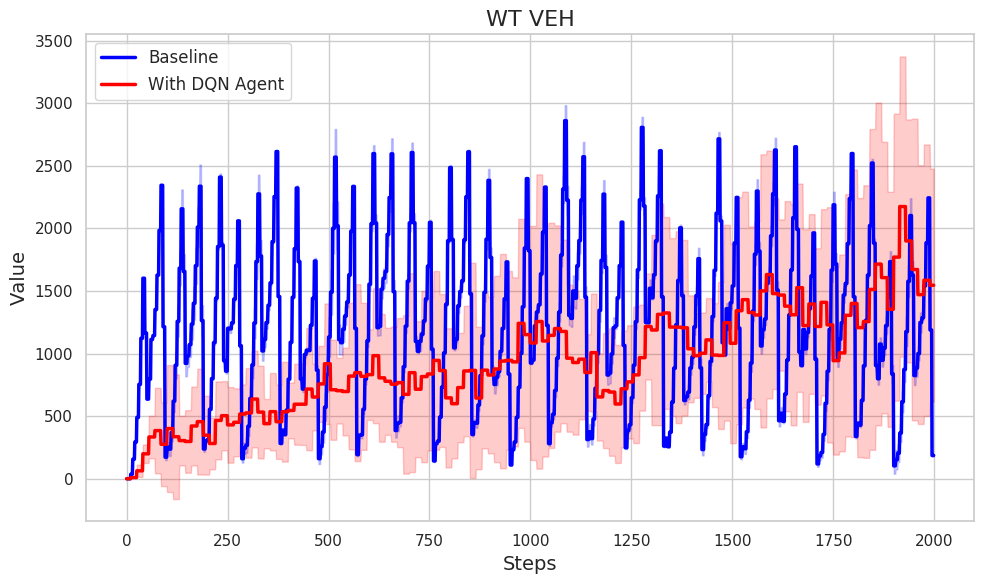

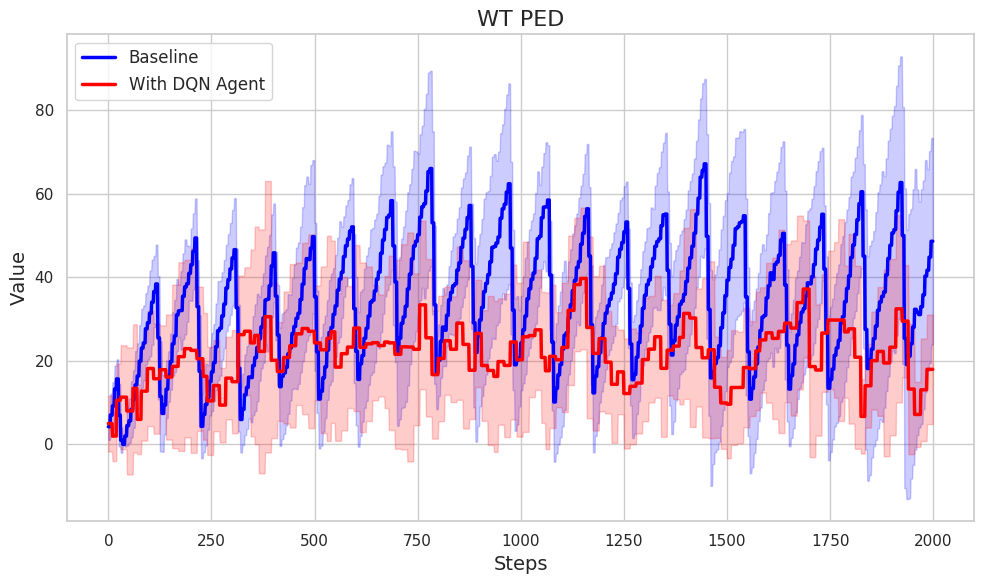

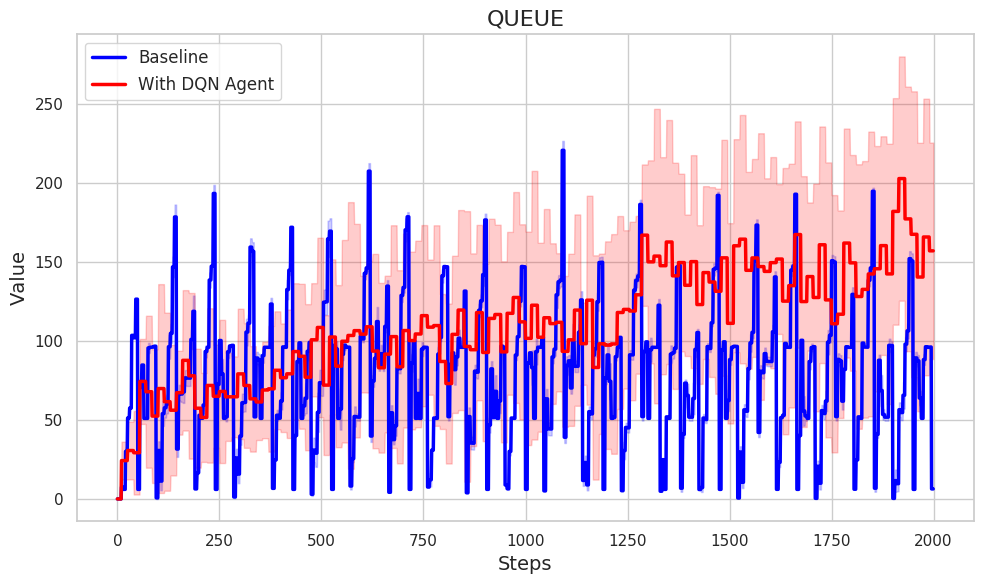

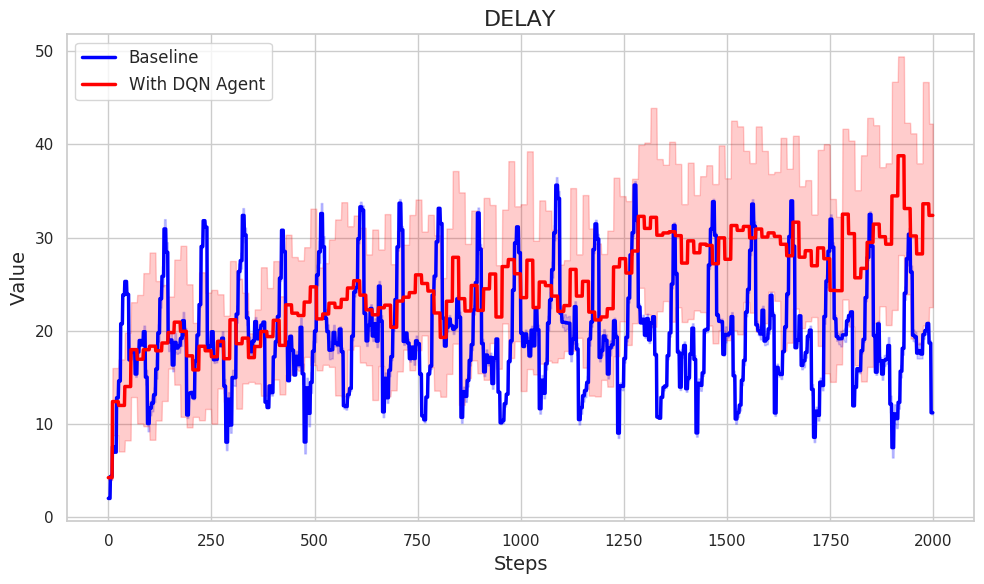

In [289]:
dl_beta5 = pd.read_csv('results/stats_ped/dl_mid10_b5') 

dl_beta5_V, dl_beta5_Vm, dl_beta5_Vs  = getRes(10, dl_beta5, 'wt_veh')
dl_beta5_Vm_full, dl_beta5_Vs_full = enl(dl_beta5_V, dl_beta5_Vm, dl_beta5_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dl_beta5_Vm_full[:2000], dl_beta5_Vs_full[:2000], 'WT VEH')

dl_beta5_P, dl_beta5_Pm, dl_beta5_Ps = getRes(10, dl_beta5, 'wt_ped')
dl_beta5_Pm_full, dl_beta5_Ps_full = enl(dl_beta5_P, dl_beta5_Pm, dl_beta5_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, dl_beta5_Pm_full[:2000], dl_beta5_Ps_full[:2000], 'WT PED')

dl_beta5_Q, dl_beta5_Qm, dl_beta5_Qs = getRes(10, dl_beta5, 'queue')
dl_beta5_Qm_full, dl_beta5_Qs_full = enl(dl_beta5_Q, dl_beta5_Qm, dl_beta5_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, dl_beta5_Qm_full[:2000], dl_beta5_Qs_full[:2000], 'QUEUE')

dl_beta5_D, dl_beta5_Dm, dl_beta5_Ds = getRes(10, dl_beta5, 'delay')
dl_beta5_Dm_full, dl_beta5_Ds_full = enl(dl_beta5_D, dl_beta5_Dm, dl_beta5_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, dl_beta5_Dm_full[:2000], dl_beta5_Ds_full[:2000], 'DELAY')

##### beta = 0.6

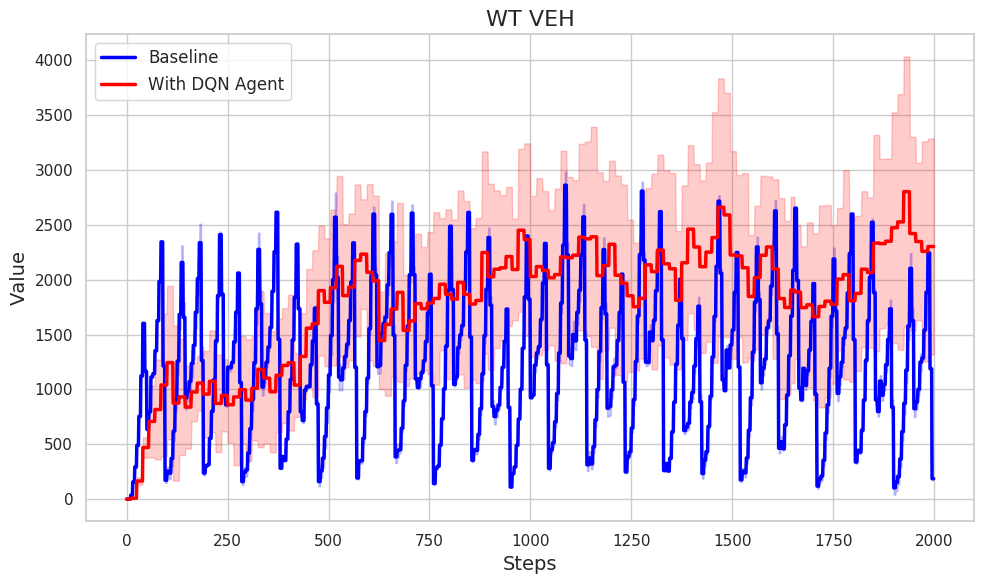

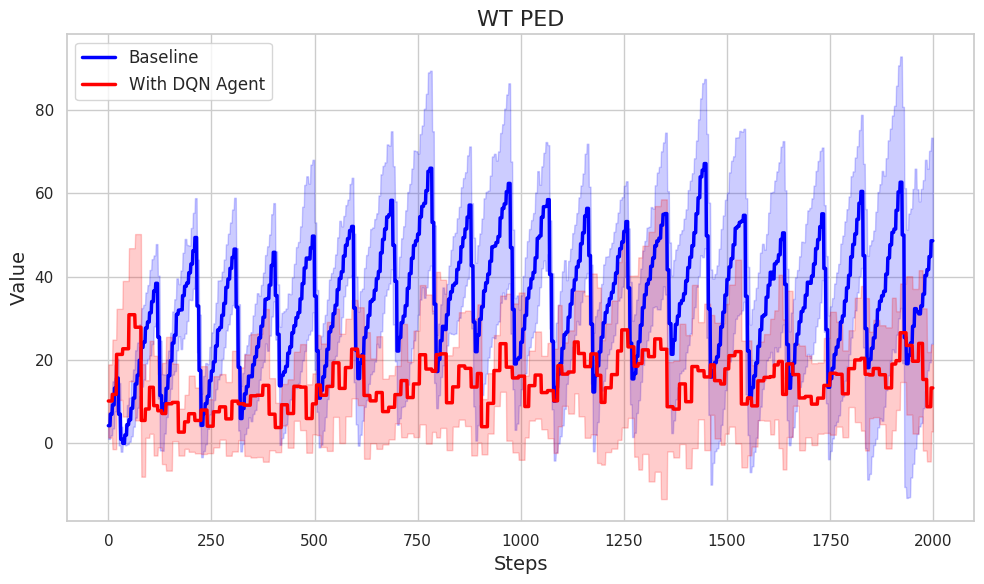

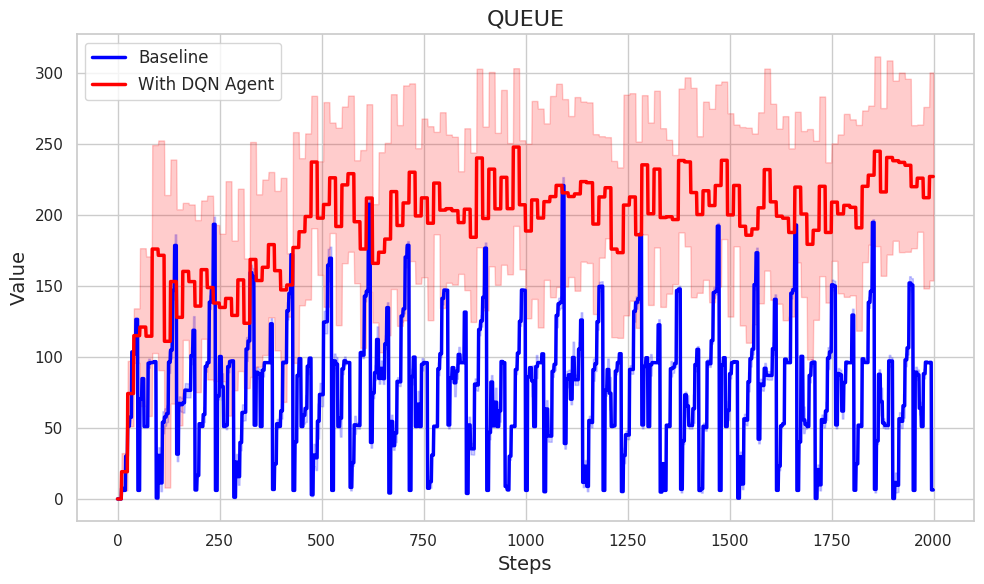

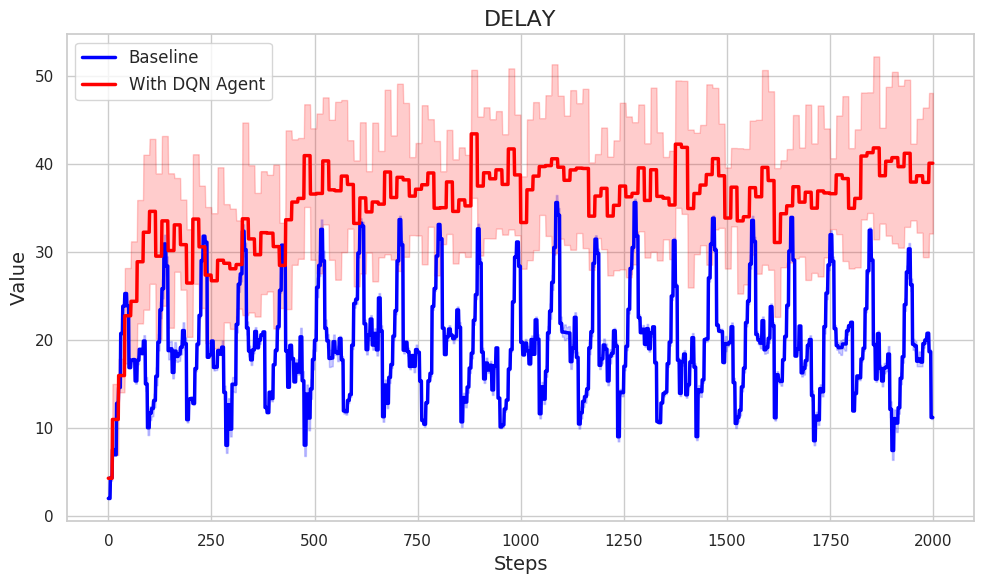

In [290]:
dl_beta6 = pd.read_csv('results/stats_ped/dl_mid10_b6_penfin3')   #dl_mid10_b6

dl_beta6_V, dl_beta6_Vm, dl_beta6_Vs  = getRes(10, dl_beta6, 'wt_veh')
dl_beta6_Vm_full, dl_beta6_Vs_full = enl(dl_beta6_V, dl_beta6_Vm, dl_beta6_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dl_beta6_Vm_full[:2000], dl_beta6_Vs_full[:2000], 'WT VEH')

dl_beta6_P, dl_beta6_Pm, dl_beta6_Ps = getRes(10, dl_beta6, 'wt_ped')
dl_beta6_Pm_full, dl_beta6_Ps_full = enl(dl_beta6_P, dl_beta6_Pm, dl_beta6_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, dl_beta6_Pm_full[:2000], dl_beta6_Ps_full[:2000], 'WT PED')

dl_beta6_Q, dl_beta6_Qm, dl_beta6_Qs  = getRes(10, dl_beta6, 'queue')
dl_beta6_Qm_full, dl_beta6_Qs_full = enl(dl_beta6_Q, dl_beta6_Qm, dl_beta6_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, dl_beta6_Qm_full[:2000], dl_beta6_Qs_full[:2000], 'QUEUE')

dl_beta6_D, dl_beta6_Dm, dl_beta6_Ds = getRes(10, dl_beta6, 'delay')
dl_beta6_Dm_full, dl_beta6_Ds_full = enl(dl_beta6_D, dl_beta6_Dm, dl_beta6_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, dl_beta6_Dm_full[:2000], dl_beta6_Ds_full[:2000], 'DELAY')

##### beta = 0.4

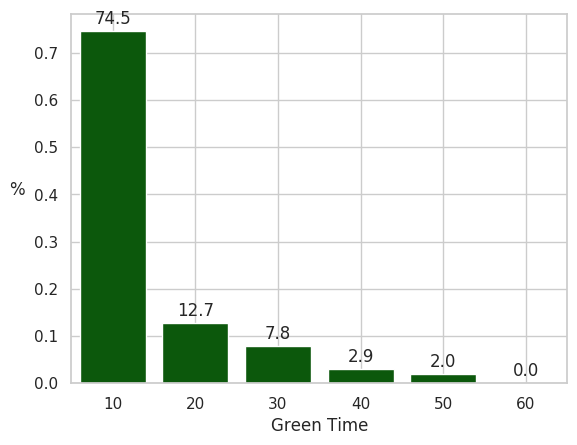

In [43]:
plotAct(dl_beta6, 0, 10, '')

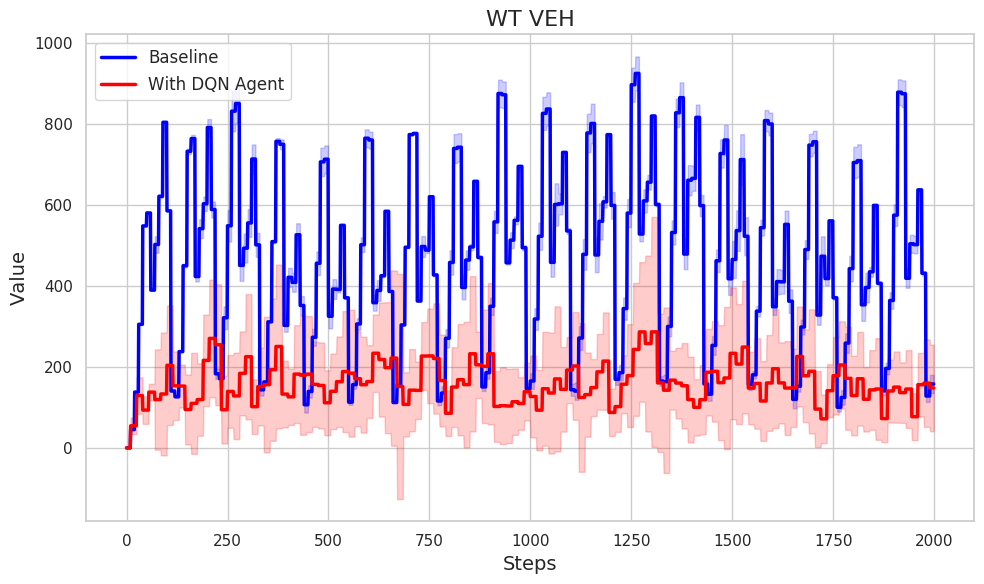

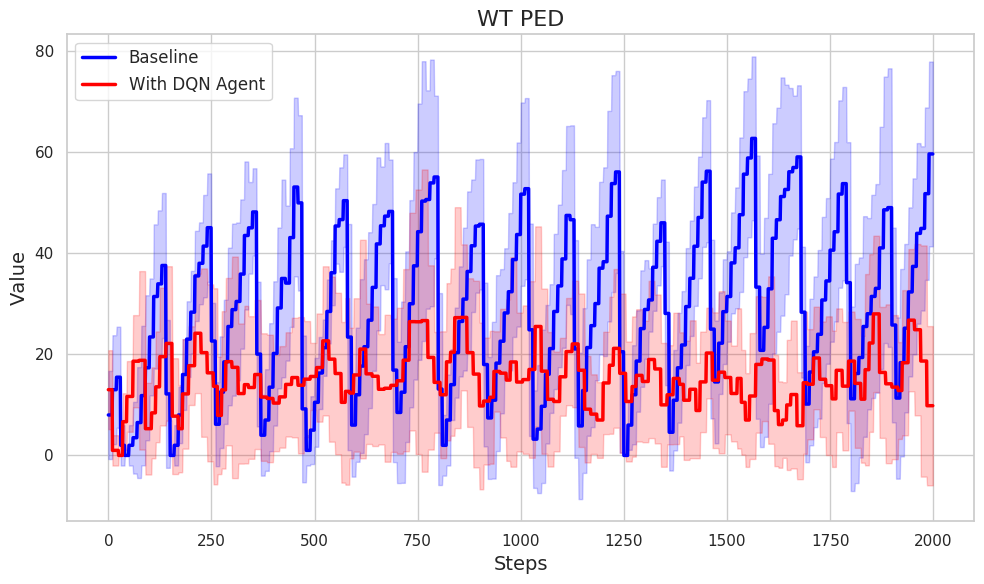

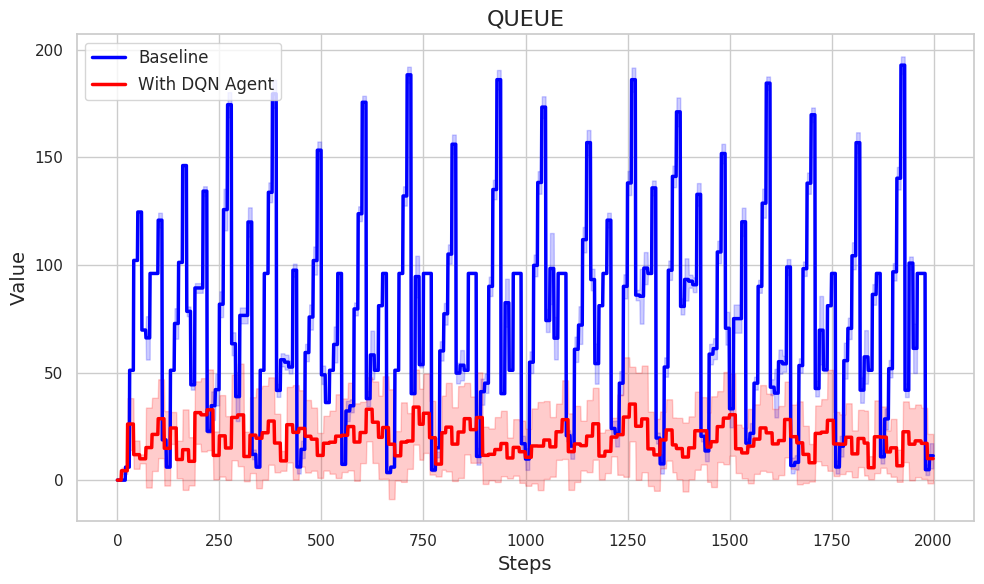

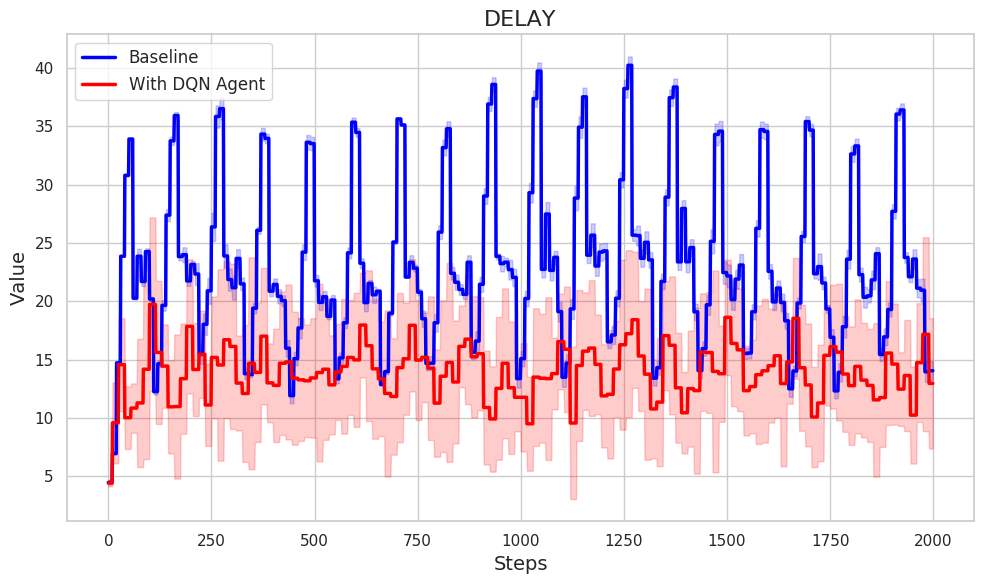

In [32]:
dl_beta4 = pd.read_csv('results/stats_ped/dl_mid10_b4_2')  #dl_mid10_b4_2 dl_mid10_b45_penfin3_2 dl_mid10_b4_penfin3 #

dl_beta4_V, dl_beta4_Vm, dl_beta4_Vs  = getRes(10, dl_beta4, 'wt_veh')
dl_beta4_Vm_full, dl_beta4_Vs_full = enl(dl_beta4_V, dl_beta4_Vm, dl_beta4_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dl_beta4_Vm_full[:2000], dl_beta4_Vs_full[:2000], 'WT VEH')

dl_beta4_P, dl_beta4_Pm, dl_beta4_Ps = getRes(10, dl_beta4, 'wt_ped')
dl_beta4_Pm_full, dl_beta4_Ps_full = enl(dl_beta4_P, dl_beta4_Pm, dl_beta4_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, dl_beta4_Pm_full[:2000], dl_beta4_Ps_full[:2000], 'WT PED')

dl_beta4_Q, dl_beta4_Qm, dl_beta4_Qs  = getRes(10, dl_beta4, 'queue')
dl_beta4_Qm_full, dl_beta4_Qs_full = enl(dl_beta4_Q, dl_beta4_Qm, dl_beta4_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, dl_beta4_Qm_full[:2000], dl_beta4_Qs_full[:2000], 'QUEUE')

dl_beta4_D, dl_beta4_Dm, dl_beta4_Ds = getRes(10, dl_beta4, 'delay')
dl_beta4_Dm_full, dl_beta4_Ds_full = enl(dl_beta4_D, dl_beta4_Dm, dl_beta4_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, dl_beta4_Dm_full[:2000], dl_beta4_Ds_full[:2000], 'DELAY')

##### Comparison

In [66]:
dlb4 = {'wt veh':np.mean(dl_beta4_Vm)*100/np.mean(dl_beta5_Vm), 'wt ped':np.mean(dl_beta4_Pm)*100/np.mean(dl_beta5_Pm), 'queue len':np.mean(dl_beta4_Qm)*100/np.mean(dl_beta5_Qm), 'delay':np.mean(dl_beta4_Dm)*100/np.mean(dl_beta5_Dm)}
dlb5 = {'wt veh':np.mean(dl_beta5_Vm)*100/np.mean(dl_beta5_Vm), 'wt ped':np.mean(dl_beta5_Pm)*100/np.mean(dl_beta5_Pm), 'queue len':np.mean(dl_beta5_Qm)*100/np.mean(dl_beta5_Qm), 'delay':np.mean(dl_beta5_Dm)*100/np.mean(dl_beta5_Dm)}
dlb6 = {'wt veh':np.mean(dl_beta6_Vm)*100/np.mean(dl_beta5_Vm), 'wt ped':np.mean(dl_beta6_Pm)*100/np.mean(dl_beta5_Pm), 'queue len':np.mean(dl_beta6_Qm)*100/np.mean(dl_beta5_Qm), 'delay':np.mean(dl_beta6_Dm)*100/np.mean(dl_beta5_Dm)}

df = pd.DataFrame([dlb4, dlb5, dlb6])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['0.6·V + 0.4·P', '0.5·V + 0.5·P', '0.4·V + 0.6·P']*4

In [684]:
dlb4 = {'wt veh':np.mean(dl_beta4_Vm)*100/np.mean(dl_10sec_pen10_Vm), 'wt ped':np.mean(dl_beta4_Pm)*100/np.mean(dl_10sec_pen10_Pm), 'queue len':np.mean(dl_beta4_Qm)*100/np.mean(dl_10sec_pen10_Qm), 'delay':np.mean(dl_beta4_Dm)*100/np.mean(dl_10sec_pen10_Dm)}
dlb5 = {'wt veh':np.mean(dl_10sec_pen10_Vm)*100/np.mean(dl_10sec_pen10_Vm), 'wt ped':np.mean(dl_10sec_pen10_Pm)*100/np.mean(dl_10sec_pen10_Pm), 'queue len':np.mean(dl_10sec_pen10_Qm)*100/np.mean(dl_10sec_pen10_Qm), 'delay':np.mean(dl_10sec_pen10_Dm)*100/np.mean(dl_10sec_pen10_Dm)}
dlb6 = {'wt veh':np.mean(dl_beta6_Vm)*100/np.mean(dl_10sec_pen10_Vm), 'wt ped':np.mean(dl_beta6_Pm)*100/np.mean(dl_10sec_pen10_Pm), 'queue len':np.mean(dl_beta6_Qm)*100/np.mean(dl_10sec_pen10_Qm), 'delay':np.mean(dl_beta6_Dm)*100/np.mean(dl_10sec_pen10_Dm)}

df = pd.DataFrame([dlb4, dlb5, dlb6])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['0.6·V + 0.4·P', '0.5·V + 0.5·P', '0.4·V + 0.6·P']*4

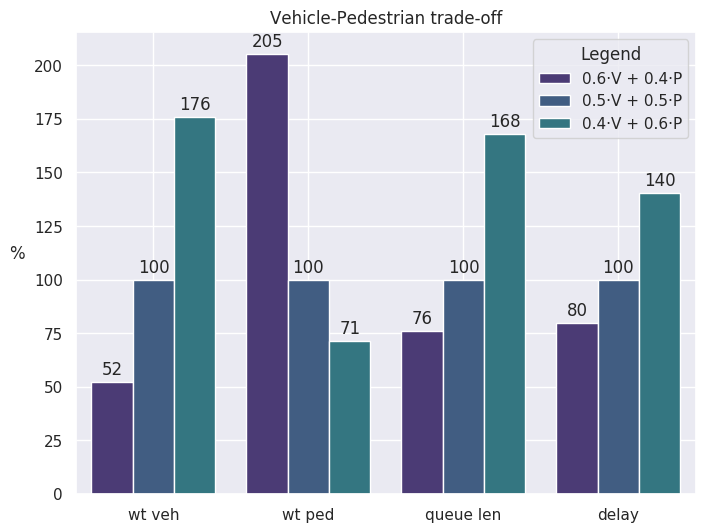

In [67]:
sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Vehicle-Pedestrian trade-off')
plt.xlabel('')
plt.ylabel('%    ', rotation=0)
plt.grid(True)
plt.show()

#### TIME VARIATION

##### standard time (10sec) - should be the same as above, or do we remove the penalties? 

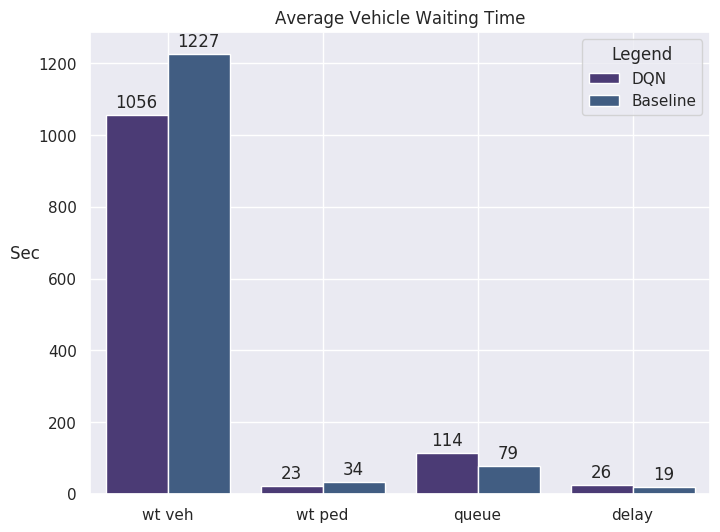

In [295]:
instaRes_all(dl_10sec_pen10_Vm_full, dl_10sec_pen10_Pm_full, dl_10sec_pen10_Qm_full, dl_10sec_pen10_Dm_full)

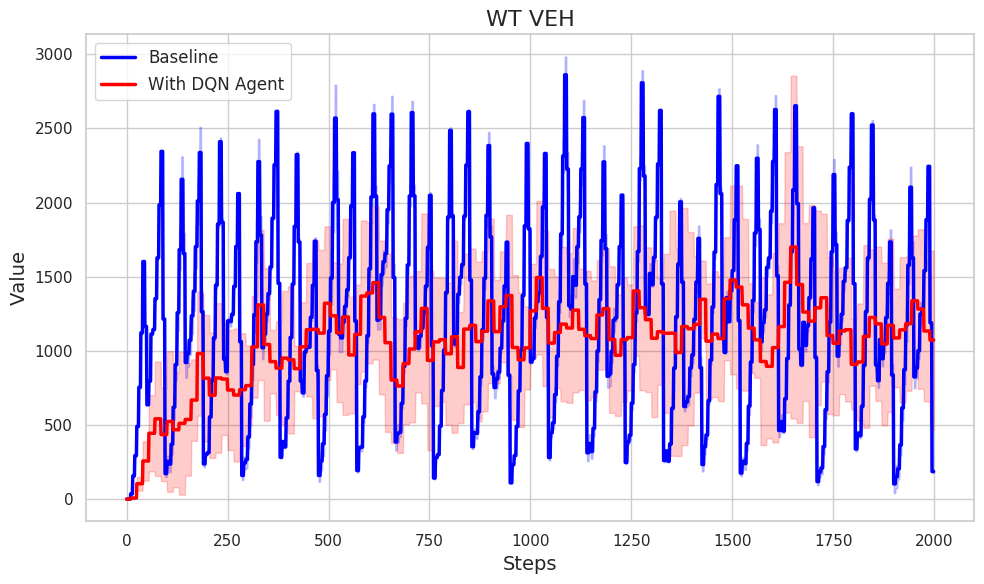

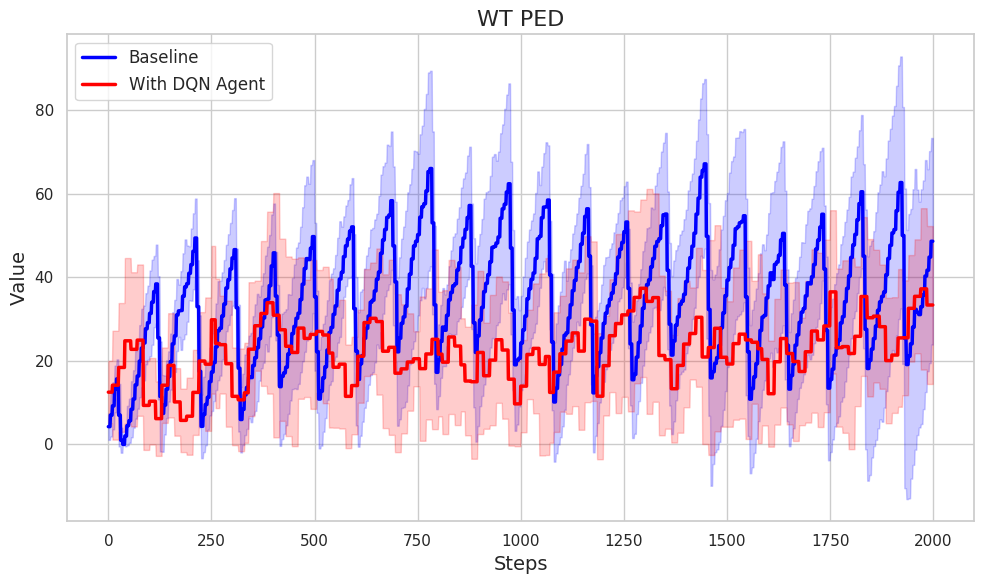

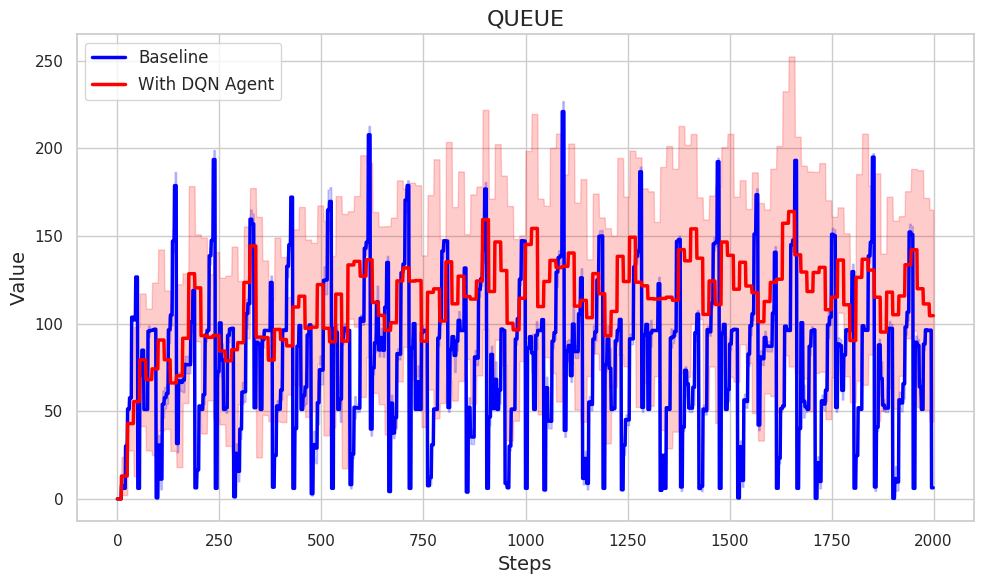

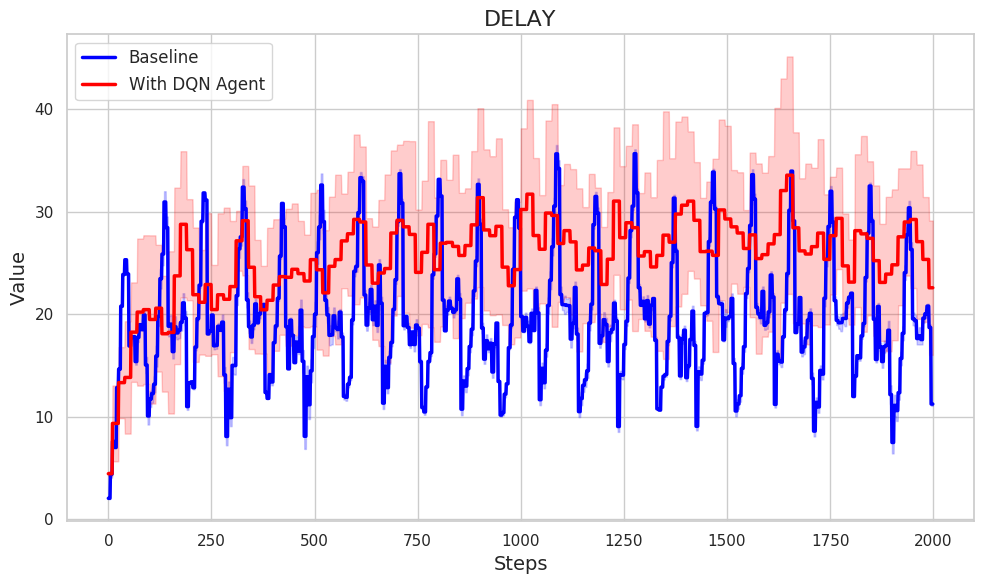

In [293]:
dl_10sec_pen10 = pd.read_csv('results/stats_ped/dl_mid10_b5_pen10_2') 

dl_10sec_pen10_V, dl_10sec_pen10_Vm, dl_10sec_pen10_Vs  = getRes(10, dl_10sec_pen10, 'wt_veh')
dl_10sec_pen10_Vm_full, dl_10sec_pen10_Vs_full = enl(dl_10sec_pen10_V, dl_10sec_pen10_Vm, dl_10sec_pen10_Vs, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dl_10sec_pen10_Vm_full[:2000], dl_10sec_pen10_Vs_full[:2000], 'WT VEH')


dl_10sec_pen10_P, dl_10sec_pen10_Pm, dl_10sec_pen10_Ps  = getRes(10, dl_10sec_pen10, 'wt_ped')
dl_10sec_pen10_Pm_full, dl_10sec_pen10_Ps_full = enl(dl_10sec_pen10_P, dl_10sec_pen10_Pm, dl_10sec_pen10_Ps, 10)
defPlot(base_mid_Pm_full, base_mid_Ps_full, dl_10sec_pen10_Pm_full[:2000], dl_10sec_pen10_Ps_full[:2000], 'WT PED')

dl_10sec_pen10_Q, dl_10sec_pen10_Qm, dl_10sec_pen10_Qs  = getRes(10, dl_10sec_pen10, 'queue')
dl_10sec_pen10_Qm_full, dl_10sec_pen10_Qs_full = enl(dl_10sec_pen10_Q, dl_10sec_pen10_Qm, dl_10sec_pen10_Qs, 10)
defPlot(base_mid_Qm_full, base_mid_Qs_full, dl_10sec_pen10_Qm_full[:2000], dl_10sec_pen10_Qs_full[:2000], 'QUEUE')

dl_10sec_pen10_D, dl_10sec_pen10_Dm, dl_10sec_pen10_Ds  = getRes(10, dl_10sec_pen10, 'delay')
dl_10sec_pen10_Dm_full, dl_10sec_pen10_Ds_full = enl(dl_10sec_pen10_D, dl_10sec_pen10_Dm, dl_10sec_pen10_Ds, 10)
defPlot(base_mid_Dm_full, base_mid_Ds_full, dl_10sec_pen10_Dm_full[:2000], dl_10sec_pen10_Ds_full[:2000], 'DELAY')

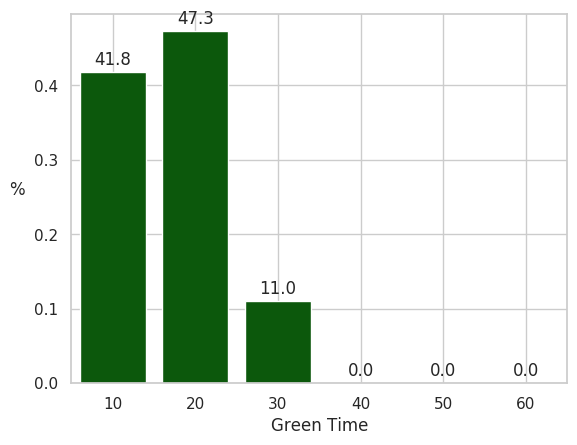

In [611]:
plotAct(dl_10sec_pen10, 0, 10, '') #finestra a 3

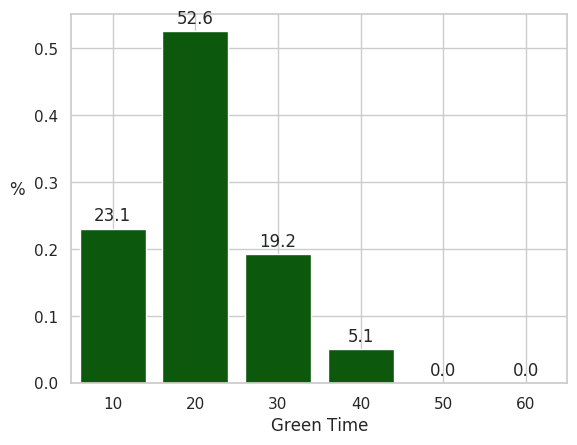

In [608]:
plotAct(dl_10sec_pen10, 0, 10, '') # finestra a 5

##### reduced time

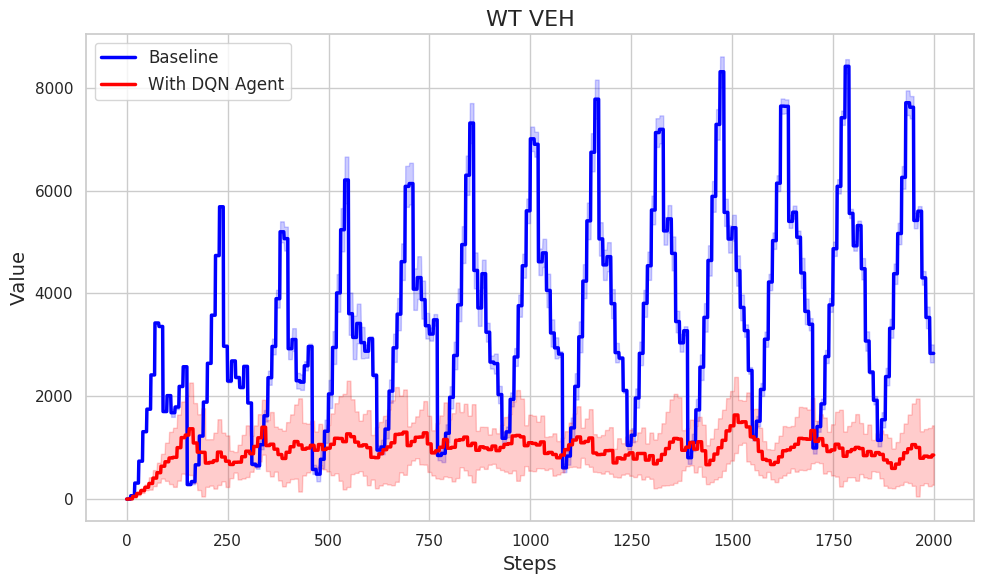

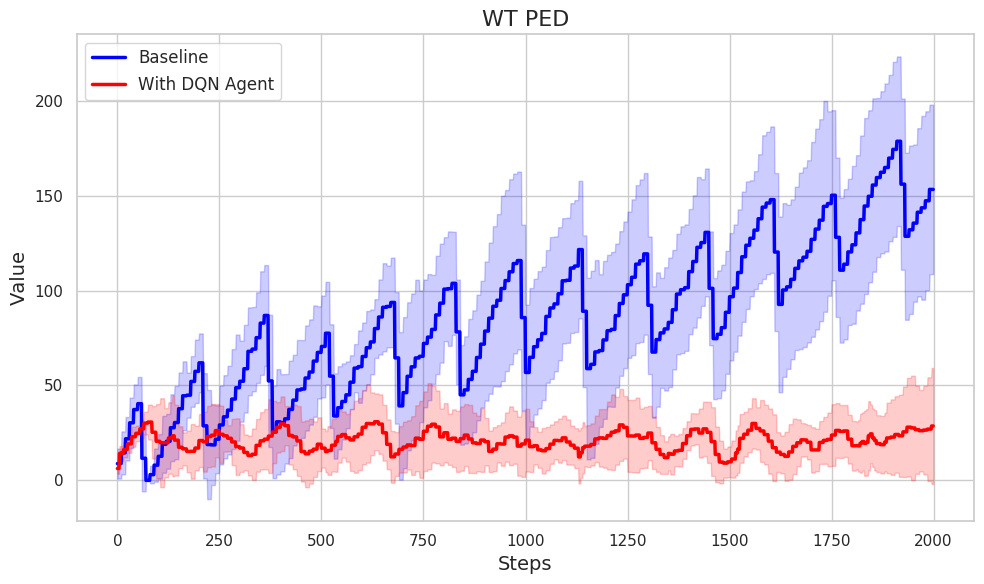

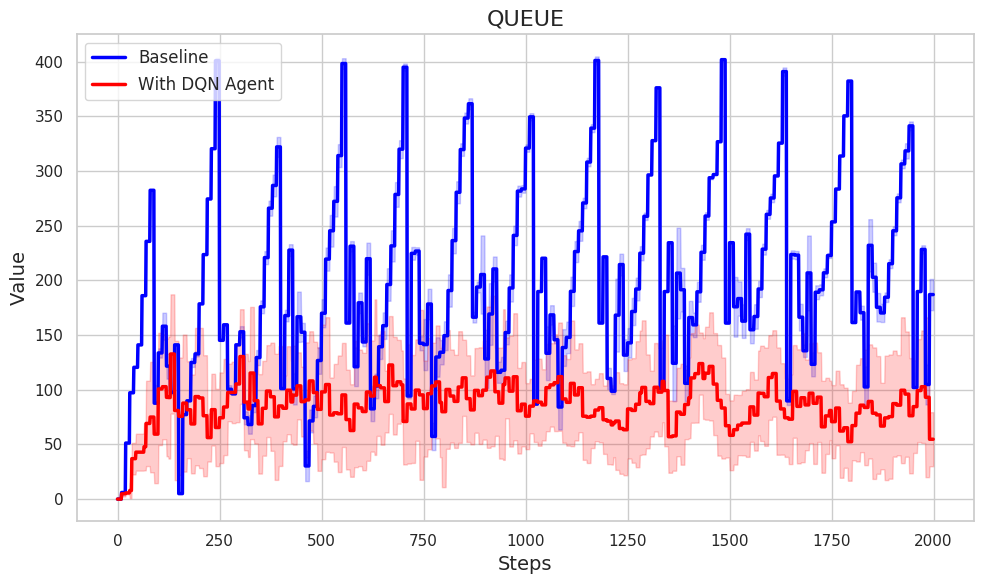

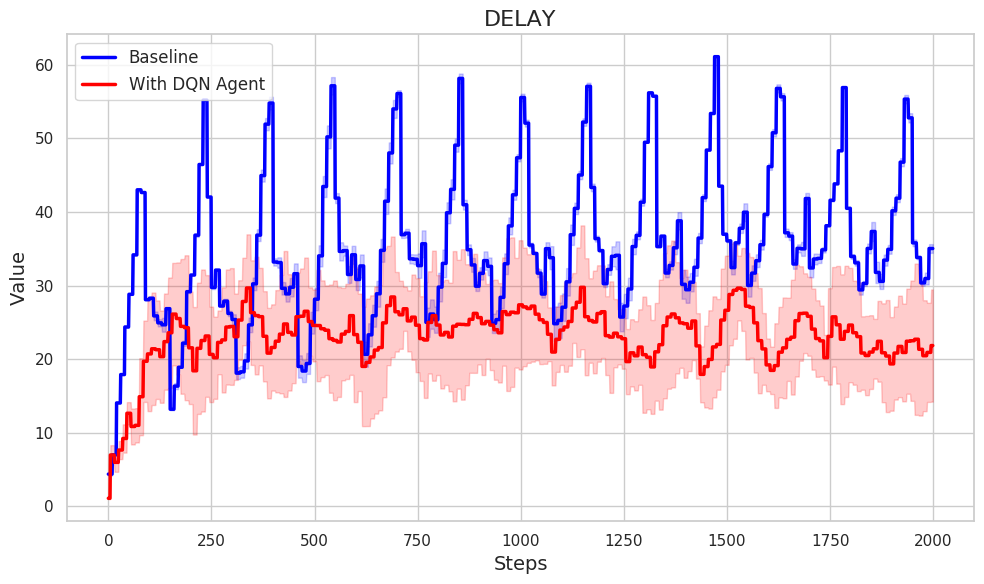

In [79]:
dl_5sec_pen60 = pd.read_csv('results/stats_ped/dl_mid5_b5_pen60')  #dl_mid5_b5_pen60

dl_5sec_pen60_V, dl_5sec_pen60_Vm, dl_5sec_pen60_Vs  = getRes(10, dl_5sec_pen60, 'wt_veh')
dl_5sec_pen60_Vm_full, dl_5sec_pen60_Vs_full = enl(dl_5sec_pen60_V, dl_5sec_pen60_Vm, dl_5sec_pen60_Vs, 5)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dl_5sec_pen60_Vm_full[:2000], dl_5sec_pen60_Vs_full[:2000], 'WT VEH')


dl_5sec_pen60_P, dl_5sec_pen60_Pm, dl_5sec_pen60_Ps  = getRes(10, dl_5sec_pen60, 'wt_ped')
dl_5sec_pen60_Pm_full, dl_5sec_pen60_Ps_full = enl(dl_5sec_pen60_P, dl_5sec_pen60_Pm, dl_5sec_pen60_Ps, 5)
defPlot(base_mid_Pm_full, base_mid_Ps_full, dl_5sec_pen60_Pm_full[:2000], dl_5sec_pen60_Ps_full[:2000], 'WT PED')

dl_5sec_pen60_Q, dl_5sec_pen60_Qm, dl_5sec_pen60_Qs  = getRes(10, dl_5sec_pen60, 'queue')
dl_5sec_pen60_Qm_full, dl_5sec_pen60_Qs_full = enl(dl_5sec_pen60_Q, dl_5sec_pen60_Qm, dl_5sec_pen60_Qs, 5)
defPlot(base_mid_Qm_full, base_mid_Qs_full, dl_5sec_pen60_Qm_full[:2000], dl_5sec_pen60_Qs_full[:2000], 'QUEUE')

dl_5sec_pen60_D, dl_5sec_pen60_Dm, dl_5sec_pen60_Ds  = getRes(10, dl_5sec_pen60, 'delay')
dl_5sec_pen60_Dm_full, dl_5sec_pen60_Ds_full = enl(dl_5sec_pen60_D, dl_5sec_pen60_Dm, dl_5sec_pen60_Ds, 5)
defPlot(base_mid_Dm_full, base_mid_Ds_full, dl_5sec_pen60_Dm_full[:2000], dl_5sec_pen60_Ds_full[:2000], 'DELAY')

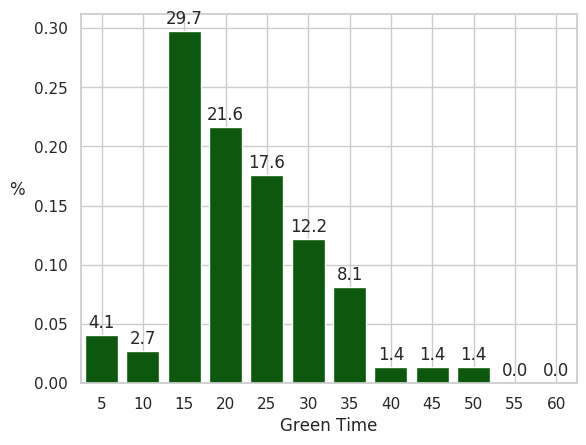

In [629]:
plotAct(dl_5sec_pen60, 0, 5, '')

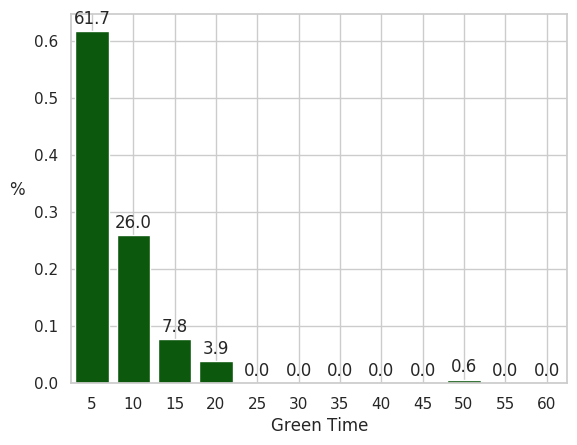

In [596]:
dl_mid5_b5_nopen = pd.read_csv('results/stats_ped/dl_mid5_b5') 
plotAct(dl_mid5_b5_nopen, 0, 5, '')

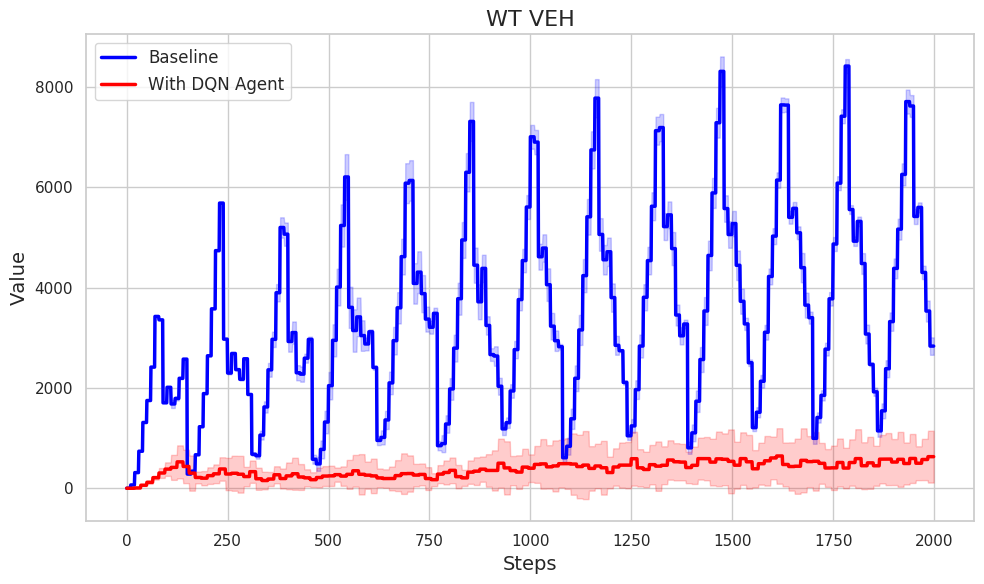

In [600]:
dl_mid_5_pen3 = pd.read_csv('results/stats_ped/dl_mid5_b5') 

dlmid5_V3, dlmid5_Vm3, dlmid5_Vs3  = getRes(10, dl_mid_5_pen3, 'wt_veh')
dlmid5_Vm_full3, dlmid5_Vs_full3 = enl(dlmid5_V3, dlmid5_Vm3, dlmid5_Vs3, 10)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dlmid5_Vm_full3[:2000], dlmid5_Vs_full3[:2000], 'WT VEH')

##### increased time - 15 sec

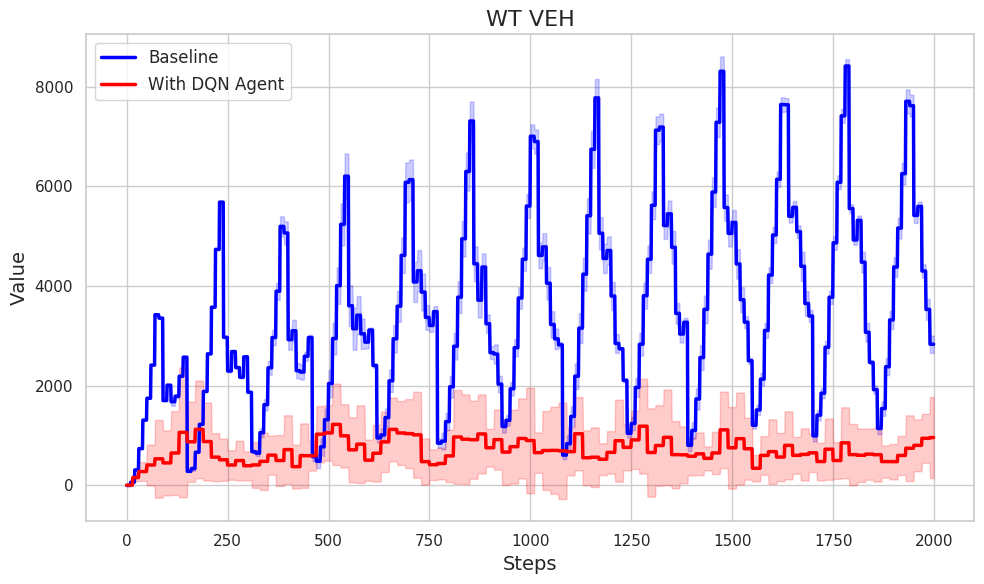

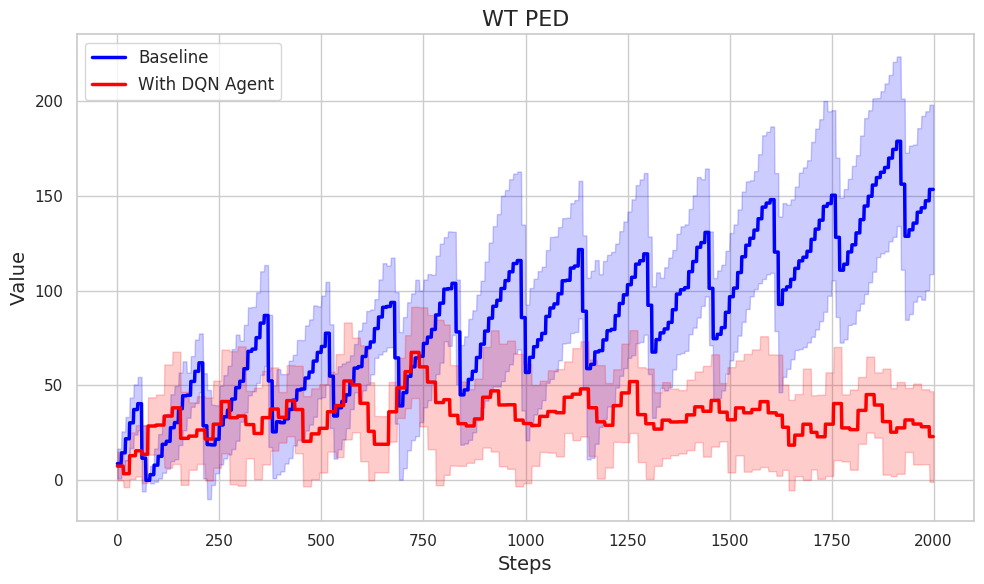

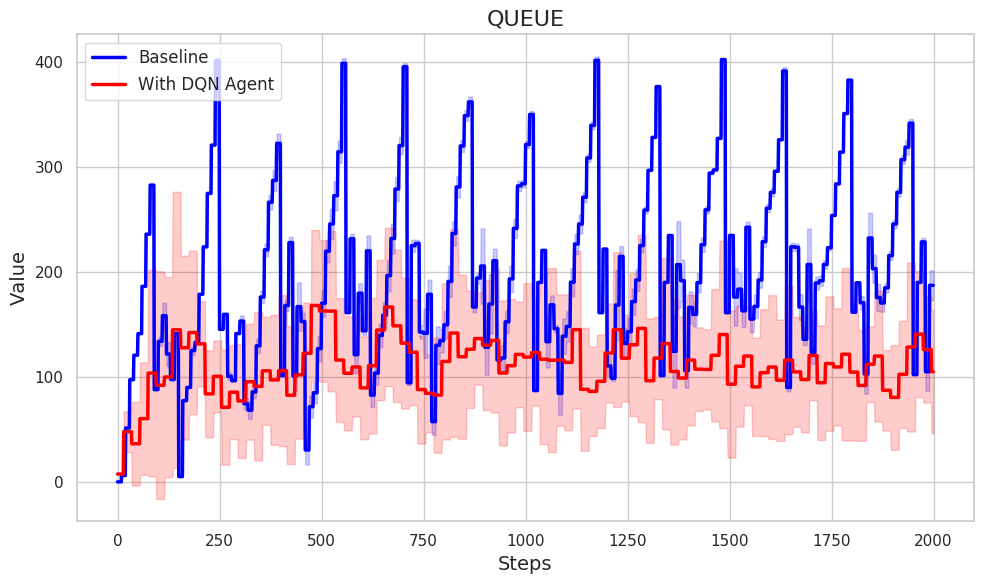

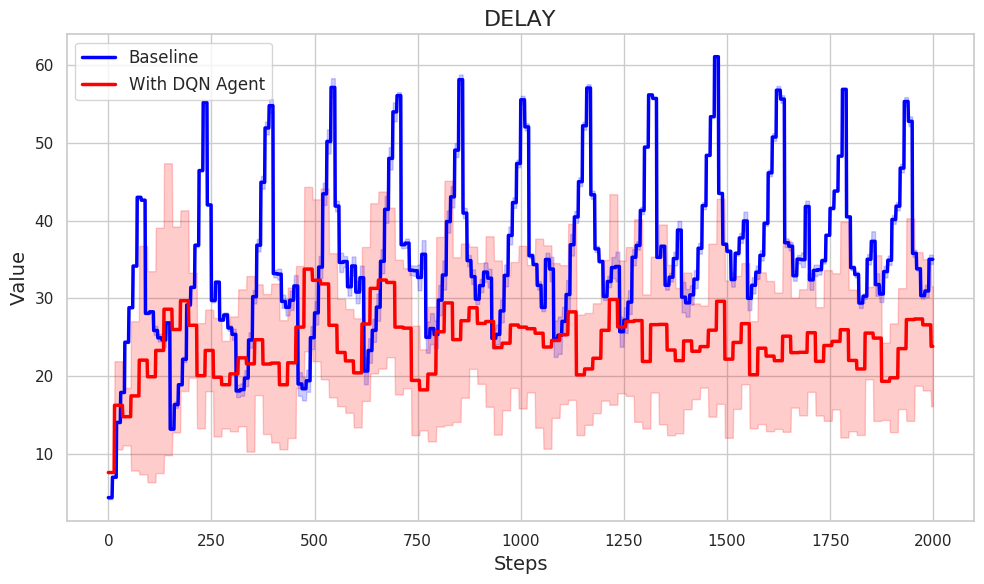

In [69]:
dl_15sec_pen6 = pd.read_csv('results/stats_ped/dl_mid15_b5_pen6')

dl_15sec_pen6_V, dl_15sec_pen6_Vm, dl_15sec_pen6_Vs  = getRes(10, dl_15sec_pen6, 'wt_veh')
dl_15sec_pen6_Vm_full, dl_15sec_pen6_Vs_full = enl(dl_15sec_pen6_V, dl_15sec_pen6_Vm, dl_15sec_pen6_Vs, 15)
defPlot(base_mid_Vm_full, base_mid_Vs_full, dl_15sec_pen6_Vm_full[:2000], dl_15sec_pen6_Vs_full[:2000], 'WT VEH')

dl_15sec_pen6_P, dl_15sec_pen6_Pm, dl_15sec_pen6_Ps  = getRes(10, dl_15sec_pen6, 'wt_ped')
dl_15sec_pen6_Pm_full, dl_15sec_pen6_Ps_full = enl(dl_15sec_pen6_P, dl_15sec_pen6_Pm, dl_15sec_pen6_Ps, 15)
defPlot(base_mid_Pm_full, base_mid_Ps_full, dl_15sec_pen6_Pm_full[:2000], dl_15sec_pen6_Ps_full[:2000], 'WT PED')

dl_15sec_pen6_Q, dl_15sec_pen6_Qm, dl_15sec_pen6_Qs  = getRes(10, dl_15sec_pen6, 'queue')
dl_15sec_pen6_Qm_full, dl_15sec_pen6_Qs_full = enl(dl_15sec_pen6_Q, dl_15sec_pen6_Qm, dl_15sec_pen6_Qs, 15)
defPlot(base_mid_Qm_full, base_mid_Qs_full, dl_15sec_pen6_Qm_full[:2000], dl_15sec_pen6_Qs_full[:2000], 'QUEUE')

dl_15sec_pen6_D, dl_15sec_pen6_Dm, dl_15sec_pen6_Ds  = getRes(10, dl_15sec_pen6, 'delay')
dl_15sec_pen6_Dm_full, dl_15sec_pen6_Ds_full = enl(dl_15sec_pen6_D, dl_15sec_pen6_Dm, dl_15sec_pen6_Ds, 15)
defPlot(base_mid_Dm_full, base_mid_Ds_full, dl_15sec_pen6_Dm_full[:2000], dl_15sec_pen6_Ds_full[:2000], 'DELAY')

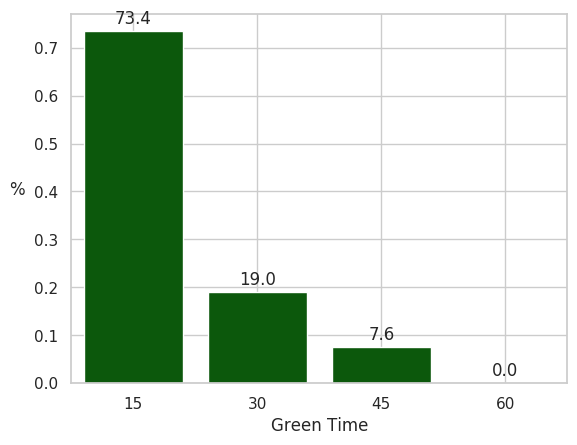

In [632]:
plotAct(dl_15sec_pen6, 0, 15, '')

##### Comparison

In [85]:
np.mean(dl_10sec_pen10_Qm)

113.4119590888373

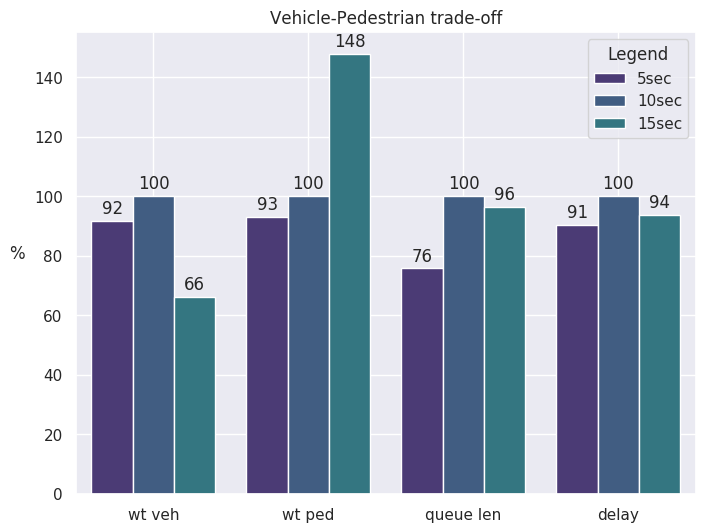

In [87]:
dlt5 = {'wt veh':np.mean(dl_5sec_pen60_Vm)*100/np.mean(dl_10sec_pen10_Vm), 'wt ped':np.mean(dl_5sec_pen60_Pm)*100/np.mean(dl_10sec_pen10_Pm), 'queue len':np.mean(dl_5sec_pen60_Qm)*100/np.mean(dl_10sec_pen10_Qm), 'delay':np.mean(dl_5sec_pen60_Dm)*100/np.mean(dl_10sec_pen10_Dm)}
dlt10 = {'wt veh':np.mean(dl_10sec_pen10_Vm)*100/np.mean(dl_10sec_pen10_Vm), 'wt ped':np.mean(dl_10sec_pen10_Pm)*100/np.mean(dl_10sec_pen10_Pm), 'queue len':np.mean(dl_10sec_pen10_Qm)*100/np.mean(dl_10sec_pen10_Qm), 'delay':np.mean(dl_10sec_pen10_Dm)*100/np.mean(dl_10sec_pen10_Dm)}
dlt15 = {'wt veh':np.mean(dl_15sec_pen6_Vm)*100/np.mean(dl_10sec_pen10_Vm), 'wt ped':np.mean(dl_15sec_pen6_Pm)*100/np.mean(dl_10sec_pen10_Pm), 'queue len':np.mean(dl_15sec_pen6_Qm)*100/np.mean(dl_10sec_pen10_Qm), 'delay':np.mean(dl_15sec_pen6_Dm)*100/np.mean(dl_10sec_pen10_Dm)}

df = pd.DataFrame([dlt5, dlt10, dlt15])

df_melted = df.melt(var_name='Key', value_name='Value')
df_melted['Legend'] = ['5sec', '10sec', '15sec']*4

sns.set(style="darkgrid")
sns.set_palette("viridis")

plt.figure(figsize=(8, 6))
ax = sns.barplot(x='Key', y='Value', hue='Legend', data=df_melted) #palette=['salmon', 'darkred', 'firebrick'])


for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                xytext=(0, 9),  # offset text by 9 points above bar
                textcoords='offset points')

plt.title('Vehicle-Pedestrian trade-off')
plt.xlabel('')
plt.ylabel('%    ', rotation=0)
plt.grid(True)
plt.show()

##########################

### test

In [277]:
def buildHist(dct, ep, time, title):
    
    actions = []
    for i in dct[str(ep)][4]:
        if i=='0' or i=='1' or i=='2':
            actions.append(int(i))
    
    green_time = []
    green = time
    for id, val in enumerate(actions[1:]):
        if val==actions[id]:
            green+=time
        else:
            green_time.append(green)
            green=time
    
    histg = {}
    for i in range(time, 60, time):
        histg[i] = green_time.count(i)

    return histg

buildHist(wt_low_10, 2, 10, '10sec')

{10: 96, 20: 18, 30: 3, 40: 0, 50: 0}

In [278]:

def plotAct(dct, ep, time, title):
    
    histg = buildHist(dct, ep, time, title)

    sns.set(style="whitegrid")

    temp = list(histg.values())
    ax = sns.barplot(x=list(histg.keys()), y=[i/sum(temp) for i in temp], color='darkgreen')
    #ax.set_yticks([])
    
    for p in ax.patches:
        ax.annotate(format(p.get_height()*100, '.1f'),
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center',
                    xytext=(0, 9),  # offset text by 9 points above bar
                    textcoords='offset points')


    plt.title(title)
    plt.xlabel('Green Time')
    plt.ylabel('%    ', rotation=0)
    plt.grid(True)
    
    plt.show()
            

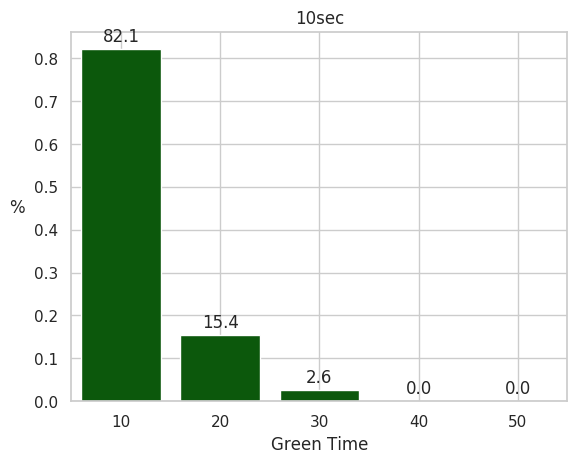

In [275]:
plotAct(wt_low_10, 2, 10, '10sec')

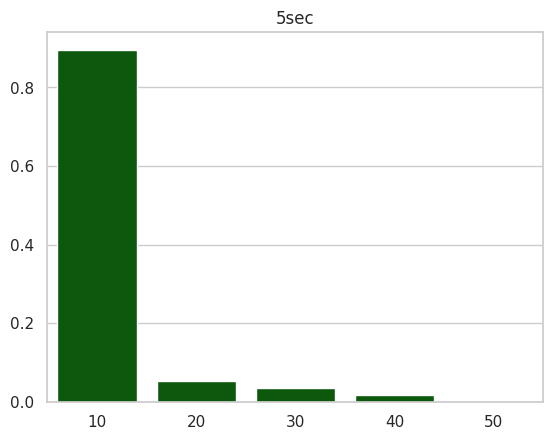

In [87]:
plotAct(wt_mid_10, 0, 10, '5sec')

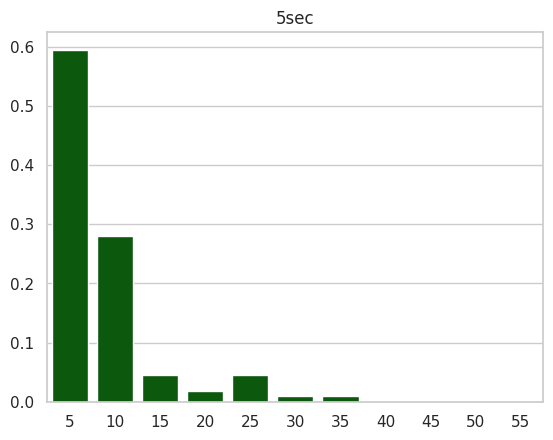

In [409]:
plotAct(wt_mid_5, 2, 5, '5sec')


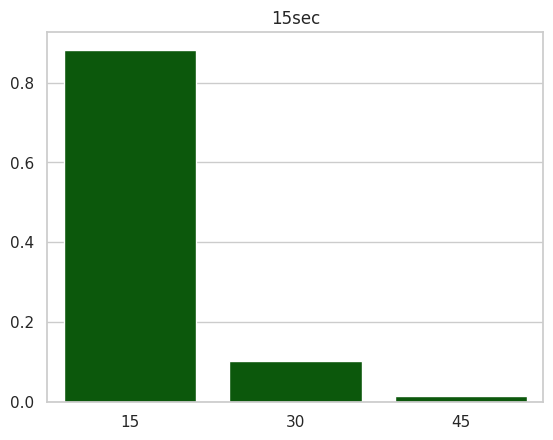

In [400]:
plotAct(wt_mid_15, 0, 15, '15sec')

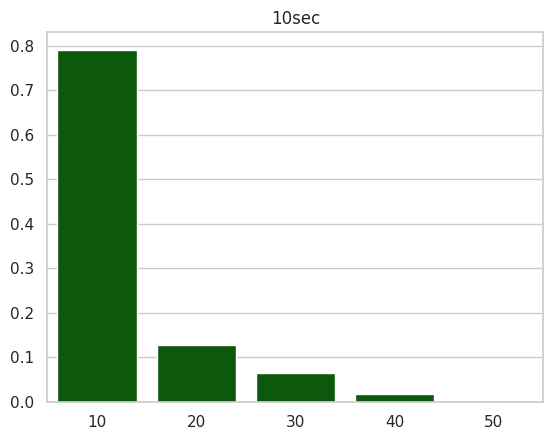

In [421]:
plotAct(wt_low_10, 1, 10, '10sec')

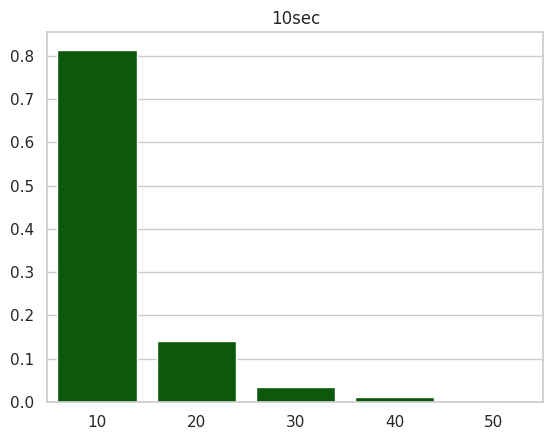

In [401]:
plotAct(wt_mid_10, 1, 10, '10sec')

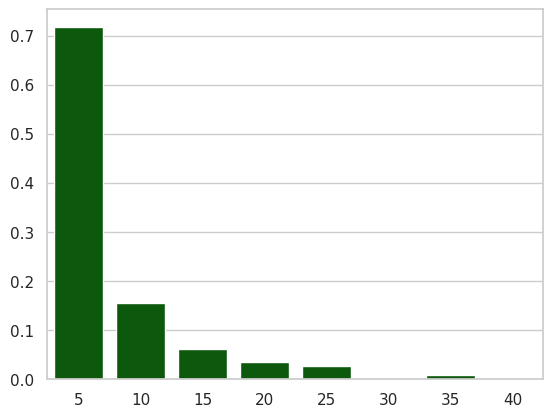

In [334]:
this = []
for i in wt_mid_5['0'][4]:
    if i=='0' or i=='1' or i=='2':
        this.append(int(i))


green_time = []

green=5
for id, val in enumerate(this[1:]):
    
    if val==this[id]:
        green+=5
    else:
        green_time.append(green)
        green=5

histg = {}
for i in range(5,45,5):
    histg[i] = green_time.count(i)
temp = list(histg.values())
sns.barplot(x=list(histg.keys()), y=[i/sum(temp) for i in temp], color='darkgreen')
plt.show()

In [333]:
d = list(histg.values())
f = [i/sum(d) for i in d]
f

[0.717948717948718,
 0.15384615384615385,
 0.05982905982905983,
 0.03418803418803419,
 0.02564102564102564,
 0.0,
 0.008547008547008548,
 0.0]

In [249]:
aa= pd.read_csv('results/stats_ped/wt_high_10_3')
bb = pd.read_csv('results/stats_ped/wt_high_10_base')

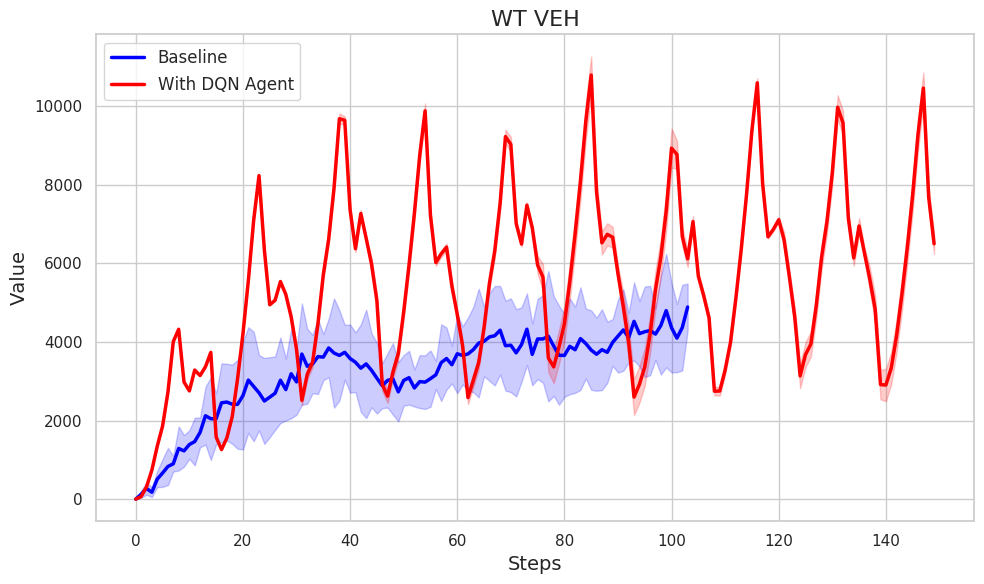

In [250]:
aad, aam, aas = getRes(10, aa, 'wt_veh')
bbd, bbm, bbs  = getRes(10, bb, 'wt_veh')

defPlot(aam, aas, bbm, bbs, 'WT VEH')

In [47]:
aad2, _, _ = getRes(10, aa, 'actions')

In [102]:
mm, ss = enl(aad2, aam, aas, 10)

In [52]:
mm, ss = enl(aad2, aam, aas, 10)


m_enl_b = []
for i in bbm:
    m_enl_b += [i]*10

s_enl_b = []
for i in bbs:
    s_enl_b += [i]*10


len(m_enl_b)

1500

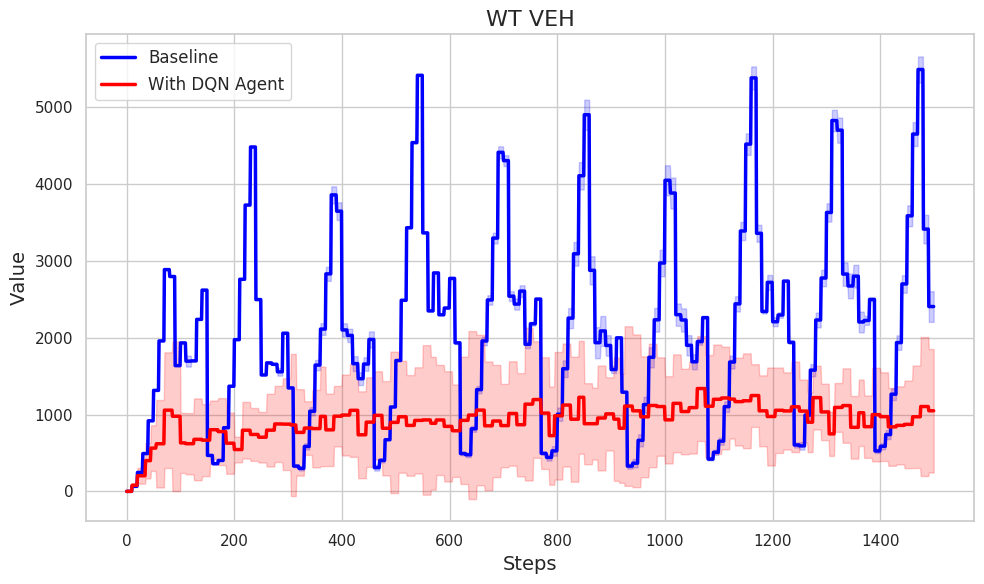

In [118]:
defPlot(mm[:1500], ss[:1500], m_enl_b, s_enl_b, 'WT VEH')